In [1]:
import os

def run_fast_scandir(dir, ext):    
    subfolders, datafiles = [], []

    for f in os.scandir(dir):
        if f.is_dir():
            subfolders.append(f.path)
        if f.is_file():
            if os.path.splitext(f.name)[1].lower() in ext:
                datafiles.append(f.path)

    for dir in list(subfolders):
        sf, f = run_fast_scandir(dir, ext)
        subfolders.extend(sf)
        datafiles.extend(f)
    return subfolders, datafiles

In [2]:
def pick_channels(ch_labels, desired_channels):
    ch_idx = []    
    for dc in desired_channels:
        for i, c in enumerate(ch_labels):
            if dc in c:
                ch_idx.append(i)
    return ch_idx


# **Pre-processing pipeline toggling variables**



In [3]:
CAR_REF = True
RUN_ICA = False
APPLY_ICA = False
X_DAWN = False
BASELN_CORR = True

# **Importing signals**

## Signal info

------
Data paths: 

C:/Users/VascoRocha(1161216)/Desktop/Rocha/EEG Data/

C:/Users/migue/OneDrive/Ambiente de Trabalho/Tese/EEG Data/

In [4]:
import mne
import numpy as np

folder = "C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Data/EEG Data"
old_data_subfold, EEG_data = run_fast_scandir(folder, [".edf"])

EEGs = []

print("============= Importing files =============\n")

count = 0

for EEG_file in EEG_data:
    if ("Train" in EEG_file and EEG_data not in old_data_subfold):
        
        count += 1
        print(f"\nSubject {count}\n")

        raw_eeg = mne.io.read_raw_edf(EEG_file, 
                                    preload=True)
        
        EEGs.append(raw_eeg)

NUM_SUBJ = len(EEGs)

print("\n\n============= Common EEG info =============")

print("\n", raw_eeg.info.keys())
print("\n", raw_eeg.info)

ch = raw_eeg.info["ch_names"] # Channel labels
fs = raw_eeg.info["sfreq"]

print("\nChannel labels: ", ch)

============= Importing files =============


Subject 1

Extracting EDF parameters from C:\Users\MICROMED\Desktop\MiguelRocha\PROJ\Data\EEG Data\01_session_01_Train.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 1212671  =      0.000 ...   592.125 secs...

Subject 2

Extracting EDF parameters from C:\Users\MICROMED\Desktop\MiguelRocha\PROJ\Data\EEG Data\02_session_01_Train.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 1527295  =      0.000 ...   745.750 secs...

Subject 3

Extracting EDF parameters from C:\Users\MICROMED\Desktop\MiguelRocha\PROJ\Data\EEG Data\03_session_01_Train.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 1317887  =      0.000 ...   643.500 secs...

Subject 4

Extracting EDF parameters from C:\Users\MICROMED\Desktop\MiguelRocha\PROJ\Data\EEG Data\04_session_01_Train.edf...
EDF file detected
Settin

# **Analysing signal quality and pre-processing data accordingly**

## Checking if the recorded signal is an EEG (1/f shape)

### Designing the band pass filter

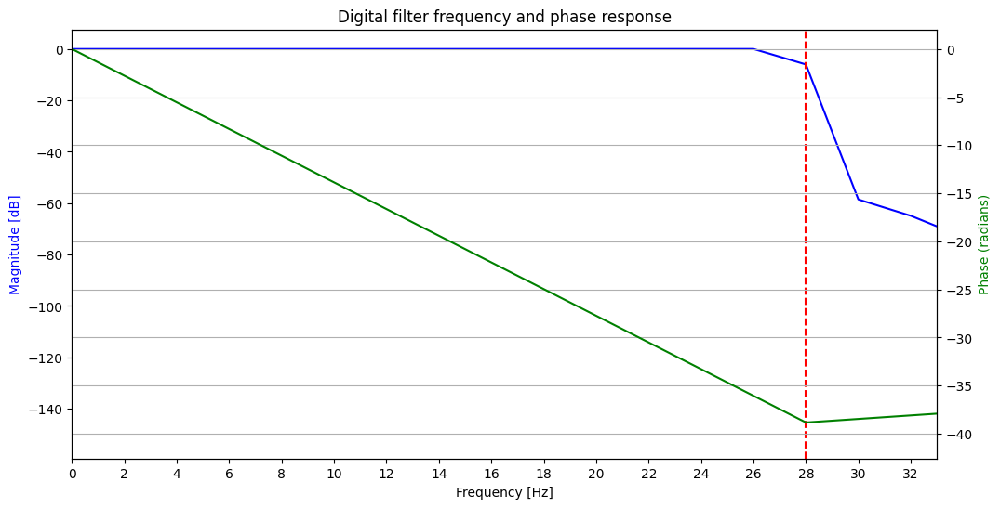

Subject 1: Low-Pass filtering EEG (28 Hz)
Subject 2: Low-Pass filtering EEG (28 Hz)
Subject 3: Low-Pass filtering EEG (28 Hz)
Subject 4: Low-Pass filtering EEG (28 Hz)
Subject 5: Low-Pass filtering EEG (28 Hz)
Subject 6: Low-Pass filtering EEG (28 Hz)


In [5]:
import scipy
from scipy.signal import filtfilt, firwin, freqz

import matplotlib.pyplot as plt
from matplotlib.pyplot import figure

# Designing a low-pass FIR filter at 28 Hz
nyquist = fs/2
lowcut = 28
numtaps = 5001 # Order
filt = firwin(numtaps, 
              lowcut/nyquist, 
              pass_zero=True)  
'''
pass_zero -> If True, the gain at frequency 0 (DC) is 1, creating a low-pass filter.
              If False, the DC gain is 0, creating a high-pass filter.
'''

# Ploting the frequency response of the filter
w, h = freqz(filt) # The frequency response is returned as a tuple (w, h), where w is the array of frequencies and h is the array of complex coeficients (w: rad/samples)

fig, ax1 = plt.subplots(figsize = (12,6))

ax1.set_title('Digital filter frequency and phase response')
ax1.plot(w*fs/(2*np.pi), 20 * np.log10(abs(h)), 'b')
ax1.set_ylabel('Magnitude [dB]', color='b')
ax1.set_xlabel('Frequency [Hz]')
ax1.set_xticks(np.arange(0,lowcut * 4/3.7, 5))
ax1.axvline(x = lowcut, color = 'r', linestyle = '--')

ax2 = ax1.twinx()
ax2.plot(w*fs/(2*np.pi), np.unwrap(np.angle(h)), 'g')
ax2.set_ylabel('Phase (radians)', color='g')
ax2.grid(True)
ax2.axis('tight')
ax2.set_xlim(0, 33)
ax2.set_xticks(np.arange(0, 32.5, 2))

plt.show()

# Applying the filter to the signal using filtfilt
# EEG shape: (channels, samples)
eeg_ch_idx = mne.pick_channels(ch, 
                               include = [], 
                               exclude = ['dc01+', 'dc02+', 'MKR+'])

filt_EEGs = []

for subj in range(NUM_SUBJ):

    print(f"Subject {subj +1}: Low-Pass filtering EEG ({lowcut} Hz)")

    filt_eeg = filtfilt(filt, 
                        1, 
                        EEGs[subj].get_data(picks = eeg_ch_idx), 
                        axis = 1)

    filt_EEGs.append(filt_eeg)


### Apllying the FFT on the EEG signal

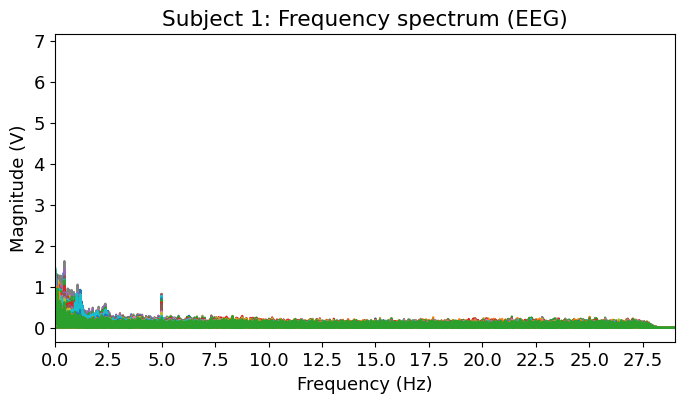

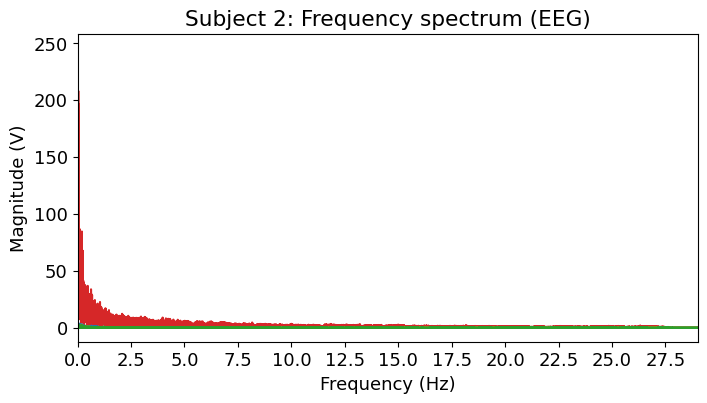

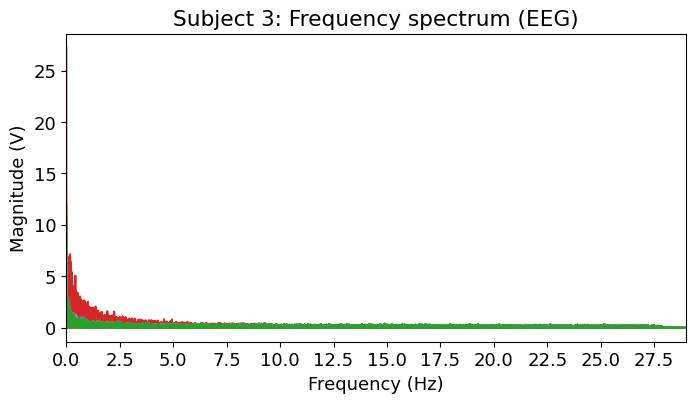

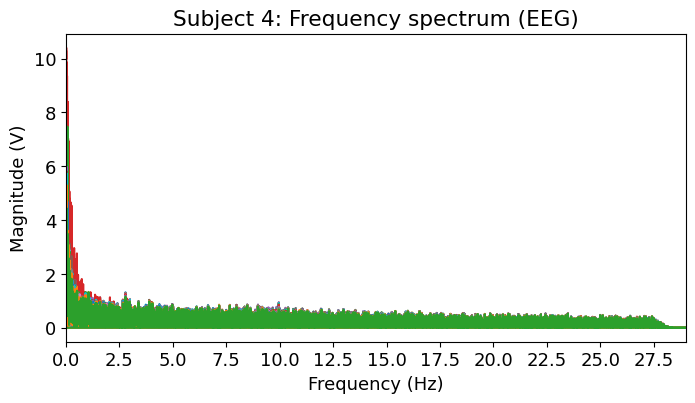

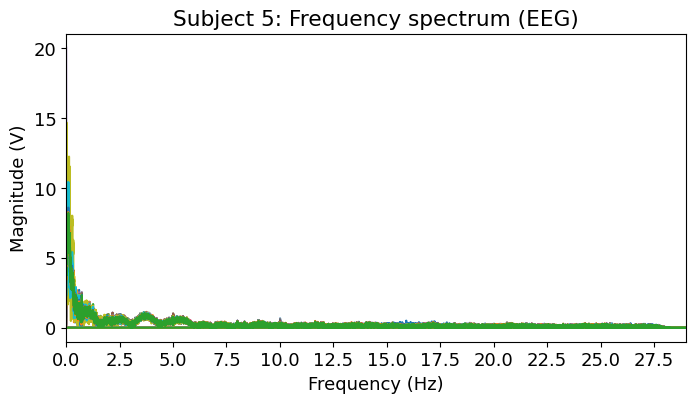

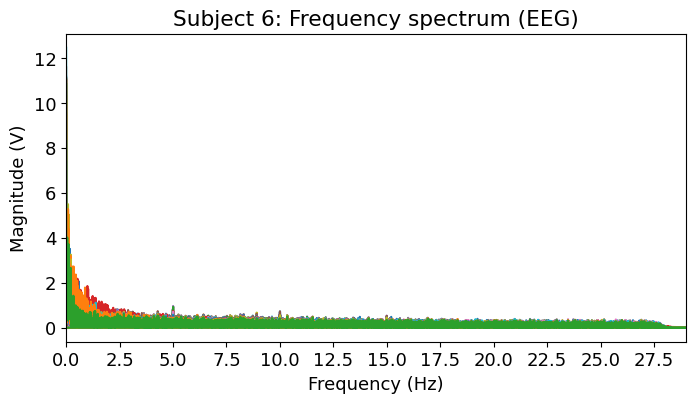

In [6]:

for subj in range(NUM_SUBJ):

    X = np.fft.fft(filt_EEGs[subj], axis = 1)

    # Compute the frequency vector
    freqs = np.fft.fftfreq(np.size(X,1), 1/fs)

    # Plot the frequency spectrum
    figure(figsize = (8,4))
    plt.rcParams['font.size'] = 13
    plt.plot(freqs, np.abs(X.T))
    plt.title(f"Subject {subj+1}: Frequency spectrum (EEG)")
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Magnitude (V)')
    plt.xlim(0, lowcut + 1)
    plt.xticks(np.arange(0, lowcut + 1, 2.5)) 
    plt.show()


## Bad channel interpolation (O1)

In [7]:
cust_ch = [ch[c].split("EEG ")[1] for c in eeg_ch_idx if ("EEG " in ch[c])]
clean_ch = [c.split("''")[0] for c in cust_ch]

ch_types = ['eeg'] * len(clean_ch)

new_info = mne.create_info(ch_names = clean_ch, 
                           sfreq = fs, 
                           ch_types = ch_types)

sjbs_with_bad_ch = [1, 2, 5]

interp_bad_ch_eeg = []

bad_ch_idx = pick_channels(ch, [" O1"])

for subj in range(NUM_SUBJ):

    filt_MNE_EEG = mne.io.RawArray(filt_EEGs[subj], new_info)
    filt_MNE_EEG.set_montage('standard_1005')

    if subj in sjbs_with_bad_ch:

        print(f"\n====== Subject {subj + 1}: Interpolating channel {clean_ch[bad_ch_idx[0]]} ======\n")

        filt_MNE_EEG.info["bads"] = [clean_ch[bad_ch_idx[0]]] 
        filt_MNE_EEG.interpolate_bads()

    interp_bad_ch_eeg.append(filt_MNE_EEG)

    print("\n\n")


Creating RawArray with float64 data, n_channels=33, n_times=1212672
    Range : 0 ... 1212671 =      0.000 ...   592.125 secs
Ready.



Creating RawArray with float64 data, n_channels=33, n_times=1527296
    Range : 0 ... 1527295 =      0.000 ...   745.750 secs
Ready.

====== Subject 2: Interpolating channel O1 ======

Setting channel interpolation method to {'eeg': 'spline'}.
Interpolating bad channels.
    Automatic origin fit: head of radius 87.7 mm
Computing interpolation matrix from 32 sensor positions
Interpolating 1 sensors



Creating RawArray with float64 data, n_channels=33, n_times=1317888
    Range : 0 ... 1317887 =      0.000 ...   643.500 secs
Ready.

====== Subject 3: Interpolating channel O1 ======

Setting channel interpolation method to {'eeg': 'spline'}.
Interpolating bad channels.
    Automatic origin fit: head of radius 87.7 mm
Computing interpolation matrix from 32 sensor positions
Interpolating 1 sensors



Creating RawArray with float64 data, n_channels=33, n_ti

## Analysing electrode smearing/bridging

========================== Subject 1 ==========================

Local minimum 1.795145533734194e-11 found


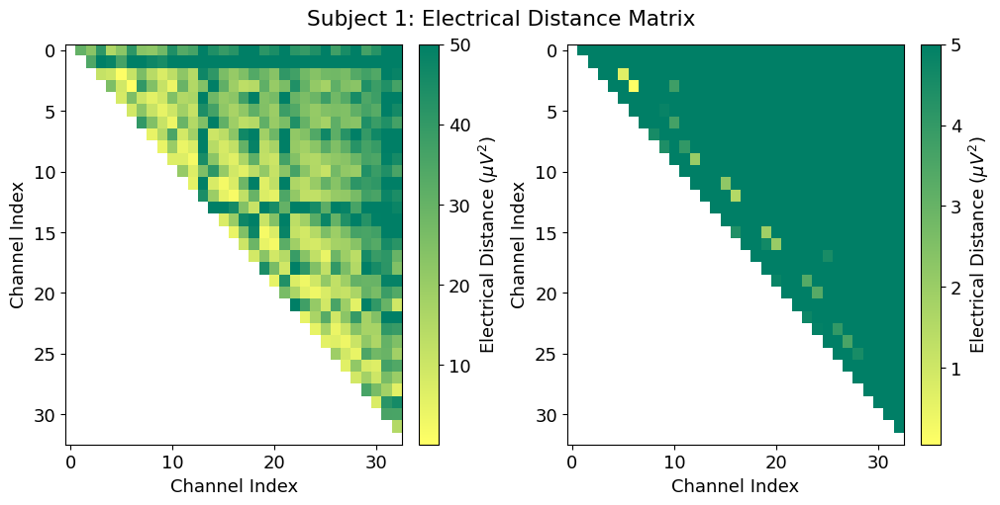

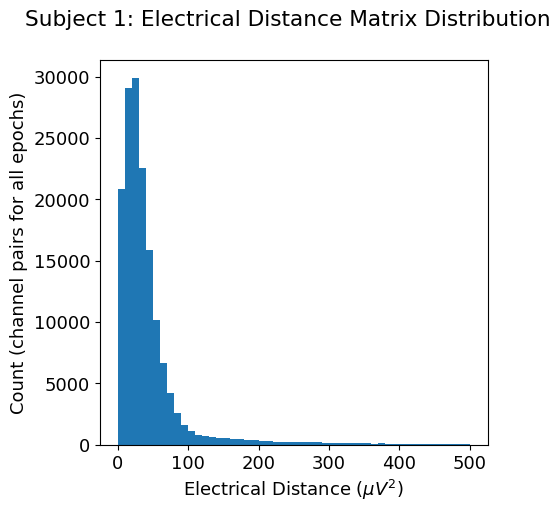

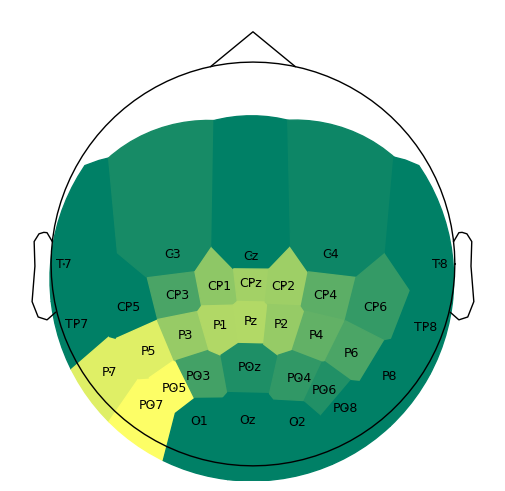

========================== Subject 2 ==========================

Local minimum 3.725062508476303 found
Bridge detected between P7 and PO7
Bridge detected between P7 and P5
Bridge detected between P7 and PO5
Bridge detected between P7 and P3
Bridge detected between P7 and PO3
Bridge detected between P7 and O1
Bridge detected between P7 and POz
Bridge detected between P7 and Oz
Bridge detected between PO7 and P5
Bridge detected between PO7 and PO5
Bridge detected between PO7 and P3
Bridge detected between PO7 and PO3
Bridge detected between PO7 and O1
Bridge detected between PO7 and POz
Bridge detected between PO7 and Oz
Bridge detected between P5 and PO5
Bridge detected between P5 and P3
Bridge detected between P5 and PO3
Bridge detected between P5 and O1
Bridge detected between P5 and POz
Bridge detected between P5 and Oz
Bridge detected between PO5 and P3
Bridge detected between PO5 and PO3
Bridge detected between PO5 and O1
Bridge detected between PO5 and POz
Bridge detected between 

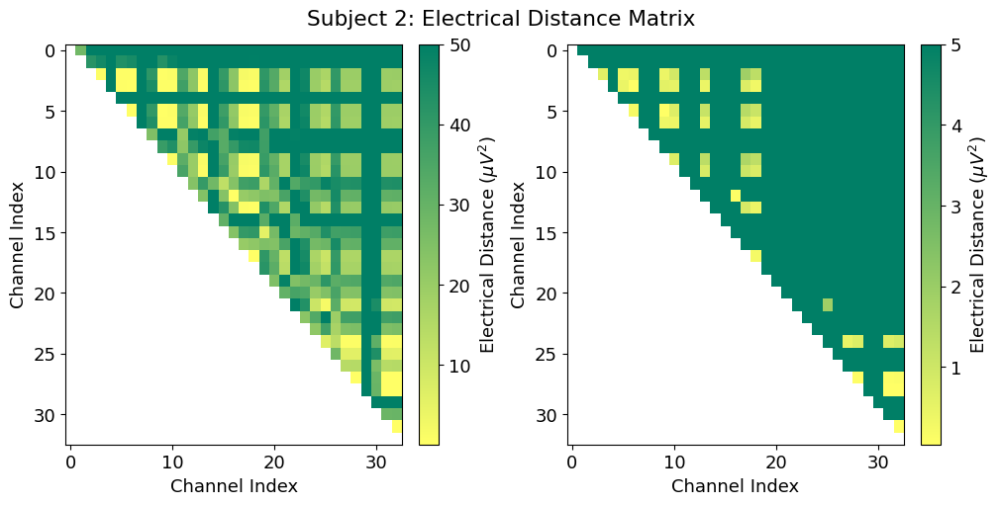

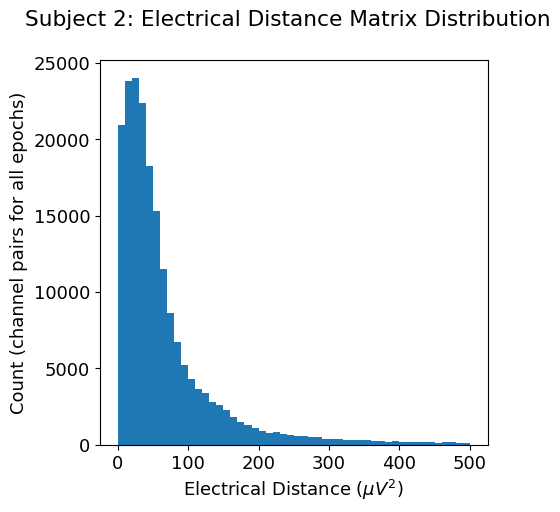

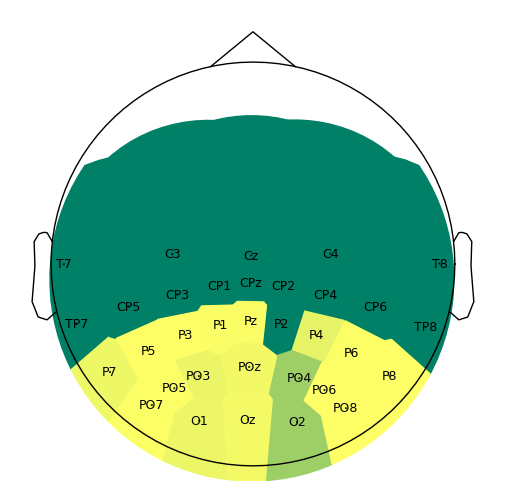

========================== Subject 3 ==========================

Local minimum 1.2323404714094263e-11 found


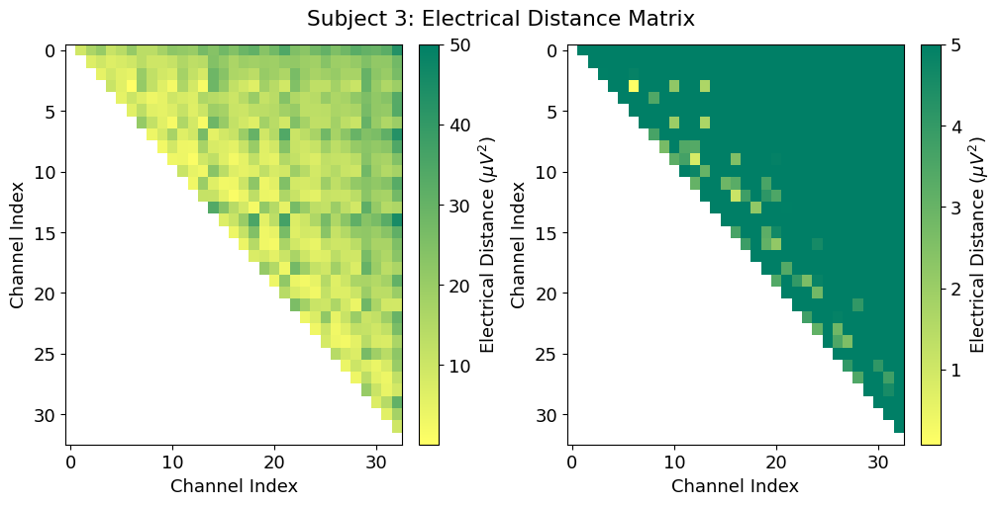

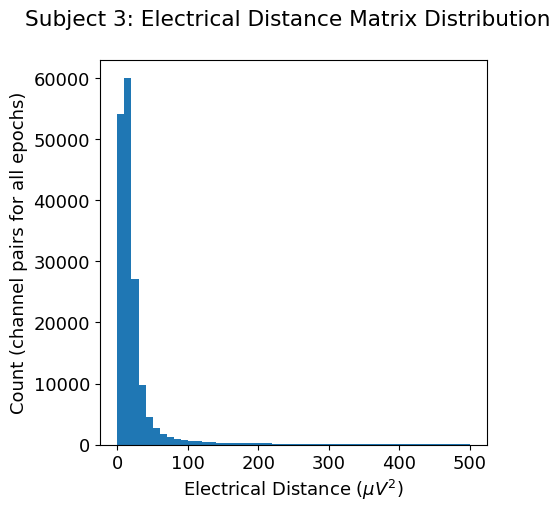

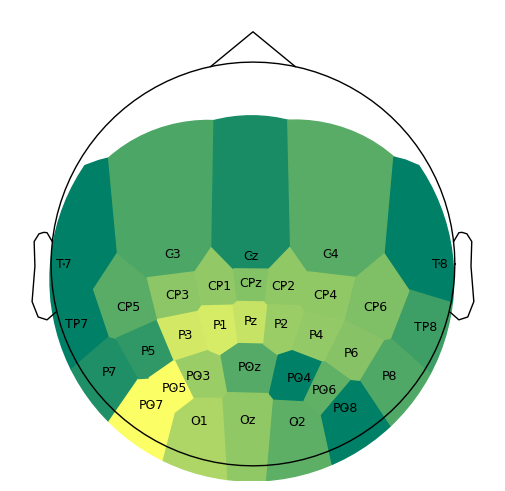

========================== Subject 4 ==========================

Local minimum 4.247262015835494 found
Bridge detected between PO7 and PO5
Bridge detected between P4 and P6
Bridge detected between PO6 and PO8


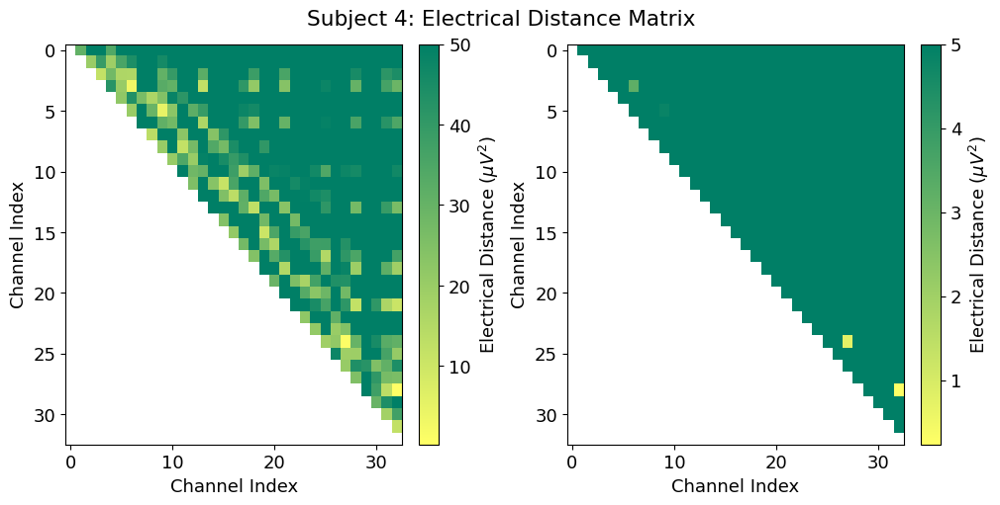

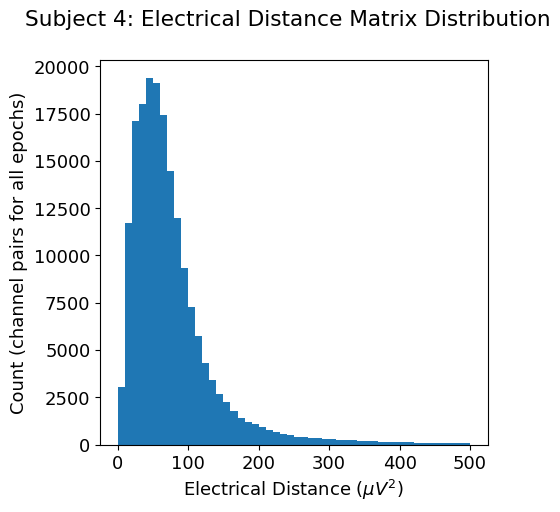

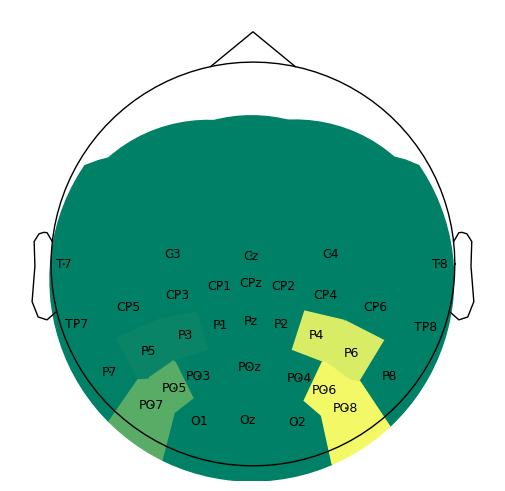

========================== Subject 5 ==========================

Local minimum 2.8305575726390786 found
Bridge detected between PO7 and PO5


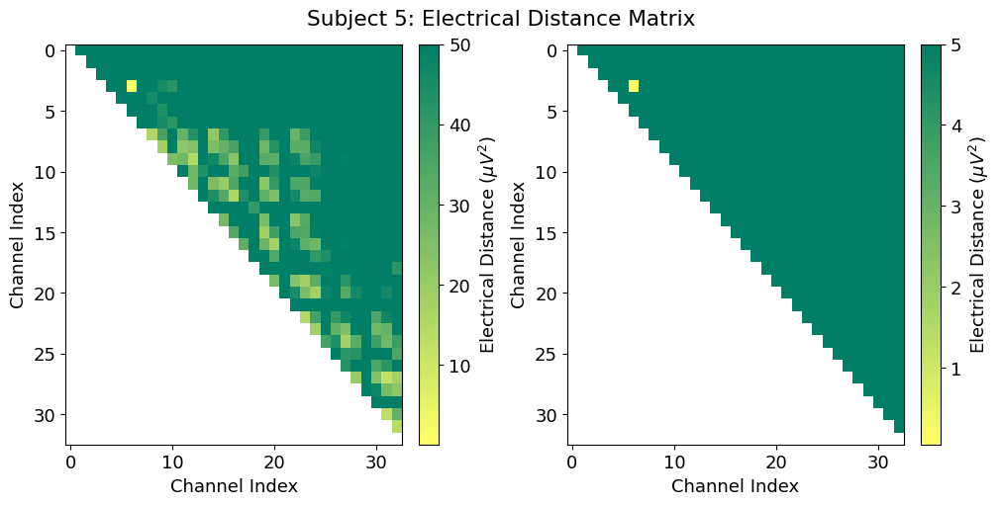

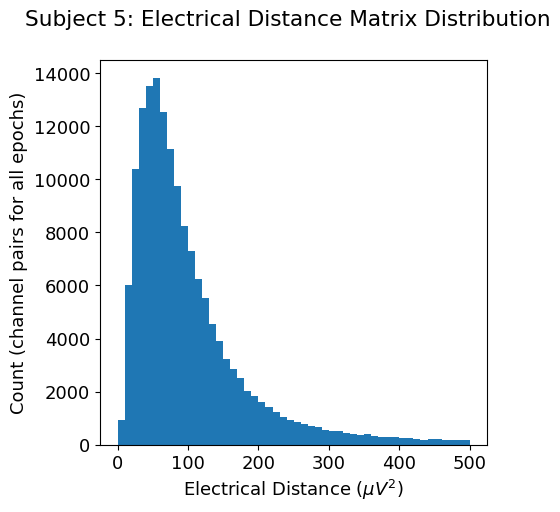

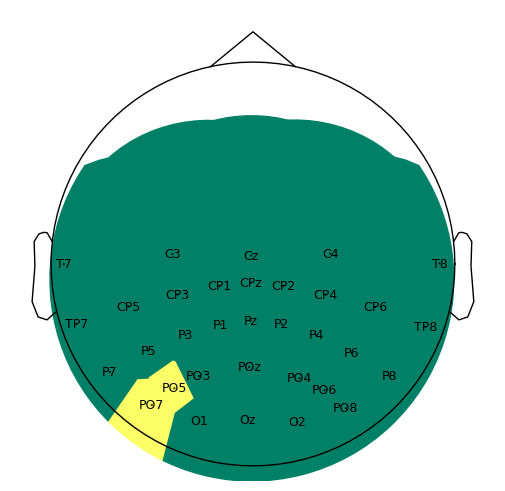

========================== Subject 6 ==========================

Local minimum 2.6995683671980433 found
Bridge detected between PO7 and PO5
Bridge detected between CP1 and CPz
Bridge detected between P1 and Pz
Bridge detected between P1 and P2
Bridge detected between Pz and P2


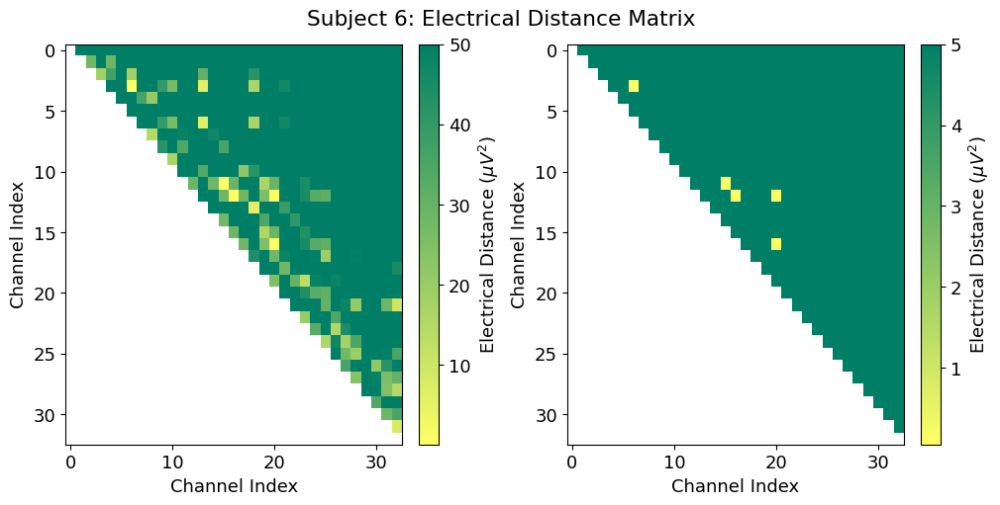

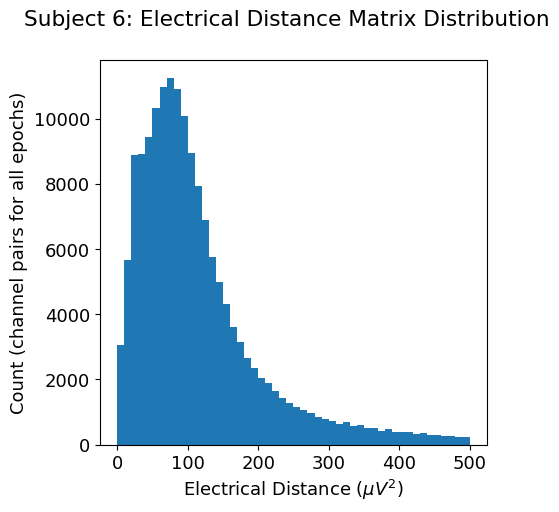

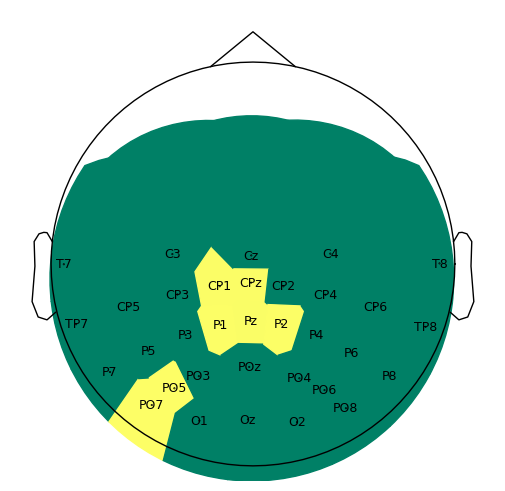

In [8]:
smearing_EEGs = []
all_ed_data = []

cmap = 'summer_r'

for subj in range(NUM_SUBJ):

    print(f"========================== Subject {subj + 1} ==========================\n")

    ## Examine an Electrical Distance Matrix

    ed_data = mne.preprocessing.compute_bridged_electrodes(interp_bad_ch_eeg[subj])
    bridged_idx, ed_matrix = ed_data

    all_ed_data.append(ed_data)

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5), layout="constrained")
    fig.suptitle(f"Subject {subj + 1}: Electrical Distance Matrix")

    # take median across epochs, only use upper triangular, lower is NaNs
    ed_plot = np.zeros(ed_matrix.shape[1:]) * np.nan
    triu_idx = np.triu_indices(ed_plot.shape[0], 1)
    for idx0, idx1 in np.array(triu_idx).T:
        ed_plot[idx0, idx1] = np.nanmedian(ed_matrix[:, idx0, idx1])

    # plot full distribution color range
    im1 = ax1.imshow(ed_plot, aspect="auto", vmax=50, cmap = cmap)
    cax1 = fig.colorbar(im1, ax=ax1)
    cax1.set_label(r"Electrical Distance ($\mu$$V^2$)")

    # plot zoomed in colors
    im2 = ax2.imshow(ed_plot, aspect="auto", vmax=5, cmap = cmap)
    cax2 = fig.colorbar(im2, ax=ax2)
    cax2.set_label(r"Electrical Distance ($\mu$$V^2$)")
    for ax in (ax1, ax2):
        ax.set_xlabel("Channel Index")
        ax.set_ylabel("Channel Index")

    ## Examine the Distribution of Electrical Distances

    fig1, ax = plt.subplots(figsize=(5, 5))
    fig1.suptitle(f"Subject {subj + 1}: Electrical Distance Matrix Distribution")
    ax.hist(ed_matrix[~np.isnan(ed_matrix)], bins=np.linspace(0, 500, 51))
    ax.set_xlabel(r"Electrical Distance ($\mu$$V^2$)")
    ax.set_ylabel("Count (channel pairs for all epochs)")

    mne.viz.plot_bridged_electrodes(interp_bad_ch_eeg[subj].info,
                                    bridged_idx,
                                    ed_matrix,
                                      # Pass the axis to the plot function
                                    title=f"Subject {subj + 1}: Bridged Electrodes",
                                    topomap_args=dict(vlim=(None, 5),
                                                      size=10,
                                                      cmap=cmap,
                                                      sphere=(0.0011, 0.015, 0.12, 0.2),
                                                      ))


## Interpolating bridged channels based on the amount of connections

In [9]:
interp_smearing_EEGs = []

for subj in range(NUM_SUBJ):

    bridged_idx = all_ed_data[subj][0]

    num_smeared_electrodes = 0
    for i in bridged_idx:
        num_smeared_electrodes += len(i)

    print(f"Number of connections (Subject {subj + 1}): ", num_smeared_electrodes)

    if(len(bridged_idx) > 0 and num_smeared_electrodes <= 8):

        print("Interpolating connected channels.")

        interp_smearing_eeg = mne.preprocessing.interpolate_bridged_electrodes(interp_bad_ch_eeg[subj].copy(), 
                                                                               bridged_idx=bridged_idx)

        interp_smearing_EEGs.append(interp_smearing_eeg)

    else:

        print("No interpolation.")

        interp_smearing_EEGs.append(interp_bad_ch_eeg[subj].copy())

    print("\n")

Number of connections (Subject 1):  0
No interpolation.


Number of connections (Subject 2):  96
No interpolation.


Number of connections (Subject 3):  0
No interpolation.


Number of connections (Subject 4):  6
Interpolating connected channels.
Creating RawArray with float64 data, n_channels=1, n_times=1423360
    Range : 0 ... 1423359 =      0.000 ...   695.000 secs
Ready.
Creating RawArray with float64 data, n_channels=1, n_times=1423360
    Range : 0 ... 1423359 =      0.000 ...   695.000 secs
Ready.
Creating RawArray with float64 data, n_channels=1, n_times=1423360
    Range : 0 ... 1423359 =      0.000 ...   695.000 secs
Ready.
Setting channel interpolation method to {'eeg': 'spline'}.
Interpolating bad channels.
    Automatic origin fit: head of radius 87.7 mm
Computing interpolation matrix from 30 sensor positions
Interpolating 6 sensors


Number of connections (Subject 5):  2
Interpolating connected channels.
Creating RawArray with float64 data, n_channels=1, n_times=1245696


## Re-referencing (Common Average)

CAR reference can be useful but if noisy channels are contained in the averaging, this noise is propagated to the entire scalp. This can be seen in Sara EEG in the SNR and PSD graphs. The SSVEP is propagated to the rest of the signal, thus increasing the average SNR, mainly at the SSVEP and their harmonics (10 and 15 Hz). Furthermore, spread activity like the P300 can will appear reduced.

In [10]:
rereferenced_EEGs = []

for subj in range(NUM_SUBJ):

    if (CAR_REF):

        print(f"Subject {subj + 1}: Rereferencing EEG (Common Average Reference) \n")
        
        car = mne.set_eeg_reference(interp_smearing_EEGs[subj],
                                    ref_channels='average',
                                    copy = True)

        rereferenced_EEGs.append(car[0])
        
        print("\n")
    
    else:

        rereferenced_EEGs.append(interp_smearing_EEGs[subj])



Subject 1: Rereferencing EEG (Common Average Reference) 

EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.


Subject 2: Rereferencing EEG (Common Average Reference) 

EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.


Subject 3: Rereferencing EEG (Common Average Reference) 

EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.


Subject 4: Rereferencing EEG (Common Average Reference) 

EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.


Subject 5: Rereferencing EEG (Common Average Reference) 

EEG channel type selected for re-referencing
Applying average reference.
Applying a custom ('EEG',) reference.


Subject 6: Rereferencing EEG (Common Average Reference) 

EEG channel type selected for re-referencing
Applying average reference.
Applying a cus

## Isolating the LDR channel

In [11]:
def plot_isolated_signal(time, signal, th, title):
    figure(figsize = (300,20))
    plt.plot(time, signal, linewidth = 2);
    plt.title(title, fontsize = 100, fontweight = 'bold')
    plt.xlabel('Time (min)', fontsize = 85, fontweight = 'bold')
    plt.ylabel('Voltage (V)', fontsize = 85, fontweight = 'bold')
    plt.xticks(np.arange(0, np.max(time), 0.05), fontsize = 30)
    plt.yticks(np.arange(np.min(signal), np.max(signal), 0.1), fontsize = 30)
    plt.xlim([0,max(time)])
    plt.axhline(y = th, color = 'k', linestyle = '--', linewidth = 2)
    plt.grid()

In [12]:
ldr_ch_idx = mne.pick_channels(ch, include = ['dc01+'])

th = 1.4 # y value threshold to segment signal

segmentation_LDRs = []
time_vectors = []

for subj in range(NUM_SUBJ):

    ldr_ch = EEGs[subj].get_data(picks = ch[ldr_ch_idx[0]])
    if (np.mean(ldr_ch) < 0): # If the polarity was inverted
        print("Inverting signal...")
        ldr_ch = ldr_ch * -1
    ''' 
    The bright square (more light) will decrease the resistance of the LDR, thus producing more voltage
    aproximating 2.4V if the polarity of the component was right or -2.4V if the polarity was inverted

    The dark square will increase the resistance to the MOhm range and cause the signal to be almost 0.
    This is because all the voltage will be sucked by the first component (LDR) of the voltage divider.
    '''

    time = np.arange(0, np.size(ldr_ch,1)/fs, 1/fs) # Time vector of the acquisition in s

    segmentation_LDRs.append(ldr_ch)
    time_vectors.append(time)

    #plot_isolated_signal(time/60, ldr_ch[0][:], th, f"Subject {subj + 1}: LDR channel") # time/60 = timevector in minutes
    #plt.show()

### Checking different filter effects on the LDR channel to see if the instances each images appear are maintained

In [13]:
def moving_aver(ldr_ch_snip, window_size):

    b = np.ones(window_size) / window_size

    # Apply filtering with appropriate padding mode
    filtered_data = filtfilt(b, 
                             1, 
                             ldr_ch_snip, 
                             padlen=window_size - 1)

    return filtered_data

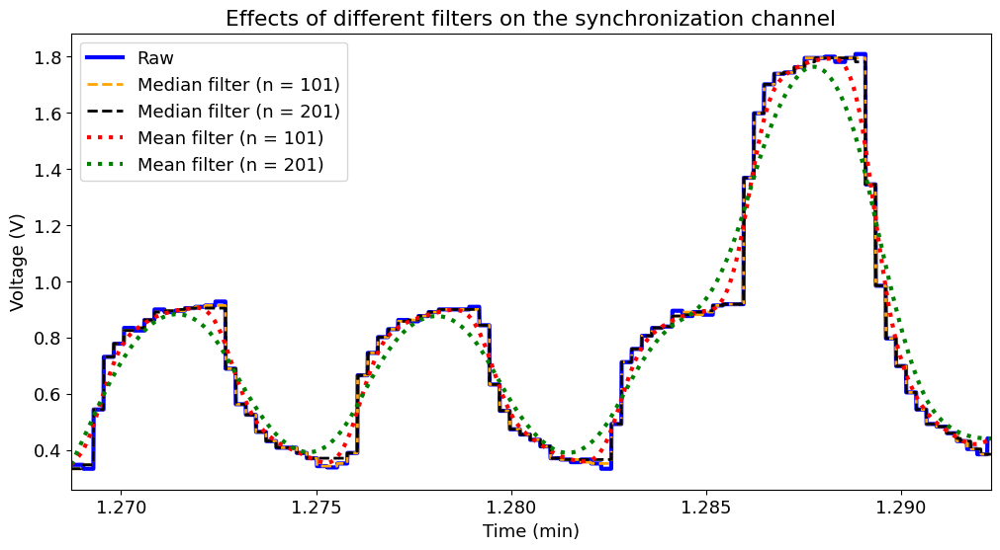

In [14]:

ldr_ch_snip = ldr_ch[0][155900:158800]
time_snip = time[155900:158800]/60

figure(figsize = (12,6))
plt.plot(time_snip, ldr_ch_snip, "b", linewidth = 3, label = "Raw");
plt.plot(time_snip, scipy.signal.medfilt(ldr_ch_snip, 101), "orange", linestyle = "--",linewidth = 2, label = "Median filter (n = 101)");
plt.plot(time_snip, scipy.signal.medfilt(ldr_ch_snip, 201), "k--", linewidth = 2, label = "Median filter (n = 201)");
plt.plot(time_snip, moving_aver(ldr_ch_snip, 101), "r:", linewidth = 3, label = "Mean filter (n = 101)");
plt.plot(time_snip, moving_aver(ldr_ch_snip, 201), "g:", linewidth = 3, label = "Mean filter (n = 201)");


plt.title("Effects of different filters on the synchronization channel")
plt.xlabel("Time (min)")
plt.ylabel("Voltage (V)")
plt.xlim([np.min(time_snip), np.max(time_snip)])
plt.legend()

plt.show()


A 201 points median filter seems to be enough to smooth the signal without causing phase shifts

## Filtering the LDR channel based on the best approach to smooth the signal without altering the edges' instances (Median filter)


Subject 1: Filtering LDR channel
Average Voltage (LDR):  0.7292844354642669

Subject 2: Filtering LDR channel
Average Voltage (LDR):  0.6768032906697121

Subject 3: Filtering LDR channel
Average Voltage (LDR):  0.680165544381612

Subject 4: Filtering LDR channel
Average Voltage (LDR):  0.6981070557607474

Subject 5: Filtering LDR channel
Average Voltage (LDR):  0.7662514124237979

Subject 6: Filtering LDR channel
Average Voltage (LDR):  0.689864422373897


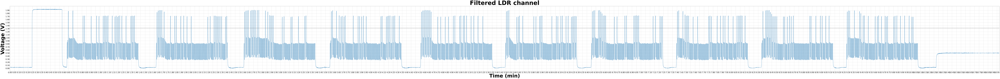

In [15]:
n_filt = 201

segmentation_filt_LDRs = []

for subj in range(NUM_SUBJ):

    print(f"\nSubject {subj + 1}: Filtering LDR channel")
    print("Average Voltage (LDR): ", np.mean(segmentation_LDRs[subj]))

    filt_ldr_ch = scipy.signal.medfilt(segmentation_LDRs[subj][:][0], n_filt) 
    # The filter applies a zero pad automatically at the edges

    segmentation_filt_LDRs.append(filt_ldr_ch)

plot_isolated_signal(time/60, filt_ldr_ch, th, "Filtered LDR channel")
plt.show()

Text(0.5, 0, 'Time (min)')

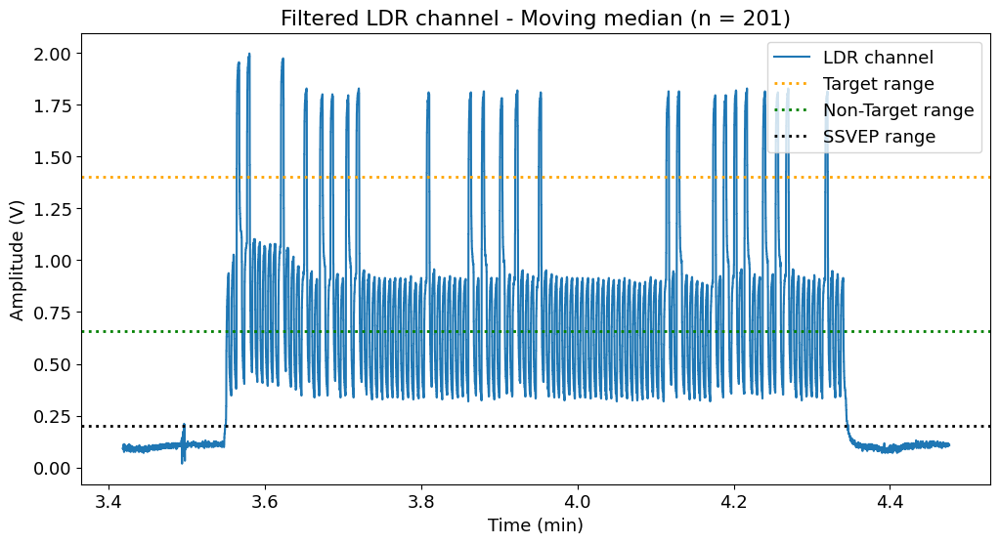

In [16]:
figure(figsize = (12,6));
plt.plot(time[420000: 550000]/60, segmentation_LDRs[-1][0,420000: 550000], label = "LDR channel");
#plt.xlim([time[28000]/60, time[177000]/60]);
plt.axhline(y = th, linestyle = ':', color = 'orange', linewidth = 2, label = "Target range")
plt.axhline(y = 0.66, linestyle = ':', color = 'g', linewidth = 2, label = "Non-Target range")
plt.axhline(y = 0.2, linestyle = ':', color = 'k', linewidth = 2, label = "SSVEP range")
plt.legend()

plt.title("Filtered LDR channel - Moving median (n = 201)");
plt.ylabel("Amplitude (V)")
plt.xlabel("Time (min)")

# **Segmenting the EEG**

## Detecting the edges on the LDR channel

In [17]:
def condition_segmentation(ldr, th):
    
    last_low = True
    last_high = False
    
    rising_edges = []
    falling_edges = []

    for index, val in enumerate(ldr):

        if val >= th: # Possible rising edge
            if last_low: # Found rising edge
                rising_edges.append(index) 
            
            last_low = False
            last_high = True
        
        elif val <= th: # Possible falling edge
            if last_high:
                falling_edges.append(index)

            last_low = True
            last_high = False

    return rising_edges, falling_edges

In [18]:
d_th = th - 0.1 # Divinding the LDR channel in the target and non target range
t_th = th

nt_th = 0.66
ssvep_th = 0.23

NUM_BLOCKS = 10

all_t_rising_edges = []
all_t_falling_edges = []

all_nt_rising_edges = []
all_nt_falling_edges = []

all_ssvep_rising_edges = []
all_ssvep_falling_edges = []

for subj in range(NUM_SUBJ):

    # Target trials
    target_range = [val if val >= d_th else d_th for val in segmentation_filt_LDRs[subj]]
    t_rising_edges, t_falling_edges = condition_segmentation(target_range, t_th)

    all_t_rising_edges.append(t_rising_edges)
    all_t_falling_edges.append(t_falling_edges)

    # Non target trials
    nontarget_range = [val if val <= d_th else d_th for val in segmentation_filt_LDRs[subj]]
    nt_rising_edges, nt_falling_edges = condition_segmentation(nontarget_range, nt_th)

    if(len(nt_rising_edges) > len(nt_falling_edges)):
        nt_rising_edges.pop(-1)

    all_nt_rising_edges.append(nt_rising_edges)
    all_nt_falling_edges.append(nt_falling_edges)

    # SSVEP trial blocks
    trialBlock_range = [val if val <= ssvep_th else d_th for val in segmentation_filt_LDRs[subj]]
    ssvep_rising_edges, ssvep_falling_edges = condition_segmentation(trialBlock_range, ssvep_th - 0.03)

    ssvep_rising_edges.pop(0), ssvep_falling_edges.pop(0)# EMG edges

    if (len(ssvep_rising_edges) > NUM_BLOCKS):
        ssvep_rising_edges.pop(-1) # After finishing the protocol there is one non-relevant rising edge

    all_ssvep_rising_edges.append(ssvep_rising_edges)
    all_ssvep_falling_edges.append(ssvep_falling_edges)


'''
plot_isolated_signal(time/60, filt_ldr_ch, t_th, "Filtered LDR channel with target segmentation")
for idx, start_sample in enumerate(t_rising_edges):
    print(f"Block nº {idx+1} size: {len(filt_ldr_ch[t_rising_edges[idx]:t_falling_edges[idx]])/fs}")
    plt.axvline(x = start_sample/fs/60, color = 'g', linestyle = ':', linewidth = 2)
    plt.axvline(x = t_falling_edges[idx]/fs/60, color = 'r', linestyle = ':', linewidth = 2)
plt.show()


plot_isolated_signal(time/60, filt_ldr_ch, nt_th, "Filtered LDR channel with non-target segmentation")
for idx, start_sample in enumerate(nt_rising_edges):
    print(f"Block nº {idx+1} size: {len(filt_ldr_ch[nt_rising_edges[idx]:nt_falling_edges[idx]])/fs}")
    plt.axvline(x = start_sample/fs/60, color = 'g', linestyle = ':', linewidth = 2)
    plt.axvline(x = nt_falling_edges[idx]/fs/60, color = 'r', linestyle = ':', linewidth = 2)
plt.show()
'''

'\nplot_isolated_signal(time/60, filt_ldr_ch, t_th, "Filtered LDR channel with target segmentation")\nfor idx, start_sample in enumerate(t_rising_edges):\n    print(f"Block nº {idx+1} size: {len(filt_ldr_ch[t_rising_edges[idx]:t_falling_edges[idx]])/fs}")\n    plt.axvline(x = start_sample/fs/60, color = \'g\', linestyle = \':\', linewidth = 2)\n    plt.axvline(x = t_falling_edges[idx]/fs/60, color = \'r\', linestyle = \':\', linewidth = 2)\nplt.show()\n\n\nplot_isolated_signal(time/60, filt_ldr_ch, nt_th, "Filtered LDR channel with non-target segmentation")\nfor idx, start_sample in enumerate(nt_rising_edges):\n    print(f"Block nº {idx+1} size: {len(filt_ldr_ch[nt_rising_edges[idx]:nt_falling_edges[idx]])/fs}")\n    plt.axvline(x = start_sample/fs/60, color = \'g\', linestyle = \':\', linewidth = 2)\n    plt.axvline(x = nt_falling_edges[idx]/fs/60, color = \'r\', linestyle = \':\', linewidth = 2)\nplt.show()\n'

# **Frequency tagging and SNR estimation of the SSVEP component on the EEG comprised by the 14 trial blocks**
https://mne.tools/dev/auto_tutorials/time-freq/50_ssvep.html

In [19]:
all_ssvep_epochs = []

events_id = dict(trialBlocks=0)

for subj in range(NUM_SUBJ):

    print(f"\n------ Subject {subj + 1}: SSVEP Epochs ------")

    ssvep_events = []
    for tb in range(len(all_ssvep_rising_edges[subj])):
        ssvep_events.append([all_ssvep_rising_edges[subj][tb], 0 , 0])

    tmax = round((all_ssvep_falling_edges[subj][0] - all_ssvep_rising_edges[subj][0])/fs,0)
    print("Window size: ", tmax)

    ssvep_epochs = mne.Epochs(rereferenced_EEGs[subj], 
                              ssvep_events, 
                              event_id = events_id, 
                              tmin = 0, 
                              tmax = tmax, 
                              baseline=None, 
                              event_repeated = 'error')
    
    all_ssvep_epochs.append(ssvep_epochs)


------ Subject 1: SSVEP Epochs ------
Window size:  48.0
Not setting metadata
10 matching events found
No baseline correction applied
0 projection items activated

------ Subject 2: SSVEP Epochs ------
Window size:  48.0
Not setting metadata
10 matching events found
No baseline correction applied
0 projection items activated

------ Subject 3: SSVEP Epochs ------
Window size:  48.0
Not setting metadata
10 matching events found
No baseline correction applied
0 projection items activated

------ Subject 4: SSVEP Epochs ------
Window size:  48.0
Not setting metadata
10 matching events found
No baseline correction applied
0 projection items activated

------ Subject 5: SSVEP Epochs ------
Window size:  48.0
Not setting metadata
10 matching events found
No baseline correction applied
0 projection items activated

------ Subject 6: SSVEP Epochs ------
Window size:  48.0
Not setting metadata
10 matching events found
No baseline correction applied
0 projection items activated


### Calculate power spectral density (PSD)

In [20]:
tmin = 1 # SSVEP response can often take a while to stabilize and the transient phase in the beginning can distort the signal estimate.
fmin = 1
fmax = 28

all_psds = []

for subj in range(NUM_SUBJ):

    spectrum = all_ssvep_epochs[subj].compute_psd("welch",
                                                  n_fft=int(fs * (tmax - tmin)),
                                                  n_overlap=0,
                                                  n_per_seg=None,
                                                  tmin=tmin,
                                                  tmax=tmax,
                                                  fmin=fmin,
                                                  fmax=fmax,
                                                  window="boxcar",
                                                  verbose=False)

    psds, freqs = spectrum.get_data(return_freqs=True)

    all_psds.append(psds)

### Calculate signal to noise ratio (SNR)

In [21]:
def snr_spectrum(psd, noise_n_neighbor_freqs=3, noise_skip_neighbor_freqs=1):
    """Compute SNR spectrum from PSD spectrum using convolution.

    Parameters
    ----------
    psd : ndarray, shape ([n_trials, n_channels,] n_frequency_bins)
        Data object containing PSD values. Works with arrays as produced by
        MNE's PSD functions or channel/trial subsets.
    noise_n_neighbor_freqs : int
        Number of neighboring frequencies used to compute noise level.
        increment by one to add one frequency bin ON BOTH SIDES
    noise_skip_neighbor_freqs : int
        set this >=1 if you want to exclude the immediately neighboring
        frequency bins in noise level calculation

    Returns
    -------
    snr : ndarray, shape ([n_trials, n_channels,] n_frequency_bins)
        Array containing SNR for all epochs, channels, frequency bins.
        NaN for frequencies on the edges, that do not have enough neighbors on
        one side to calculate SNR.
    """
    # Construct a kernel that calculates the mean of the neighboring
    # frequencies
    averaging_kernel = np.concatenate(
        (
            np.ones(noise_n_neighbor_freqs),
            np.zeros(2 * noise_skip_neighbor_freqs + 1),
            np.ones(noise_n_neighbor_freqs),
        )
    )
    averaging_kernel /= averaging_kernel.sum()

    # Calculate the mean of the neighboring frequencies by convolving with the
    # averaging kernel.
    mean_noise = np.apply_along_axis(
        lambda psd_: np.convolve(psd_, averaging_kernel, mode="valid"), axis=-1, arr=psd
    )

    # The mean is not defined on the edges so we will pad it with nas. The
    # padding needs to be done for the last dimension only so we set it to
    # (0, 0) for the other ones.
    edge_width = noise_n_neighbor_freqs + noise_skip_neighbor_freqs
    pad_width = [(0, 0)] * (mean_noise.ndim - 1) + [(edge_width, edge_width)]
    mean_noise = np.pad(mean_noise, pad_width=pad_width, constant_values=np.nan)

    return psd / mean_noise

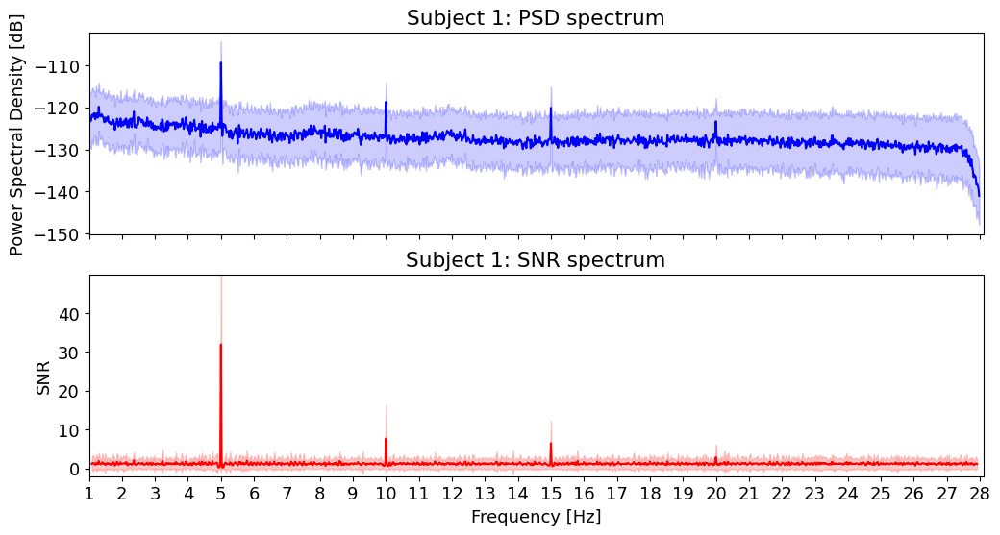

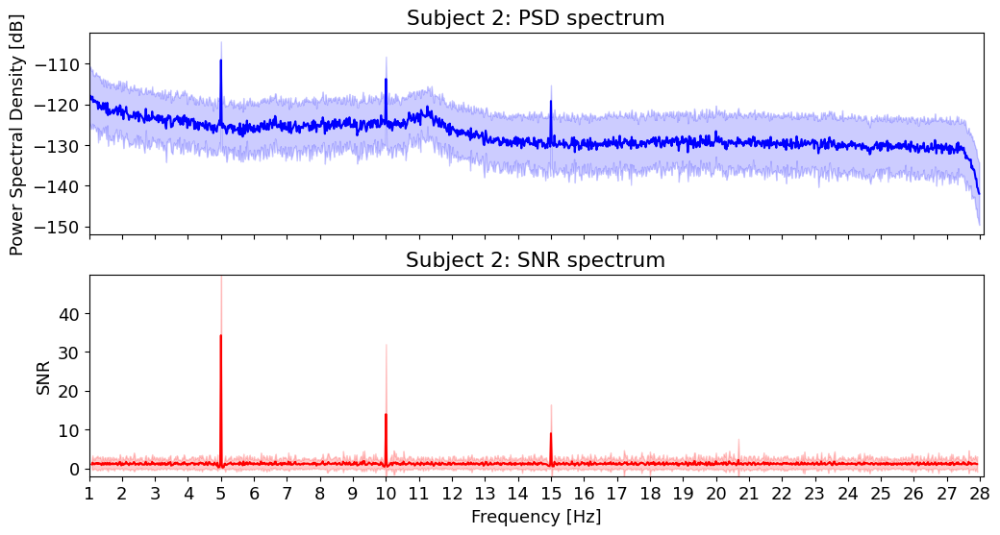

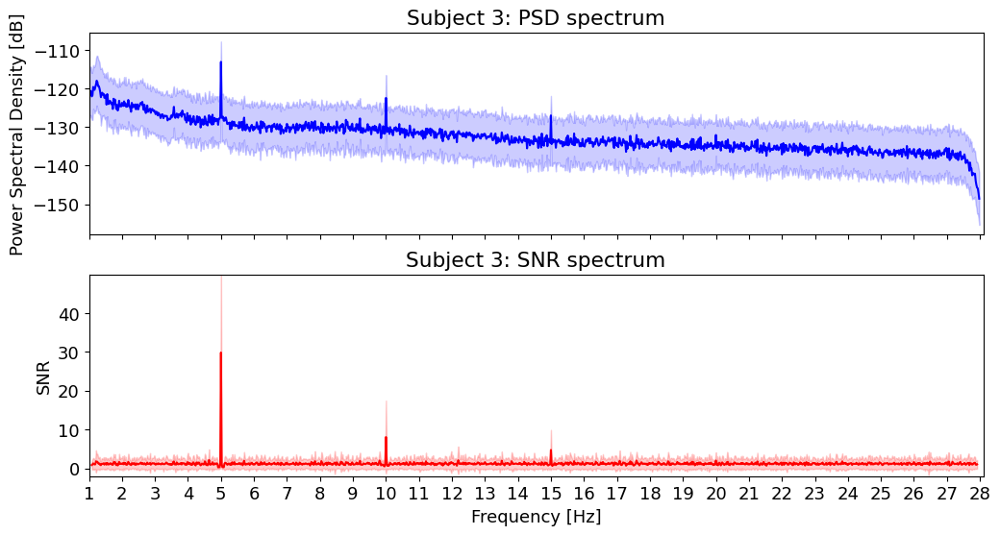

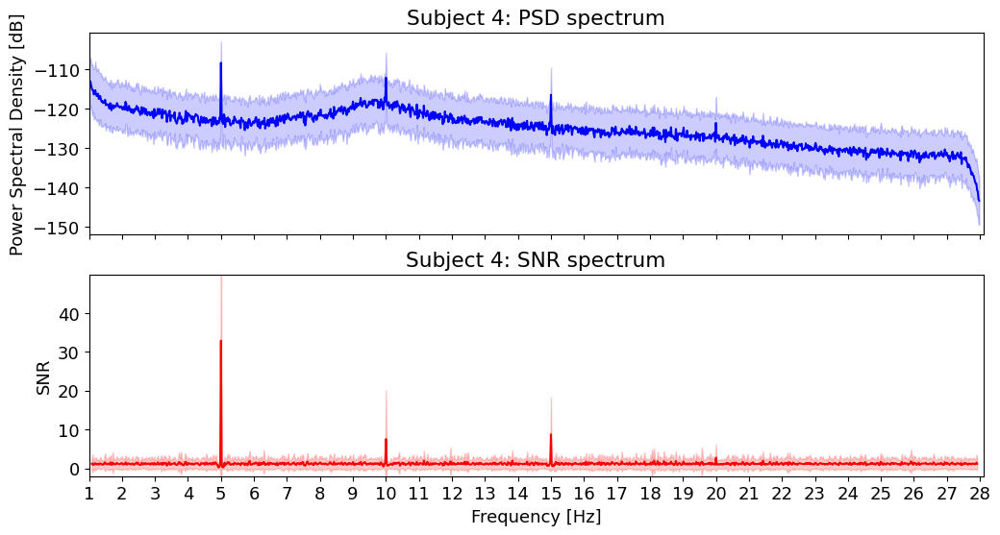

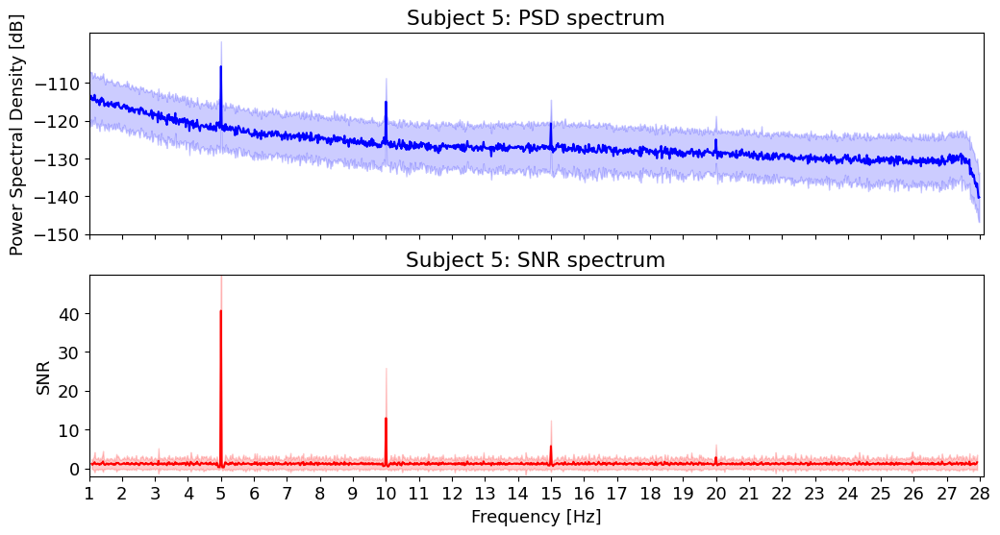

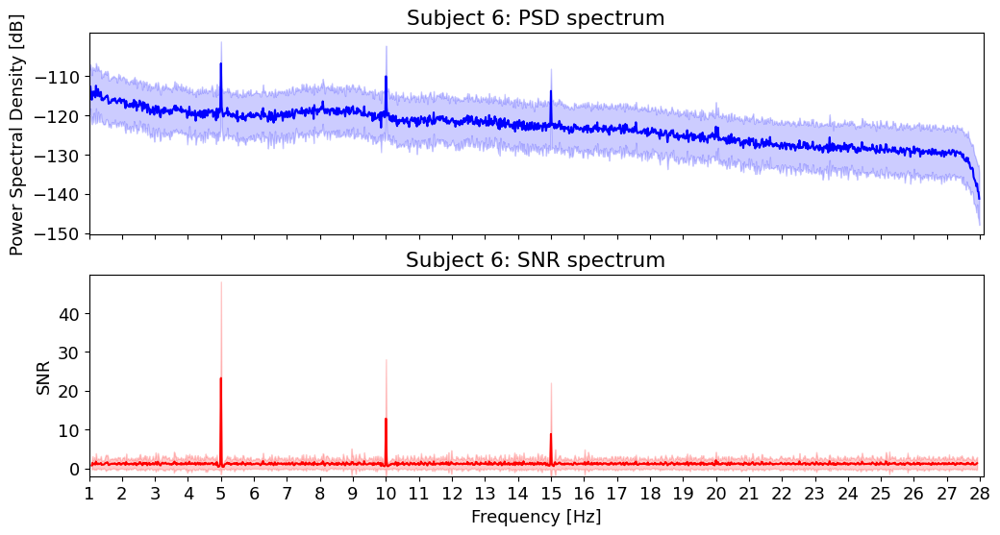

In [22]:
all_snrs = []

for subj in range(NUM_SUBJ):   

    snrs = snr_spectrum(all_psds[subj], noise_n_neighbor_freqs=3, noise_skip_neighbor_freqs=1)
    all_snrs.append(snrs)

    fig, axes = plt.subplots(2, 1, sharex="all", sharey="none", figsize=(12, 6));
    freq_range = range(
        np.where(np.floor(freqs) == 1.0)[0][0],  np.where(np.ceil(freqs) == fmax)[0][-1]
    )

    psds_plot = 10 * np.log10(all_psds[subj])
    psds_mean = psds_plot.mean(axis=(0, 1))[freq_range]
    psds_std = psds_plot.std(axis=(0, 1))[freq_range]
    axes[0].plot(freqs[freq_range], psds_mean, color="b");
    axes[0].fill_between(
        freqs[freq_range], psds_mean - psds_std, psds_mean + psds_std, color="b", alpha=0.2
    );
    axes[0].set(title=f"Subject {subj + 1}: PSD spectrum", 
                ylabel="Power Spectral Density [dB]",
                xticks = np.arange(fmin, fmax + 0.1, 0.5),
                yticks = np.arange(-150, -100, 10));

    # SNR spectrum
    snr_mean = snrs.mean(axis=(0, 1))[freq_range]
    snr_std = snrs.std(axis=(0, 1))[freq_range]

    axes[1].plot(freqs[freq_range], snr_mean, color="r")
    axes[1].fill_between(
        freqs[freq_range], snr_mean - snr_std, snr_mean + snr_std, color="r", alpha=0.2
    );
    axes[1].set(
        title=f"Subject {subj + 1}: SNR spectrum",
        xlabel="Frequency [Hz]",
        ylabel="SNR",
        ylim=[-2, 50],
        xlim=[fmin, fmax + 0.1],
        xticks = np.arange(fmin, fmax + 0.1, 1),
        yticks = np.arange(0, 50, 10)
    );
    plt.show();

### Extract SNR values at the stimulation frequency

In [23]:
stim_freq = 5 # Hz
harmonic1 = 10
harmonic2 = 15

# Find index of frequency bin closest to stimulation frequency and its harmonics
i_bin_5hz = np.argmin(abs(freqs - stim_freq))
i_bin_10hz = np.argmin(abs(freqs - harmonic1))
i_bin_15hz = np.argmin(abs(freqs - harmonic2))

# Define different ROIs
roi_vis = [
    "POz",
    "Oz",
    "O1",
    "O2"
]  # visual roi

# Find corresponding indices using mne.pick_types()
picks_roi_vis = mne.pick_types(all_ssvep_epochs[subj].info, 
                               eeg=True, 
                               stim=False, 
                               selection=roi_vis
)

all_snrs_target = []
all_snrs_target_h1 = []
all_snrs_target_h2 = []

for subj in range(NUM_SUBJ):

    print(f"Subject {subj + 1}: Average SNR")

    snrs_target = all_snrs[subj][:, :, i_bin_5hz][:, picks_roi_vis]
    all_snrs_target.append(snrs_target)
    print("SNR at 5 Hz")
    print(f"Average SNR (occipital ROI): {snrs_target.mean()}")

    snrs_target_h1 = all_snrs[subj][:, :, i_bin_10hz][:, picks_roi_vis]
    all_snrs_target_h1.append(snrs_target_h1)
    print("SNR at 10 Hz")
    print(f"Average SNR (occipital ROI): {snrs_target_h1.mean()}")

    snrs_target_h2 = all_snrs[subj][:, :, i_bin_15hz][:, picks_roi_vis]
    all_snrs_target_h2.append(snrs_target_h2)
    print("SNR at 15 Hz")
    print(f"Average SNR (occipital ROI): {snrs_target_h2.mean()}")

    print("\n")


Subject 1: Average SNR
SNR at 5 Hz
Average SNR (occipital ROI): 33.368241298529554
SNR at 10 Hz
Average SNR (occipital ROI): 10.028985673979253
SNR at 15 Hz
Average SNR (occipital ROI): 2.9408358243395463


Subject 2: Average SNR
SNR at 5 Hz
Average SNR (occipital ROI): 41.425306741747704
SNR at 10 Hz
Average SNR (occipital ROI): 15.18820836530223
SNR at 15 Hz
Average SNR (occipital ROI): 13.145325399045632


Subject 3: Average SNR
SNR at 5 Hz
Average SNR (occipital ROI): 36.32278675109252
SNR at 10 Hz
Average SNR (occipital ROI): 8.893821830325875
SNR at 15 Hz
Average SNR (occipital ROI): 6.813899732527062


Subject 4: Average SNR
SNR at 5 Hz
Average SNR (occipital ROI): 34.087383413075614
SNR at 10 Hz
Average SNR (occipital ROI): 6.578495611644348
SNR at 15 Hz
Average SNR (occipital ROI): 6.345794035933197


Subject 5: Average SNR
SNR at 5 Hz
Average SNR (occipital ROI): 89.65235162285164
SNR at 10 Hz
Average SNR (occipital ROI): 16.653489729933682
SNR at 15 Hz
Average SNR (occipital

### Topography of the SSVEP (Main frequency - 5Hz)

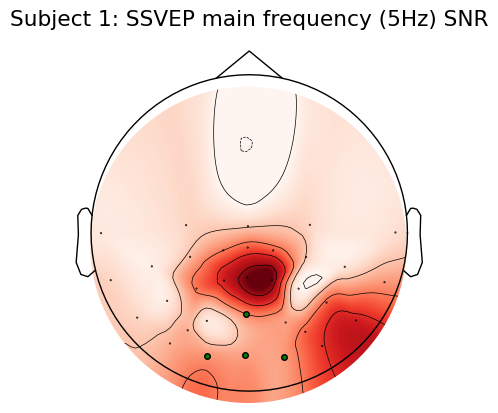

Subject 1: SNR at 5 Hz SSVEP stumulation
average SNR (all channels): 31.944572675092957
average SNR (occipital ROI): 33.368241298529554


Is the 5 Hz SNR in occipital ROI significantly larger than 5 Hz SNR over all?

----------- No ------------

Stats: t = 0.325, p = 0.753




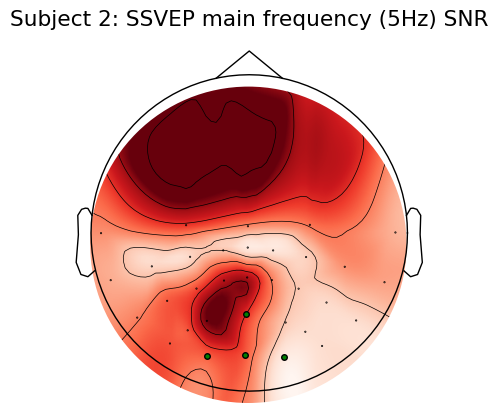

Subject 2: SNR at 5 Hz SSVEP stumulation
average SNR (all channels): 34.311443619986264
average SNR (occipital ROI): 41.425306741747704


Is the 5 Hz SNR in occipital ROI significantly larger than 5 Hz SNR over all?

----------- No ------------

Stats: t = 2.146, p = 0.060




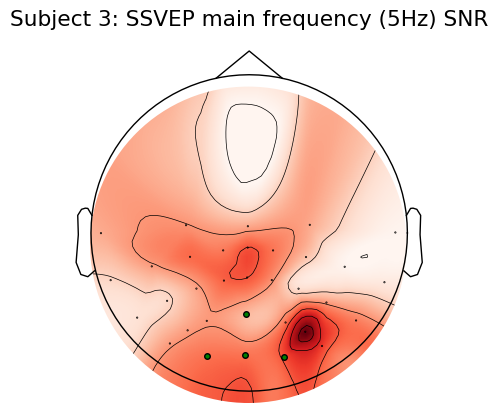

Subject 3: SNR at 5 Hz SSVEP stumulation
average SNR (all channels): 29.86773506168233
average SNR (occipital ROI): 36.32278675109252


Is the 5 Hz SNR in occipital ROI significantly larger than 5 Hz SNR over all?

----------- No ------------

Stats: t = 1.409, p = 0.193




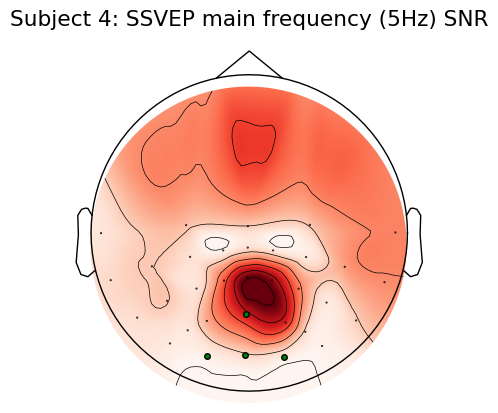

Subject 4: SNR at 5 Hz SSVEP stumulation
average SNR (all channels): 32.92442035777911
average SNR (occipital ROI): 34.087383413075614


Is the 5 Hz SNR in occipital ROI significantly larger than 5 Hz SNR over all?

----------- No ------------

Stats: t = 0.379, p = 0.714




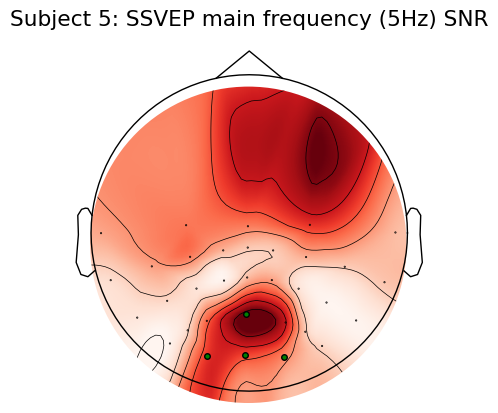

Subject 5: SNR at 5 Hz SSVEP stumulation
average SNR (all channels): 40.643123017169906
average SNR (occipital ROI): 89.65235162285164


Is the 5 Hz SNR in occipital ROI significantly larger than 5 Hz SNR over all?

----------- Yes -----------

Stats: t = 6.194, p = 0.000




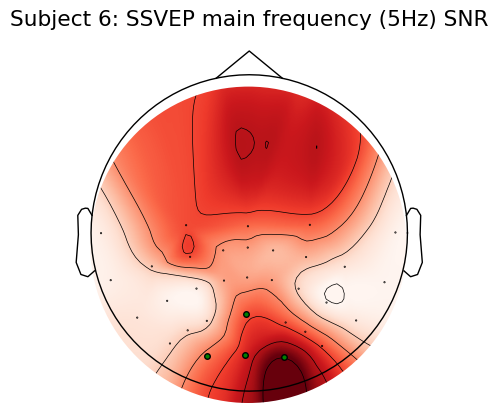

Subject 6: SNR at 5 Hz SSVEP stumulation
average SNR (all channels): 23.28074369862121
average SNR (occipital ROI): 50.380892858883726


Is the 5 Hz SNR in occipital ROI significantly larger than 5 Hz SNR over all?

----------- Yes -----------

Stats: t = 4.883, p = 0.001




In [24]:
from scipy.stats import ttest_rel

# Mask to highlight electrodes on the region of interest
roi_vis_idx = pick_channels(clean_ch, roi_vis)

mk = dict(marker='o', 
          markerfacecolor='g', 
          markeredgecolor='k',
          linewidth=0, 
          markersize=4)

highlight_ch = [1 if c in roi_vis_idx else 0 for c in range(len(clean_ch))]

for subj in range(NUM_SUBJ):

    # Get average SNR at 5 Hz for ALL channels
    snrs_5hz = all_snrs[subj][:, :, i_bin_5hz]
    snrs_5hz_ch_average = snrs_5hz.mean(axis=0)

    # Plot SNR topography
    fig, ax = plt.subplots(1)
    ax.set_title(f"Subject {subj + 1}: SSVEP main frequency (5Hz) SNR")
    mne.viz.plot_topomap(snrs_5hz_ch_average, 
                         all_ssvep_epochs[subj][subj].info,
                         mask = np.array(highlight_ch), 
                         mask_params = mk,
                         vlim=(1, None), 
                         axes=ax, 
                         size = 10,
                         sphere=(0.0011, 0.015, 0.12, 0.2))

    print(f"Subject {subj +1}: SNR at 5 Hz SSVEP stumulation")
    print(f"average SNR (all channels): {snrs_5hz_ch_average.mean()}")
    print(f"average SNR (occipital ROI): {all_snrs_target[subj].mean()}")
    print("\n")

    tstat_roi_vs_scalp = ttest_rel(all_snrs_target[subj].mean(axis=1), snrs_5hz.mean(axis=1))
    print("Is the 5 Hz SNR in occipital ROI significantly larger than 5 Hz SNR over all?")

    if(tstat_roi_vs_scalp[1] > 0.05):
        print("\n----------- No ------------\n")
    else:
        print("\n----------- Yes -----------\n")

    print(f"Stats: t = {tstat_roi_vs_scalp[0]:.3f}, p = {tstat_roi_vs_scalp[1]:.3f}\n\n")

### 1st Harmonic (10 Hz)

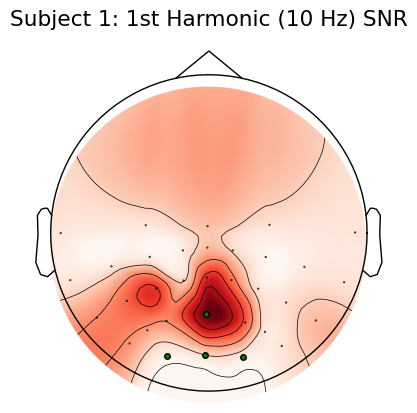

Subject 1: SNR at 5 Hz SSVEP stumulation
average SNR (all channels): 7.687349439419574
average SNR (occipital ROI): 10.028985673979253


Is the 5 Hz SNR in occipital ROI significantly larger than 10 Hz SNR over all?

----------- No ------------

Stats: t = 1.775, p = 0.110




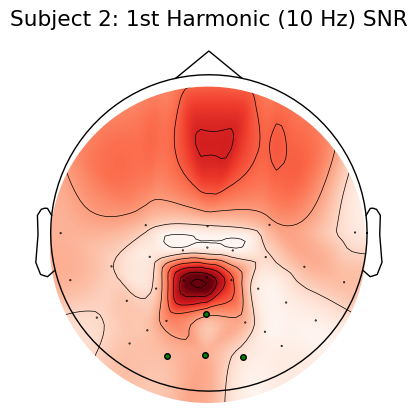

Subject 2: SNR at 5 Hz SSVEP stumulation
average SNR (all channels): 13.98401051588644
average SNR (occipital ROI): 15.18820836530223


Is the 5 Hz SNR in occipital ROI significantly larger than 10 Hz SNR over all?

----------- No ------------

Stats: t = 0.533, p = 0.607




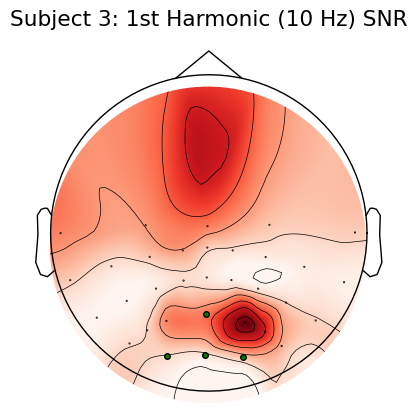

Subject 3: SNR at 5 Hz SSVEP stumulation
average SNR (all channels): 8.080830668887103
average SNR (occipital ROI): 8.893821830325875


Is the 5 Hz SNR in occipital ROI significantly larger than 10 Hz SNR over all?

----------- No ------------

Stats: t = 0.685, p = 0.510




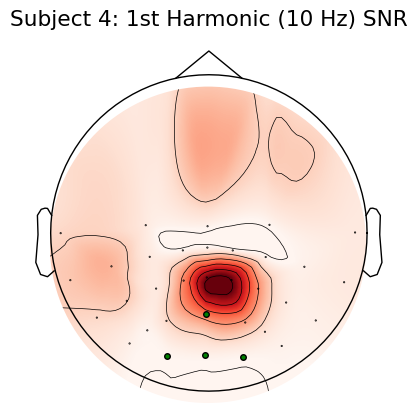

Subject 4: SNR at 5 Hz SSVEP stumulation
average SNR (all channels): 7.545409316947885
average SNR (occipital ROI): 6.578495611644348


Is the 5 Hz SNR in occipital ROI significantly larger than 10 Hz SNR over all?

----------- No ------------

Stats: t = -0.738, p = 0.479




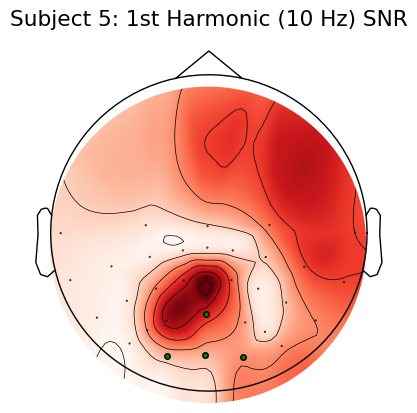

Subject 5: SNR at 5 Hz SSVEP stumulation
average SNR (all channels): 12.959478176565405
average SNR (occipital ROI): 16.653489729933682


Is the 5 Hz SNR in occipital ROI significantly larger than 10 Hz SNR over all?

----------- Yes -----------

Stats: t = 4.141, p = 0.003




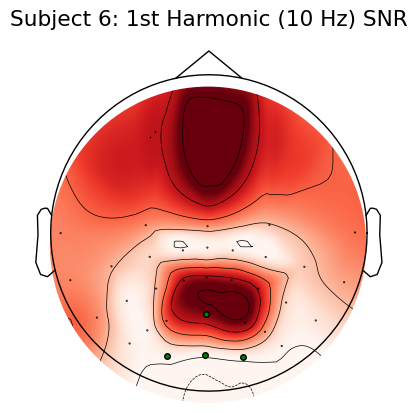

Subject 6: SNR at 5 Hz SSVEP stumulation
average SNR (all channels): 12.850456297230972
average SNR (occipital ROI): 11.058549923063328


Is the 5 Hz SNR in occipital ROI significantly larger than 10 Hz SNR over all?

----------- No ------------

Stats: t = -1.129, p = 0.288




In [25]:

for subj in range(NUM_SUBJ):

    # Get average SNR at 5 Hz for ALL channels
    snrs_10hz = all_snrs[subj][:, :, i_bin_10hz]
    snrs_10hz_ch_average = snrs_10hz.mean(axis=0)

    # Plot SNR topography
    fig, ax = plt.subplots(1)
    ax.set_title(f"Subject {subj + 1}: 1st Harmonic (10 Hz) SNR")
    mne.viz.plot_topomap(snrs_10hz_ch_average, 
                         all_ssvep_epochs[subj][subj].info, 
                         mask = np.array(highlight_ch), 
                         mask_params = mk,
                         vlim=(1, None),
                         axes=ax,
                         size = 10,
                         sphere=(0.0011, 0.015, 0.12, 0.2))

    print(f"Subject {subj +1}: SNR at 5 Hz SSVEP stumulation")
    print(f"average SNR (all channels): {snrs_10hz_ch_average.mean()}")
    print(f"average SNR (occipital ROI): {all_snrs_target_h1[subj].mean()}")
    print("\n")

    tstat_roi_vs_scalp = ttest_rel(all_snrs_target_h1[subj].mean(axis=1), snrs_10hz.mean(axis=1))
    print("Is the 5 Hz SNR in occipital ROI significantly larger than 10 Hz SNR over all?")

    if(tstat_roi_vs_scalp[1] > 0.05):
        print("\n----------- No ------------\n")
    else:
        print("\n----------- Yes -----------\n")

    print(f"Stats: t = {tstat_roi_vs_scalp[0]:.3f}, p = {tstat_roi_vs_scalp[1]:.3f}\n\n")

### 2nd Harmonic (15 Hz)

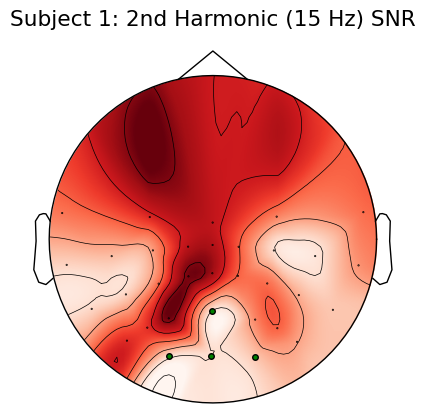

Subject 1: SNR at 5 Hz SSVEP stimulation
average SNR (all channels): 6.4793148112754855
average SNR (occipital ROI): 2.9408358243395463


Is the 5 Hz SNR in occipital ROI significantly larger than 15 Hz SNR over all?

----------- Yes -----------

Stats: t = -4.734, p = 0.001




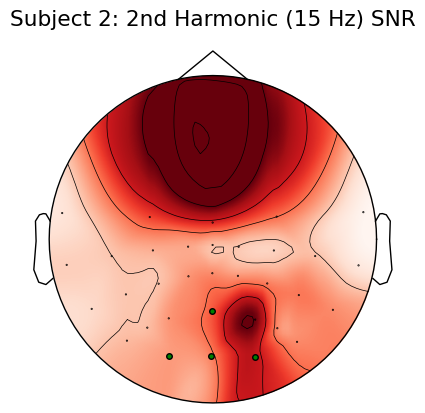

Subject 2: SNR at 5 Hz SSVEP stimulation
average SNR (all channels): 9.028358298801317
average SNR (occipital ROI): 13.145325399045632


Is the 5 Hz SNR in occipital ROI significantly larger than 15 Hz SNR over all?

----------- Yes -----------

Stats: t = 3.948, p = 0.003




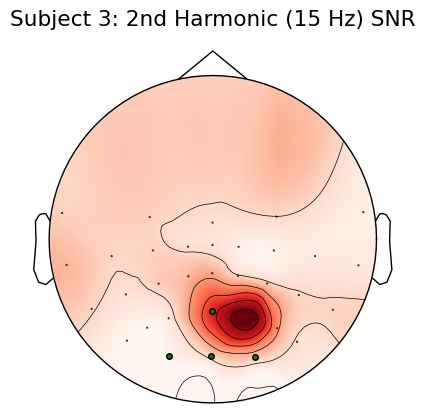

Subject 3: SNR at 5 Hz SSVEP stimulation
average SNR (all channels): 4.743838986843984
average SNR (occipital ROI): 6.813899732527062


Is the 5 Hz SNR in occipital ROI significantly larger than 15 Hz SNR over all?

----------- Yes -----------

Stats: t = 2.369, p = 0.042




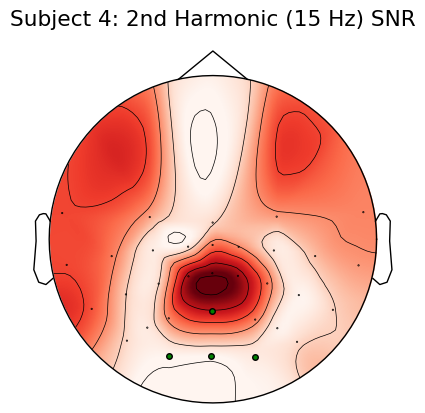

Subject 4: SNR at 5 Hz SSVEP stimulation
average SNR (all channels): 8.770739955428054
average SNR (occipital ROI): 6.345794035933197


Is the 5 Hz SNR in occipital ROI significantly larger than 15 Hz SNR over all?

----------- Yes -----------

Stats: t = -2.401, p = 0.040




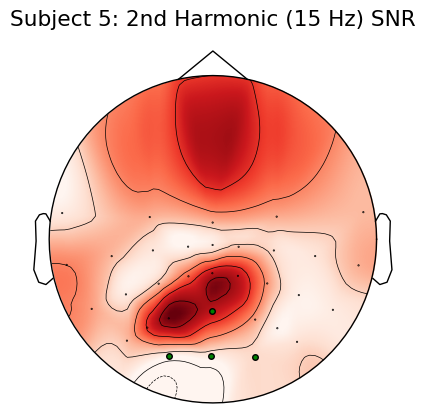

Subject 5: SNR at 5 Hz SSVEP stimulation
average SNR (all channels): 5.7484476397942155
average SNR (occipital ROI): 5.636168324867135


Is the 5 Hz SNR in occipital ROI significantly larger than 15 Hz SNR over all?

----------- No ------------

Stats: t = -0.251, p = 0.808




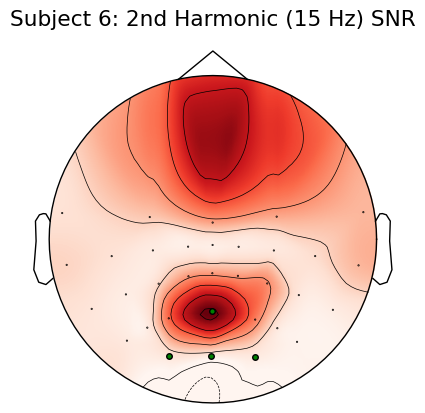

Subject 6: SNR at 5 Hz SSVEP stimulation
average SNR (all channels): 8.862342855731793
average SNR (occipital ROI): 13.818280944453198


Is the 5 Hz SNR in occipital ROI significantly larger than 15 Hz SNR over all?

----------- No ------------

Stats: t = 1.817, p = 0.103




In [26]:
for subj in range(NUM_SUBJ):
      
    # Get average SNR at 5 Hz for ALL channels
    snrs_15hz = all_snrs[subj][:, :, i_bin_15hz]
    snrs_15hz_ch_average = snrs_15hz.mean(axis=0)

    # Plot SNR topography
    fig, ax = plt.subplots(1)
    ax.set_title(f"Subject {subj + 1}: 2nd Harmonic (15 Hz) SNR")
    mne.viz.plot_topomap(snrs_15hz_ch_average, 
                        all_ssvep_epochs[subj].info, 
                        mask = np.array(highlight_ch), 
                        mask_params = mk,
                        vlim=(1, None), 
                        axes=ax,
                        size = 10,
                        sphere=(-0.001, 0.0001, 0.12, 0.2))

    print(f"Subject {subj +1}: SNR at 5 Hz SSVEP stimulation")
    print(f"average SNR (all channels): {snrs_15hz_ch_average.mean()}")
    print(f"average SNR (occipital ROI): {all_snrs_target_h2[subj].mean()}")
    print("\n")

    tstat_roi_vs_scalp = ttest_rel(all_snrs_target_h2[subj].mean(axis=1), snrs_15hz.mean(axis=1))
    print("Is the 5 Hz SNR in occipital ROI significantly larger than 15 Hz SNR over all?")

    if(tstat_roi_vs_scalp[1] > 0.05):
        print("\n----------- No ------------\n")
    else:
        print("\n----------- Yes -----------\n")

    print(f"Stats: t = {tstat_roi_vs_scalp[0]:.3f}, p = {tstat_roi_vs_scalp[1]:.3f}\n\n")

# **ICA**
https://mne.tools/mne-icalabel/stable/generated/examples/00_iclabel.html

In [27]:
'''
from mne_icalabel import label_components

raw_template = EEGs[0].copy().crop(tmin = all_emg_begin_sample[0]/fs, tmax = all_ssvep_falling_edges[0][-1]/fs).pick(eeg_ch_idx).get_data()
raw_temp = mne.io.RawArray(raw_template, new_info)

copy_raw_data = EEGs[0].copy().crop(tmin = all_emg_begin_sample[0]/fs, tmax = all_ssvep_falling_edges[0][-1]/fs).pick(eeg_ch_idx).get_data()
copy_raw = mne.io.RawArray(copy_raw_data, new_info)
copy_raw.set_montage('standard_1005')
copy_raw.set_eeg_reference("average")
filt_raw = copy_raw.filter(l_freq=1.0, h_freq=100.0)
'''


'\nfrom mne_icalabel import label_components\n\nraw_template = EEGs[0].copy().crop(tmin = all_emg_begin_sample[0]/fs, tmax = all_ssvep_falling_edges[0][-1]/fs).pick(eeg_ch_idx).get_data()\nraw_temp = mne.io.RawArray(raw_template, new_info)\n\ncopy_raw_data = EEGs[0].copy().crop(tmin = all_emg_begin_sample[0]/fs, tmax = all_ssvep_falling_edges[0][-1]/fs).pick(eeg_ch_idx).get_data()\ncopy_raw = mne.io.RawArray(copy_raw_data, new_info)\ncopy_raw.set_montage(\'standard_1005\')\ncopy_raw.set_eeg_reference("average")\nfilt_raw = copy_raw.filter(l_freq=1.0, h_freq=100.0)\n'

In [28]:
'''

ica = ICA(
    n_components=33,
    max_iter="auto",
    method="infomax",
    random_state=42,
    fit_params=dict(extended=True),
)

ica.fit(filt_raw)

'''

'\n\nica = ICA(\n    n_components=33,\n    max_iter="auto",\n    method="infomax",\n    random_state=42,\n    fit_params=dict(extended=True),\n)\n\nica.fit(filt_raw)\n\n'

In [29]:
'''
ica.plot_components(size = 10,
                    sphere=(0.0011, 0.015, 0.12, 0.2));
'''

'\nica.plot_components(size = 10,\n                    sphere=(0.0011, 0.015, 0.12, 0.2));\n'

In [30]:
'''
ic_labels = label_components(filt_raw, ica, method="iclabel")

# Instead of raw_temp use eeg_smearing to see the effects on this signal that goes further in the pipeline 

for comp in range(10):
    print(f"\n---------------- Component {comp}: {ic_labels['labels'][comp]} ----------------\n")

    ica.plot_properties(rereferenced_EEGs[0], 
                        picks=[comp], 
                        psd_args = dict(fmin=1, fmax=27),
                        topomap_args = dict(sphere=(0.0011, 0.015, 0.12, 0.2)));
    
    ica.plot_overlay(rereferenced_EEGs[0], 
                     exclude=[comp]);
'''

'\nic_labels = label_components(filt_raw, ica, method="iclabel")\n\n# Instead of raw_temp use eeg_smearing to see the effects on this signal that goes further in the pipeline \n\nfor comp in range(10):\n    print(f"\n---------------- Component {comp}: {ic_labels[\'labels\'][comp]} ----------------\n")\n\n    ica.plot_properties(rereferenced_EEGs[0], \n                        picks=[comp], \n                        psd_args = dict(fmin=1, fmax=27),\n                        topomap_args = dict(sphere=(0.0011, 0.015, 0.12, 0.2)));\n    \n    ica.plot_overlay(rereferenced_EEGs[0], \n                     exclude=[comp]);\n'

In [31]:
'''
labels = ic_labels["labels"]

exclude_idx = [
    idx for idx, label in enumerate(labels) if label not in ["other",
                                                             "eye blink",
                                                             "brain", 
                                                             "heart beat",
                                                             "line noise"
                                                            ] 
                                                and idx < 10
]

print(f"Excluding these ICA components: {exclude_idx}")

ica.apply(eeg_smearing, exclude=exclude_idx)
'''

'\nlabels = ic_labels["labels"]\n\nexclude_idx = [\n    idx for idx, label in enumerate(labels) if label not in ["other",\n                                                             "eye blink",\n                                                             "brain", \n                                                             "heart beat",\n                                                             "line noise"\n                                                            ] \n                                                and idx < 10\n]\n\nprint(f"Excluding these ICA components: {exclude_idx}")\n\nica.apply(eeg_smearing, exclude=exclude_idx)\n'

# **Segmenting the EEG based on the LDR channel edges**

In [32]:
all_emg_begin_sample = []
all_t_events = []
all_nt_events = []

for subj in range(NUM_SUBJ):

    print(f"========== Subject {subj + 1}: Segmenting Target and Non-Target blocks ==========")

    # -------------------------------------- Targets --------------------------------------
    t_events = []

    for idx, start_sample in enumerate(all_t_rising_edges[subj]):

        if (idx == 0): # EMG time

            emg_begin_sample = start_sample
            
        else: ## EEG time

            t_events.append([start_sample, 0 , 1])

    all_emg_begin_sample.append(emg_begin_sample)        
    all_t_events.append(t_events)

    # -------------------------------------- Non-Targets -----------------------------------
    nt_events = []

    for idx, start_sample in enumerate(all_nt_rising_edges[subj]):
        time_range1 = (all_nt_falling_edges[subj][idx] - all_nt_rising_edges[subj][idx])/fs

        # Non Target upper range
        if(time_range1 >= 0.17 and time_range1 <= 0.23):

            nt_events.append([start_sample, 0, 0])

        # Non Target lower range
        if(idx < len(nt_falling_edges)-1):
            time_range2 = (all_nt_rising_edges[subj][idx+1] - all_nt_falling_edges[subj][idx])/fs

            if(time_range2 >= 0.17 and time_range2 <= 0.23):

                nt_events.append([np.argmin(np.abs(time_vectors[subj] - all_nt_falling_edges[subj][idx]/fs)), 0, 0])

    all_nt_events.append(nt_events)

    print("Nº Target: ", np.size(t_events, 0))   
    print("Nº Non-Target: ", np.size(nt_events, 0))  
    print("\n") 


========== Subject 1: Segmenting Target and Non-Target blocks ==========
Nº Target:  240
Nº Non-Target:  1677


========== Subject 2: Segmenting Target and Non-Target blocks ==========
Nº Target:  240
Nº Non-Target:  1548


========== Subject 3: Segmenting Target and Non-Target blocks ==========
Nº Target:  240
Nº Non-Target:  1746


========== Subject 4: Segmenting Target and Non-Target blocks ==========
Nº Target:  240
Nº Non-Target:  1510


========== Subject 5: Segmenting Target and Non-Target blocks ==========
Nº Target:  240
Nº Non-Target:  1578


========== Subject 6: Segmenting Target and Non-Target blocks ==========
Nº Target:  240
Nº Non-Target:  1725




In [33]:
preStim_offset = -0.2 # ms
posStim_offset = 0.6 

all_target_eeg_blocks = []
all_nontarget_eeg_blocks = []

for subj in range(NUM_SUBJ):

    print(f"\n================= Subject {subj + 1}: Segmenting EEG =================")

    t_events = all_t_events[subj]
    nt_events = all_nt_events[subj]

    # Events only require the sample where the trials start. mne.Epochs with t_min accounts for the desired offset based on the sample where a trial begins
    events = np.vstack((t_events,
                        nt_events))
    
    events_id = dict(nontarget=0, 
                     target=1)

    sorted_events = events[events[:, 0].argsort()]  # Sort by first column (index 0)

    custom_epochs = mne.Epochs( rereferenced_EEGs[subj],
                                sorted_events, 
                                event_id = events_id, 
                                tmin = preStim_offset, 
                                tmax = posStim_offset, 
                                baseline = None, 
                                event_repeated = 'error',
                                preload = True)

    target_eeg_blocks = custom_epochs["target"].get_data(copy = True)
    nontarget_eeg_blocks = custom_epochs["nontarget"].get_data(copy = True)

    all_target_eeg_blocks.append(target_eeg_blocks)
    all_nontarget_eeg_blocks.append(nontarget_eeg_blocks)


================= Subject 1: Segmenting EEG =================
Not setting metadata
1917 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 1917 events and 1640 original time points ...
0 bad epochs dropped

================= Subject 2: Segmenting EEG =================
Not setting metadata
1788 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 1788 events and 1640 original time points ...
0 bad epochs dropped

================= Subject 3: Segmenting EEG =================
Not setting metadata
1986 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 1986 events and 1640 original time points ...
0 bad epochs dropped

================= Subject 4: Segmenting EEG =================
Not setting metadata
1750 matching events found
No baseline correction applied
0 projection items activated
Using data fr

## Baseline correction

In [34]:

ERP_times = np.arange(preStim_offset, posStim_offset+1/fs, 1/fs )
t_zero = np.argmin(np.abs(ERP_times - 0))

all_baseline_corr_targets = []
all_baseline_corr_nontargets = []

for subj in range(NUM_SUBJ):

    if (BASELN_CORR):

        print(f"Subject {subj + 1}: Baseline Correcting Epochs")

        baseline_corr_targets = np.zeros((np.shape(all_target_eeg_blocks[subj])))
        baseline_corr_nontargets = np.zeros((np.shape(all_nontarget_eeg_blocks[subj])))

        # Target
        for count, trial in enumerate(all_target_eeg_blocks[subj]):
            for c in range(len(eeg_ch_idx)):
                baseline = np.mean(trial[c][:t_zero])
                baseline_corr_targets[count][c] = trial[c] - baseline

        # Non Target
        for count, trial in enumerate(all_nontarget_eeg_blocks[subj]):
            for c in range(len(eeg_ch_idx)):
                baseline = np.mean(trial[c][:t_zero])
                baseline_corr_nontargets[count][c] = trial[c] - baseline

        all_baseline_corr_targets.append(baseline_corr_targets)
        all_baseline_corr_nontargets.append(baseline_corr_nontargets)

    else:

        all_baseline_corr_targets.append(all_target_eeg_blocks[subj])
        all_baseline_corr_nontargets.append(all_nontarget_eeg_blocks[subj])

Subject 1: Baseline Correcting Epochs
Subject 2: Baseline Correcting Epochs
Subject 3: Baseline Correcting Epochs
Subject 4: Baseline Correcting Epochs
Subject 5: Baseline Correcting Epochs
Subject 6: Baseline Correcting Epochs


[]

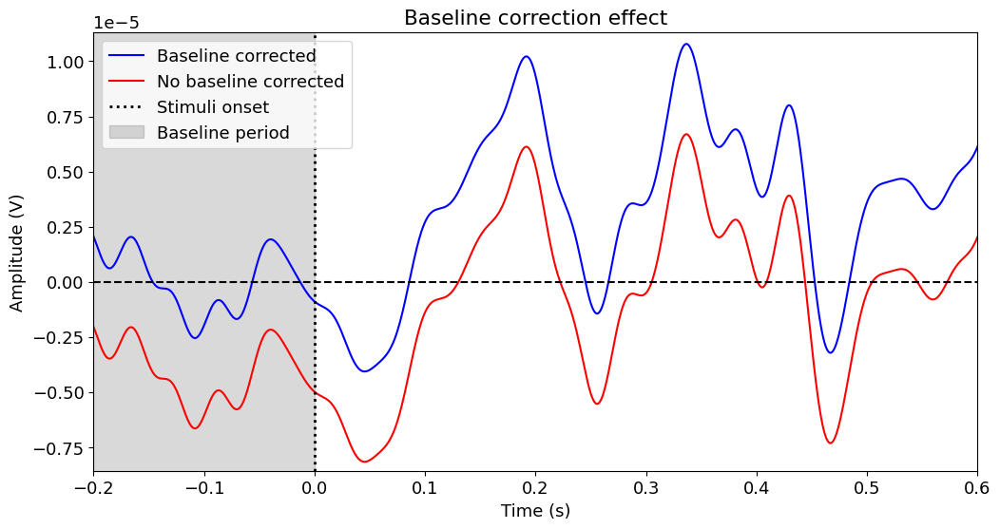

In [35]:
import matplotlib.patches as patches
fig, ax = plt.subplots(figsize=(12, 6))
ax.plot(ERP_times, all_baseline_corr_targets[0][51][15], "b", label = "Baseline corrected")
ax.plot(ERP_times, all_target_eeg_blocks[0][51][15], "r", label = "No baseline corrected")
ax.set_title("Baseline correction effect")
ax.set_xlabel("Time (s)")
ax.set_ylabel("Amplitude (V)")
ax.axvline(x = 0, linewidth = 2, linestyle = ':', color = 'black', label = "Stimuli onset")
ax.axhline(y = 0, linestyle = '--', color = 'black')
ax.set_xlim([-0.2, 0.6])
ax.set_ylim([np.min(all_target_eeg_blocks[0][51][15])*1.05, np.max(all_baseline_corr_targets[0][51][15]) * 1.05])

P3a_region = patches.Rectangle((-0.2, -0.1), 0.2, 0.2, linewidth=1, edgecolor='black', facecolor='black', alpha=0.15, label = 'Baseline period')
ax.add_patch(P3a_region)

ax.legend()
plt.plot()

# **Topoplot map of the EEG electrodes**

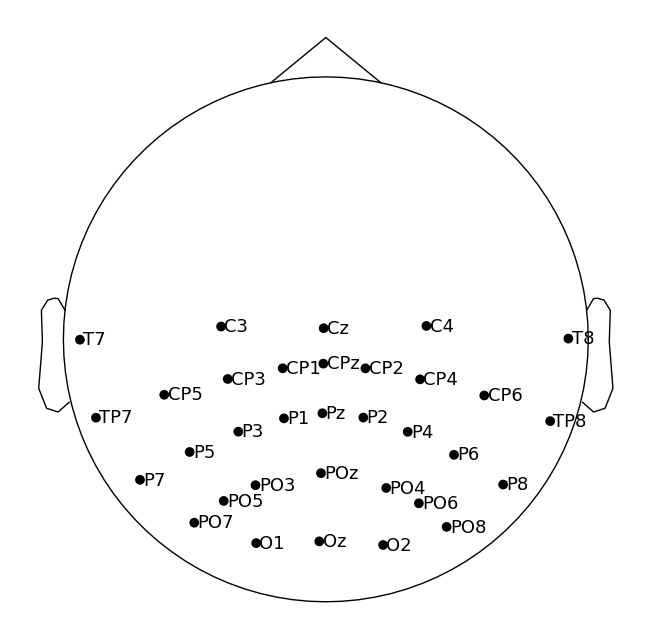

In [36]:
rereferenced_EEGs[subj].plot_sensors(show_names=True,
                                        sphere=(0.0011, 0.015, 0.12, 0.2),
                                        title = "Electrode Distribution");

# **ERP Analysis**

## Computing and plotting the Grand Average ERPs: P3 (300 - 500 ms)

In [37]:
P3_channels = [" Cz", " CPz", " Pz", " CP1", " CP2"]

P3_ch_idx = pick_channels(ch, P3_channels)

all_target_ERPs = []
all_nontarget_ERPs = []

for subj in range(NUM_SUBJ):

    target_ERP = np.mean(all_baseline_corr_targets[subj], axis = 0) # Averaging over the trials dimension
    nontarget_ERP = np.mean(all_baseline_corr_nontargets[subj], axis = 0)

    all_target_ERPs.append(target_ERP)
    all_nontarget_ERPs.append(nontarget_ERP)

grandAver_targetERP = np.mean(all_target_ERPs, axis = 0)
grandAver_nontargetERP = np.mean(all_nontarget_ERPs, axis = 0)

std_targetERP = np.std(all_target_ERPs, axis = 0)
std_nontargetERP = np.std(all_nontarget_ERPs, axis = 0)


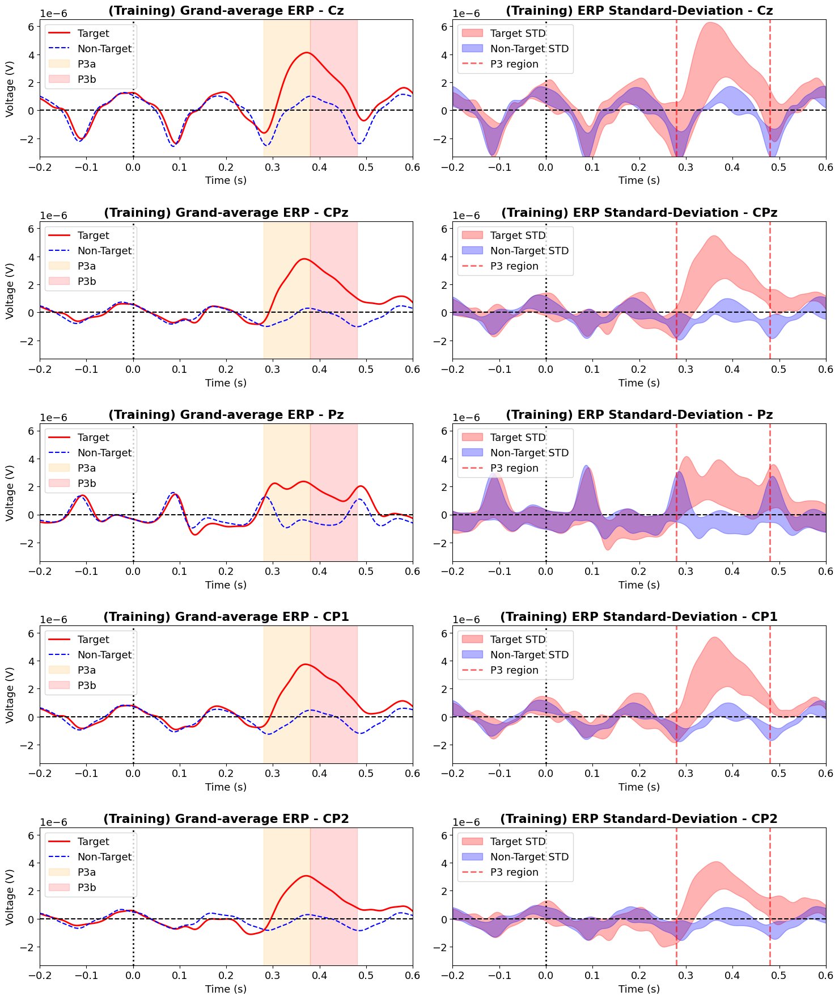

In [38]:
import matplotlib.patches as patches

up_vlim = np.max(grandAver_targetERP[P3_ch_idx,:]) + np.max(std_targetERP[P3_ch_idx,:]/1.2)
do_vlim = np.min(grandAver_targetERP[P3_ch_idx,:]) - np.max(std_targetERP[P3_ch_idx,:]/3)

fig, ax = plt.subplots(nrows = len(P3_ch_idx), 
                                   ncols = 2,
                                   figsize=(15, 18))

for count, c in enumerate(P3_ch_idx):
    

    ax[count,0].plot(ERP_times, 
             grandAver_targetERP[c], 
             color = 'red', 
             label = 'Target',  
             linewidth = 2);
    
    ax[count,0].plot(ERP_times, 
             grandAver_nontargetERP[c], 
             'b--', 
             label = 'Non-Target');
    
    ax[count,0].set_title(f"(Training) Grand-average ERP - {clean_ch[c]}", weight = 'bold')
    ax[count,0].set_xlabel("Time (s)")
    ax[count,0].set_ylabel("Voltage (V)")
    ax[count,0].axvline(x = 0, linewidth = 2, linestyle = ':', color = 'black')
    ax[count,0].axhline(y = 0, linestyle = '--', color = 'black')
    ax[count,0].set_xlim([preStim_offset,posStim_offset])
    ax[count,0].set_ylim([do_vlim, up_vlim])

    if c in P3_ch_idx:
        '''
        ----- Patches info: -----
        (200, -1) is the bottom-left corner of the rectangle (x, y coordinates). Note the y values in the graph are in microVolts
        0.1 is the width of the rectangle.
        0.2 is the height of the rectangle.
        '''
        P3a_region = patches.Rectangle((0.28, -0.1), 0.1, 0.2, linewidth=1, edgecolor='orange', facecolor='orange', alpha=0.15, label = 'P3a')
        ax[count,0].add_patch(P3a_region)
        P3b_region = patches.Rectangle((0.38, -0.1), 0.1, 0.2, linewidth=1, edgecolor='red', facecolor='red', alpha=0.15, label = 'P3b')
        ax[count,0].add_patch(P3b_region)
        
    ax[count,0].legend(loc='upper left')


    # Plot shaded areas on the second subplot (ax2)
    ax[count,1].fill_between(ERP_times,
                    grandAver_targetERP[c] + std_targetERP[c],
                    grandAver_targetERP[c] - std_targetERP[c],
                    color='r',
                    alpha=0.3,
                    label = "Target STD")
    
    ax[count,1].fill_between(ERP_times,
                    grandAver_nontargetERP[c] + std_nontargetERP[c],
                    grandAver_nontargetERP[c] - std_nontargetERP[c],
                    color='b',
                    alpha=0.3,
                    label = "Non-Target STD")
    
    ax[count,1].axvline(x = 0, linewidth = 2, linestyle = ':', color = 'black')
    ax[count,1].axhline(y = 0, linestyle = '--', color = 'black')
    
    ax[count,1].set_title(f"(Training) ERP Standard-Deviation - {clean_ch[c]}", weight = 'bold')
    ax[count,1].set_xlabel("Time (s)") 

    ax[count,1].set_xlim([preStim_offset, posStim_offset])
    ax[count,1].set_ylim([do_vlim, up_vlim])

    ax[count,1].axvline(x = 0.28, linewidth = 2, linestyle = '--', color = 'red', label = "P3 region",alpha = 0.6)
    ax[count,1].axvline(x = 0.48, linewidth = 2, linestyle = '--', color = 'red', alpha = 0.6)

    ax[count,1].legend(loc='upper left')

fig.tight_layout()
plt.show()

## Target vs Non-target Topomaps

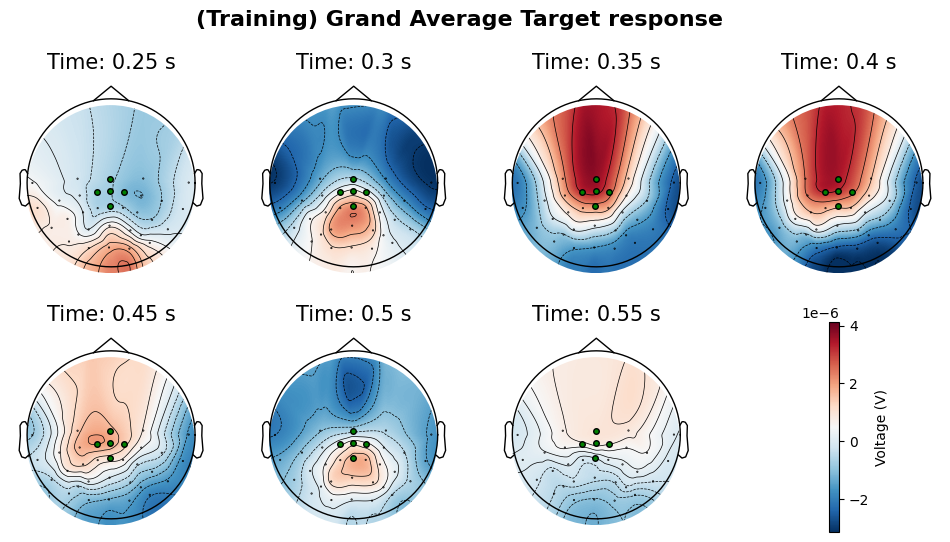

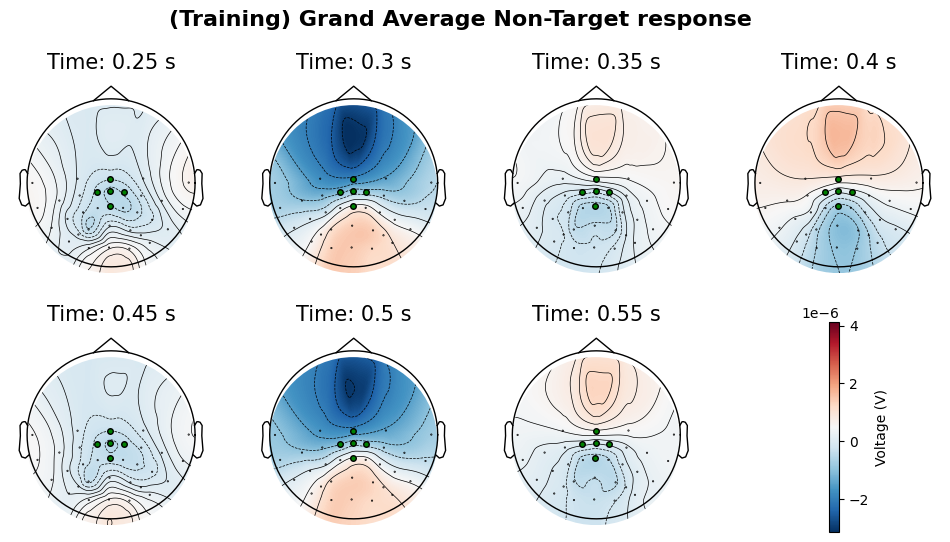

In [59]:
t_win = 0.01  # 10 ms

t_intervals = [0.25, 
               0.3, 
               0.35, 
               0.4, 
               0.45, 
               0.5, 
               0.55,
               0] # ms

t_sample_start = np.argmin(np.abs(ERP_times - t_intervals[0]))
t_sample_stop = np.argmin(np.abs(ERP_times - t_intervals[-2]))

up_vlim = np.max(grandAver_targetERP)
do_vlim = np.min(grandAver_targetERP)

fig, axes = plt.subplots(nrows = 2, 
                         ncols = int(len(t_intervals)/2), 
                         figsize=(12, 6))

fig.suptitle("(Training) Grand Average Target response", fontweight='bold', fontsize=16)

mk = dict(marker='o', 
          markerfacecolor='g', 
          markeredgecolor='k',
          linewidth=0, 
          markersize=4)

highlight_ch = [1 if c in P3_ch_idx else 0 for c in range(len(clean_ch))]

# ------------------------------------------------------------------------------ Target ------------------------------------------------------------------------------

for n, t_ms in enumerate(t_intervals):

    '''
    .flat is a NumPy attribute that flattens the array into a 1D view. This means it transforms a potentially multi-dimensional array into a single list-like structure.
    '''

    ax = axes.flat[n]

    if(n < len(t_intervals) - 1):

        ax.set_title(f"Time: {t_ms} s", fontsize=15)

        t_sample_start = np.argmin(np.abs(ERP_times - t_ms + t_win))
        t_sample_stop = np.argmin(np.abs(ERP_times - t_ms - t_win))
        
        dt = np.mean(grandAver_targetERP[:,t_sample_start:t_sample_stop], axis = 1)
        
        im, cn = mne.viz.plot_topomap(dt,
                                      rereferenced_EEGs[subj].info,
                                      contours = 10,
                                      vlim = (do_vlim, up_vlim),
                                      mask = np.array(highlight_ch),
                                      mask_params = mk,
                                      size = 10,
                                      sphere = (0.0011, 0.015, 0.12, 0.2),
                                      axes = ax,
                                      show = False,
                                      res = 1024)
    
    else:
        
        # Hide axis line
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)

        # Hide axis labels (optional)
        ax.set_xlabel('')
        ax.set_ylabel('')

        ax.set_xticks(ax.get_xticks())  # Get current xtick positions
        ax.set_xticklabels([])
        ax.set_yticks(ax.get_yticks())  # Get current xtick positions
        ax.set_yticklabels([])

        ax.tick_params(bottom = False, left = False, which='both')

        cax = fig.colorbar(im, ax = ax, fraction = 0.55)
        cax.set_label("Voltage (V)")

plt.show()


# ------------------------------------------------------------------------------ Non-Target ------------------------------------------------------------------------------

fig, axes = plt.subplots(nrows = 2, 
                         ncols = int(len(t_intervals)/2), 
                         figsize=(12, 6))

fig.suptitle("(Training) Grand Average Non-Target response", fontweight='bold', fontsize=16)

for n, t_ms in enumerate(t_intervals):

    ax = axes.flat[n]

    if(n < len(t_intervals) - 1):

        ax.set_title(f"Time: {t_ms} s", fontsize=15)

        t_sample_start = np.argmin(np.abs(ERP_times - t_ms + t_win))
        t_sample_stop = np.argmin(np.abs(ERP_times - t_ms - t_win))
        
        dt = np.mean(grandAver_nontargetERP[:,t_sample_start:t_sample_stop], axis = 1)

        im, cn = mne.viz.plot_topomap(dt,
                                      rereferenced_EEGs[subj].info,
                                      contours = 10,
                                      vlim = (do_vlim, up_vlim),
                                      mask = np.array(highlight_ch),
                                      mask_params = mk,
                                      size = 10,
                                      sphere = (0.0011, 0.015, 0.12, 0.2),
                                      axes = ax,
                                      show = False,
                                      res = 1024)
        
    else:
        
        # Hide axis line
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)

        # Hide axis labels (optional)
        ax.set_xlabel('')
        ax.set_ylabel('')

        ax.set_xticks(ax.get_xticks())  # Get current xtick positions
        ax.set_xticklabels([])
        ax.set_yticks(ax.get_yticks())  # Get current xtick positions
        ax.set_yticklabels([])

        ax.tick_params(bottom = False, left = False, which='both')

        cax = fig.colorbar(im, ax = ax, fraction = 0.55)
        cax.set_label("Voltage (V)")

plt.show()

## Target vs Non-target classification (P3)

### Concatenating feature vector

In [40]:
from scipy.signal import resample

# Isolating the datapoints related to the N2pc time window 

n_trials = np.size(all_baseline_corr_targets, 1)

ts = 0.28
te = 0.48

idx_s = np.argmin(np.abs(ERP_times - ts))
idx_e = np.argmin(np.abs(ERP_times - te))

# Resampling the resulting time window (Prevents overfitting)

RESAMPLE_FREQ = 64 # Hz
N_DATAPOINTS_ORIG_FREQ = len(ERP_times[idx_s:idx_e+1])
N_DATAPOINTS_RESA_FREQ = int(np.ceil((N_DATAPOINTS_ORIG_FREQ * RESAMPLE_FREQ)/fs)) + 1

all_featVect_Target = []
all_featVect_NonTarget = []

for subj in range(NUM_SUBJ):

    print(f"\nSubject {subj + 1}: P3 Feature vector")

    featVect_Target = [] # Class label = 1
    featVect_NonTarget = [] # Class label = 0

    for trial in range(n_trials):

        targets = resample(all_baseline_corr_targets[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
        nontargets = resample(all_baseline_corr_nontargets[subj][trial*4][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
        
        for id in range(1, len(P3_ch_idx)):
            
            c = P3_ch_idx[id]

            if (id == 1):
                auxT = np.hstack((targets[P3_ch_idx[id - 1],:],targets[c,:]))
                auxNT = np.hstack((nontargets[P3_ch_idx[id - 1],:],nontargets[c,:]))
            else:
                auxT = np.hstack((auxT,targets[c,:]))
                auxNT = np.hstack((auxNT,nontargets[c,:]))
        
        featVect_Target.append(np.hstack((auxT, 1)))
        featVect_NonTarget.append(np.hstack((auxNT, 0)))

    print(np.shape(featVect_Target))
    print(np.shape(featVect_NonTarget))

    all_featVect_Target.append(featVect_Target)
    all_featVect_NonTarget.append(featVect_NonTarget)

    


Subject 1: P3 Feature vector
(240, 71)
(240, 71)

Subject 2: P3 Feature vector
(240, 71)
(240, 71)

Subject 3: P3 Feature vector
(240, 71)
(240, 71)

Subject 4: P3 Feature vector
(240, 71)
(240, 71)

Subject 5: P3 Feature vector
(240, 71)
(240, 71)

Subject 6: P3 Feature vector
(240, 71)
(240, 71)


### Train/Validation Split

In [41]:
import random

PERCENT_TRAIN = 0.75

n_train = int(np.ceil(n_trials * PERCENT_TRAIN))

all_train_featVect = []
all_test_featVect = []

for subj in range(NUM_SUBJ):

    train_featVect = np.vstack((all_featVect_Target[subj][:n_train], all_featVect_NonTarget[subj][:n_train]))
    test_featVect = np.vstack((all_featVect_Target[subj][n_train:], all_featVect_NonTarget[subj][n_train:]))

    np.random.seed(42)
    np.random.shuffle(train_featVect)
    np.random.seed(42)
    np.random.shuffle(test_featVect)

    all_train_featVect.append(train_featVect)
    all_test_featVect.append(test_featVect)

### Row-wise normalization of the feature vector

In [42]:
# Feature wise normalization of feature vector

all_norm_train_featVect = []
all_norm_test_featVect = []

ROW_WISE_NORM = True

for subj in range(NUM_SUBJ):

    if(ROW_WISE_NORM):  

        n_entries = np.size(all_train_featVect, 1)

        norm_train_featVect = []

        for j in range(n_entries):

            mean = np.mean(all_train_featVect[subj][j, 0:-1])
            std = np.std(all_train_featVect[subj][j, 0:-1])
            norm_train_featVect.append(np.hstack(((all_train_featVect[subj][j,0:-1] - mean) / std, all_train_featVect[subj][j, -1])))


        n_entries = np.size(all_test_featVect, 1)

        norm_test_featVect = []

        for u in range(n_entries):

            mean = np.mean(all_test_featVect[subj][u,0:-1])
            std = np.std(all_test_featVect[subj][u,0:-1])
            norm_test_featVect.append(np.hstack(((all_test_featVect[subj][u,0:-1] - mean) / std, all_test_featVect[subj][u, -1])))

        train_featVect = np.array(norm_train_featVect)
        test_featVect = np.array(norm_test_featVect)

    else:

        n_entries = np.size(all_train_featVect, 2) - 1

        norm_train_featVect = []

        for j in range(n_entries):

            mean = np.mean(all_train_featVect[subj][:, j])
            std = np.std(all_train_featVect[subj][:, j])
            norm_train_featVect.append(((all_train_featVect[subj][:, j] - mean)))

        n_entries = np.size(all_test_featVect, 2) - 1

        norm_test_featVect = []

        for u in range(n_entries):

            mean = np.mean(all_test_featVect[subj][:,u])
            std = np.std(all_test_featVect[subj][:,u])
            norm_test_featVect.append((all_test_featVect[subj][: ,u] - mean) / std)

        train_featVect = np.array(np.vstack((norm_train_featVect, all_train_featVect[subj][:, -1]))).T
        test_featVect = np.array(np.vstack((norm_test_featVect, all_test_featVect[subj][:, -1]))).T

    all_norm_train_featVect.append(train_featVect)
    all_norm_test_featVect.append(test_featVect)

### Classification

In [42]:
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVC
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
from sklearn.ensemble import RandomForestClassifier
import xgboost as xgb
from sklearn.ensemble import AdaBoostClassifier
from sklearn.model_selection import cross_val_score
from sklearn.metrics import roc_auc_score, accuracy_score

PERCENT_TRAIN = 0.75
KFOLD = 10

##### Function that runs GridSearchCV

In [43]:
import pandas as pd

def GridSearch(method_param_grid, estimator_model, KFOLD, train_data, train_labels): # Train data: [subj]

    cross_val_scores = np.zeros((len(method_param_grid.items()),3))
    perMethod_model = []

    count = 0

    for method, param_grid in method_param_grid.items():
        print(f"\nRunning Grid Search for method: {method}\n")
        

        # Define the grid search object
        grid_search = GridSearchCV(estimator = estimator_model, 
                                   param_grid = param_grid, 
                                   cv = KFOLD, 
                                   n_jobs = -2)

        grid_search.fit(train_data, train_labels)

        # Print the best parameters found
        print("Best parameters:", grid_search.best_params_)

        # Access the best model
        best_grid_model = grid_search.best_estimator_

        perMethod_model.append(best_grid_model)

        best_index = grid_search.best_index_

        temp_pd = pd.DataFrame(grid_search.cv_results_).iloc[best_index,:]

        # Cross value scores
        cross_val_scores[count, 0] = (temp_pd['mean_test_score'] * 100)
        cross_val_scores[count, 1] = (temp_pd['std_test_score'] * 100)
        cross_val_scores[count, 2] = (temp_pd['mean_fit_time'])

        # Get the best model's scores (assuming cv results in multiple scores)
        print("Best score:", grid_search.best_score_)

        count+=1

        del grid_search

    best_model_idx = np.argmax(cross_val_scores[:,0])

    return cross_val_scores[best_model_idx, :], perMethod_model[best_model_idx]
    

##### SVM hyperparameter grid

In [44]:
# Define separate parameter grids for each kernel

param_grid_linear = {
    'kernel': ['linear'],
    'C': [0.001, 0.01, 0.1, 1, 10, 100, 200],
    'tol': [1e-2, 1e-3, 1e-4, 1e-5],  # Tolerance for stopping optimization
    'cache_size': [200],
    'random_state': [42]
}


param_grid_rbf = {
    'kernel': ['rbf'],
    'C': [0.001, 0.01, 0.1, 1, 10, 100, 200],
    'gamma': ['auto', 'scale', 0.1, 1, 10],  # Specific gamma values
    'tol': [1e-1, 1e-2, 1e-3, 1e-4, 1e-5],
    'cache_size': [200],  # Size of the kernel cache in MB
    'random_state': [42]
}

param_grid_poly = {
    'kernel': ['poly'],
    'C': [0.001, 0.01, 0.1, 1, 10, 100, 200],
    'gamma': ['auto', 'scale', 0.1, 1, 10],  # Specific gamma values
    'degree': [2, 3],
    'tol': [1e-1, 1e-1, 1e-2, 1e-3, 1e-4, 1e-5],
    'cache_size': [200],
    'random_state': [42]
}

param_grid_sigmoid = {
    'kernel': ['sigmoid'],
    'C': [0.001, 0.01, 0.1, 1, 10, 100, 200],
    'gamma': ['auto', 'scale', 0.1, 1, 10],  # Specific gamma values
    'tol': [1e-1, 1e-2, 1e-3, 1e-4, 1e-5],
    'cache_size': [200],
    'random_state': [42]
}

# Define a dictionary to map kernels to their respective parameter grids
svm_param_grid = {
    #'linear': param_grid_linear,
    'rbf': param_grid_rbf,
    'poly': param_grid_poly,
    'sigmoid': param_grid_sigmoid,
}

##### LDA hyperparameter grid

In [45]:
param_grid_lda_svd = {
    'solver': ['svd'],
}

param_grid_lda_lsqr = {
    'solver': ['lsqr'],
    'shrinkage': ['auto', None, 0.001],
    'tol': [1e-1, 1e-2, 1e-3, 1e-4, 1e-5],
}

param_grid_lda_eigen = {
    'solver': ['eigen'],
    'shrinkage': ['auto', 0.01, 0.001, 0.0001],
    'tol': [1e-1, 1e-2, 1e-3, 1e-4, 1e-5],
}

# Define separate parameter grids for each solver
lda_param_grid = {
    'svd': param_grid_lda_svd,
    'lsqr': param_grid_lda_lsqr,
    'eigen': param_grid_lda_eigen,
}

##### Random Forest hyperparameter grid

In [50]:
param_grid_rf = {
    'criterion': ['gini', 'entropy','log_loss'],
    'n_estimators': [50, 100, 200],
    'max_depth': [None, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': [None, 'sqrt', 'log2'],
    'random_state': [42]
}


# Define a dictionary to map XGBoost criteria to their respective parameter grids
rf_param_grid = {
    'Random Forest': param_grid_rf
}

##### XGBoost hyperparameter grid

In [46]:
# Define separate parameter grids for each criterion
param_grid_xgb = {
    'objective': ['reg:squarederror','binary:logistic'],  # Binary classification objective
    'eval_metric': ['logloss'],  # Evaluation metric
    'learning_rate': [0.1, 0.3, 0.5],  # Learning rate
    'max_depth': [3, 6, 9],  # Maximum depth of the trees
    'subsample': [0.8, 1.0],  # Subsample ratio of the training instances
    'colsample_bytree': [0.8, 1.0],  # Subsample ratio of columns when constructing each tree
    'n_estimators': [50, 100, 200],  # Number of boosting rounds
    'random_state': [42],  # Ensure reproducibility,
}

# Define a dictionary to map XGBoost criteria to their respective parameter grids
xgb_param_grid = {
    'XGBoost': param_grid_xgb

}

##### AdaBoost hyperparaeters grid

In [48]:
param_grid_adaboost = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.1, 0.5, 1.0],
    'random_state': [42]
}

# Define a dictionary to map XGBoost criteria to their respective parameter grids
ada_param_grid = {
    'AdaBoost': param_grid_adaboost

}

ROC:

True positive rate = Sensitivity = y axis (ROC) = True Positives/(True Positives + False Negatives) = Proportion of Targets that were correctly classified

False Positve rate = Specificity = x axis (ROC) (1-Specificity) = False Positives/(False Positives + True Negatives) = Proportion of non Target samples that were incorrectly classified

Precision = True Positives/(True Positives + False Positives) = Porportion of results that were correclty classified

**The ROC graph summarizes all of the confusion matrices that each threshold produced**

In [51]:
classifiers = [SVC(probability=True), 
               LDA(), 
               RandomForestClassifier(), 
               xgb.XGBClassifier(), 
               AdaBoostClassifier()]

classifier_params = [svm_param_grid, 
                     lda_param_grid, 
                     rf_param_grid, 
                     xgb_param_grid, 
                     ada_param_grid]

class_list = ["SVM", "LDA", "RF", "XGB", "AdaB"]

In [481]:
print("==================================================== All P3 channels ====================================================\n")

perSubj_cross_val_scores = np.zeros((NUM_SUBJ, 5, 2))
perSubj_accuracy = np.zeros((NUM_SUBJ, 5)) # 5 Classifiers
perSubj_auc_scores = np.zeros((NUM_SUBJ, 5))
perSubj_fitting_periods = np.zeros((NUM_SUBJ, 5))

for subj in range(NUM_SUBJ):

    print(f"\n------------------ Subject {subj + 1}: Classifying Target vs Non-Target ------------------\n")

    for c_count, clf in enumerate(classifiers):


        print(f"\n------------------ Classifier: {clf} ------------------")


        p3_clf = clf

        # --------- Cross Validation Scores ---------
        cross_val_scores, best_p3_clf = GridSearch(classifier_params[c_count], 
                                                   p3_clf, 
                                                   KFOLD, 
                                                   all_norm_train_featVect[subj][:,0:-1],
                                                   all_norm_train_featVect[subj][:,-1])
        
        perSubj_cross_val_scores[subj, c_count, 0] = cross_val_scores[0]
        perSubj_cross_val_scores[subj, c_count, 1] = cross_val_scores[1]
        perSubj_fitting_periods[subj, c_count] = cross_val_scores[2]

        # --------- Predictions ---------
        pred = best_p3_clf.predict(all_norm_test_featVect[subj][:, 0:-1])
        perSubj_accuracy[subj, c_count] = round(accuracy_score(all_norm_test_featVect[subj][:, -1], pred), 2) * 100

        # Compute AUC for each subject
        perSubj_auc_scores[subj, c_count] = round(roc_auc_score(all_norm_test_featVect[subj][:, -1], best_p3_clf.predict_proba(all_norm_test_featVect[subj][:, 0:-1])[:,1]), 2)

        del p3_clf, best_p3_clf # Ensures no mixing of classifiers within the loop


==================================================== All P3 channels ====================================================


------------------ Subject 1: Classifying Target vs Non-Target ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.1, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.7472222222222223

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.7305555555555554

Running Grid Search for method: poly

Best parameters: {'C': 1, 'cache_size': 200, 'degree': 3, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.7305555555555555

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.71

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.1, 'n_estimators': 100, 'random_state': 42}
Best score: 0.7

------------------ Subject 2: Classifying Target vs Non-Target ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.1, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.001}
Best score: 0.6861111111111111

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.01}
Best score: 0.675

Running Grid Search for method: poly

Best parameters: {'C': 10, 'cache_size': 200, 'degree': 3, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.6583333333333333

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.675

------------------ Classifier: Li

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.1, 'n_estimators': 100, 'random_state': 42}
Best score: 0.6722222222222223

------------------ Subject 3: Classifying Target vs Non-Target ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.01, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.725

Running Grid Search for method: rbf

Best parameters: {'C': 0.1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.7166666666666667

Running Grid Search for method: poly

Best parameters: {'C': 0.01, 'cache_size': 200, 'degree': 2, 'gamma': 0.1, 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.7166666666666666

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.7305555555555556

-----

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.1, 'n_estimators': 50, 'random_state': 42}
Best score: 0.7305555555555555

------------------ Subject 4: Classifying Target vs Non-Target ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.1, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.7083333333333333

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.01}
Best score: 0.663888888888889

Running Grid Search for method: poly

Best parameters: {'C': 1, 'cache_size': 200, 'degree': 3, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.6777777777777778

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.0001}
Best score: 0.65555555555

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.1, 'n_estimators': 50, 'random_state': 42}
Best score: 0.65

------------------ Subject 5: Classifying Target vs Non-Target ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.01, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.001}
Best score: 0.6388888888888888

Running Grid Search for method: rbf

Best parameters: {'C': 0.001, 'cache_size': 200, 'gamma': 10, 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.625

Running Grid Search for method: poly

Best parameters: {'C': 1, 'cache_size': 200, 'degree': 2, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.5972222222222222

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.6305555555555554

------------------ Cl

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.1, 'n_estimators': 100, 'random_state': 42}
Best score: 0.5972222222222221

------------------ Subject 6: Classifying Target vs Non-Target ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.01, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.6833333333333333

Running Grid Search for method: rbf

Best parameters: {'C': 0.1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.01}
Best score: 0.6694444444444445

Running Grid Search for method: poly

Best parameters: {'C': 1, 'cache_size': 200, 'degree': 3, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.01}
Best score: 0.6722222222222223

Running Grid Search for method: sigmoid

Best parameters: {'C': 0.1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.01}
Best score: 0.65555

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 1.0, 'n_estimators': 100, 'random_state': 42}
Best score: 0.6388888888888887


In [482]:
print(perSubj_cross_val_scores[:,:,0])
print("\n")
print(perSubj_accuracy)

[[74.72222222 74.44444444 74.44444444 73.88888889 70.        ]
 [68.61111111 66.66666667 70.27777778 69.44444444 67.22222222]
 [73.05555556 72.77777778 74.44444444 73.88888889 73.05555556]
 [70.83333333 68.33333333 68.05555556 70.         65.        ]
 [63.88888889 62.5        64.44444444 65.55555556 59.72222222]
 [68.33333333 68.88888889 72.77777778 73.05555556 63.88888889]]


[[78. 69. 72. 68. 68.]
 [72. 76. 66. 65. 64.]
 [79. 78. 74. 75. 72.]
 [64. 67. 66. 67. 61.]
 [70. 67. 60. 63. 56.]
 [72. 68. 66. 64. 61.]]


### Cross-Validation Training Classification differences between different classifiers

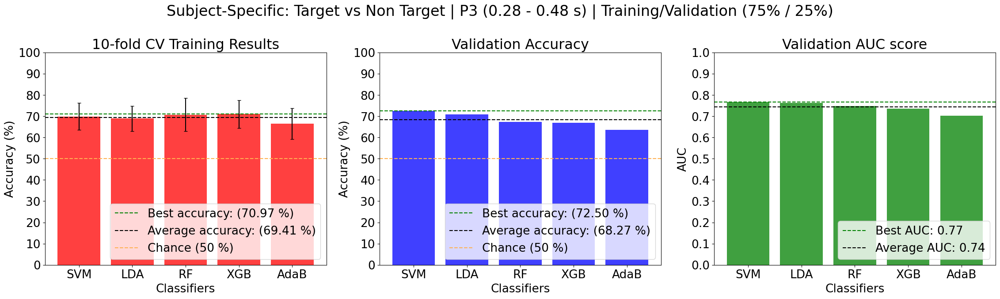

In [483]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 3,
                       figsize=(23, 7))

fig.suptitle(f'Subject-Specific: Target vs Non Target | P3 ({ts} - {te} s) | Training/Validation (75% / 25%)', fontsize=24)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 19})
ax[0].bar(np.arange(1, 6), 
       np.mean(perSubj_cross_val_scores[:,:,0], axis = 0 ), 
       color="red", 
       yerr = np.mean(perSubj_cross_val_scores[:,:,1], axis = 0), 
       capsize=3,
       alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(np.mean(perSubj_cross_val_scores[:,:,0], axis = 0)), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(np.mean(perSubj_cross_val_scores[:,:,0], axis = 0)):.2f} %)')

ax[0].axhline(y = np.mean(perSubj_cross_val_scores[:,:,0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(perSubj_cross_val_scores[:,:,0]):.2f} %)')

ax[0].axhline(y=50, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (50 %)')

ax[0].set(xticks = np.arange(1, 6), 
       xticklabels = class_list,
       xlabel = 'Classifiers', 
       yticks=np.arange(0, 101, step=10), ylabel='Accuracy (%)',
       title=f'{KFOLD}-fold CV Training Results');

ax[0].legend(loc='lower right');


# -------------- Prediction Accuracy --------------

ax[1].bar(np.arange(1, 6), 
          np.mean(perSubj_accuracy, axis = 0 ), 
          color="b",
          alpha = 0.75)

ax[1].set_title('Accuracy (%)')

ax[1].axhline(y = max(np.mean(perSubj_accuracy, axis = 0)), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(np.mean(perSubj_accuracy, axis = 0)):.2f} %)')

ax[1].axhline(y = np.mean(perSubj_accuracy), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy):.2f} %)')

ax[1].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50 %)')

ax[1].set(xticks = np.arange(1, 5 + 1), 
          xticklabels = class_list,
          xlabel = 'Classifiers', 
          yticks=np.arange(0, 101, step=10), ylabel='Accuracy (%)',
          title="Validation Accuracy");

ax[1].legend(loc='lower right');


# -------------- Aread Under the Curve (AUC) --------------

ax[2].bar(np.arange(1, 6), 
          np.mean(perSubj_auc_scores, axis = 0 ), 
          color="g",
          alpha = 0.75)

ax[2].set_title('AUC ')

ax[2].axhline(y = max(np.mean(perSubj_auc_scores, axis = 0)), 
              color='green', linestyle='--', 
              label = f'Best AUC: {max(np.mean(perSubj_auc_scores, axis = 0)):.2f}')

ax[2].axhline(y = np.mean(perSubj_auc_scores), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: {np.mean(perSubj_auc_scores):.2f}')

ax[2].set(xticks = np.arange(1, 5 + 1), 
          xticklabels = class_list,
          xlabel = 'Classifiers', 
          yticks=np.arange(0, 1.01, step=0.1), ylabel='AUC',
          title="Validation AUC score");

ax[2].legend(loc='lower right');

plt.tight_layout()

### Best classifier Cross-Validation Training accuracies for all subjects

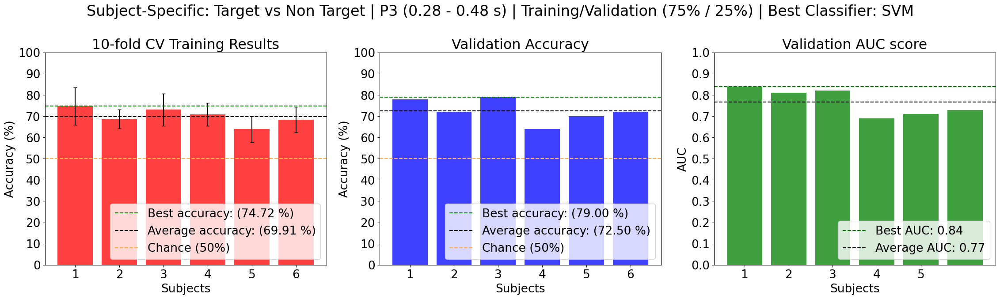

In [484]:
best_classifier = np.argmax(np.mean(perSubj_accuracy, axis = 0))

fig, ax = plt.subplots(nrows = 1,
                       ncols = 3,
                       figsize=(23, 7))

fig.suptitle(f'Subject-Specific: Target vs Non Target | P3 ({ts} - {te} s) | Training/Validation (75% / 25%) | Best Classifier: {class_list[best_classifier]}', fontsize=24)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 19})
ax[0].bar(np.arange(1, NUM_SUBJ + 1), 
       perSubj_cross_val_scores[:,best_classifier, 0], 
       color="red", 
       yerr = perSubj_cross_val_scores[:,best_classifier, 1], 
       capsize=3,
       alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(perSubj_cross_val_scores[:,best_classifier, 0]), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(perSubj_cross_val_scores[:,best_classifier, 0]):.2f} %)')

ax[0].axhline(y = np.mean(perSubj_cross_val_scores[:,best_classifier, 0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(perSubj_cross_val_scores[:,best_classifier, 0]):.2f} %)')

ax[0].axhline(y=50, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (50%)')

ax[0].set(xticks = np.arange(1, NUM_SUBJ + 1), 
         xlabel = 'Subjects', 
         yticks=np.arange(0, 101, step=10), 
         ylabel='Accuracy (%)',
         title=f'{KFOLD}-fold CV Training Results');

ax[0].legend(loc='lower right');


# -------------- Prediction Accuracy --------------

ax[1].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_accuracy[:,best_classifier], 
          color="b",
          alpha = 0.75)

ax[1].set_title('Accuracy (%)')

ax[1].axhline(y = max(perSubj_accuracy[:,best_classifier]), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(perSubj_accuracy[:,best_classifier]):.2f} %)')

ax[1].axhline(y = np.mean(perSubj_accuracy[:,best_classifier]), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy[:,best_classifier]):.2f} %)')

ax[1].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50%)')

ax[1].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 101, step=10), 
          ylabel='Accuracy (%)',
          title="Validation Accuracy");

ax[1].legend(loc='lower right');


# -------------- Aread Under the Curve (AUC) --------------

ax[2].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_auc_scores[:, best_classifier], 
          color="g",
          alpha = 0.75)

ax[2].set_title('AUC ')

ax[2].axhline(y = max(perSubj_auc_scores[:, best_classifier]), 
              color='green', linestyle='--', 
              label = f'Best AUC: {max(perSubj_auc_scores[:, best_classifier]):.2f}')

ax[2].axhline(y = np.mean(perSubj_auc_scores[:, best_classifier]), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: {np.mean(perSubj_auc_scores[:, best_classifier]):.2f}')

ax[2].set(xticks = np.arange(1, 5 + 1), 
          xlabel = 'Subjects', 
          yticks=np.arange(0, 1.01, step=0.1), ylabel='AUC',
          title="Validation AUC score");

ax[2].legend(loc='lower right');
plt.tight_layout()

### Training and saving best Model

In [242]:
models_Folder = "C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/"

# Create the folder (raises an error if it already exists)
try:
  os.mkdir(models_Folder)
  print(f"Folder created successfully at: {models_Folder}")
except FileExistsError:
  print(f"Folder already exists at: {models_Folder}")


P3_models_Folder = "C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_Target_vs_NonTarget_P3"

# Create the folder (raises an error if it already exists)
try:
  os.mkdir(P3_models_Folder)
  print(f"Folder created successfully at: {P3_models_Folder}")
except FileExistsError:
  print(f"Folder already exists at: {P3_models_Folder}")

Folder created successfully at: C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/
Folder created successfully at: C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_P3_Target_vs_NonTarget/


In [493]:
perSubj_optim_params = [{'C': 0.1, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01},
                        {'C': 0.1, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.001},
                        {'C': 0.01, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01},
                        {'C': 0.1, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01},
                        {'C': 0.01, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.001},
                        {'C': 0.01, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}]

In [494]:
import joblib

bestModel_Subj_cross_val_scores = np.zeros((NUM_SUBJ, 2))

for subj in range(NUM_SUBJ):

    train = np.vstack((all_norm_train_featVect[subj], all_norm_test_featVect[subj])) # All data stacked

    np.random.seed(42)
    np.random.shuffle(train)

    # -------------------------- SVM --------------------------

    best_p3_clf = SVC(probability=True)
    best_p3_clf.set_params(**perSubj_optim_params[subj])

    # --------- Cross Validation Scores ---------
    scores = cross_val_score(best_p3_clf, 
                             train[:, 0:-1], 
                             train[:, -1], 
                             cv = KFOLD)
    
    bestModel_Subj_cross_val_scores[subj, 0] = (scores.mean() * 100)
    bestModel_Subj_cross_val_scores[subj, 1] = (scores.std() * 100)

    # --------- Train Model ---------
    best_p3_clf.fit(train[:, 0:-1], 
                    train[:, -1])
    
    joblib.dump(best_p3_clf, f'{P3_models_Folder}Subj_0{subj + 1}_P3_model.pkl')
    
    del best_p3_clf

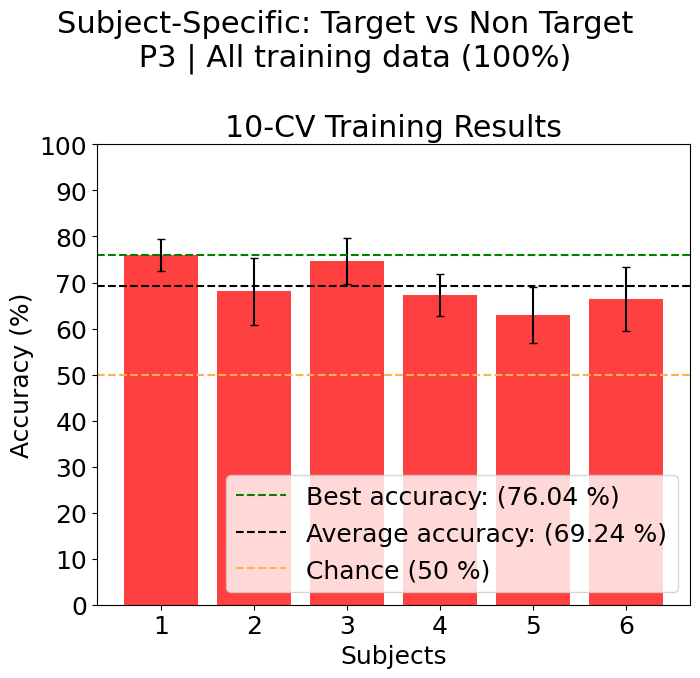

In [495]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 1,
                       figsize=(7.34, 7))

fig.suptitle(f'Subject-Specific: Target vs Non Target \n P3 | All training data (100%)', fontsize=22)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size':18})
ax.bar(np.arange(1, NUM_SUBJ + 1), 
       bestModel_Subj_cross_val_scores[:, 0], 
       color="red", 
       yerr = bestModel_Subj_cross_val_scores[:, 1], 
       capsize=3,
       alpha = 0.75)

ax.set_title('Accuracy (%)')

ax.axhline(y = max(bestModel_Subj_cross_val_scores[:, 0]), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(bestModel_Subj_cross_val_scores[:, 0]):.2f} %)')

ax.axhline(y = np.mean(bestModel_Subj_cross_val_scores[:, 0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(bestModel_Subj_cross_val_scores[:, 0]):.2f} %)')

ax.axhline(y=50, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (50 %)')

ax.set(xticks = np.arange(1, NUM_SUBJ + 1), 
         xlabel = 'Subjects', 
         yticks=np.arange(0, 101, step=10), 
         ylabel='Accuracy (%)',
         title=f'{KFOLD}-CV Training Results');

ax.legend(loc='lower right');

plt.tight_layout()

### Attempting generalization

In [498]:
for subj in range(1, NUM_SUBJ):

    if (subj == 1):
        stacked_norm_train_featVectors = np.vstack((all_norm_train_featVect[subj - 1], all_norm_train_featVect[subj]))
        stacked_norm_test_featVectors = np.vstack((all_norm_test_featVect[subj - 1], all_norm_test_featVect[subj]))
    else:
        stacked_norm_train_featVectors = np.vstack((stacked_norm_train_featVectors, all_norm_train_featVect[subj]))
        stacked_norm_test_featVectors = np.vstack((stacked_norm_test_featVectors, all_norm_test_featVect[subj]))

np.random.seed(42)
np.random.shuffle(stacked_norm_train_featVectors)
np.random.seed(42)
np.random.shuffle(stacked_norm_test_featVectors)

In [250]:
stackedSubj_cross_val_scores = np.zeros((len(classifiers), 2))
stackedSubj_accuracy = []
stackedSubj_auc_scores = []

for c_count, clf in enumerate(classifiers):

    print(f"\n------------------ Classifier: {clf} ------------------")

    gen_n2pc_clf = clf

    # --------- Cross Validation Scores ---------
    cross_val_scores, best_gen_n2pc_clf = GridSearch(classifier_params[c_count], 
                                                        gen_n2pc_clf, 
                                                        KFOLD, 
                                                        stacked_norm_train_featVectors[:,0:-1],
                                                        stacked_norm_train_featVectors[:,-1])
    
    stackedSubj_cross_val_scores[c_count, 0] = cross_val_scores[0]
    stackedSubj_cross_val_scores[c_count, 1] = cross_val_scores[1]

    # --------- Predictions ---------
    pred = best_gen_n2pc_clf.predict(stacked_norm_test_featVectors[:, 0:-1])
    stackedSubj_accuracy.append( round(accuracy_score(stacked_norm_test_featVectors[:, -1], pred), 2) * 100 )

    # Compute AUC for each subject
    stackedSubj_auc_scores.append( round(roc_auc_score(stacked_norm_test_featVectors[:, -1], best_gen_n2pc_clf.predict_proba(stacked_norm_test_featVectors[:, 0:-1])[:,1]), 2))

    del gen_n2pc_clf, best_gen_n2pc_clf # Ensures no mixing of classifiers within the loop


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.1, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.6416666666666666

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.01}
Best score: 0.6671296296296296

Running Grid Search for method: poly

Best parameters: {'C': 0.001, 'cache_size': 200, 'degree': 3, 'gamma': 0.1, 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.6361111111111112

Running Grid Search for method: sigmoid

Best parameters: {'C': 0.1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.01}
Best score: 0.6180555555555557

------------------ Classifier: LinearDiscriminantAnalysis() ------------------

Running Grid Search for method: svd

Best parameters: {'solver': 'svd'}
Best score: 0.6342592592592593

Ru

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.1, 'n_estimators': 200, 'random_state': 42}
Best score: 0.6263888888888889


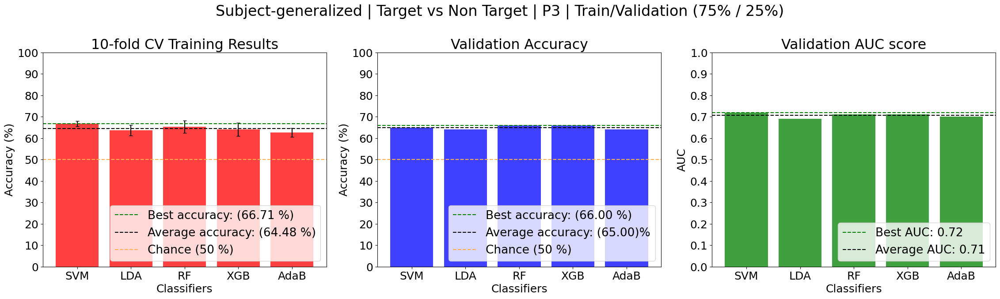

In [251]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 3,
                       figsize=(23, 7))

fig.suptitle(f'Subject-generalized | Target vs Non Target | P3 | Train/Validation (75% / 25%)', fontsize=24)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 19})
ax[0].bar(np.arange(1, 6), 
          stackedSubj_cross_val_scores[:,0], 
          color="red", 
          yerr = stackedSubj_cross_val_scores[:,1], 
          capsize=3,
          alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(stackedSubj_cross_val_scores[:,0]), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(stackedSubj_cross_val_scores[:,0]):.2f} %)')

ax[0].axhline(y = np.mean(stackedSubj_cross_val_scores[:,0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(stackedSubj_cross_val_scores[:,0]):.2f} %)')

ax[0].axhline(y=50, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (50 %)')

ax[0].set(xticks = np.arange(1, 5 + 1), 
          xticklabels = class_list,
          xlabel = 'Classifiers', 
          yticks=np.arange(0, 101, step=10), ylabel='Accuracy (%)',
          title=f'{KFOLD}-fold CV Training Results');

ax[0].legend(loc='lower right');


# -------------- Prediction Accuracy --------------

ax[1].bar(np.arange(1, 6), 
          stackedSubj_accuracy, 
          color="b",
          alpha = 0.75)

ax[1].set_title('Accuracy (%)')

ax[1].axhline(y = max(stackedSubj_accuracy), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(stackedSubj_accuracy):.2f} %)')

ax[1].axhline(y = np.mean(stackedSubj_accuracy), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(stackedSubj_accuracy):.2f})%')

ax[1].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50 %)')

ax[1].set(xticks = np.arange(1, 5 + 1), 
          xticklabels = class_list,
          xlabel = 'Classifiers', 
          yticks=np.arange(0, 101, step=10), ylabel='Accuracy (%)',
          title="Validation Accuracy");

ax[1].legend(loc='lower right');


# -------------- Aread Under the Curve (AUC) --------------

ax[2].bar(np.arange(1, 6), 
          stackedSubj_auc_scores, 
          color="g",
          alpha = 0.75)

ax[2].set_title('AUC ')

ax[2].axhline(y = max(stackedSubj_auc_scores), 
              color='green', linestyle='--', 
              label = f'Best AUC: {max(stackedSubj_auc_scores):.2f}')

ax[2].axhline(y = np.mean(stackedSubj_auc_scores), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: {np.mean(stackedSubj_auc_scores):.2f}')

ax[2].set(xticks = np.arange(1, 6), 
          xticklabels = class_list,
          xlabel = 'Classifiers', 
          yticks=np.arange(0, 1.01, step=0.1), ylabel='AUC',
          title="Validation AUC score");

ax[2].legend(loc='lower right');
plt.tight_layout()

In [496]:
P3_AGI_models_Folder = "C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SG_Target_vs_NonTarget_P3/"

# Create the folder (raises an error if it already exists)
try:
  os.mkdir(P3_AGI_models_Folder)
  print(f"Folder created successfully at: {P3_AGI_models_Folder}")
except FileExistsError:
  print(f"Folder already exists at: {P3_AGI_models_Folder}")

Folder already exists at: C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SG_P3_Target_vs_NonTarget/


In [501]:
all_train = np.vstack((stacked_norm_train_featVectors, stacked_norm_test_featVectors))

# -------------------------- Random Forest --------------------------
gen_p3_clf = SVC(probability=True, C = 1, cache_size = 200, gamma = 'auto', kernel = 'rbf', random_state = 42, tol = 0.01)

# --------- Cross Validation Scores ---------
scores = cross_val_score(gen_p3_clf, 
                         all_train[:, 0:-1], 
                         all_train[:, -1], 
                         cv = KFOLD)

print("10 fold mean Accuracy: ", scores.mean() * 100)
print("10 fold std Accuracy: ", scores.std() * 100)


# --------- Train Model ---------
gen_p3_clf.fit(all_train[:, 0:-1], 
               all_train[:, -1])

joblib.dump(gen_p3_clf, f'{P3_AGI_models_Folder}Gen_P3_model.pkl')

10 fold mean Accuracy:  67.39583333333334
10 fold std Accuracy:  1.6612324602646773


['C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SG_P3_Target_vs_NonTarget/Gen_P3_model.pkl']

# **Mapping targets to object location**

------
Paths:

C:/Users/VascoRocha(1161216)/Desktop/Rocha/AcquisitionProtocols/RealDroneImg_Protocol/Stim_Order_Files/

C:/Users/migue/OneDrive/Ambiente de Trabalho/Tese/AcquisitionProtocols/RealDroneImg_Protocol/Stim_Order_Files/EEG_Sara_001

In [40]:
import natsort

trial_order_folder = "C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Stim_Order_Files/Stim_Order_Files_Train"
subfolders, _ = run_fast_scandir(trial_order_folder, [".xlsx"])

all_trial_files = []

for trials_subfolder in subfolders:

    if "Old data" not in trials_subfolder:

        _, trial_files = run_fast_scandir(trials_subfolder, [".xlsx"])

        sort_trialfiles = natsort.natsorted(trial_files)

        all_trial_files.append(sort_trialfiles)

In [41]:
import pandas as pd

all_centroid_mapped_targets = []
all_images = []

CLASS_COL = 2
IM_PATH_COL = 1

for subj in range(NUM_SUBJ):

    centroid_mapped_targets = []
    centroids = []
    images = []

    count = 0

    for file in all_trial_files[subj]:
        
        sheet = pd.read_excel(file)
        
        for row in sheet.values:
            if row[CLASS_COL] == "Target":
                centroid_mapped_targets.append([all_baseline_corr_targets[subj][count], row[-1]]) # Mapping rows || Field one comprises the data | Field two comprises the object centroid 
                centroids.append(row[-1])
                images.append(row[IM_PATH_COL]) # row[0] = trial iterator
                count = count + 1

    all_centroid_mapped_targets.append(centroid_mapped_targets)
    all_images.append(images)

## Distribution of target centroids

In [42]:
centroids = np.unique(centroids)

# Remove unnecessary characters and split by comma
cleaned_string = [centr[2:-2].split(",") for centr in centroids]  # Removes [' and '] and splits at ','

x_centroid = [int(s[0].split("=")[1]) for s in cleaned_string]
y_centroid = [int(s[1].split("=")[1]) for s in cleaned_string]

In [54]:
7.5*576/672

6.428571428571429

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


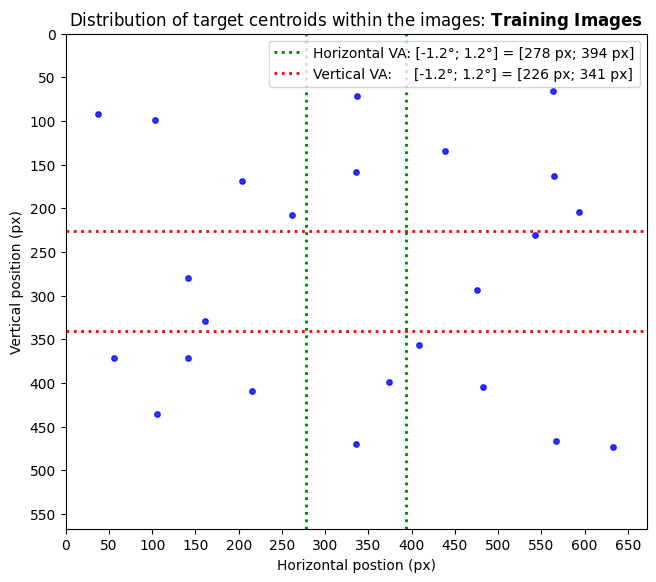

In [43]:
H_th = 1.2 # Degrees
V_th = 1.2

width = 672
height = 567

figure(figsize = (7.5, 6.428))
plt.rcdefaults()

plt.title(r"Distribution of target centroids within the images: $\bf{Training \ Images}$")
plt.scatter(x_centroid, y_centroid, color = 'b', s = 15, alpha = 0.8);

plt.xlabel("Horizontal postion (px)")
plt.ylabel("Vertical position (px)")
plt.legend(loc = "best");

plt.axvline(x = 278, color = 'g', linestyle = ':', linewidth = 2, label = f"Horizontal VA: [{-H_th}°; {H_th}°] = [278 px; 394 px]")
plt.axvline(x = 394, color = 'g', linestyle = ':', linewidth = 2)

plt.axhline(y = 226, color = 'r', linestyle = ':', linewidth = 2, label = f"Vertical VA:     [{-V_th}°; {V_th}°] = [226 px; 341 px]")
plt.axhline(y = 341, color = 'r', linestyle = ':', linewidth = 2)

plt.xlim([0, width]);
plt.ylim([height, 0])

plt.xticks(np.arange(0, width, 50))
plt.yticks(np.arange(0, height, 50))

plt.legend()
plt.show()


## Visual angle calculation

In [44]:
SCREEN_WIDTH_PX = 1920
SCREEN_HEIGHT_PX = 1080

SCREEN_DIAGONAL_SIZE_INCH = 27

def visual_angle(object_x_px, object_y_px, H_image_width_px, V_image_width_px, screen_width_px, screen_height_px):
    
    # https://www.reddit.com/r/oculus/comments/1dmcsh/default_eye_to_screen_distance/ corresponds to measurement
    #observer_distance_mm = 40 # in mm for the HMD (Oculus Rift)
    OBSERVER_DISTANCE_MM = 1000 # in mm for the C1 computer

    # Width and Height of the screen in mm
    SCREEN_WIDTH_MM = 699
    SCREEN_HEIGHT_MM = 395
 
    # Convert the size of the image in pixels to mm
    H_image_width_mm = (SCREEN_WIDTH_MM * H_image_width_px)/screen_width_px
    V_image_width_mm = (SCREEN_HEIGHT_MM * V_image_width_px)/screen_height_px

    # Visual angle of the image
    H_image_width_deg = np.degrees(2 * (np.arctan(H_image_width_mm / (OBSERVER_DISTANCE_MM * 2))))
    V_image_width_deg = np.degrees(2 * (np.arctan(V_image_width_mm / (OBSERVER_DISTANCE_MM * 2))))

    # How many degrees in the visual field represents one pixel in the images
    H_visual_angle_per_px = H_image_width_deg / H_image_width_px 
    V_visual_angle_per_px = V_image_width_deg / V_image_width_px

    H_object_x_deg = (object_x_px - (H_image_width_px / 2)) * H_visual_angle_per_px
    V_object_y_deg = (object_y_px - (V_image_width_px / 2)) * V_visual_angle_per_px

    return H_object_x_deg, V_object_y_deg

In [57]:
x,y=visual_angle(1344/2, 1134/2, 1344/2, 1134/2, SCREEN_WIDTH_PX, SCREEN_HEIGHT_PX)
print(x,y)

6.974058729692531 5.91970218693015


In [45]:
# This is for the PsycgoPy -> trial -> trialImage -> Layout -> Size[w,h] $
wPx = 1344
hPx = 1134

print(f"Size [{round(wPx * 0.5 / hPx, 3)}, 0.5]") # This mantains the proportion of width and height in the scalling done in PsychoPy

wPx = wPx * 0.5 # px
hPx = hPx * 0.5 # px

# Now we have to define how to devide the visual field for the VR headset
# In the original study had a width of 11.5 x 11.8 degrees and 640 x 640 in pixels. 
# Also, a threshold of +/- 1.2 degrees to classify the images for the LVF and RVF 

#observer_distance_mm = 40
OBSERVER_DISTANCE_MM = 1000

# Inches to mm the screen size
screen_diagonal_size_mm = SCREEN_DIAGONAL_SIZE_INCH * 25.4 

# Angle of the diagonal of the screen
width_height_angle = np.arctan(SCREEN_HEIGHT_PX/SCREEN_WIDTH_PX) # C_oposed/C_adjacent

# Width and Height of the screen in mm
screen_width_mm = 696
screen_height_mm = 395

# Convert the size of the image in pixels to mm
H_image_width_mm = (screen_width_mm * wPx)/SCREEN_WIDTH_PX
V_image_width_mm = (screen_height_mm * hPx)/SCREEN_HEIGHT_PX

# Visual angle of the image
H_image_width_deg = np.degrees(2 * (np.arctan(H_image_width_mm / (OBSERVER_DISTANCE_MM * 2))))
V_image_width_deg = np.degrees(2 * (np.arctan(V_image_width_mm / (OBSERVER_DISTANCE_MM * 2))))

print("\nWidth of the image in degrees: ", round(H_image_width_deg,3))
print("Height of the image in degrees: ", round(V_image_width_deg,3))

# Paper on Eccentricity of the target stimuli and the N2pc performance: https://www.ncbi.nlm.nih.gov/pmc/articles/PMC7160023/pdf/nihms-1065363.pdf 

Size [0.593, 0.5]

Width of the image in degrees:  13.889
Height of the image in degrees:  11.839


## Labelling targets according to the centroid location

In [64]:
import re

PYSCHOPY_RESCALLING = 0.5

IM_WIDTH = 1344 * PYSCHOPY_RESCALLING
IM_HEIGHT = 1134 * PYSCHOPY_RESCALLING

all_labelled_targets = []

for subj in range(NUM_SUBJ):

    labelled_targets = []

    for count, (target_EEG, centroid_str) in enumerate(all_centroid_mapped_targets[subj]):

        # Remove unnecessary characters and split by comma
        cleaned_string = centroid_str[2:-2].split(",")  # Removes [' and '] and splits at ','
        # Extract integers after '=' sign
        centroid = [int(s.split("=")[1]) for s in cleaned_string]

        x_VA, y_VA = visual_angle(centroid[0], centroid[1], IM_WIDTH, IM_HEIGHT, SCREEN_WIDTH_PX, SCREEN_HEIGHT_PX)

        if (x_VA > H_th):
            x_stim_type = "RVF"
        elif (x_VA < -H_th):
            x_stim_type = "LVF"
        else:
            x_stim_type = "CVF"

        if(y_VA < -V_th):
            y_stim_type = "TVF"
        elif (y_VA > V_th):
            y_stim_type = "BVF"
        else:
            y_stim_type = "CVF"

        labelled_targets.append([target_EEG, centroid[0], centroid[1], x_VA, y_VA, x_stim_type, y_stim_type])

    all_labelled_targets.append(labelled_targets)
           

# **Averaging Contralateral - Ipsilateral component: N2pc (200 - 400 ms)**

## Separating and concatenating classes

In [65]:
left_N2pc_channels = [" P7", " PO7", " PO3", " PO5", " P3", " P5", " O1"]
right_N2pc_channels = [" P8", " PO8", " PO4", " PO6", " P4", " P6", " O2"]

left_N2pc_ch_idx = pick_channels(ch, left_N2pc_channels)
right_N2pc_ch_idx = pick_channels(ch, right_N2pc_channels)

HORIZONTAL_CONDITION_COL = 5
HORIZONTAL_VA_COL = 3
X_CENTROID_COL = 1
DATA_COL = 0

VERTICAL_CONDITION_COL = 6
VERTICAL_VA_COL = 4
Y_CENTROID_COL = 2

In [66]:
all_RVF_contralateral = []
all_RVF_ipsilateral = []
all_LVF_contralateral = []
all_LVF_ipsilateral = []

all_RVF_target = []
all_LVF_target = []

all_RVF_x_pos = []
all_LVF_x_pos = []

all_RVF_y_pos = []
all_LVF_y_pos = []

for subj in range(NUM_SUBJ):

    RVF_contralateral = []
    RVF_ipsilateral = []
    LVF_contralateral = []
    LVF_ipsilateral = []

    RVF_target = []
    LVF_target = []

    RVF_x_pos = []
    LVF_x_pos = []

    RVF_y_pos = []
    LVF_y_pos = []

    for trial in all_labelled_targets[subj]:
        if(trial[HORIZONTAL_CONDITION_COL] == "RVF"):
            RVF_contralateral.append(trial[DATA_COL][left_N2pc_ch_idx,:])
            RVF_ipsilateral.append(trial[DATA_COL][right_N2pc_ch_idx,:])

            RVF_x_pos.append(trial[X_CENTROID_COL])
            RVF_y_pos.append(trial[Y_CENTROID_COL])

            RVF_target.append(trial[DATA_COL])

        elif(trial[HORIZONTAL_CONDITION_COL] == "LVF"):
            LVF_contralateral.append(trial[DATA_COL][right_N2pc_ch_idx,:])
            LVF_ipsilateral.append(trial[DATA_COL][left_N2pc_ch_idx,:])

            LVF_x_pos.append(trial[X_CENTROID_COL])
            LVF_y_pos.append(trial[Y_CENTROID_COL])

            LVF_target.append(trial[DATA_COL])

    all_RVF_contralateral.append(RVF_contralateral)
    all_RVF_ipsilateral.append(RVF_ipsilateral)

    all_RVF_target.append(RVF_target)

    all_RVF_x_pos.append(RVF_x_pos)
    all_RVF_y_pos.append(RVF_y_pos)

    all_LVF_contralateral.append(LVF_contralateral)
    all_LVF_ipsilateral.append(LVF_ipsilateral)

    all_LVF_target.append(LVF_target)

    all_LVF_x_pos.append(LVF_x_pos)
    all_LVF_y_pos.append(LVF_y_pos)

In [50]:
print("RVF Contralateral trial number:", np.shape(RVF_contralateral))
print("RVF Ipsilateral trial number:", np.shape(RVF_ipsilateral))
print("LVF Contralateral trial number:", np.shape(LVF_contralateral))
print("LVF Ipsilateral trial number:", np.shape(LVF_ipsilateral))

RVF Contralateral trial number: (100, 7, 1640)
RVF Ipsilateral trial number: (100, 7, 1640)
LVF Contralateral trial number: (100, 7, 1640)
LVF Ipsilateral trial number: (100, 7, 1640)


## Grand-Average

In [67]:
all_RVF_aver_contralateral = []
all_RVF_aver_ipsilateral = []
all_LVF_aver_contralateral = []
all_LVF_aver_ipsilateral = []

all_aver_cont = []
all_aver_ipsi = []

for subj in range(NUM_SUBJ):

    RVF_aver_contralateral = np.mean(all_RVF_contralateral[subj], axis = 0)
    RVF_aver_ipsilateral = np.mean(all_RVF_ipsilateral[subj], axis = 0)
    LVF_aver_contralateral = np.mean(all_LVF_contralateral[subj], axis = 0)
    LVF_aver_ipsilateral = np.mean(all_LVF_ipsilateral[subj], axis = 0)

    aver_cont = (RVF_aver_contralateral + LVF_aver_contralateral)/2
    aver_ipsi = (RVF_aver_ipsilateral + LVF_aver_ipsilateral)/2


    all_RVF_aver_contralateral.append(RVF_aver_contralateral)
    all_RVF_aver_ipsilateral.append(RVF_aver_ipsilateral)
    all_LVF_aver_contralateral.append(LVF_aver_contralateral)
    all_LVF_aver_ipsilateral.append(LVF_aver_ipsilateral)

    all_aver_cont.append(aver_cont)
    all_aver_ipsi.append(aver_ipsi)

RVF_aver_contralateral = np.mean(all_RVF_aver_contralateral, axis = 0)
RVF_aver_ipsilateral = np.mean(all_RVF_aver_ipsilateral, axis = 0)
LVF_aver_contralateral = np.mean(all_LVF_aver_contralateral, axis = 0)
LVF_aver_ipsilateral = np.mean(all_LVF_aver_ipsilateral, axis = 0)

RVF_std_contralateral = np.std(all_RVF_aver_contralateral, axis = 0)
RVF_std_ipsilateral = np.std(all_RVF_aver_ipsilateral, axis = 0)
LVF_std_contralateral = np.std(all_LVF_aver_contralateral, axis = 0)
LVF_std_ipsilateral = np.std(all_LVF_aver_ipsilateral, axis = 0)

RVF_N2pc_std = np.std(RVF_aver_contralateral - RVF_aver_ipsilateral, axis = 0)
LVF_N2pc_std = np.std(LVF_aver_contralateral - LVF_aver_ipsilateral, axis = 0)

aver_cont = np.mean(all_aver_cont, axis = 0)
aver_ipsi = np.mean(all_aver_ipsi, axis = 0)

std_cont = np.std(all_aver_cont, axis = 0)
std_ipsi = np.std(all_aver_ipsi, axis = 0)
N2pc_std = np.std(np.array(all_aver_cont) - np.array(all_aver_ipsi), axis = 0)

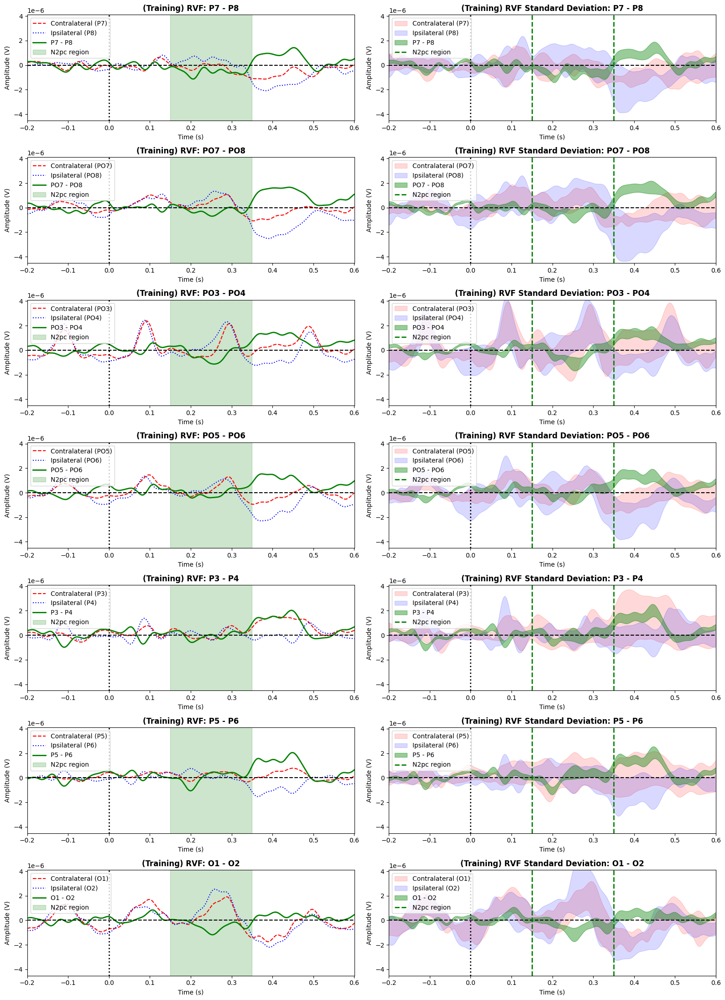

In [50]:
up_vlim = np.max(LVF_aver_ipsilateral) + np.max(LVF_std_ipsilateral) * 0.8
do_vlim = np.min(LVF_aver_ipsilateral) - np.max(LVF_std_ipsilateral)

fig, ax = plt.subplots(nrows = len(left_N2pc_ch_idx), 
                                ncols = 2,
                                figsize=(16, 22))

for i in range(len(left_N2pc_ch_idx)):

    N2pc = RVF_aver_contralateral[i] - RVF_aver_ipsilateral[i]

    ax[i,0].plot(ERP_times, 
                       RVF_aver_contralateral[i],
                       'r--', 
                       label = f"Contralateral ({clean_ch[left_N2pc_ch_idx[i]]})")
    
    ax[i,0].plot(ERP_times, 
                       RVF_aver_ipsilateral[i],
                       'b:', 
                       label = f"Ipsilateral ({clean_ch[right_N2pc_ch_idx[i]]})")
    
    ax[i,0].plot(ERP_times, 
                       N2pc,
                       'g', 
                       label = f"{clean_ch[left_N2pc_ch_idx[i]]} - {clean_ch[right_N2pc_ch_idx[i]]}", linewidth = 2)

    ax[i,0].set_xlim([np.min(ERP_times),np.max(ERP_times)])
    ax[i,0].set_ylim([do_vlim,up_vlim])

    N2pc_region = patches.Rectangle((0.15, -0.1), 0.2, 0.2, linewidth=1, edgecolor='g', facecolor='g', alpha=0.2, label = "N2pc region")
    # - `(200, -1)` is the bottom-left corner of the rectangle (x, y coordinates). Note the y values in the graph are in microVolts
    # - `200` is the width of the rectangle.
    # - `2` is the height of the rectangle.

    ax[i,0].add_patch(N2pc_region)

    ax[i,0].set_title(f"(Training) RVF: {clean_ch[left_N2pc_ch_idx[i]]} - {clean_ch[right_N2pc_ch_idx[i]]}", fontweight = 'bold')
    ax[i,0].set_xlabel('Time (s)')
    ax[i,0].set_ylabel('Amplitude (V)')
    ax[i,0].legend(loc = 'upper left')

    ax[i,0].axvline(x=0, color = 'k', label = 'Stimuli onset', linestyle='dotted', linewidth = 2)
    ax[i,0].axhline(y=0, color = 'k', linestyle = 'dashed')


    ax[i,1].fill_between(ERP_times, 
                               RVF_aver_contralateral[i] - RVF_std_contralateral[i], 
                               RVF_aver_contralateral[i] + RVF_std_contralateral[i], 
                               color = 'r', 
                               alpha=0.15,
                               label = f"Contralateral ({clean_ch[left_N2pc_ch_idx[i]]})"
    );

    ax[i,1].fill_between(ERP_times, 
                               RVF_aver_ipsilateral[i] - RVF_std_ipsilateral[i], 
                               RVF_aver_ipsilateral[i] + RVF_std_ipsilateral[i], 
                               color = 'b', 
                               alpha=0.15,
                               label = f"Ipsilateral ({clean_ch[right_N2pc_ch_idx[i]]})"
    );

    ax[i,1].fill_between(ERP_times, 
                               N2pc - RVF_N2pc_std, 
                               N2pc + RVF_N2pc_std, 
                               color = 'g', 
                               alpha=0.4,
                               label = f"{clean_ch[left_N2pc_ch_idx[i]]} - {clean_ch[right_N2pc_ch_idx[i]]}"
    );


    ax[i,1].axvline(x=0, color = 'k', linestyle='dotted', linewidth = 2)
    ax[i,1].axhline(y=0, color = 'k', linestyle = 'dashed')

    ax[i,1].axvline(x=0.15, color = 'g', label = 'N2pc region', linestyle='dashed', linewidth = 2)
    ax[i,1].axvline(x=0.35, color = 'g', linestyle='dashed', linewidth = 2)
    
    ax[i,1].set_xlim([np.min(ERP_times),np.max(ERP_times)])
    ax[i,1].set_ylim([do_vlim,up_vlim])

    ax[i,1].set_title(f"(Training) RVF Standard Deviation: {clean_ch[left_N2pc_ch_idx[i]]} - {clean_ch[right_N2pc_ch_idx[i]]}", fontweight = 'bold')
    ax[i,1].set_xlabel('Time (s)')
    ax[i,1].set_ylabel('Amplitude (V)')
    ax[i,1].legend(loc = 'upper left')
plt.tight_layout()
plt.show()

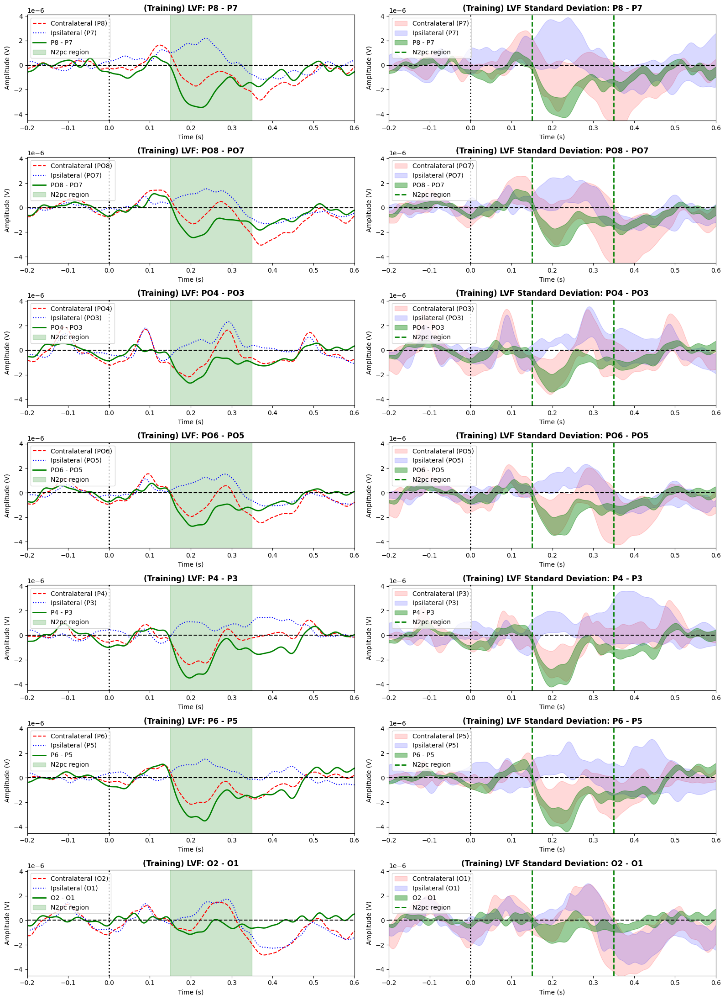

In [51]:
fig, ax = plt.subplots(nrows = len(left_N2pc_ch_idx), 
                               ncols = 2,
                               figsize=(16, 22))

for i in range(len(left_N2pc_ch_idx)):



    N2pc = LVF_aver_contralateral[i] - LVF_aver_ipsilateral[i]

    ax[i,0].plot(ERP_times, 
                       LVF_aver_contralateral[i],
                       'r--', 
                       label = f"Contralateral ({clean_ch[right_N2pc_ch_idx[i]]})")
    
    ax[i,0].plot(ERP_times, 
                       LVF_aver_ipsilateral[i],
                       'b:', 
                       label = f"Ipsilateral ({clean_ch[left_N2pc_ch_idx[i]]})")
    
    ax[i,0].plot(ERP_times, 
                       N2pc,
                       'g', 
                       label = f"{clean_ch[right_N2pc_ch_idx[i]]} - {clean_ch[left_N2pc_ch_idx[i]]}", linewidth = 2)

    ax[i,0].set_xlim([np.min(ERP_times),np.max(ERP_times)])
    ax[i,0].set_ylim([do_vlim,up_vlim])

    N2pc_region = patches.Rectangle((0.15, -0.1), 0.2, 0.2, linewidth=1, edgecolor='g', facecolor='g', alpha=0.2, label = "N2pc region")
    # - `(200, -1)` is the bottom-left corner of the rectangle (x, y coordinates). Note the y values in the graph are in microVolts
    # - `200` is the width of the rectangle.
    # - `2` is the height of the rectangle.

    ax[i,0].add_patch(N2pc_region)

    ax[i,0].set_title(f"(Training) LVF: {clean_ch[right_N2pc_ch_idx[i]]} - {clean_ch[left_N2pc_ch_idx[i]]}", fontweight = 'bold')
    ax[i,0].set_xlabel('Time (s)')
    ax[i,0].set_ylabel('Amplitude (V)')
    ax[i,0].legend(loc = 'upper left')

    ax[i,0].axvline(x=0, color = 'k', label = 'Stimuli onset', linestyle='dotted', linewidth = 2)
    ax[i,0].axhline(y=0, color = 'k', linestyle = 'dashed')


    ax[i,1].fill_between(ERP_times, 
                               LVF_aver_contralateral[i] - LVF_std_contralateral[i], 
                               LVF_aver_contralateral[i] + LVF_std_contralateral[i], 
                               color = 'r', 
                               alpha=0.15,
                               label = f"Contralateral ({clean_ch[left_N2pc_ch_idx[i]]})"
    );

    ax[i,1].fill_between(ERP_times, 
                               LVF_aver_ipsilateral[i] - LVF_std_ipsilateral[i], 
                               LVF_aver_ipsilateral[i] + LVF_std_ipsilateral[i], 
                               color = 'b', 
                               alpha=0.15,
                               label = f"Ipsilateral ({clean_ch[left_N2pc_ch_idx[i]]})"
    );

    ax[i,1].fill_between(ERP_times, 
                               N2pc - LVF_N2pc_std, 
                               N2pc + LVF_N2pc_std, 
                               color = 'g', 
                               alpha=0.4,
                               label = f"{clean_ch[right_N2pc_ch_idx[i]]} - {clean_ch[left_N2pc_ch_idx[i]]}"
    );


    ax[i,1].axvline(x=0, color = 'k', linestyle='dotted', linewidth = 2)
    ax[i,1].axhline(y=0, color = 'k', linestyle = 'dashed')

    ax[i,1].axvline(x=0.15, color = 'g', label = 'N2pc region', linestyle='dashed', linewidth = 2)
    ax[i,1].axvline(x=0.35, color = 'g', linestyle='dashed', linewidth = 2)
    
    ax[i,1].set_xlim([np.min(ERP_times),np.max(ERP_times)])
    ax[i,1].set_ylim([do_vlim,up_vlim])

    ax[i,1].set_title(f"(Training) LVF Standard Deviation: {clean_ch[right_N2pc_ch_idx[i]]} - {clean_ch[left_N2pc_ch_idx[i]]}", fontweight = 'bold')
    ax[i,1].set_xlabel('Time (s)')
    ax[i,1].set_ylabel('Amplitude (V)')
    ax[i,1].legend(loc = 'upper left')

plt.tight_layout()
plt.show()

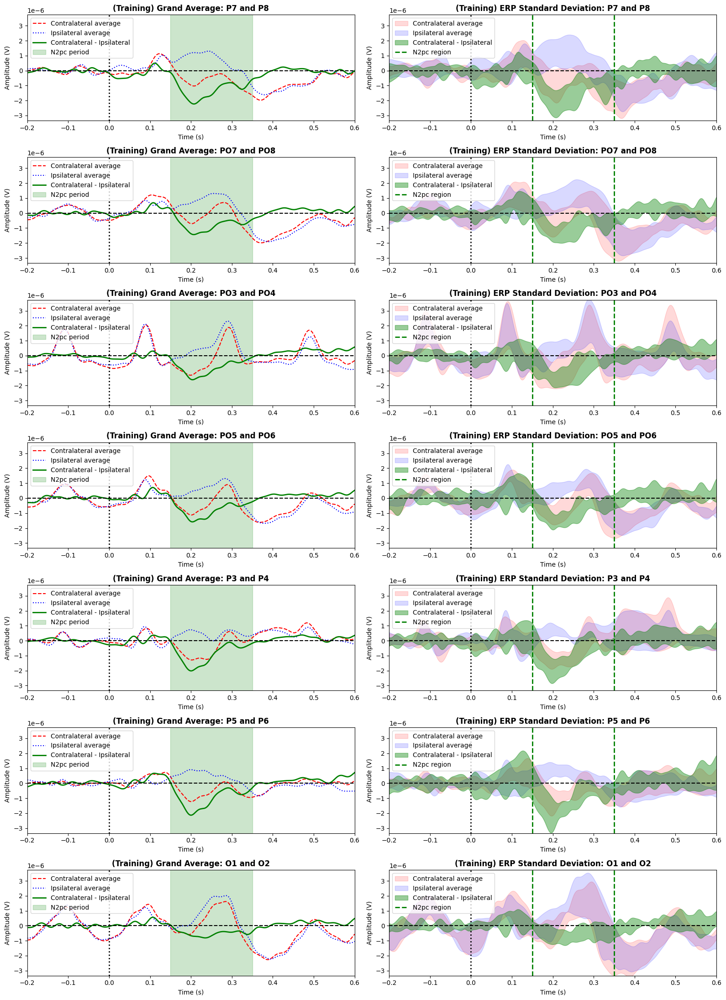

In [68]:
up_vlim = np.max(aver_ipsi) + np.max(std_cont) * 0.7
do_vlim = np.min(aver_cont - aver_ipsi) - np.max(N2pc_std) * 0.7

fig, ax = plt.subplots(nrows = len(left_N2pc_ch_idx), 
                                ncols = 2,
                                figsize=(16, 22))

for i in range(len(left_N2pc_ch_idx)):



    N2pc = aver_cont[i] - aver_ipsi[i]

    ax[i,0].plot(ERP_times, 
                       aver_cont[i],
                       'r--', 
                       label = 'Contralateral average')
    
    ax[i,0].plot(ERP_times, 
                       aver_ipsi[i],
                       'b:', 
                       label = 'Ipsilateral average')
    
    ax[i,0].plot(ERP_times, 
                       N2pc,
                       'g', 
                       label = "Contralateral - Ipsilateral", linewidth = 2)

    ax[i,0].set_xlim([np.min(ERP_times), np.max(ERP_times)])
    ax[i,0].set_ylim([do_vlim, up_vlim])

    N2pc_region = patches.Rectangle((0.15, -0.1), 0.2, 0.2, linewidth=1, edgecolor='g', facecolor='g', alpha=0.2, label = "N2pc period")    

    ax[i,0].add_patch(N2pc_region)

    ax[i,0].set_title(f"(Training) Grand Average: {clean_ch[left_N2pc_ch_idx[i]]} and {clean_ch[right_N2pc_ch_idx[i]]}", fontweight = 'bold')
    ax[i,0].set_xlabel('Time (s)')
    ax[i,0].set_ylabel('Amplitude (V)')
    ax[i,0].legend(loc='upper left')

    ax[i,0].axvline(x=0, color = 'k', label = 'Stimuli onset', linestyle='dotted', linewidth = 2)
    ax[i,0].axhline(y=0, color = 'k', linestyle = 'dashed')



    ax[i,1].fill_between(ERP_times, 
                     aver_cont[i] - std_cont[i], 
                     aver_cont[i] + std_cont[i], 
                     color = 'r', 
                     alpha=0.15,
                     label = 'Contralateral average'
    );

    ax[i,1].fill_between(ERP_times, 
                     aver_ipsi[i] - std_ipsi[i], 
                     aver_ipsi[i] + std_ipsi[i], 
                     color = 'b', 
                     alpha=0.15,
                     label = 'Ipsilateral average'
    );

    ax[i,1].fill_between(ERP_times, 
                     N2pc - N2pc_std[i], 
                     N2pc + N2pc_std[i], 
                     color = 'g', 
                     alpha=0.4,
                     label = "Contralateral - Ipsilateral"
    );

    ax[i,1].axvline(x=0, color = 'k', linestyle='dotted', linewidth = 2)
    ax[i,1].axhline(y=0, color = 'k', linestyle = 'dashed')

    ax[i,1].axvline(x=0.15, color = 'g', label = 'N2pc region', linestyle='dashed', linewidth = 2)
    ax[i,1].axvline(x=0.35, color = 'g', linestyle='dashed', linewidth = 2)
    
    ax[i,1].set_xlim([np.min(ERP_times),np.max(ERP_times)])
    ax[i,1].set_ylim([do_vlim,up_vlim])

    ax[i,1].set_title(f"(Training) ERP Standard Deviation: {clean_ch[left_N2pc_ch_idx[i]]} and {clean_ch[right_N2pc_ch_idx[i]]}", fontweight = 'bold')
    ax[i,1].set_xlabel('Time (s)')
    ax[i,1].set_ylabel('Amplitude (V)')
    ax[i,1].legend(loc = 'upper left')

plt.tight_layout()
plt.show()

## RVF vs LVF Topomaps

Max vlim:  2.3133048210296398e-06
Min vlim:  -2.3824112188789547e-06


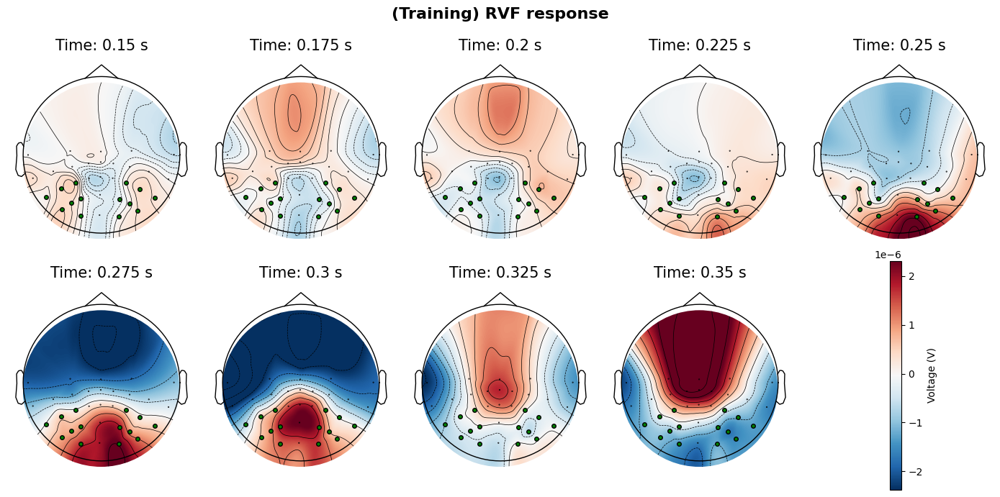

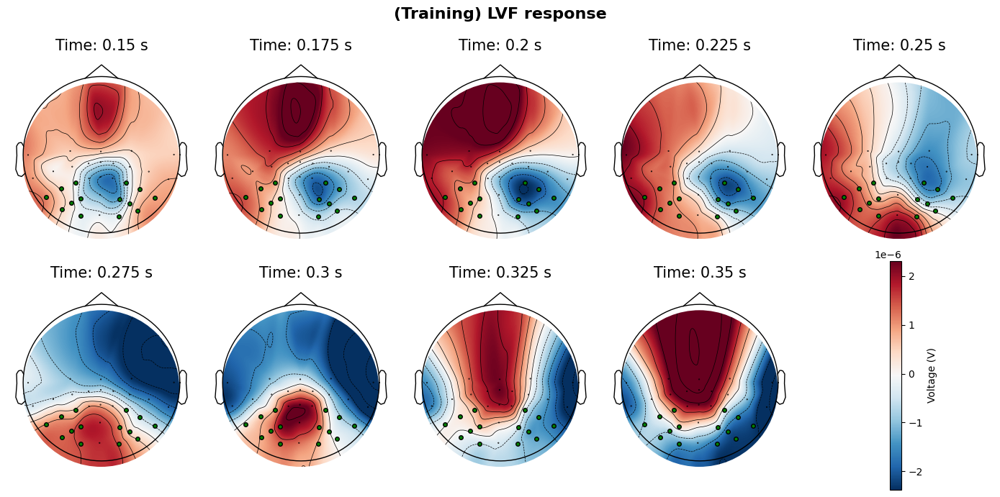

In [60]:
RVF_ERP = np.mean(np.mean(all_RVF_target, axis = 0), axis = 0)
LVF_ERP = np.mean(np.mean(all_LVF_target, axis = 0), axis = 0)

t_win = 0.01

t_intervals = [0.15,
               0.175, 
               0.2, 
               0.225, 
               0.25, 
               0.275, 
               0.3,
               0.325,
               0.35,
               0] # ms

t_sample_start = np.argmin(np.abs(ERP_times - t_intervals[0]))
t_sample_stop = np.argmin(np.abs(ERP_times - t_intervals[-2]))

vmap_max = np.max(LVF_ERP[left_N2pc_ch_idx,t_sample_start:t_sample_stop])
vmap_min = np.min(LVF_ERP[right_N2pc_ch_idx,t_sample_start:t_sample_stop])

print("Max vlim: ", vmap_max)
print("Min vlim: ", vmap_min)

N2pc_ch_idx = np.hstack((left_N2pc_ch_idx, right_N2pc_ch_idx))

highlight_ch = [1 if c in N2pc_ch_idx else 0 for c in range(len(clean_ch))]

fig, axes = plt.subplots(nrows = 2, 
                         ncols = int(len(t_intervals)/2), 
                         figsize=(14, 7))


# --------------------------------------------- RVF ---------------------------------------------

fig.suptitle("(Training) RVF response", fontweight='bold', fontsize=16)

for n, t_ms in enumerate(t_intervals):

    ax = axes.flat[n]

    if(n < len(t_intervals) - 1):

        ax.set_title(f"Time: {t_ms} s", fontsize=15)

        t_sample_start = np.argmin(np.abs(ERP_times - t_ms + t_win))
        t_sample_stop = np.argmin(np.abs(ERP_times - t_ms - t_win))
        
        dt = np.mean(RVF_ERP[:,t_sample_start:t_sample_stop], axis = 1)

        im, cn = mne.viz.plot_topomap(dt,
                                      rereferenced_EEGs[0].info,
                                      contours = 10,
                                      vlim = (vmap_min, vmap_max),
                                      mask = np.array(highlight_ch),
                                      mask_params = mk,
                                      size = 10,
                                      sphere = (0.0011, 0.015, 0.12, 0.2),
                                      axes = ax,
                                      show = False,
                                      res = 1024)
        
    else:
        
        # Hide axis line
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)

        # Hide axis labels (optional)
        ax.set_xlabel('')
        ax.set_ylabel('')

        ax.set_xticks(ax.get_xticks())  # Get current xtick positions
        ax.set_xticklabels([])
        ax.set_yticks(ax.get_yticks())  # Get current xtick positions
        ax.set_yticklabels([])

        ax.tick_params(bottom = False, left = False, which='both')

        cax = fig.colorbar(im, ax = ax, fraction = 0.55)
        cax.set_label("Voltage (V)")

plt.tight_layout()
plt.show()

fig, axes = plt.subplots(nrows = 2, 
                         ncols = int(len(t_intervals)/2), 
                         figsize=(14, 7))

# --------------------------------------------- LVF ---------------------------------------------

fig.suptitle("(Training) LVF response", fontweight='bold', fontsize=16)

for n, t_ms in enumerate(t_intervals):

    '''
    .flat is a NumPy attribute that flattens the array into a 1D view. This means it transforms a potentially multi-dimensional array into a single list-like structure.
    '''

    ax = axes.flat[n]

    if(n < len(t_intervals) - 1):

        ax.set_title(f"Time: {t_ms} s", fontsize=15)

        t_sample_start = np.argmin(np.abs(ERP_times - t_ms + t_win))
        t_sample_stop = np.argmin(np.abs(ERP_times - t_ms - t_win))
        
        dt = np.mean(LVF_ERP[:,t_sample_start:t_sample_stop], axis = 1)
        
        im, cn = mne.viz.plot_topomap(dt,
                                      rereferenced_EEGs[0].info,
                                      contours = 10,
                                      vlim = (vmap_min, vmap_max),
                                      mask = np.array(highlight_ch),
                                      mask_params = mk,
                                      size = 10,
                                      sphere = (0.0011, 0.015, 0.12, 0.2),
                                      axes = ax,
                                      show = False,
                                      res = 1024)
    
    else:
        
        # Hide axis line
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)

        # Hide axis labels (optional)
        ax.set_xlabel('')
        ax.set_ylabel('')

        ax.set_xticks(ax.get_xticks())  # Get current xtick positions
        ax.set_xticklabels([])
        ax.set_yticks(ax.get_yticks())  # Get current xtick positions
        ax.set_yticklabels([])

        ax.tick_params(bottom = False, left = False, which='both')

        cax = fig.colorbar(im, ax = ax, fraction = 0.55)
        cax.set_label("Voltage (V)")

plt.tight_layout()
plt.show()

## Calculate the single-trial N2pc component

In [78]:
from scipy.signal import resample

In [204]:
from scipy.signal import resample

# Isolating the datapoints related to the N2pc time window 

n_trials, n_channels, _ = np.shape(RVF_contralateral)

ts = 0.15
te = 0.35

idx_s = np.argmin(np.abs(ERP_times - ts))
idx_e = np.argmin(np.abs(ERP_times - te))

# Resampling the resulting time window (Prevents overfitting)

RESAMPLE_FREQ = 64 # Hz
N_DATAPOINTS_ORIG_FREQ = len(ERP_times[idx_s:idx_e+1])
N_DATAPOINTS_RESA_FREQ = int(np.ceil((N_DATAPOINTS_ORIG_FREQ * RESAMPLE_FREQ)/fs)) + 1

all_featVectLVF = [] # Class label = 0
all_featVectRVF = [] # Class label = 1

all_NN_featVectLVF = []
all_NN_featVectRVF = []

for subj in range(NUM_SUBJ):

    featVectLVF = []
    featVectRVF = []

    NN_featVectLVF = []
    NN_featVectRVF = []

    for trial in range(n_trials):

        #LVF = resample(all_LVF_contralateral[subj][trial][:,idx_s:idx_e+1] - all_LVF_ipsilateral[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
        #RVF = resample(all_RVF_contralateral[subj][trial][:,idx_s:idx_e+1] - all_RVF_ipsilateral[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)

        LVF1 = resample(all_LVF_contralateral[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
        LVF2 = resample(all_LVF_ipsilateral[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
        
        RVF1 = resample(all_RVF_ipsilateral[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
        RVF2 = resample(all_RVF_contralateral[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
        
        LVF = np.hstack((LVF1, LVF2))
        RVF = np.hstack((RVF2, RVF1))

        for c in range(1, n_channels):

            if (c == 1):
                auxLVF = np.hstack((LVF[c-1,:],LVF[c,:]))
                auxRVF = np.hstack((RVF[c-1,:],RVF[c,:]))
            else:
                auxLVF = np.hstack((auxLVF,LVF[c,:]))
                auxRVF = np.hstack((auxRVF,RVF[c,:]))

        featVectLVF.append(np.hstack((auxLVF, 0)))
        featVectRVF.append(np.hstack((auxRVF, 1)))

        NN_featVectLVF.append(np.hstack((auxLVF, all_LVF_x_pos[subj][trial])))
        NN_featVectRVF.append(np.hstack((auxRVF, all_RVF_x_pos[subj][trial])))

    all_featVectLVF.append(featVectLVF)
    all_featVectRVF.append(featVectRVF) 

    all_NN_featVectLVF.append(NN_featVectLVF)
    all_NN_featVectRVF.append(NN_featVectRVF)

print(np.shape(all_featVectLVF))
print(np.shape(all_featVectRVF))

print(np.shape(all_NN_featVectLVF))
print(np.shape(all_NN_featVectRVF))

(6, 100, 197)
(6, 100, 197)
(6, 100, 197)
(6, 100, 197)


# **Classifying N2pc: RVF vs LVF**

## Train/Validation Split and concatenate feature vectors for all channel differences

In [83]:
PERCENT_TRAIN = 0.75

In [205]:
n_trials = np.size(featVectLVF, 0)
n_train = int(np.ceil(n_trials * PERCENT_TRAIN))

all_train_featVect = []
all_test_featVect = []

for subj in range(NUM_SUBJ):

    train_featVect = np.vstack((all_featVectLVF[subj][:n_train], all_featVectRVF[subj][:n_train]))
    test_featVect = np.vstack((all_featVectLVF[subj][n_train:], all_featVectRVF[subj][n_train:]))

    np.random.seed(42)
    np.random.shuffle(train_featVect)
    np.random.seed(42)
    np.random.shuffle(test_featVect)

    all_train_featVect.append(train_featVect)
    all_test_featVect.append(test_featVect)

print(np.shape(all_train_featVect))
print(np.shape(all_test_featVect))

(6, 150, 197)
(6, 50, 197)


## Row-wise normalization of the feature vector

Improved Model Performance: Many machine learning algorithms, especially those based on distances (e.g., k-Nearest Neighbors, SVMs), rely on the relative scales of features. Standardization ensures all features contribute equally to the distance calculations, potentially leading to better model performance.


Faster Convergence: In neural networks and other gradient-based optimization algorithms, standardization can help them converge faster during training.

In [206]:
# Feature wise normalization of feature vector

all_norm_train_featVect = []
all_norm_test_featVect = []

ROW_WISE_NORM = True

for subj in range(NUM_SUBJ):

    if(ROW_WISE_NORM):  

        n_entries = np.size(all_train_featVect, 1)

        norm_train_featVect = []

        for j in range(n_entries):

            mean = np.mean(all_train_featVect[subj][j, 0:-1])
            std = np.std(all_train_featVect[subj][j, 0:-1])
            norm_train_featVect.append(np.hstack(((all_train_featVect[subj][j,0:-1] - mean) / std, all_train_featVect[subj][j, -1])))


        n_entries = np.size(all_test_featVect, 1)

        norm_test_featVect = []

        for u in range(n_entries):

            mean = np.mean(all_test_featVect[subj][u,0:-1])
            std = np.std(all_test_featVect[subj][u,0:-1])
            norm_test_featVect.append(np.hstack(((all_test_featVect[subj][u,0:-1] - mean) / std, all_test_featVect[subj][u, -1])))

        train_featVect = np.array(norm_train_featVect)
        test_featVect = np.array(norm_test_featVect)

    else:

        n_entries = np.size(all_train_featVect, 2) - 1

        norm_train_featVect = []

        for j in range(n_entries):

            mean = np.mean(all_train_featVect[subj][:, j])
            std = np.std(all_train_featVect[subj][:, j])
            norm_train_featVect.append(((all_train_featVect[subj][:, j] - mean)))

        n_entries = np.size(all_test_featVect, 2) - 1

        norm_test_featVect = []

        for u in range(n_entries):

            mean = np.mean(all_test_featVect[subj][:,u])
            std = np.std(all_test_featVect[subj][:,u])
            norm_test_featVect.append((all_test_featVect[subj][: ,u] - mean) / std)

        train_featVect = np.array(np.vstack((norm_train_featVect, all_train_featVect[subj][:, -1]))).T
        test_featVect = np.array(np.vstack((norm_test_featVect, all_test_featVect[subj][:, -1]))).T

    all_norm_train_featVect.append(train_featVect)
    all_norm_test_featVect.append(test_featVect)

print(np.shape(all_norm_train_featVect))
print(np.shape(all_norm_test_featVect))

(6, 150, 197)
(6, 50, 197)


## Mutual Based Information

In [86]:
from sklearn.feature_selection import mutual_info_classif
from sklearn.feature_selection import SelectKBest

In [87]:
k_feat = N_DATAPOINTS_RESA_FREQ * 7

all_best_feat_idx = []

for subj in range(NUM_SUBJ):

    best_feat_idx = SelectKBest(mutual_info_classif, k = k_feat).fit(all_norm_train_featVect[subj][:,0:-1], all_norm_train_featVect[subj][:,-1]).get_support()
    best_feat_idx = np.append(best_feat_idx, False) # False is because this field is reserved for the Class label and not a feature

    all_best_feat_idx.append(best_feat_idx)
    
print(np.shape(all_best_feat_idx))

(6, 197)


### Distribution of channel importance for classification

In [88]:
n_ch = len(right_N2pc_ch_idx) * 2

all_tf = []

for subj in range(NUM_SUBJ):

    tf = np.zeros(n_ch)
    cont = np.ones(N_DATAPOINTS_RESA_FREQ)

    for i in range(n_ch):
        tf[i] = (np.sum(cont[all_best_feat_idx[subj][i*N_DATAPOINTS_RESA_FREQ:i*N_DATAPOINTS_RESA_FREQ+N_DATAPOINTS_RESA_FREQ]]))

    all_tf.append(tf)

print(np.shape(all_tf))

(6, 14)


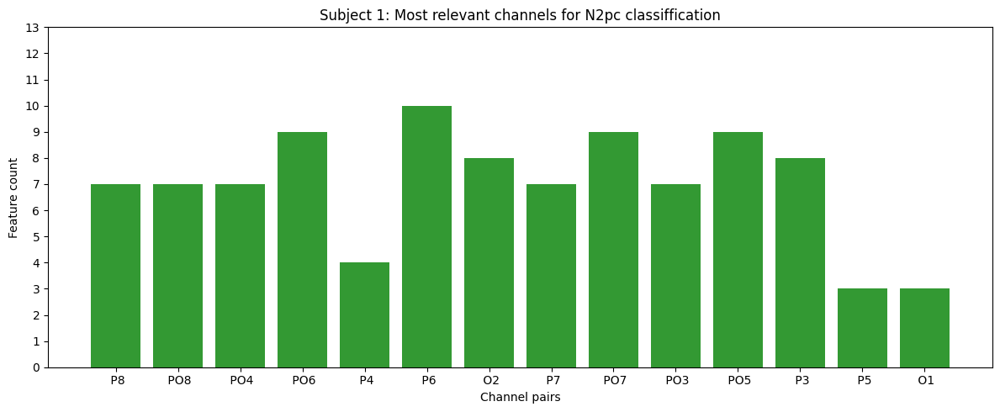

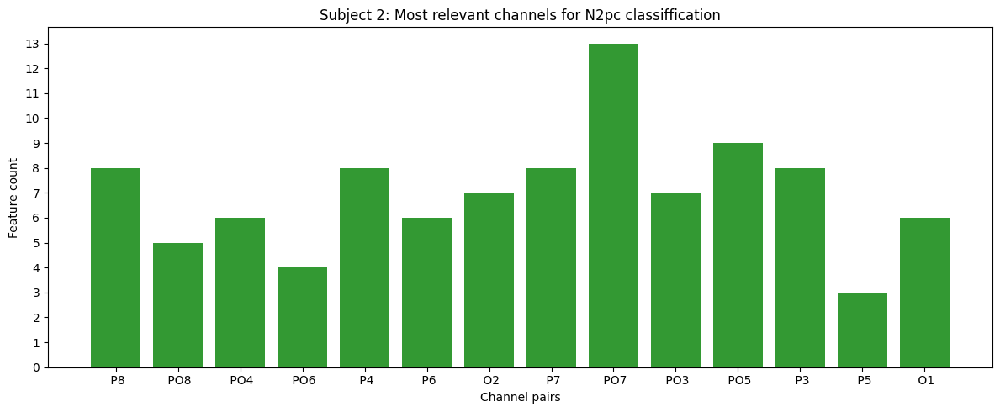

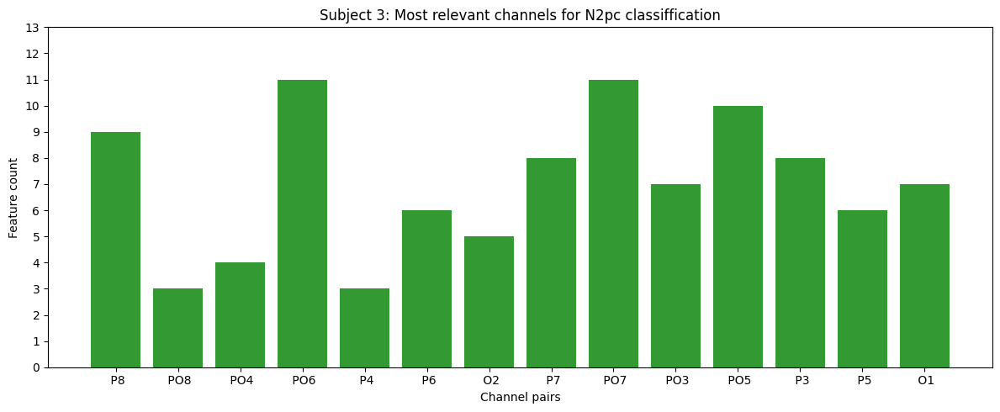

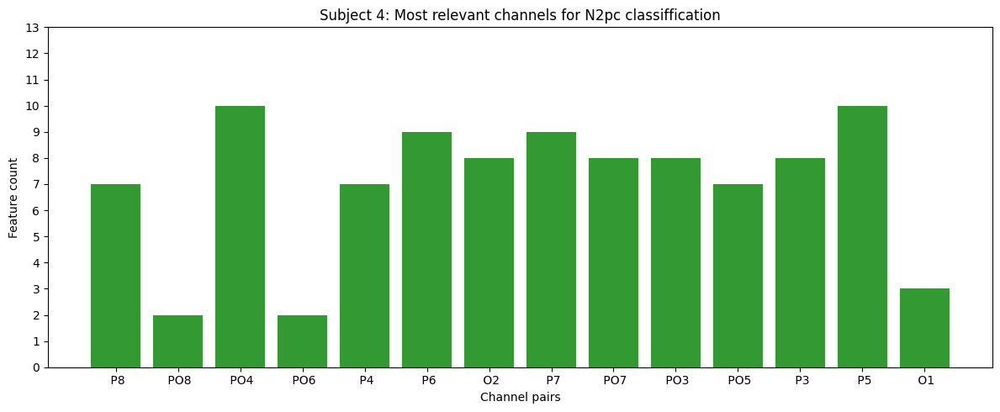

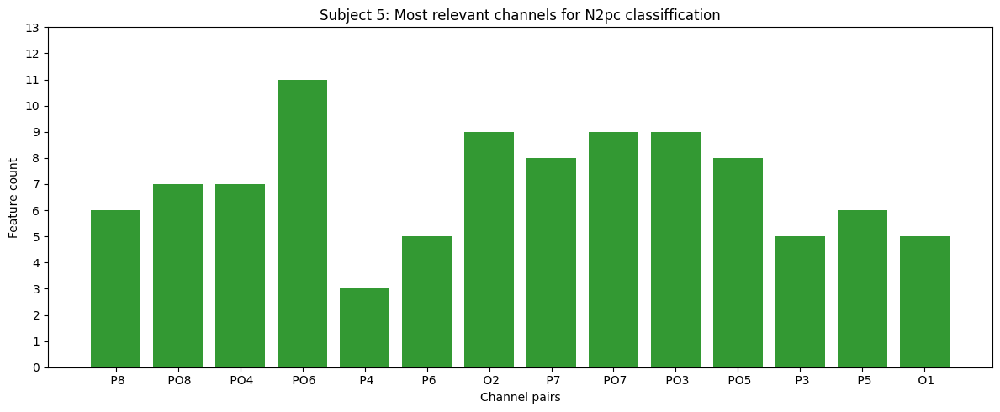

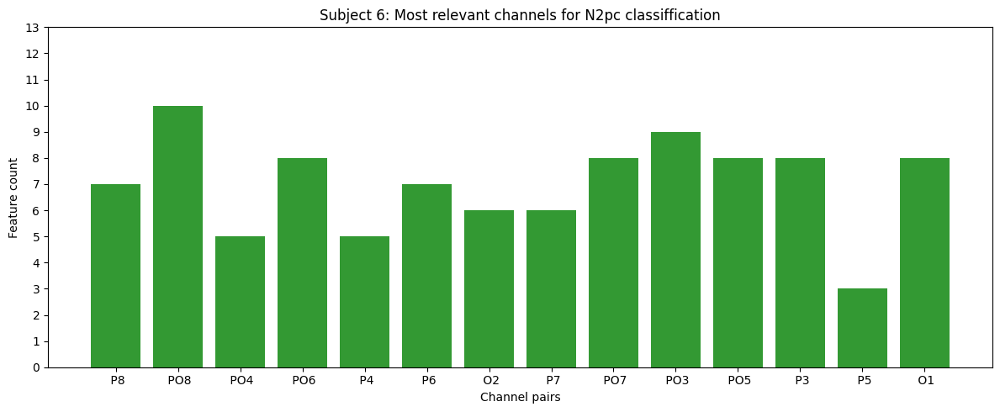

In [89]:
max_y = np.max(all_tf)

for subj in range(NUM_SUBJ):

    customlb = []

    for c, lb in enumerate(right_N2pc_channels):
        customlb.append(str(lb))
    
    for c, lb in enumerate(left_N2pc_channels):
        customlb.append(str(lb))
    
    fig, ax = plt.subplots(figsize=(12, 5))

    ax.set_title(f'Subject {subj +1}: Most relevant channels for N2pc classiffication')

    ax.bar(np.arange(1, n_ch + 1), 
           all_tf[subj], 
           color="g", 
           capsize=4, 
           alpha = 0.8)
    
    ax.set(xticks=np.arange(1, n_ch + 1), 
           xlabel='Channel pairs', 
           yticks=np.arange(0, max_y + 1, step=1),
           ylabel = "Feature count")
    
    ax.set_xticklabels(customlb);

    plt.rcdefaults()
    plt.tight_layout()
    plt.show();

### Selecting the most relevant channel for classification

In [90]:
all_best_channel_feat_idx = []

for subj in range(NUM_SUBJ):

    best_channel_feat_idx = np.zeros(len(best_feat_idx))

    for i in range(len(tf)):
        if(all_tf[subj][i] >= sorted(all_tf[subj], reverse = True)[6]):
            best_channel_feat_idx[i * N_DATAPOINTS_RESA_FREQ:i * N_DATAPOINTS_RESA_FREQ + N_DATAPOINTS_RESA_FREQ] = 1
        else:
            best_channel_feat_idx[i * N_DATAPOINTS_RESA_FREQ: i * N_DATAPOINTS_RESA_FREQ + N_DATAPOINTS_RESA_FREQ] = 0

    best_channel_feat_idx = best_channel_feat_idx != 0 # Convert to boolean

    all_best_channel_feat_idx.append(best_channel_feat_idx)

## Classification models

#### Most dicriminative channels

In [69]:
print("========================== Most discriminative channels ==========================\n")

perSubj_cross_val_scores = np.zeros((NUM_SUBJ, 5, 2))
perSubj_accuracy = np.zeros((NUM_SUBJ, 5)) # 5 Classifiers
perSubj_auc_scores = np.zeros((NUM_SUBJ, 5))
perSubj_fitting_periods = np.zeros((NUM_SUBJ, 5))

for subj in range(NUM_SUBJ):

    print(f"\n------------------ Subject {subj + 1}: Classifying RVF vs LVF ------------------\n")

    for c_count, clf in enumerate(classifiers):

        print(f"\n------------------ Classifier: {clf} ------------------")

        lateral_n2pc_clf = clf

        # --------- Cross Validation Scores ---------
        cross_val_scores, best_lateral_n2pc_clf = GridSearch(classifier_params[c_count], 
                                                   lateral_n2pc_clf, 
                                                   KFOLD, 
                                                   all_norm_train_featVect[subj][:,all_best_channel_feat_idx[subj]],
                                                   all_norm_train_featVect[subj][:,-1])
        
        perSubj_cross_val_scores[subj, c_count, 0] = cross_val_scores[0]
        perSubj_cross_val_scores[subj, c_count, 1] = cross_val_scores[1]
        perSubj_fitting_periods[subj, c_count] = cross_val_scores[2]

        # --------- Predictions ---------
        pred = best_lateral_n2pc_clf.predict(all_norm_test_featVect[subj][:, all_best_channel_feat_idx[subj]])
        perSubj_accuracy[subj, c_count] = round(accuracy_score(all_norm_test_featVect[subj][:, -1], pred), 2) * 100
        
        print("\nAccuracy: ", round(accuracy_score(all_norm_test_featVect[subj][:, -1], pred), 2) * 100)
        print(best_lateral_n2pc_clf)

        # Compute AUC for each subject
        perSubj_auc_scores[subj, c_count] = round(roc_auc_score(all_norm_test_featVect[subj][:, -1], best_lateral_n2pc_clf.predict_proba(all_norm_test_featVect[subj][:,all_best_channel_feat_idx[subj]])[:,1]), 2)

        del lateral_n2pc_clf, best_lateral_n2pc_clf # Ensures no mixing of classifiers within the loop


========================== Most discriminative channels ==========================


------------------ Subject 1: Classifying RVF vs LVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 1, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.7466666666666667

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.7133333333333333

Running Grid Search for method: poly

Best parameters: {'C': 0.001, 'cache_size': 200, 'degree': 3, 'gamma': 0.1, 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.6799999999999999

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.7066666666666668

Accuracy:  64.0
SVC(C=1, kernel='l

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.5, 'n_estimators': 100, 'random_state': 42}
Best score: 0.6866666666666666

Accuracy:  56.00000000000001
AdaBoostClassifier(learning_rate=0.5, n_estimators=100, random_state=42)

------------------ Subject 2: Classifying RVF vs LVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.001, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.6533333333333333

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'scale', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.01}
Best score: 0.6599999999999999

Running Grid Search for method: poly

Best parameters: {'C': 1, 'cache_size': 200, 'degree': 3, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.01}
Best score: 0.6333333333333333

Running Grid Search for method: sigmoid

Best parameters: {'C': 0.1, 'cache_size': 20

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.1, 'n_estimators': 50, 'random_state': 42}
Best score: 0.6466666666666667

Accuracy:  56.00000000000001
AdaBoostClassifier(learning_rate=0.1, random_state=42)

------------------ Subject 3: Classifying RVF vs LVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.1, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.76

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.01}
Best score: 0.7266666666666666

Running Grid Search for method: poly

Best parameters: {'C': 1, 'cache_size': 200, 'degree': 3, 'gamma': 'scale', 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.74

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_sta

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.1, 'n_estimators': 50, 'random_state': 42}
Best score: 0.7333333333333334

Accuracy:  57.99999999999999
AdaBoostClassifier(learning_rate=0.1, random_state=42)

------------------ Subject 4: Classifying RVF vs LVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.01, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.6599999999999999

Running Grid Search for method: rbf

Best parameters: {'C': 10, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.6466666666666666

Running Grid Search for method: poly

Best parameters: {'C': 1, 'cache_size': 200, 'degree': 3, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.6333333333333333

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'ker

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.1, 'n_estimators': 100, 'random_state': 42}
Best score: 0.6599999999999999

Accuracy:  66.0
AdaBoostClassifier(learning_rate=0.1, n_estimators=100, random_state=42)

------------------ Subject 5: Classifying RVF vs LVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 10, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.6599999999999999

Running Grid Search for method: rbf

Best parameters: {'C': 10, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.6066666666666667

Running Grid Search for method: poly

Best parameters: {'C': 0.001, 'cache_size': 200, 'degree': 3, 'gamma': 0.1, 'kernel': 'poly', 'random_state': 42, 'tol': 0.01}
Best score: 0.66

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 's

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 1.0, 'n_estimators': 200, 'random_state': 42}
Best score: 0.6466666666666666

Accuracy:  50.0
AdaBoostClassifier(n_estimators=200, random_state=42)

------------------ Subject 6: Classifying RVF vs LVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.001, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.6599999999999999

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.01}
Best score: 0.6666666666666667

Running Grid Search for method: poly

Best parameters: {'C': 0.001, 'cache_size': 200, 'degree': 2, 'gamma': 1, 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.6533333333333333

Running Grid Search for method: sigmoid

Best parameters: {'C': 0.1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigm

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 1.0, 'n_estimators': 200, 'random_state': 42}
Best score: 0.6466666666666666

Accuracy:  50.0
AdaBoostClassifier(n_estimators=200, random_state=42)


#### Cross-Validation Training Classification differences between different classifiers (N2pc - Most dicriminative channels)

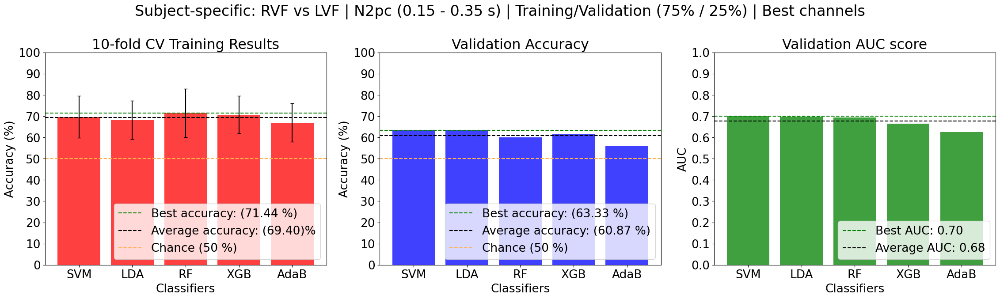

In [71]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 3,
                       figsize=(23, 7))

fig.suptitle(f'Subject-specific: RVF vs LVF | N2pc ({ts} - {te} s) | Training/Validation (75% / 25%) | Best channels', fontsize=24)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 19})
ax[0].bar(np.arange(1, 6), 
       np.mean(perSubj_cross_val_scores[:,:,0], axis = 0 ), 
       color="red", 
       yerr = np.mean(perSubj_cross_val_scores[:,:,1], axis = 0), 
       capsize=3,
       alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(np.mean(perSubj_cross_val_scores[:,:,0], axis = 0)), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(np.mean(perSubj_cross_val_scores[:,:,0], axis = 0)):.2f} %)')

ax[0].axhline(y = np.mean(perSubj_cross_val_scores[:,:,0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(perSubj_cross_val_scores[:,:,0]):.2f})%')

ax[0].axhline(y=50, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (50 %)')

ax[0].set(xticks = np.arange(1, 5 + 1), 
       xticklabels = class_list,
       xlabel = 'Classifiers', 
       yticks=np.arange(0, 101, step=10), ylabel='Accuracy (%)',
       title=f'{KFOLD}-fold CV Training Results');

ax[0].legend(loc='lower right');


# -------------- Prediction Accuracy --------------

ax[1].bar(np.arange(1, 6), 
          np.mean(perSubj_accuracy, axis = 0 ), 
          color="b",
          alpha = 0.75)

ax[1].set_title('Accuracy (%)')

ax[1].axhline(y = max(np.mean(perSubj_accuracy, axis = 0)), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(np.mean(perSubj_accuracy, axis = 0)):.2f} %)')

ax[1].axhline(y = np.mean(perSubj_accuracy), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy):.2f} %)')

ax[1].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50 %)')

ax[1].set(xticks = np.arange(1, 5 + 1), 
          xticklabels = class_list,
          xlabel = 'Classifiers', 
          yticks=np.arange(0, 101, step=10), ylabel='Accuracy (%)',
          title="Validation Accuracy");

ax[1].legend(loc='lower right');


# -------------- Aread Under the Curve (AUC) --------------

ax[2].bar(np.arange(1, 6), 
          np.mean(perSubj_auc_scores, axis = 0 ), 
          color="g",
          alpha = 0.75)

ax[2].set_title('AUC ')

ax[2].axhline(y = max(np.mean(perSubj_auc_scores, axis = 0)), 
              color='green', linestyle='--', 
              label = f'Best AUC: {max(np.mean(perSubj_auc_scores, axis = 0)):.2f}')

ax[2].axhline(y = np.mean(perSubj_auc_scores), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: {np.mean(perSubj_auc_scores):.2f}')

ax[2].set(xticks = np.arange(1, 5 + 1), 
          xticklabels = class_list,
          xlabel = 'Classifiers', 
          yticks=np.arange(0, 1.01, step=0.1), ylabel='AUC',
          title="Validation AUC score");

ax[2].legend(loc='lower right');
plt.tight_layout()

#### Best classifier Cross-Validation Training accuracies for all subjects (N2pc - Most dicriminative channels)

In [ ]:
best_class =  []

for subj in range(NUM_SUBJ):

    best_class.append(f"{subj +1}-{class_list[np.argmax(perSubj_accuracy[subj])]}")

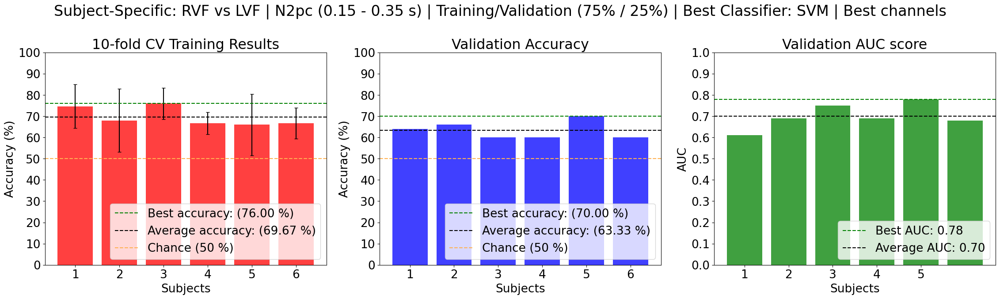

In [72]:
best_classifier = np.argmax(np.mean(perSubj_accuracy, axis = 0))

fig, ax = plt.subplots(nrows = 1,
                       ncols = 3,
                       figsize=(23, 7))

fig.suptitle(f'Subject-Specific: RVF vs LVF | N2pc ({ts} - {te} s) | Training/Validation (75% / 25%) | Best Classifier: {class_list[best_classifier]} | Best channels', fontsize=24)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 19})
ax[0].bar(np.arange(1, NUM_SUBJ + 1), 
       perSubj_cross_val_scores[:,best_classifier, 0], 
       color="red", 
       yerr = perSubj_cross_val_scores[:,best_classifier, 1], 
       capsize=3,
       alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(perSubj_cross_val_scores[:,best_classifier, 0]), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(perSubj_cross_val_scores[:,best_classifier, 0]):.2f} %)')

ax[0].axhline(y = np.mean(perSubj_cross_val_scores[:,best_classifier, 0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(perSubj_cross_val_scores[:,best_classifier, 0]):.2f} %)')

ax[0].axhline(y=50, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (50 %)')

ax[0].set(xticks = np.arange(1, NUM_SUBJ + 1), 
         xlabel = 'Subjects', 
         yticks=np.arange(0, 101, step=10), 
         ylabel='Accuracy (%)',
         title=f'{KFOLD}-fold CV Training Results');

ax[0].legend(loc='lower right');


# -------------- Prediction Accuracy --------------

ax[1].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_accuracy[:,best_classifier], 
          color="b",
          alpha = 0.75)

ax[1].set_title('Accuracy (%)')

ax[1].axhline(y = max(perSubj_accuracy[:,best_classifier]), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(perSubj_accuracy[:,best_classifier]):.2f} %)')

ax[1].axhline(y = np.mean(perSubj_accuracy[:,best_classifier]), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy[:,best_classifier]):.2f} %)')

ax[1].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50 %)')

ax[1].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 101, step=10), 
          ylabel='Accuracy (%)',
          title="Validation Accuracy");

ax[1].legend(loc='lower right');


# -------------- Aread Under the Curve (AUC) --------------

ax[2].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_auc_scores[:, best_classifier], 
          color="g",
          alpha = 0.75)

ax[2].set_title('AUC ')

ax[2].axhline(y = max(perSubj_auc_scores[:, best_classifier]), 
              color='green', linestyle='--', 
              label = f'Best AUC: {max(perSubj_auc_scores[:, best_classifier]):.2f}')

ax[2].axhline(y = np.mean(perSubj_auc_scores[:, best_classifier]), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: {np.mean(perSubj_auc_scores[:, best_classifier]):.2f}')

ax[2].set(xticks = np.arange(1, 5 + 1), 
          xlabel = 'Subjects', 
          yticks=np.arange(0, 1.01, step=0.1), ylabel='AUC',
          title="Validation AUC score");

ax[2].legend(loc='lower right');
plt.tight_layout()

### Training and saving best Model (N2pc - Best channels)

In [98]:
N2pc_bestElec_Folder = "C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_RVF_vs_LVF_N2pc_BestElectrodesIndices/"

# Create the folder (raises an error if it already exists)
try:
  os.mkdir(N2pc_bestElec_Folder)
  print(f"Folder created successfully at: {N2pc_bestElec_Folder}")
except FileExistsError:
  print(f"Folder already exists at: {N2pc_bestElec_Folder}")

N2pc_bestFeat_models_Folder = "C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_RVF_vs_LVF_N2pc_BestElectrodes/"

# Create the folder (raises an error if it already exists)
try:
  os.mkdir(N2pc_bestFeat_models_Folder)
  print(f"Folder created successfully at: {N2pc_bestFeat_models_Folder}")
except FileExistsError:
  print(f"Folder already exists at: {N2pc_bestFeat_models_Folder}")

Folder already exists at: C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_N2pc_bestElectrodes/
Folder already exists at: C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_N2pc_bestFeat_RVF_vs_LVF/


In [145]:
perSubj_optim_params = [{'colsample_bytree': 1.0, 'eval_metric': 'logloss', 'learning_rate': 0.5, 'max_depth': 3, 'n_estimators': 50, 'objective': 'binary:logistic', 'random_state': 42, 'subsample': 0.8},
                        {'shrinkage': 'auto', 'solver': 'eigen', 'tol': 0.1},
                        {'colsample_bytree': 1.0, 'eval_metric': 'logloss', 'learning_rate': 0.3, 'max_depth': 6, 'n_estimators': 200, 'objective': 'binary:logistic', 'random_state': 42, 'subsample': 1.0},
                        {'criterion': 'gini', 'max_depth': None, 'max_features': 'log2', 'min_samples_leaf': 2, 'min_samples_split': 10, 'n_estimators': 50, 'random_state': 42},
                        {'shrinkage': 'auto', 'solver': 'eigen', 'tol': 0.1},
                        {'shrinkage': 'auto', 'solver': 'eigen', 'tol': 0.1}]

models = [xgb.XGBClassifier(), LDA(), xgb.XGBClassifier(), RandomForestClassifier(), LDA(), LDA()]

In [146]:
import joblib

bestModel_Subj_cross_val_scores = np.zeros((NUM_SUBJ, 2))

for subj in range(NUM_SUBJ):

    train = np.vstack((all_norm_train_featVect[subj], 
                       all_norm_test_featVect[subj])) # All data stacked

    np.random.seed(42)
    np.random.shuffle(train)

    # -------------------------- LDA --------------------------
    best_N2pc_clf = models[subj]
    best_N2pc_clf.set_params(**perSubj_optim_params[subj])

    # --------- Cross Validation Scores ---------
    scores = cross_val_score(best_N2pc_clf, 
                             train[:, all_best_channel_feat_idx[subj]], 
                             train[:, -1], 
                             cv = KFOLD)
    
    bestModel_Subj_cross_val_scores[subj, 0] = (scores.mean() * 100)
    bestModel_Subj_cross_val_scores[subj, 1] = (scores.std() * 100)

    # --------- Train Model ---------
    best_N2pc_clf.fit(train[:, all_best_channel_feat_idx[subj]], 
                      train[:, -1])
    
    joblib.dump(all_best_channel_feat_idx[subj], f'{N2pc_bestElec_Folder}Subj_0{subj + 1}_N2pc_bestElec.pkl')
    joblib.dump(best_N2pc_clf, f'{N2pc_bestFeat_models_Folder}Subj_0{subj + 1}_N2pc_model.pkl')
    
    del best_N2pc_clf

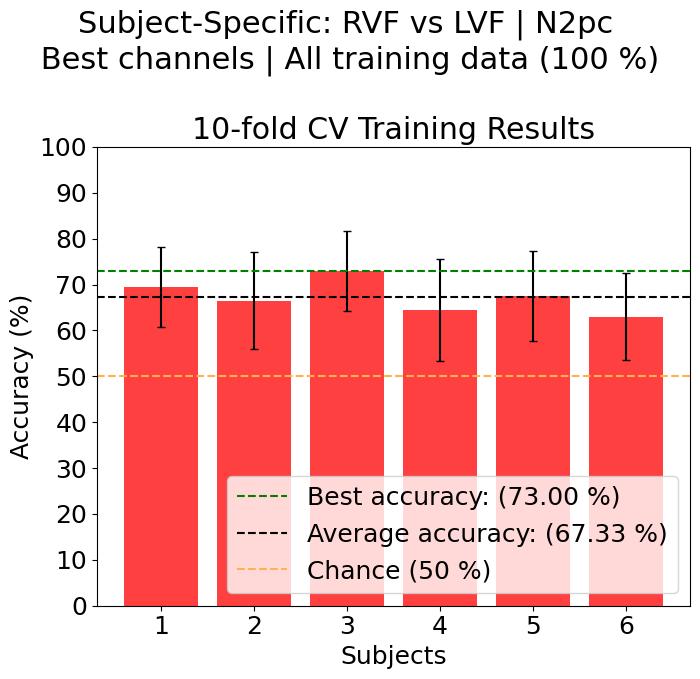

In [147]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 1,
                       figsize=(7.34, 7))

fig.suptitle(f'Subject-Specific: RVF vs LVF | N2pc \n Best channels | All training data (100 %) ', fontsize=22)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 18})
ax.bar(np.arange(1, NUM_SUBJ + 1), 
       bestModel_Subj_cross_val_scores[:, 0], 
       color="red", 
       yerr = bestModel_Subj_cross_val_scores[:, 1], 
       capsize=3,
       alpha = 0.75)

ax.set_title('Accuracy (%)')

ax.axhline(y = max(bestModel_Subj_cross_val_scores[:, 0]), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(bestModel_Subj_cross_val_scores[:, 0]):.2f} %)')

ax.axhline(y = np.mean(bestModel_Subj_cross_val_scores[:, 0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(bestModel_Subj_cross_val_scores[:, 0]):.2f} %)')

ax.axhline(y=50, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (50 %)')

ax.set(xticks = np.arange(1, NUM_SUBJ + 1), 
         xlabel = 'Subjects', 
         yticks=np.arange(0, 101, step=10), 
         ylabel='Accuracy (%)',
         title=f'{KFOLD}-fold CV Training Results');

ax.legend(loc='lower right');
plt.tight_layout()

#### All features (channel differences)

In [149]:
print("========================== All features (channel differences) ==========================\n")

perSubj_cross_val_scores = np.zeros((NUM_SUBJ, 5, 2))
perSubj_accuracy = np.zeros((NUM_SUBJ, 5)) # 5 Classifiers
perSubj_auc_scores = np.zeros((NUM_SUBJ, 5))
perSubj_fitting_periods = np.zeros((NUM_SUBJ, 5))

for subj in range(NUM_SUBJ):

    print(f"\n------------------ Subject {subj + 1}: Classifying RVF vs LVF ------------------\n")

    for c_count, clf in enumerate(classifiers):

        print(f"\n------------------ Classifier: {clf} ------------------")

        lateral_n2pc_clf = clf

        # --------- Cross Validation Scores ---------
        cross_val_scores, best_lateral_n2pc_clf = GridSearch(classifier_params[c_count], 
                                                   lateral_n2pc_clf, 
                                                   KFOLD, 
                                                   all_norm_train_featVect[subj][:,0:-1],
                                                   all_norm_train_featVect[subj][:,-1])
        
        perSubj_cross_val_scores[subj, c_count, 0] = cross_val_scores[0]
        perSubj_cross_val_scores[subj, c_count, 1] = cross_val_scores[1]
        perSubj_fitting_periods[subj, c_count] = cross_val_scores[2]

        # --------- Predictions ---------
        pred = best_lateral_n2pc_clf.predict(all_norm_test_featVect[subj][:, 0:-1])
        perSubj_accuracy[subj, c_count] = round(accuracy_score(all_norm_test_featVect[subj][:, -1], pred), 2) * 100

        print("\nAccuracy: ", round(accuracy_score(all_norm_test_featVect[subj][:, -1], pred), 2) * 100)
        print(best_lateral_n2pc_clf)

        # Compute AUC for each subject
        perSubj_auc_scores[subj, c_count] = round(roc_auc_score(all_norm_test_featVect[subj][:, -1], best_lateral_n2pc_clf.predict_proba(all_norm_test_featVect[subj][:,0:-1])[:,1]), 2)

        del lateral_n2pc_clf, best_lateral_n2pc_clf # Ensures no mixing of classifiers within the loop



========================== All features (channel differences) ==========================


------------------ Subject 1: Classifying RVF vs LVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.6799999999999999

Running Grid Search for method: poly

Best parameters: {'C': 0.001, 'cache_size': 200, 'degree': 3, 'gamma': 0.1, 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.6799999999999999

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.6799999999999999

Accuracy:  68.0
SVC(C=1, gamma='auto', probability=True, random_state=42, tol=0.1)

------------------ Classifier: LinearDiscriminantAnalysis() ------------------

Running Grid Search for method: sv

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.5, 'n_estimators': 50, 'random_state': 42}
Best score: 0.6533333333333333

Accuracy:  54.0
AdaBoostClassifier(learning_rate=0.5, random_state=42)

------------------ Subject 2: Classifying RVF vs LVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.6666666666666665

Running Grid Search for method: poly

Best parameters: {'C': 0.001, 'cache_size': 200, 'degree': 2, 'gamma': 0.1, 'kernel': 'poly', 'random_state': 42, 'tol': 0.01}
Best score: 0.6466666666666666

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.6799999999999999

Accuracy:  70.0
SVC(C=1, gamma='auto', kernel='sigmoid', probability=True, random_state=42,
    tol=0.1)

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.1, 'n_estimators': 100, 'random_state': 42}
Best score: 0.6333333333333333

Accuracy:  56.00000000000001
AdaBoostClassifier(learning_rate=0.1, n_estimators=100, random_state=42)

------------------ Subject 3: Classifying RVF vs LVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.7533333333333333

Running Grid Search for method: poly

Best parameters: {'C': 1, 'cache_size': 200, 'degree': 3, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.7266666666666666

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.01}
Best score: 0.8133333333333332

Accuracy:  62.0
SVC(C=1, gamma='auto', kernel='sigmoid', probability=True

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 1.0, 'n_estimators': 100, 'random_state': 42}
Best score: 0.78

Accuracy:  60.0
AdaBoostClassifier(n_estimators=100, random_state=42)

------------------ Subject 4: Classifying RVF vs LVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.6133333333333334

Running Grid Search for method: poly

Best parameters: {'C': 1, 'cache_size': 200, 'degree': 3, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.01}
Best score: 0.6133333333333334

Running Grid Search for method: sigmoid

Best parameters: {'C': 0.1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.6599999999999999

Accuracy:  60.0
SVC(C=0.1, gamma='auto', kernel='sigmoid', probability=True, random_state=42,
    tol=0.1)

---------

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 1.0, 'n_estimators': 50, 'random_state': 42}
Best score: 0.6733333333333333

Accuracy:  66.0
AdaBoostClassifier(random_state=42)

------------------ Subject 5: Classifying RVF vs LVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: rbf

Best parameters: {'C': 10, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.6333333333333333

Running Grid Search for method: poly

Best parameters: {'C': 0.001, 'cache_size': 200, 'degree': 2, 'gamma': 1, 'kernel': 'poly', 'random_state': 42, 'tol': 0.01}
Best score: 0.6266666666666667

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.66

Accuracy:  70.0
SVC(C=1, gamma='auto', kernel='sigmoid', probability=True, random_state=42,
    tol=0.1)

------------------ Classifier: L

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.1, 'n_estimators': 50, 'random_state': 42}
Best score: 0.64

Accuracy:  54.0
AdaBoostClassifier(learning_rate=0.1, random_state=42)

------------------ Subject 6: Classifying RVF vs LVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: rbf

Best parameters: {'C': 10, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.001}
Best score: 0.6733333333333333

Running Grid Search for method: poly

Best parameters: {'C': 1, 'cache_size': 200, 'degree': 2, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.6333333333333333

Running Grid Search for method: sigmoid

Best parameters: {'C': 0.1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.01}
Best score: 0.66

Accuracy:  66.0
SVC(C=10, gamma='auto', probability=True, random_state=42)

------------------ Classifier: LinearDiscriminantAna

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.1, 'n_estimators': 200, 'random_state': 42}
Best score: 0.6866666666666666

Accuracy:  46.0
AdaBoostClassifier(learning_rate=0.1, n_estimators=200, random_state=42)


#### Cross-Validation Training Classification differences between different classifiers (N2pc - All features)

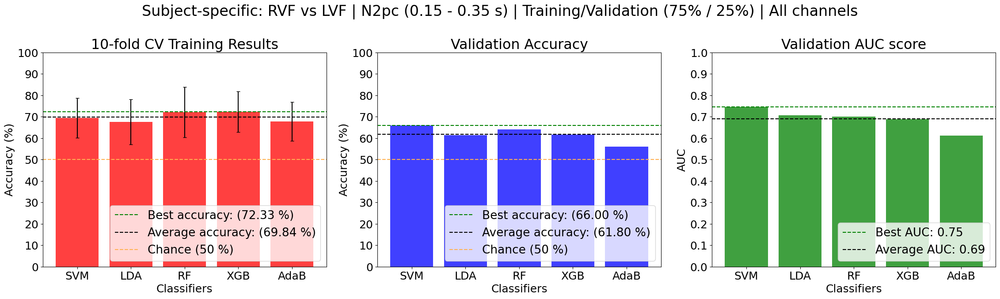

In [150]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 3,
                       figsize=(23, 7))

fig.suptitle(f'Subject-specific: RVF vs LVF | N2pc ({ts} - {te} s) | Training/Validation (75% / 25%) | All channels', fontsize=24)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 19})
ax[0].bar(np.arange(1, 6), 
       np.mean(perSubj_cross_val_scores[:,:,0], axis = 0 ), 
       color="red", 
       yerr = np.mean(perSubj_cross_val_scores[:,:,1], axis = 0), 
       capsize=3,
       alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(np.mean(perSubj_cross_val_scores[:,:,0], axis = 0)), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(np.mean(perSubj_cross_val_scores[:,:,0], axis = 0)):.2f} %)')

ax[0].axhline(y = np.mean(perSubj_cross_val_scores[:,:,0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(perSubj_cross_val_scores[:,:,0]):.2f} %)')

ax[0].axhline(y=50, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (50 %)')

ax[0].set(xticks = np.arange(1, 5 + 1), 
       xticklabels = class_list,
       xlabel = 'Classifiers', 
       yticks=np.arange(0, 101, step=10), ylabel='Accuracy (%)',
       title=f'{KFOLD}-fold CV Training Results');

ax[0].legend(loc='lower right');


# -------------- Prediction Accuracy --------------

ax[1].bar(np.arange(1, 6), 
          np.mean(perSubj_accuracy, axis = 0 ), 
          color="b",
          alpha = 0.75)

ax[1].set_title('Accuracy (%)')

ax[1].axhline(y = max(np.mean(perSubj_accuracy, axis = 0)), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(np.mean(perSubj_accuracy, axis = 0)):.2f} %)')

ax[1].axhline(y = np.mean(perSubj_accuracy), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy):.2f} %)')

ax[1].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50 %)')

ax[1].set(xticks = np.arange(1, 5 + 1), 
          xticklabels = class_list,
          xlabel = 'Classifiers', 
          yticks=np.arange(0, 101, step=10), ylabel='Accuracy (%)',
          title="Validation Accuracy");

ax[1].legend(loc='lower right');


# -------------- Aread Under the Curve (AUC) --------------

ax[2].bar(np.arange(1, 6), 
          np.mean(perSubj_auc_scores, axis = 0 ), 
          color="g",
          alpha = 0.75)

ax[2].set_title('AUC ')

ax[2].axhline(y = max(np.mean(perSubj_auc_scores, axis = 0)), 
              color='green', linestyle='--', 
              label = f'Best AUC: {max(np.mean(perSubj_auc_scores, axis = 0)):.2f}')

ax[2].axhline(y = np.mean(perSubj_auc_scores), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: {np.mean(perSubj_auc_scores):.2f}')

ax[2].set(xticks = np.arange(1, 5 + 1), 
          xticklabels = class_list,
          xlabel = 'Classifiers', 
          yticks=np.arange(0, 1.01, step=0.1), ylabel='AUC',
          title="Validation AUC score");

ax[2].legend(loc='lower right');
plt.tight_layout()

#### Best classifier Cross-Validation Training accuracies for all subjects

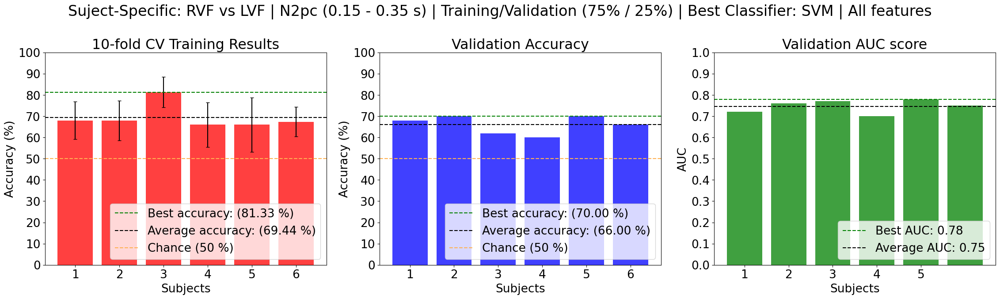

In [153]:
best_classifier = 0

fig, ax = plt.subplots(nrows = 1,
                       ncols = 3,
                       figsize=(23, 7))

fig.suptitle(f'Suject-Specific: RVF vs LVF | N2pc ({ts} - {te} s) | Training/Validation (75% / 25%) | Best Classifier: {class_list[best_classifier]} | All features', fontsize=24)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 19})
ax[0].bar(np.arange(1, NUM_SUBJ + 1), 
       perSubj_cross_val_scores[:,best_classifier, 0], 
       color="red", 
       yerr = perSubj_cross_val_scores[:,best_classifier, 1], 
       capsize=3,
       alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(perSubj_cross_val_scores[:,best_classifier, 0]), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(perSubj_cross_val_scores[:,best_classifier, 0]):.2f} %)')

ax[0].axhline(y = np.mean(perSubj_cross_val_scores[:,best_classifier, 0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(perSubj_cross_val_scores[:,best_classifier, 0]):.2f} %)')

ax[0].axhline(y=50, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (50 %)')

ax[0].set(xticks = np.arange(1, NUM_SUBJ + 1), 
         xlabel = 'Subjects', 
         yticks=np.arange(0, 101, step=10), 
         ylabel='Accuracy (%)',
         title=f'{KFOLD}-fold CV Training Results');

ax[0].legend(loc='lower right');


# -------------- Prediction Accuracy --------------

ax[1].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_accuracy[:,best_classifier], 
          color="b",
          alpha = 0.75)

ax[1].set_title('Accuracy (%)')

ax[1].axhline(y = max(perSubj_accuracy[:,best_classifier]), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(perSubj_accuracy[:,best_classifier]):.2f} %)')

ax[1].axhline(y = np.mean(perSubj_accuracy[:,best_classifier]), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy[:,best_classifier]):.2f} %)')

ax[1].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50 %)')

ax[1].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 101, step=10), 
          ylabel='Accuracy (%)',
          title="Validation Accuracy");

ax[1].legend(loc='lower right');


# -------------- Aread Under the Curve (AUC) --------------

ax[2].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_auc_scores[:, best_classifier], 
          color="g",
          alpha = 0.75)

ax[2].set_title('AUC ')

ax[2].axhline(y = max(perSubj_auc_scores[:, best_classifier]), 
              color='green', linestyle='--', 
              label = f'Best AUC: {max(perSubj_auc_scores[:, best_classifier]):.2f}')

ax[2].axhline(y = np.mean(perSubj_auc_scores[:, best_classifier]), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: {np.mean(perSubj_auc_scores[:, best_classifier]):.2f}')

ax[2].set(xticks = np.arange(1, 5 + 1), 
          xlabel = 'Subjects', 
          yticks=np.arange(0, 1.01, step=0.1), ylabel='AUC',
          title="Validation AUC score");

ax[2].legend(loc='lower right');
plt.tight_layout()

### Training and saving best Model (N2pc - All features)

In [154]:
N2pc_models_Folder = "C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_RVF_vs_LVF_N2pc_AllElectrodes/"

# Create the folder (raises an error if it already exists)
try:
  os.mkdir(N2pc_models_Folder)
  print(f"Folder created successfully at: {N2pc_models_Folder}")
except FileExistsError:
  print(f"Folder already exists at: {N2pc_models_Folder}")

Folder already exists at: C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_N2pc_RVF_vs_LVF_AllFeat/


In [201]:
perSubj_optim_params = [{'shrinkage': 'auto', 'solver': 'eigen', 'tol': 0.1},
                        {'shrinkage': 'auto', 'solver': 'eigen', 'tol': 0.1},
                        {'colsample_bytree': 0.8, 'eval_metric': 'logloss', 'learning_rate': 0.1, 'max_depth': 6, 'n_estimators': 100, 'objective': 'binary:logistic', 'random_state': 42, 'subsample': 0.8},
                        {'criterion': 'entropy', 'max_depth': None, 'max_features': 'log2', 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 200, 'random_state': 42},
                        {'shrinkage': 'auto', 'solver': 'eigen', 'tol': 0.1},
                        {'C': 0.1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.01}]

models = [LDA(), LDA(), xgb.XGBClassifier(), RandomForestClassifier(), LDA(), SVC(probability=True)]

In [202]:
import joblib

bestModel_Subj_cross_val_scores = np.zeros((NUM_SUBJ, 2))

for subj in range(NUM_SUBJ):

    train = np.vstack((all_norm_train_featVect[subj], all_norm_test_featVect[subj])) # All data stacked

    np.random.seed(42)
    np.random.shuffle(train)

    # -------------------------- LDA --------------------------

    best_N2pc_clf = models[subj]
    best_N2pc_clf.set_params(**perSubj_optim_params[subj])

    # --------- Cross Validation Scores ---------
    scores = cross_val_score(best_N2pc_clf, 
                             train[:, 0:-1], 
                             train[:, -1], 
                             cv = KFOLD)
    
    bestModel_Subj_cross_val_scores[subj, 0] = (scores.mean() * 100)
    bestModel_Subj_cross_val_scores[subj, 1] = (scores.std() * 100)

    # --------- Train Model ---------
    best_N2pc_clf.fit(train[:, 0:-1], 
                      train[:, -1])
    
    joblib.dump(best_N2pc_clf, f'{N2pc_models_Folder}Subj_0{subj + 1}_N2pc_model.pkl')
    
    del best_N2pc_clf

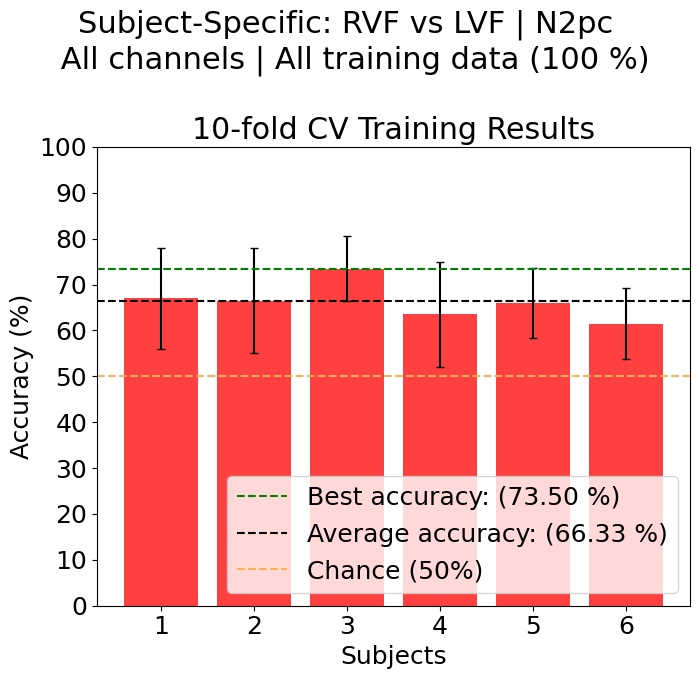

In [203]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 1,
                       figsize=(7.34, 7))

fig.suptitle(f'Subject-Specific: RVF vs LVF | N2pc \n All channels | All training data (100 %)', fontsize=22)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 18})
ax.bar(np.arange(1, NUM_SUBJ + 1), 
       bestModel_Subj_cross_val_scores[:, 0], 
       color="red", 
       yerr = bestModel_Subj_cross_val_scores[:, 1], 
       capsize=3,
       alpha = 0.75)

ax.set_title('Accuracy (%)')

ax.axhline(y = max(bestModel_Subj_cross_val_scores[:, 0]), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(bestModel_Subj_cross_val_scores[:, 0]):.2f} %)')

ax.axhline(y = np.mean(bestModel_Subj_cross_val_scores[:, 0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(bestModel_Subj_cross_val_scores[:, 0]):.2f} %)')

ax.axhline(y=50, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (50%)')

ax.set(xticks = np.arange(1, NUM_SUBJ + 1), 
         xlabel = 'Subjects', 
         yticks=np.arange(0, 101, step=10), 
         ylabel='Accuracy (%)',
         title=f'{KFOLD}-fold CV Training Results');

ax.legend(loc='lower right');

plt.tight_layout()

# **Deep Learning - Estimating the target object along the x axis in the images (N2pc)**

In [209]:
import torch
from torch import nn

# Make device agnostic code
device = "cuda" if torch.cuda.is_available() else "cpu"
device

'cpu'

## NN model

In [210]:
torch.manual_seed(42)

class N2pcModel(nn.Module):
    def __init__(self, input_features, output_features, hidden_units=8):
        """Initializes all required hyperparameters for a multi-class classification model.

        Args:
            input_features (int): Number of input features to the model.
            out_features (int): Number of output features of the model
              (how many classes there are).
            hidden_units (int): Number of hidden units between layers, default 8.
        """
        super().__init__()
        self.linear_layer_stack = nn.Sequential(
            nn.Linear(in_features=input_features, out_features=hidden_units),
            nn.Sigmoid(), 
            nn.Linear(in_features=hidden_units, out_features=hidden_units),
            nn.Sigmoid(),
            nn.Linear(in_features=hidden_units, out_features=output_features),
        )
    
    def forward(self, x):
        return self.linear_layer_stack(x)

## Training model (All features)

In [207]:
from scipy.stats import pearsonr

In [219]:
all_training_losses = []
all_testing_losses = []

all_real_x = []
all_x_preds = []

correlation = []
p_value = []

for subj in range(NUM_SUBJ):

  print(f"\n------------------ Subject {subj + 1}: Training model ------------------")

  # Number of features

  train_featVect = np.vstack((all_NN_featVectRVF[subj][:n_train], all_NN_featVectLVF[subj][:n_train]))
  test_featVect = np.vstack((all_NN_featVectRVF[subj][n_train:], all_NN_featVectLVF[subj][n_train:]))

  NUM_FEATURES = np.size(train_featVect[:,0:-1],1) 

  # Fit the model
  torch.manual_seed(42)

  # Set number of epochs
  dl_epochs = 30000
      
  # Initializing model

  x_pos_model1 = N2pcModel(input_features=NUM_FEATURES, 
                           output_features=1, 
                           hidden_units=32).to(device)

  loss_fn = nn.L1Loss()
  optimizer = torch.optim.SGD(x_pos_model1.parameters(), 
                                 lr=0.005,
                                 momentum=0.095)

  # Shuffle

  np.random.seed(42)
  np.random.shuffle(train_featVect)
  np.random.seed(42)
  np.random.shuffle(test_featVect)

  # Tensor convertion
  tn_train_feat = torch.tensor(np.array(train_featVect[:,0:-1])).type(torch.float32)
  tn_train_lbl = torch.tensor(np.array(train_featVect[:,-1])).type(torch.float32)

  tn_test_feat = torch.tensor(np.array(test_featVect[:,0:-1])).type(torch.float32)
  tn_test_lbl = torch.tensor(np.array(test_featVect[:,-1])).type(torch.float32)

  # Feature wise normalization of feature vector
  n_entries, n_feat = tn_train_feat.size()

  for j in range(n_entries):

      mean = tn_train_feat[j,:].mean(dim=0)
      std = tn_train_feat[j,:].std(dim=0)
      tn_train_feat[j,:] = (tn_train_feat[j,:] - mean) / std

  n_entries, n_feat = tn_test_feat.size()

  for u in range(n_entries):

      mean = tn_test_feat[u,:].mean(dim=0)
      std = tn_test_feat[u,:].std(dim=0)
      tn_test_feat[u,:] = (tn_test_feat[u,:] - mean) / std

  training_losses = []
  testing_losses = []

  for dl_epoch in range(dl_epochs):
      ### Training
      x_pos_model1.train()

      # 1. Forward pass
      x_pos_ = x_pos_model1(tn_train_feat)

      # 2. Calculate loss
      train_loss = loss_fn(torch.squeeze(x_pos_), tn_train_lbl) 
      training_losses.append(train_loss.detach().numpy())
    
      # 3. Optimizer zero grad
      optimizer.zero_grad()

      # 4. Loss backwards
      train_loss.backward()

      # 5. Optimizer step
      optimizer.step()

      ### Testing
      x_pos_model1.eval()
      with torch.inference_mode():
        # 1. Forward pass
        output = x_pos_model1(tn_test_feat)
        # 2. Calculate test loss and accuracy
        test_loss = loss_fn(torch.squeeze(output), tn_test_lbl)
        testing_losses.append(test_loss.detach().numpy())

      # Print out what's happening
      if (dl_epoch + 1) % 2000 == 0:
          print(f"Epoch: {dl_epoch + 1} | Training Loss: {train_loss:.5f}, | Testing Loss: {test_loss:.5f}")  

  # ------------------------------------ Test ------------------------------------

  # 1. Set the model in evaluation mode

  x_pos_model1.eval()

  # 2. Setup the inference mode context manager
  with torch.inference_mode():
    x_preds = x_pos_model1(tn_test_feat)
    
  x_preds = x_preds.numpy()
  real_x = tn_test_lbl.numpy()

  all_training_losses.append(training_losses)
  all_testing_losses.append(testing_losses)

  all_x_preds.append(x_preds)
  all_real_x.append(real_x)

  # Calculate Pearson's correlation
  corr, p_v = pearsonr(np.squeeze(x_preds), real_x)

  correlation.append(corr)
  p_value.append(p_v)

  print(f"Pearson's correlation coefficient: {correlation[subj]}")
  print(f"P-value: {p_value[subj]}")

  del x_pos_model1


------------------ Subject 1: Training model ------------------
Epoch: 2000 | Training Loss: 187.97374, | Testing Loss: 190.14343
Epoch: 4000 | Training Loss: 106.02217, | Testing Loss: 143.61897
Epoch: 6000 | Training Loss: 48.76366, | Testing Loss: 105.23766
Epoch: 8000 | Training Loss: 33.83906, | Testing Loss: 98.93250
Epoch: 10000 | Training Loss: 15.54680, | Testing Loss: 94.54546
Epoch: 12000 | Training Loss: 8.14949, | Testing Loss: 97.79035
Epoch: 14000 | Training Loss: 5.22189, | Testing Loss: 95.38491
Epoch: 16000 | Training Loss: 3.73117, | Testing Loss: 94.15223
Epoch: 18000 | Training Loss: 2.73858, | Testing Loss: 93.34414
Epoch: 20000 | Training Loss: 2.10615, | Testing Loss: 92.54018
Epoch: 22000 | Training Loss: 2.22634, | Testing Loss: 89.43353
Epoch: 24000 | Training Loss: 1.71242, | Testing Loss: 89.30529
Epoch: 26000 | Training Loss: 1.54965, | Testing Loss: 89.43538
Epoch: 28000 | Training Loss: 1.08492, | Testing Loss: 89.01060
Epoch: 30000 | Training Loss: 1.0

In [217]:
obj_region = 121.84
import math

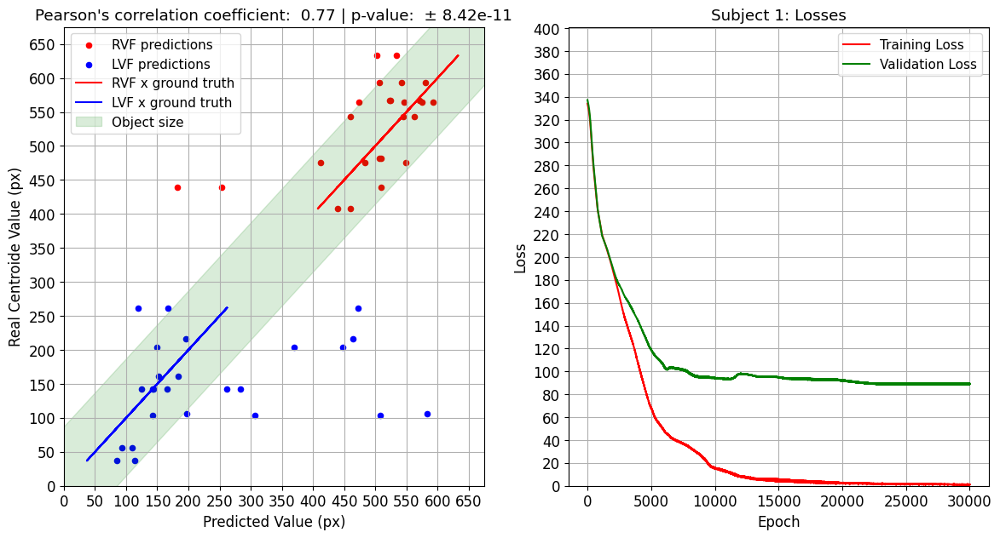

<Figure size 640x480 with 0 Axes>

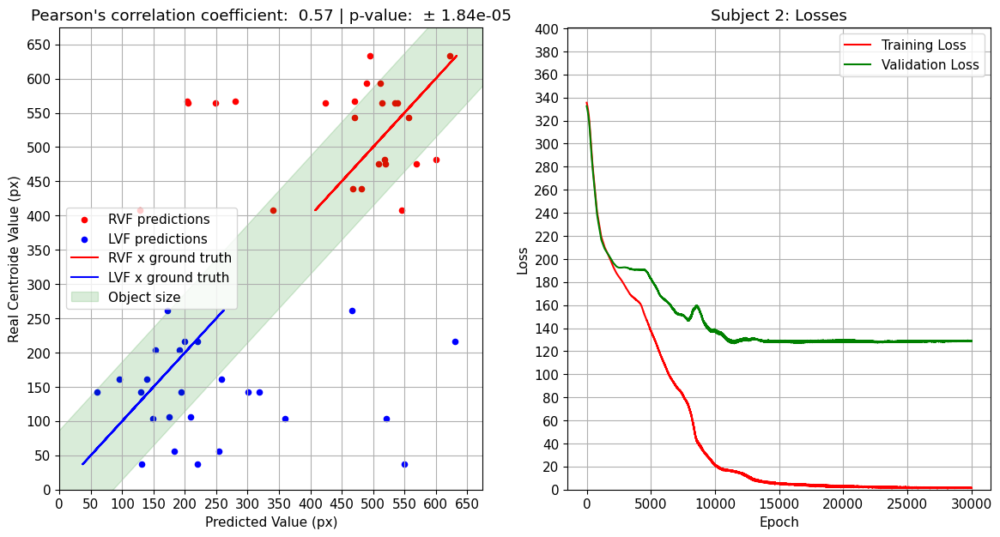

<Figure size 640x480 with 0 Axes>

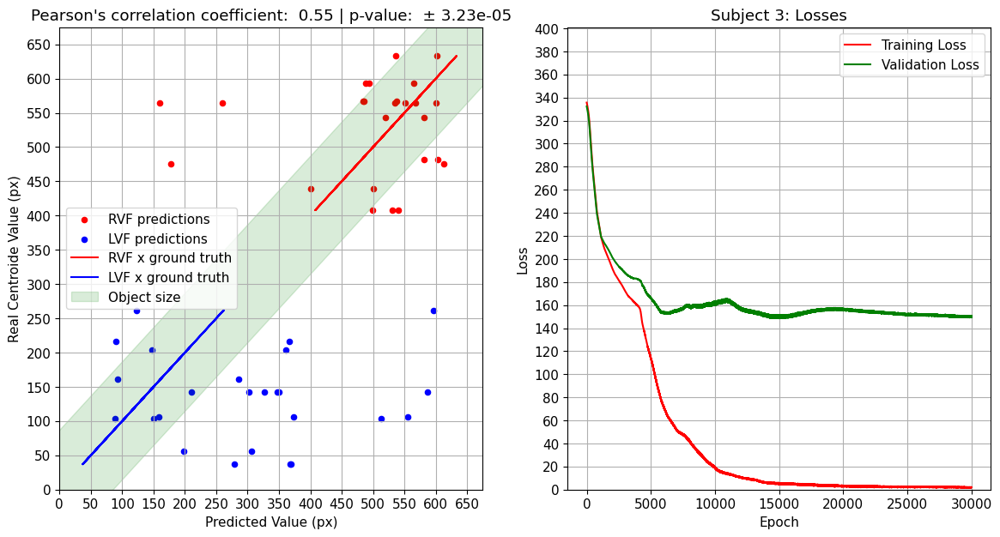

<Figure size 640x480 with 0 Axes>

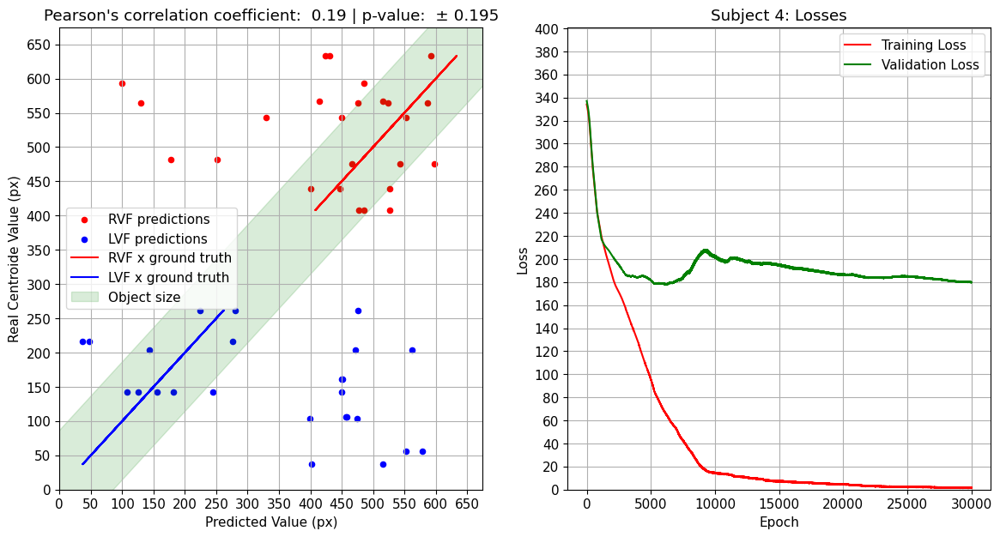

<Figure size 640x480 with 0 Axes>

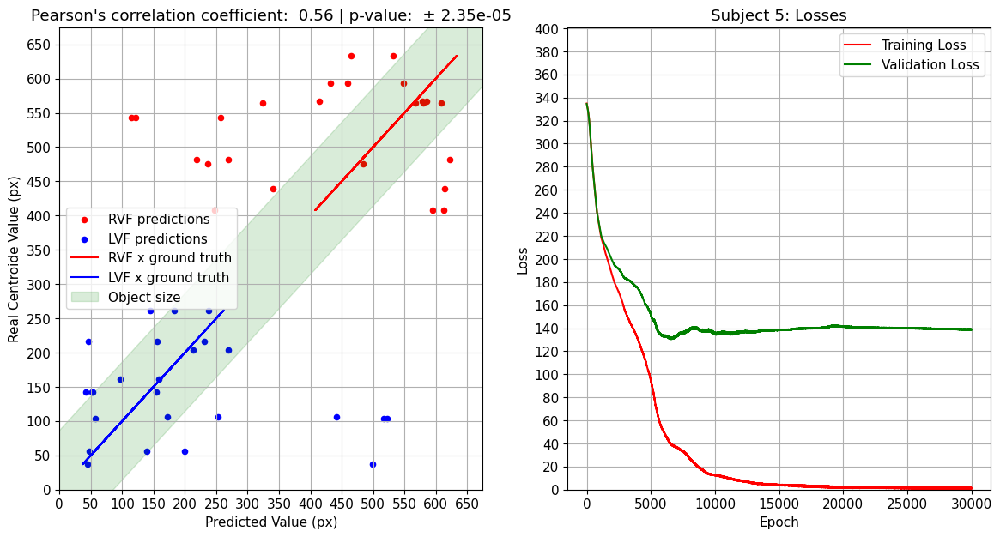

<Figure size 640x480 with 0 Axes>

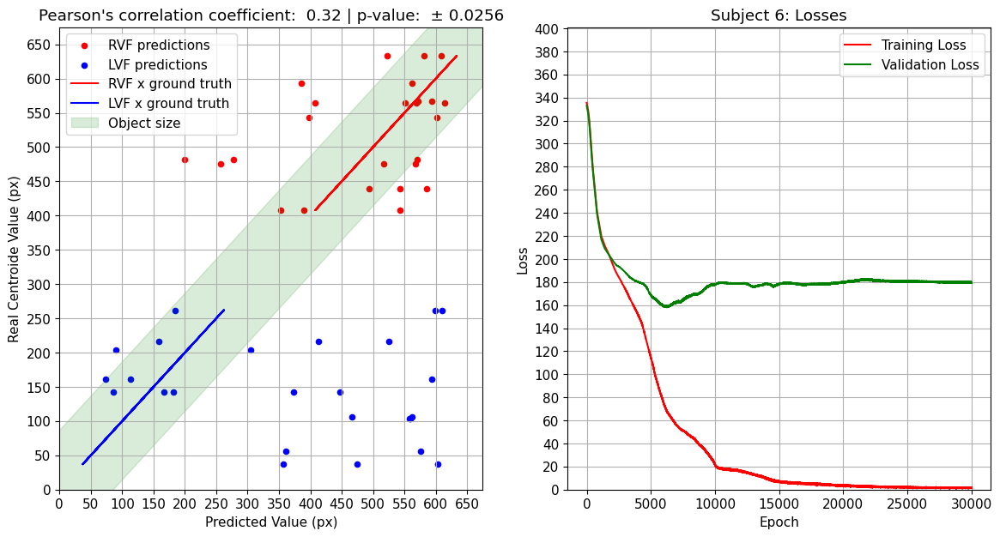

<Figure size 640x480 with 0 Axes>

In [228]:
all_distance = []



for subj in range(NUM_SUBJ):

    fig, axs = plt.subplots(nrows=1, ncols=2, figsize = (14,7))
    plt.rcParams.update({'font.size': 11})

    x_losses = np.linspace(0, dl_epochs, dl_epochs)

    ax = axs[0]

    x_preds = all_x_preds[subj].reshape(len(all_x_preds[subj]))

    '''
    Absolute error: |True value - Measured Value|
    Relative error: |Absolute error / True value|
    Percent  error: Relative error * 100
    '''


    RVF_real_x = [x for x in range(len(all_real_x[subj])) if all_real_x[subj][x] > IM_WIDTH/2]
    LVF_real_x = [x for x in range(len(all_real_x[subj])) if all_real_x[subj][x] < IM_WIDTH/2]

    # Scatter plots on the same axes
    ax.scatter(all_x_preds[subj][RVF_real_x], all_real_x[subj][RVF_real_x], color='r', label='RVF predictions',alpha=1, s=20);
    ax.scatter(all_x_preds[subj][LVF_real_x], all_real_x[subj][LVF_real_x], color='b', label='LVF predictions',alpha=1, s=20);

    plus_minus_symbol = chr(0x00B1)
    ax.set(xlabel='Predicted Value (px)', 
        xticks=np.arange(0, IM_WIDTH + 3, step = 50),
        xlim=(0, IM_WIDTH + 3),
        ylabel='Real Centroide Value (px)',
        yticks=np.arange(0, IM_WIDTH + 3, step = 50),
        ylim=(0, IM_WIDTH + 3),
        title=(f"Pearson's correlation coefficient: {correlation[subj]: .2f} | p-value:  {plus_minus_symbol}{p_value[subj]: .3}"));
    ax.grid(True)

    ax.plot(all_real_x[subj][RVF_real_x], all_real_x[subj][RVF_real_x], 'r', alpha=1, label = 'RVF x ground truth') # Line plot
    ax.plot(all_real_x[subj][LVF_real_x], all_real_x[subj][LVF_real_x], 'b', alpha=1, label = 'LVF x ground truth') 


    diag_rect = patches.Rectangle(
        (min(all_real_x[subj]) - 50, (min(all_real_x[subj]))-(obj_region/2)/math.cos(math.radians(45)) - 50), 
                                    max(all_real_x[subj]) + 400, obj_region, 
                                    linewidth=1, edgecolor='g', facecolor='g', alpha=0.15, angle=45, label = 'Object size')
    ax.add_patch(diag_rect) # Patch plot

    ax.legend()

    ax = axs[1]

    ax.plot(x_losses, all_training_losses[subj], 'r', label = 'Training Loss')
    ax.plot(x_losses, all_testing_losses[subj], 'g', label = 'Validation Loss')
    ax.set(xlabel='Epoch',
            ylabel='Loss',
            yticks=np.arange(0, 401, step = 20),
            ylim=(0,401),
            title=(f"Subject {subj + 1}: Losses"));
    ax.legend(loc='upper right')
    ax.grid(True)
        
    plt.show()
    plt.tight_layout()

In [99]:
print(f"Mean distance: {np.mean(all_distance): .02f} +/- {np.std(all_distance) : .02f}")

Mean distance:  219.87 +/-  159.57


In [ ]:
'''
from torchviz import make_dot

# Create a dummy input
dummy_input = torch.randn(1,70)  # Replace with appropriate input size

# Generate the computational graph
y = x_pos_model1(dummy_input)
g = make_dot(y, params=dict(list(x_pos_model1.named_parameters())))

# Render the graph to an image file
g.render("model_architecture", format="png")
'''

## Training and saving the best N2pc model (All features)

In [100]:
N2pc_NN_models_Folder = "C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/NN_x_pos_N2pc/"

# Create the folder (raises an error if it already exists)
try:
  os.mkdir(N2pc_NN_models_Folder)
  print(f"Folder created successfully at: {N2pc_NN_models_Folder}")
except FileExistsError:
  print(f"Folder already exists at: {N2pc_NN_models_Folder}")

Folder created successfully at: C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/N2pc_NN_x_pos/


In [101]:
all_training_losses = []

for subj in range(NUM_SUBJ):

  print(f"\n------------------ Subject {subj + 1}: Training model ------------------")

  # Number of features

  train_featVect = np.vstack((all_NN_featVectRVF[subj], all_NN_featVectLVF[subj]))

  NUM_FEATURES = np.size(train_featVect[:,0:-1], 1) 

  # Fit the model
  torch.manual_seed(42)

  # Set number of epochs
  dl_epochs = 30000
      
  # Initializing model

  x_pos_model = N2pcModel(input_features=NUM_FEATURES, 
                           output_features=1, 
                           hidden_units=32).to(device)

  loss_fn = nn.L1Loss()
  optimizer = torch.optim.SGD(x_pos_model.parameters(), 
                                 lr=0.005,
                                 momentum=0.09)

  # Shuffle

  np.random.seed(42)
  np.random.shuffle(train_featVect)

  # Tensor convertion
  tn_train_feat = torch.tensor(np.array(train_featVect[:,0:-1])).type(torch.float32)
  tn_train_lbl = torch.tensor(np.array(train_featVect[:,-1])).type(torch.float32)

  # Feature wise normalization of feature vector
  n_entries, n_feat = tn_train_feat.size()

  for j in range(n_entries):

      mean = tn_train_feat[j,:].mean(dim=0)
      std = tn_train_feat[j,:].std(dim=0)
      tn_train_feat[j,:] = (tn_train_feat[j,:] - mean) / std

  training_losses = []

  for dl_epoch in range(dl_epochs):
      ### Training
      x_pos_model.train()

      # 1. Forward pass
      x_pos_ = x_pos_model(tn_train_feat)

      # 2. Calculate loss
      train_loss = loss_fn(torch.squeeze(x_pos_), tn_train_lbl) 
      training_losses.append(train_loss.detach().numpy())
    
      # 3. Optimizer zero grad
      optimizer.zero_grad()

      # 4. Loss backwards
      train_loss.backward()

      # 5. Optimizer step
      optimizer.step()

      # Print out what's happening
      if (dl_epoch + 1) % 2000 == 0:
          print(f"Epoch: {dl_epoch + 1} | Training Loss: {train_loss:.5f}")  

  all_training_losses.append(training_losses)

  # Save the entire model (state_dict and optimizer are optional)
  torch.save(x_pos_model,
             N2pc_NN_models_Folder+f"x_pos_model_Subj{subj + 1}.pt") 
  
  del x_pos_model


------------------ Subject 1: Training model ------------------
Epoch: 2000 | Training Loss: 184.45674
Epoch: 4000 | Training Loss: 116.65018
Epoch: 6000 | Training Loss: 50.52770
Epoch: 8000 | Training Loss: 29.08696
Epoch: 10000 | Training Loss: 22.65075
Epoch: 12000 | Training Loss: 15.49583
Epoch: 14000 | Training Loss: 7.22190
Epoch: 16000 | Training Loss: 5.00260
Epoch: 18000 | Training Loss: 4.63776
Epoch: 20000 | Training Loss: 3.80068
Epoch: 22000 | Training Loss: 3.08498
Epoch: 24000 | Training Loss: 2.58918
Epoch: 26000 | Training Loss: 2.24800
Epoch: 28000 | Training Loss: 2.01060
Epoch: 30000 | Training Loss: 1.75003

------------------ Subject 2: Training model ------------------
Epoch: 2000 | Training Loss: 196.26776
Epoch: 4000 | Training Loss: 166.65689
Epoch: 6000 | Training Loss: 117.55712
Epoch: 8000 | Training Loss: 56.65953
Epoch: 10000 | Training Loss: 26.80455
Epoch: 12000 | Training Loss: 14.41571
Epoch: 14000 | Training Loss: 7.04035
Epoch: 16000 | Training L

# **Averaging Midline Bilateral - Lateralized Ipsilateral component: N2pcb (200 - 400 ms)**

The mean amplitude of the N2pcb elicited by midline targets was computed as
the subtraction of the ipsilateral activity elicited by lateralized targets from the averaged bilateral activity elicited by
a midline target.

## Grand-Average

In [55]:
all_TVF = []
all_BVF = []

all_TVF_y_pos = []
all_BVF_y_pos = []

all_TVF_target = []
all_BVF_target = []

for subj in range(NUM_SUBJ):

    TVF = []
    BVF = []

    TVF_y_pos = []
    BVF_y_pos = []

    TVF_target = []
    BVF_target = []

    for trial in all_labelled_targets[subj]:
        if trial[VERTICAL_CONDITION_COL] == "TVF":
            TVF.append( (trial[DATA_COL][right_N2pc_ch_idx,:] + trial[DATA_COL][left_N2pc_ch_idx,:])/2 - all_aver_ipsi[subj])
            TVF_target.append(trial[DATA_COL])
            TVF_y_pos.append(trial[Y_CENTROID_COL])
        elif trial[VERTICAL_CONDITION_COL] == "BVF":
            BVF.append( (trial[DATA_COL][right_N2pc_ch_idx,:] + trial[DATA_COL][left_N2pc_ch_idx,:])/2 - all_aver_ipsi[subj])
            BVF_target.append(trial[DATA_COL])
            BVF_y_pos.append(trial[Y_CENTROID_COL])

    all_TVF.append(TVF)
    all_BVF.append(BVF)

    all_TVF_y_pos.append(TVF_y_pos)
    all_BVF_y_pos.append(BVF_y_pos)

    all_TVF_target.append(TVF_target)
    all_BVF_target.append(BVF_target)

aver_TVF = np.mean(all_TVF, axis = 0)
aver_BVF = np.mean(all_BVF, axis = 0)

grandAver_TVF = np.mean(aver_TVF, axis = 0)
grandAver_BVF = np.mean(aver_BVF, axis = 0)

std_TVF = np.std(aver_TVF, axis = 0)
std_BVF = np.std(aver_BVF, axis = 0)

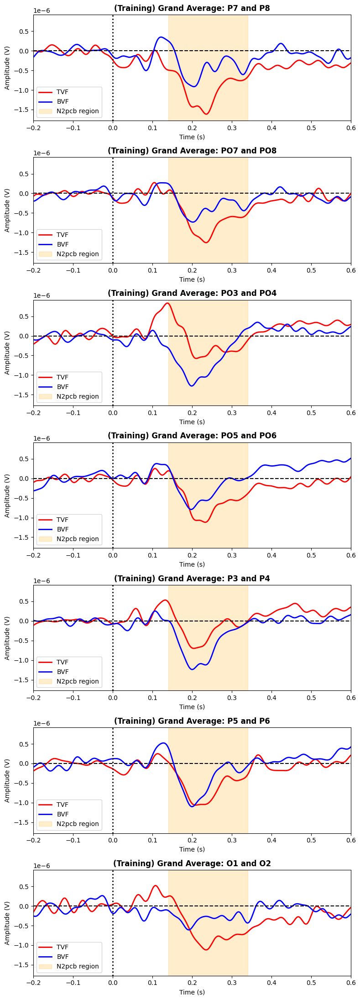

In [56]:
up_vlim = np.max(grandAver_TVF) * 1.1
do_vlim = np.min(grandAver_TVF) * 1.1

fig, ax1 = plt.subplots(nrows = len(left_N2pc_ch_idx), 
                                ncols = 1,
                                figsize=(8, 22))

plt.rcdefaults()

for i in range(len(left_N2pc_ch_idx)):

    ax1[i].plot(ERP_times, 
             grandAver_TVF[i],
             'r', 
             label = 'TVF', 
             linewidth = 2)
    
    ax1[i].plot(ERP_times, 
             grandAver_BVF[i],
             'b', 
             label = "BVF",
             linewidth = 2)

    ax1[i].set_xlim([np.min(ERP_times),np.max(ERP_times)])
    ax1[i].set_ylim([do_vlim,up_vlim])

    N2pcb_region = patches.Rectangle((0.14, -0.1), 0.2, 0.2, linewidth=1, edgecolor='orange', facecolor='orange', alpha=0.2, label = "N2pcb region")
    # - `(200, -1)` is the bottom-left corner of the rectangle (x, y coordinates). Note the y values in the graph are in microVolts
    # - `200` is the width of the rectangle.
    # - `2` is the height of the rectangle.

    ax1[i].add_patch(N2pcb_region)

    ax1[i].set_title(f"(Training) Grand Average: {clean_ch[left_N2pc_ch_idx[i]]} and {clean_ch[right_N2pc_ch_idx[i]]}", fontweight = 'bold')
    ax1[i].set_xlabel('Time (s)')
    ax1[i].set_ylabel('Amplitude (V)')
    ax1[i].legend(loc = 'lower left')

    ax1[i].axvline(x=0, color = 'k', label = 'Stimuli onset', linestyle='dotted', linewidth = 2)
    ax1[i].axhline(y=0, color = 'k', linestyle = 'dashed')

plt.tight_layout()
plt.show()

## TVF vs BVF Topomaps

Max vlim:  2.3133048210296398e-06
Min vlim:  -2.10500911257502e-06


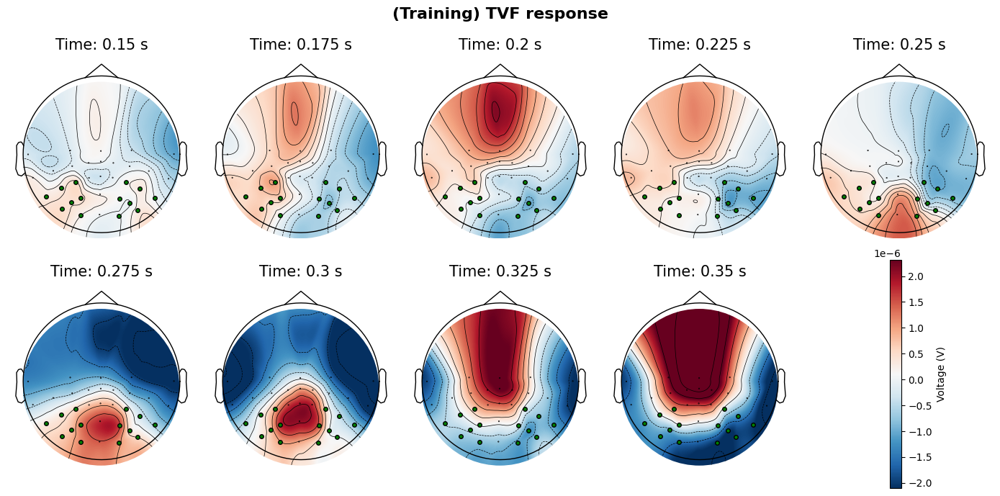

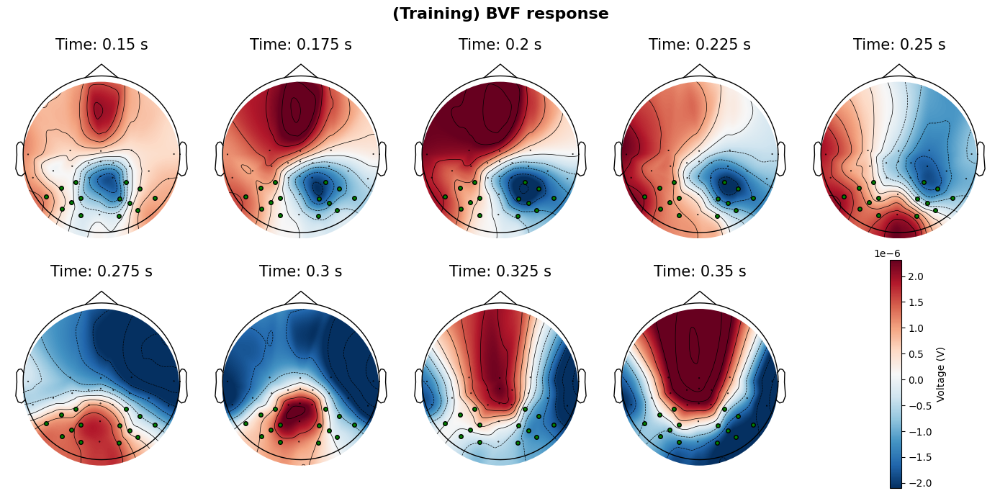

In [58]:
TVF_ERP = np.mean(np.mean(all_TVF_target, axis = 0), axis = 0)
BVF_ERP = np.mean(np.mean(all_LVF_target, axis = 0), axis = 0)

t_win = 0.01

t_intervals = [0.15,
               0.175, 
               0.2, 
               0.225, 
               0.25, 
               0.275, 
               0.3,
               0.325,
               0.35,
               0] # ms


t_sample_start = np.argmin(np.abs(ERP_times - t_intervals[0]))
t_sample_stop = np.argmin(np.abs(ERP_times - t_intervals[-2]))

vmap_max = np.max(BVF_ERP[left_N2pc_ch_idx,t_sample_start:t_sample_stop])
vmap_min = np.min(TVF_ERP[right_N2pc_ch_idx,t_sample_start:t_sample_stop])

print("Max vlim: ", vmap_max)
print("Min vlim: ", vmap_min)

N2pc_ch_idx = np.hstack((left_N2pc_ch_idx, right_N2pc_ch_idx))

highlight_ch = [1 if c in N2pc_ch_idx else 0 for c in range(len(clean_ch))]

fig, axes = plt.subplots(nrows = 2, 
                         ncols = int(len(t_intervals)/2), 
                         figsize=(14, 7))

fig.suptitle("(Training) TVF response", fontweight='bold', fontsize=16)

for n, t_ms in enumerate(t_intervals):

    ax = axes.flat[n]

    if(n < len(t_intervals) - 1):

        ax.set_title(f"Time: {t_ms} s", fontsize=15)

        t_sample_start = np.argmin(np.abs(ERP_times - t_ms + t_win))
        t_sample_stop = np.argmin(np.abs(ERP_times - t_ms - t_win))
        
        dt = np.mean(TVF_ERP[:,t_sample_start:t_sample_stop], axis = 1)

        im, cn = mne.viz.plot_topomap(dt,
                            rereferenced_EEGs[0].info,
                            contours = 10,
                            vlim = (vmap_min, vmap_max),
                            mask = np.array(highlight_ch),
                            mask_params = mk,
                            size = 10,
                            sphere = (0.0011, 0.015, 0.12, 0.2),
                            axes = ax,
                            show = False,
                            res = 1024)
        
    else:
        
        # Hide axis line
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)

        # Hide axis labels (optional)
        ax.set_xlabel('')
        ax.set_ylabel('')

        ax.set_xticks(ax.get_xticks())  # Get current xtick positions
        ax.set_xticklabels([])
        ax.set_yticks(ax.get_yticks())  # Get current xtick positions
        ax.set_yticklabels([])

        ax.tick_params(bottom = False, left = False, which='both')

        cax = fig.colorbar(im, ax = ax, fraction = 0.55)
        cax.set_label("Voltage (V)")

plt.tight_layout()
plt.show()

fig, axes = plt.subplots(nrows = 2, 
                         ncols = int(len(t_intervals)/2), 
                         figsize=(14, 7))

fig.suptitle("(Training) BVF response", fontweight='bold', fontsize=16)

for n, t_ms in enumerate(t_intervals):

    '''
    .flat is a NumPy attribute that flattens the array into a 1D view. This means it transforms a potentially multi-dimensional array into a single list-like structure.
    '''

    ax = axes.flat[n]

    if(n < len(t_intervals) - 1):

        ax.set_title(f"Time: {t_ms} s", fontsize=15)

        t_sample_start = np.argmin(np.abs(ERP_times - t_ms + t_win))
        t_sample_stop = np.argmin(np.abs(ERP_times - t_ms - t_win))
        
        dt = np.mean(BVF_ERP[:,t_sample_start:t_sample_stop], axis = 1)
        
        im, cn = mne.viz.plot_topomap(dt,
                            rereferenced_EEGs[0].info,
                            contours = 10,
                            vlim = (vmap_min, vmap_max),
                            mask = np.array(highlight_ch),
                            mask_params = mk,
                            size = 10,
                            sphere = (0.0011, 0.015, 0.12, 0.2),
                            axes = ax,
                            show = False,
                            res = 1024)
    
    else:
        
        # Hide axis line
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)

        # Hide axis labels (optional)
        ax.set_xlabel('')
        ax.set_ylabel('')

        ax.set_xticks(ax.get_xticks())  # Get current xtick positions
        ax.set_xticklabels([])
        ax.set_yticks(ax.get_yticks())  # Get current xtick positions
        ax.set_yticklabels([])

        ax.tick_params(bottom = False, left = False, which='both')

        cax = fig.colorbar(im, ax = ax, fraction = 0.55)
        cax.set_label("Voltage (V)")

plt.tight_layout()
plt.show()

## Calculate the single-trial N2pcb component

In [76]:
n_trials,  _, _ = np.shape(TVF)

ts = 0.15
te = 0.35

idx_s = np.argmin(np.abs(ERP_times - ts))
idx_e = np.argmin(np.abs(ERP_times - te))

# Resampling the resulting time window (Prevents overfitting)

RESAMPLE_FREQ = 64 # Hz
N_DATAPOINTS_ORIG_FREQ = len(ERP_times[idx_s:idx_e+1])
N_DATAPOINTS_RESA_FREQ = int(np.ceil((N_DATAPOINTS_ORIG_FREQ * RESAMPLE_FREQ)/fs)) + 1

idx_s = np.argmin(np.abs(ERP_times - ts))
idx_e = np.argmin(np.abs(ERP_times - te))

all_featVectTVF = []
all_featVectBVF = []

all_NN_featVectTVF = []
all_NN_featVectBVF = []

for subj in range(NUM_SUBJ):

    featVectTVF = []
    featVectBVF = []

    NN_featVectTVF = []
    NN_featVectBVF = []

    for trial in range(n_trials):

        res_TVF = resample(all_TVF[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
        res_BVF = resample(all_BVF[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
        
        for c in range(1, n_channels):

            if (c == 1):
                auxTVF = np.hstack((res_TVF[c-1,:],res_TVF[c,:]))
                auxBVF = np.hstack((res_BVF[c-1,:],res_BVF[c,:]))
            else:
                auxTVF = np.hstack((auxTVF,res_TVF[c,:]))
                auxBVF = np.hstack((auxBVF,res_BVF[c,:]))
        
        featVectTVF.append(np.hstack((auxTVF, 0)))
        featVectBVF.append(np.hstack((auxBVF, 1)))

        NN_featVectTVF.append(np.hstack((auxTVF, TVF_y_pos[trial])))
        NN_featVectBVF.append(np.hstack((auxBVF, BVF_y_pos[trial])))

    all_featVectTVF.append(featVectTVF)
    all_featVectBVF.append(featVectBVF)

    all_NN_featVectTVF.append(NN_featVectTVF)
    all_NN_featVectBVF.append(NN_featVectBVF)

print(np.shape(all_featVectTVF))
print(np.shape(all_featVectBVF))

NameError: name 'TVF' is not defined

# **Classifying N2pcb: TVF vs BVF**

## Train/Test Split and concatenate feature vectors for all channel differences

In [ ]:
n_trials = np.size(featVectTVF, 0)
n_train = int(np.ceil(n_trials * PERCENT_TRAIN))

all_train_featVect = []
all_test_featVect = []

for subj in range(NUM_SUBJ):

    train_featVect = np.vstack((all_featVectTVF[subj][:n_train], all_featVectBVF[subj][:n_train]))
    test_featVect = np.vstack((all_featVectTVF[subj][n_train:], all_featVectBVF[subj][n_train:]))

    np.random.seed(42)
    np.random.shuffle(train_featVect)
    np.random.seed(42)
    np.random.shuffle(test_featVect)

    all_train_featVect.append(train_featVect)
    all_test_featVect.append(test_featVect)

print(np.shape(all_train_featVect))
print(np.shape(all_test_featVect))

(6, 150, 99)
(6, 50, 99)


## Row-wise normalization of the feature vector

In [ ]:
# Feature wise normalization of feature vector

all_norm_train_featVect = []
all_norm_test_featVect = []

ROW_WISE_NORM = True

for subj in range(NUM_SUBJ):

    if(ROW_WISE_NORM):  

        n_entries = np.size(all_train_featVect, 1)

        norm_train_featVect = []

        for j in range(n_entries):

            mean = np.mean(all_train_featVect[subj][j, 0:-1])
            std = np.std(all_train_featVect[subj][j, 0:-1])
            norm_train_featVect.append(np.hstack(((all_train_featVect[subj][j,0:-1] - mean) / std, all_train_featVect[subj][j, -1])))


        n_entries = np.size(all_test_featVect, 1)

        norm_test_featVect = []

        for u in range(n_entries):

            mean = np.mean(all_test_featVect[subj][u,0:-1])
            std = np.std(all_test_featVect[subj][u,0:-1])
            norm_test_featVect.append(np.hstack(((all_test_featVect[subj][u,0:-1] - mean) / std, all_test_featVect[subj][u, -1])))

        train_featVect = np.array(norm_train_featVect)
        test_featVect = np.array(norm_test_featVect)

    else:

        n_entries = np.size(all_train_featVect, 2) - 1

        norm_train_featVect = []

        for j in range(n_entries):

            mean = np.mean(all_train_featVect[subj][:, j])
            std = np.std(all_train_featVect[subj][:, j])
            norm_train_featVect.append(((all_train_featVect[subj][:, j] - mean)))

        n_entries = np.size(all_test_featVect, 2) - 1

        norm_test_featVect = []

        for u in range(n_entries):

            mean = np.mean(all_test_featVect[subj][:,u])
            std = np.std(all_test_featVect[subj][:,u])
            norm_test_featVect.append((all_test_featVect[subj][: ,u] - mean) / std)

        train_featVect = np.array(np.vstack((norm_train_featVect, all_train_featVect[subj][:, -1]))).T
        test_featVect = np.array(np.vstack((norm_test_featVect, all_test_featVect[subj][:, -1]))).T

    all_norm_train_featVect.append(train_featVect)
    all_norm_test_featVect.append(test_featVect)

print(np.shape(all_norm_train_featVect))
print(np.shape(all_norm_test_featVect))

(6, 150, 99)
(6, 50, 99)


## Mutual Based Information

In [ ]:
k_feat = N_DATAPOINTS_RESA_FREQ * 4

all_best_feat_idx = []

for subj in range(NUM_SUBJ):

    best_feat_idx = SelectKBest(mutual_info_classif, k = k_feat).fit(all_norm_train_featVect[subj][:,0:-1], all_norm_train_featVect[subj][:,-1]).get_support()
    best_feat_idx = np.append(best_feat_idx, False) # False is because this field is reserved for the Class label and not a feature

    all_best_feat_idx.append(best_feat_idx)
    
print(np.shape(all_best_feat_idx))

(6, 99)


### Distribution of channel importance for classification

In [ ]:
n_ch = len(right_N2pc_ch_idx)

all_tf = []

for subj in range(NUM_SUBJ):

    tf = np.zeros(n_ch)
    cont = np.ones(N_DATAPOINTS_RESA_FREQ)

    for i in range(n_ch):
        tf[i] = (np.sum(cont[all_best_feat_idx[subj][i*N_DATAPOINTS_RESA_FREQ:i*N_DATAPOINTS_RESA_FREQ+N_DATAPOINTS_RESA_FREQ]]))

    all_tf.append(tf)

print(np.shape(all_tf))

(6, 7)


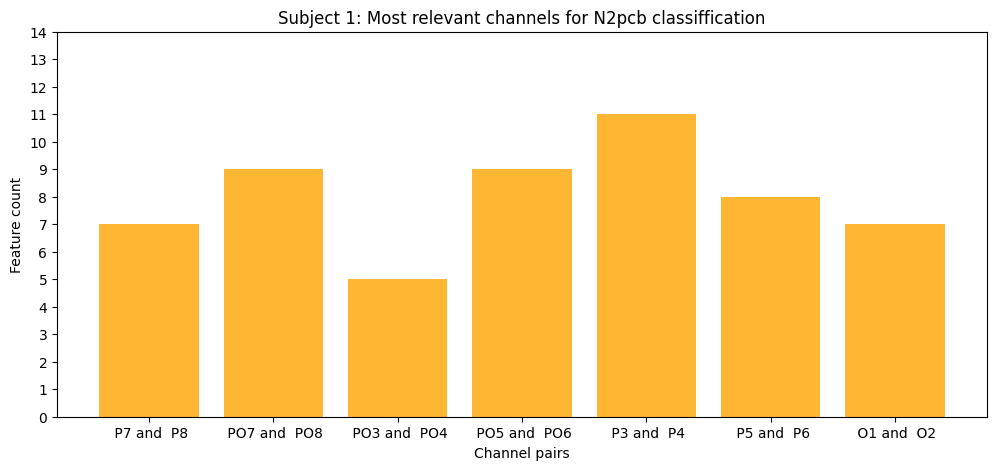

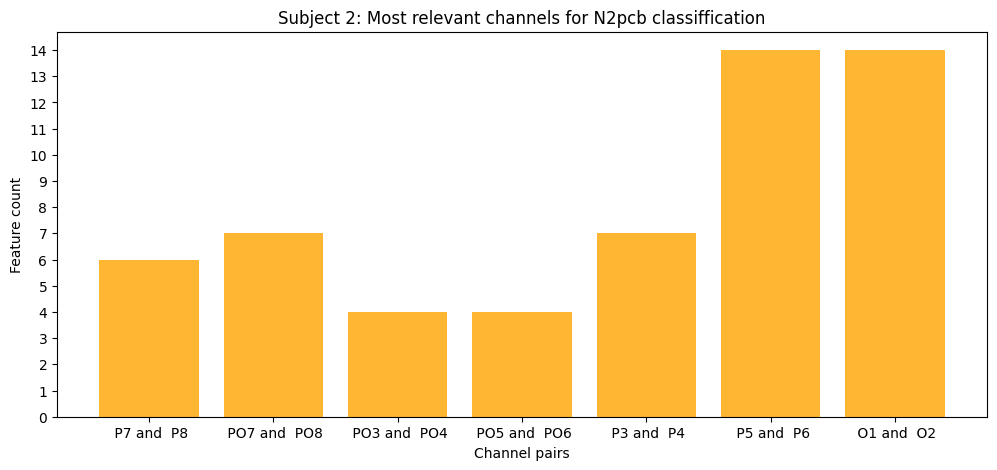

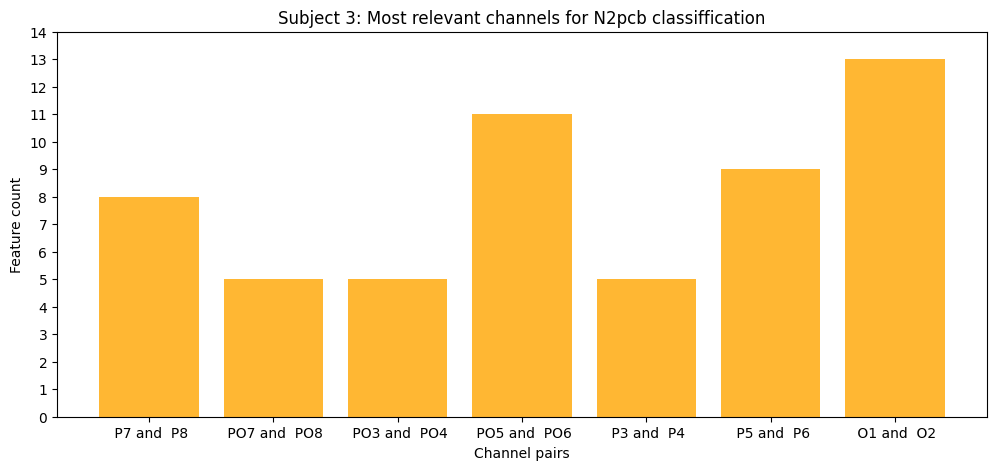

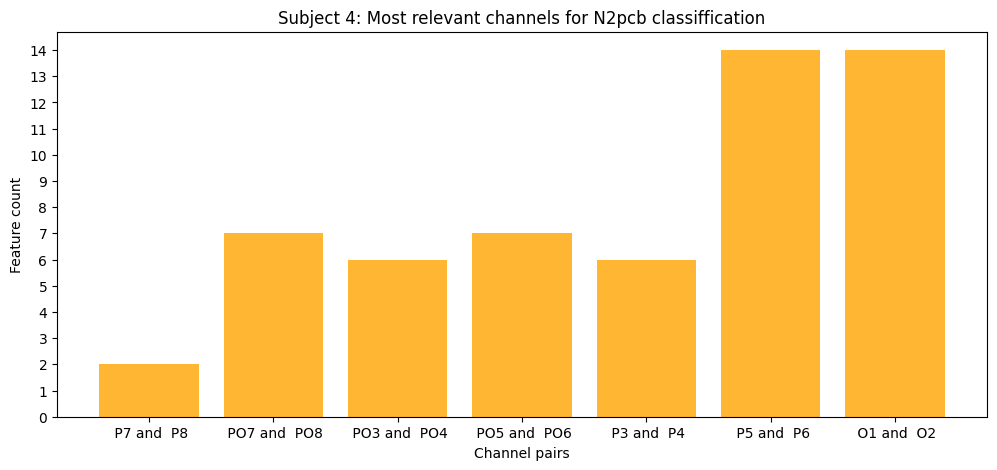

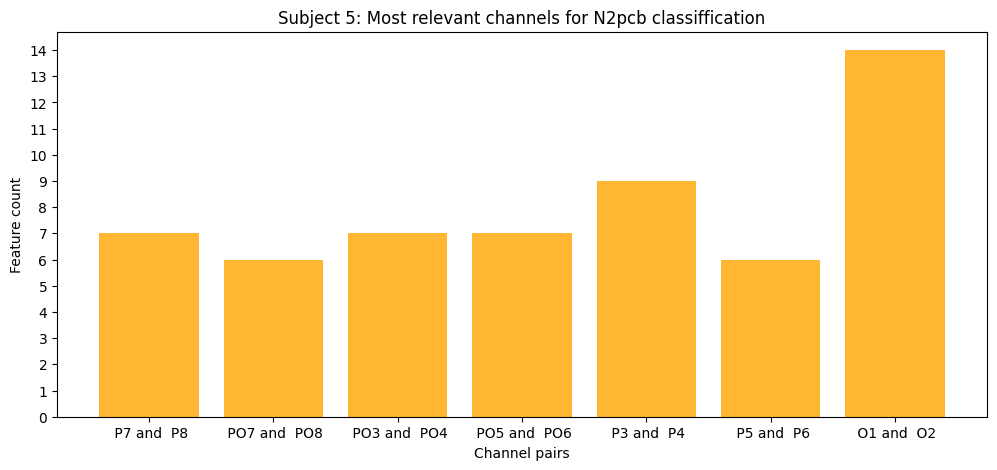

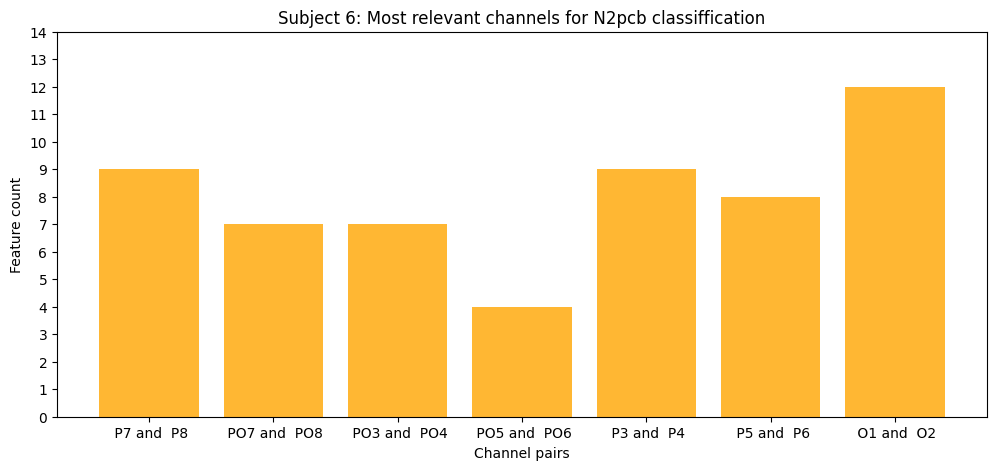

In [ ]:
max_y = np.max(all_tf)

for subj in range(NUM_SUBJ):

    customlb = []
    for c, lb in enumerate(left_N2pc_channels):
        customlb.append(str(lb) + " and " + str(right_N2pc_channels[c]))

    fig, ax = plt.subplots(figsize=(12, 5))
    plt.rcParams.update({'font.size': 10})

    ax.set_title(f'Subject {subj +1}: Most relevant channels for N2pcb classiffication')

    ax.bar(np.arange(1, n_ch + 1), 
           all_tf[subj], 
           color="orange", 
           capsize=4, 
           alpha = 0.8)
    
    ax.set(xticks=np.arange(1, n_ch + 1), 
           xlabel='Channel pairs', 
           yticks=np.arange(0, max_y + 1, step=1),
           ylabel = "Feature count")
    
    ax.set_xticklabels(customlb);

    plt.show();

### Selecting the most relevant channel for classification

In [ ]:
all_best_channel_feat_idx = []

for subj in range(NUM_SUBJ):

    best_channel_feat_idx = np.zeros(len(best_feat_idx))

    for i in range(len(tf)):
        if(all_tf[subj][i] >= sorted(all_tf[subj], reverse = True)[3]):
            best_channel_feat_idx[i * N_DATAPOINTS_RESA_FREQ:i * N_DATAPOINTS_RESA_FREQ + N_DATAPOINTS_RESA_FREQ] = 1
        else:
            best_channel_feat_idx[i * N_DATAPOINTS_RESA_FREQ: i * N_DATAPOINTS_RESA_FREQ + N_DATAPOINTS_RESA_FREQ] = 0

    best_channel_feat_idx = best_channel_feat_idx != 0 # Convert to boolean

    all_best_channel_feat_idx.append(best_channel_feat_idx)

## Classification models

### Most discriminative channels

In [ ]:
print("========================== Most discriminative channels ==========================\n")

perSubj_cross_val_scores = np.zeros((NUM_SUBJ, 5, 2))
perSubj_accuracy = np.zeros((NUM_SUBJ, 5)) # 5 Classifiers
perSubj_auc_scores = np.zeros((NUM_SUBJ, 5))
perSubj_fitting_periods = np.zeros((NUM_SUBJ, 5))

for subj in range(NUM_SUBJ):

    print(f"\n------------------ Subject {subj + 1}: Classifying TVF vs BVF ------------------\n")

    for c_count, clf in enumerate(classifiers):

        print(f"\n------------------ Classifier: {clf} ------------------")

        vertical_n2pcb_clf = clf

        # --------- Cross Validation Scores ---------
        cross_val_scores, best_vertical_n2pcb_clf = GridSearch(classifier_params[c_count], 
                                                               vertical_n2pcb_clf, 
                                                               KFOLD, 
                                                               all_norm_train_featVect[subj][:,all_best_channel_feat_idx[subj]],
                                                               all_norm_train_featVect[subj][:,-1])
        
        perSubj_cross_val_scores[subj, c_count, 0] = cross_val_scores[0]
        perSubj_cross_val_scores[subj, c_count, 1] = cross_val_scores[1]
        perSubj_fitting_periods[subj, c_count] = cross_val_scores[2]

        # --------- Predictions ---------
        pred = best_vertical_n2pcb_clf.predict(all_norm_test_featVect[subj][:, all_best_channel_feat_idx[subj]])
        perSubj_accuracy[subj, c_count] = round(accuracy_score(all_norm_test_featVect[subj][:, -1], pred), 2) * 100

        # Compute AUC for each subject
        perSubj_auc_scores[subj, c_count] = round(roc_auc_score(all_norm_test_featVect[subj][:, -1], best_vertical_n2pcb_clf.predict_proba(all_norm_test_featVect[subj][:,all_best_channel_feat_idx[subj]])[:,1]), 2)

        del vertical_n2pcb_clf, best_vertical_n2pcb_clf # Ensures no mixing of classifiers within the loop


========================== Most discriminative channels ==========================


------------------ Subject 1: Classifying TVF vs BVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.1, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.001}
Best score: 0.6000000000000001

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.5199999999999999

Running Grid Search for method: poly

Best parameters: {'C': 0.01, 'cache_size': 200, 'degree': 3, 'gamma': 0.1, 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.5666666666666667

Running Grid Search for method: sigmoid

Best parameters: {'C': 10, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.001}
Best score: 0.6266666666666667

------------------ Classifier

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 1.0, 'n_estimators': 200, 'random_state': 42}
Best score: 0.49333333333333335

------------------ Subject 2: Classifying TVF vs BVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.1, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.0001}
Best score: 0.5333333333333332

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.5533333333333333

Running Grid Search for method: poly

Best parameters: {'C': 0.001, 'cache_size': 200, 'degree': 2, 'gamma': 10, 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.5533333333333335

Running Grid Search for method: sigmoid

Best parameters: {'C': 10, 'cache_size': 200, 'gamma': 'scale', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.5599999999999999



C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 1.0, 'n_estimators': 100, 'random_state': 42}
Best score: 0.5666666666666667

------------------ Subject 3: Classifying TVF vs BVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 200, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.6133333333333333

Running Grid Search for method: rbf

Best parameters: {'C': 10, 'cache_size': 200, 'gamma': 0.1, 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.6599999999999999

Running Grid Search for method: poly

Best parameters: {'C': 0.001, 'cache_size': 200, 'degree': 3, 'gamma': 10, 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.6733333333333332

Running Grid Search for method: sigmoid

Best parameters: {'C': 0.1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.6199999999999999

-----

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.5, 'n_estimators': 200, 'random_state': 42}
Best score: 0.62

------------------ Subject 4: Classifying TVF vs BVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.1, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.5466666666666666

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.5000000000000001

Running Grid Search for method: poly

Best parameters: {'C': 1, 'cache_size': 200, 'degree': 3, 'gamma': 'scale', 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.5133333333333333

Running Grid Search for method: sigmoid

Best parameters: {'C': 10, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.01}
Best score: 0.5533333333333333

----------------

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.1, 'n_estimators': 50, 'random_state': 42}
Best score: 0.5866666666666667

------------------ Subject 5: Classifying TVF vs BVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.01, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.56

Running Grid Search for method: rbf

Best parameters: {'C': 10, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.5800000000000001

Running Grid Search for method: poly

Best parameters: {'C': 0.001, 'cache_size': 200, 'degree': 3, 'gamma': 0.1, 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.5866666666666667

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.6133333333333334

-----------------

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.5, 'n_estimators': 200, 'random_state': 42}
Best score: 0.6

------------------ Subject 6: Classifying TVF vs BVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 200, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.6533333333333334

Running Grid Search for method: rbf

Best parameters: {'C': 10, 'cache_size': 200, 'gamma': 0.1, 'kernel': 'rbf', 'random_state': 42, 'tol': 0.01}
Best score: 0.6066666666666667

Running Grid Search for method: poly

Best parameters: {'C': 0.01, 'cache_size': 200, 'degree': 3, 'gamma': 0.1, 'kernel': 'poly', 'random_state': 42, 'tol': 0.01}
Best score: 0.66

Running Grid Search for method: sigmoid

Best parameters: {'C': 0.1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.56

------------------ Classifier: LinearDiscrimin

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


#### Cross-Validation Training Classification differences between different classifiers (N2pc - Most dicriminative channels)

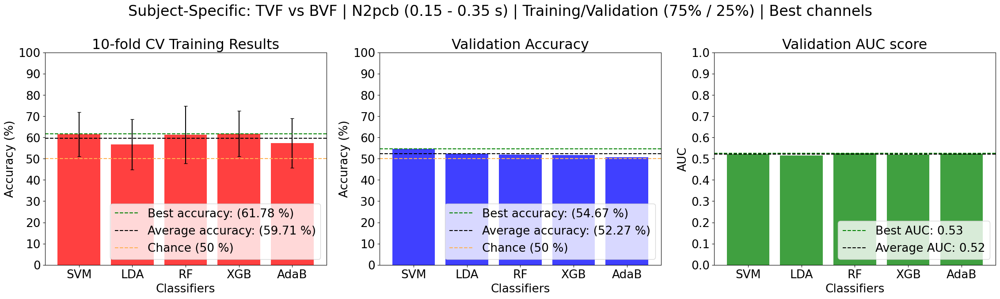

In [ ]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 3,
                       figsize=(23, 7))

fig.suptitle(f'Subject-Specific: TVF vs BVF | N2pcb ({ts} - {te} s) | Training/Validation (75% / 25%) | Best channels', fontsize=24)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 19})
ax[0].bar(np.arange(1, 6), 
       np.mean(perSubj_cross_val_scores[:,:,0], axis = 0 ), 
       color="red", 
       yerr = np.mean(perSubj_cross_val_scores[:,:,1], axis = 0), 
       capsize=3,
       alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(np.mean(perSubj_cross_val_scores[:,:,0], axis = 0)), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(np.mean(perSubj_cross_val_scores[:,:,0], axis = 0)):.2f} %)')

ax[0].axhline(y = np.mean(perSubj_cross_val_scores[:,:,0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(perSubj_cross_val_scores[:,:,0]):.2f} %)')

ax[0].axhline(y=50, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (50 %)')

ax[0].set(xticks = np.arange(1, 5 + 1), 
       xticklabels = class_list,
       xlabel = 'Classifiers', 
       yticks=np.arange(0, 101, step=10), ylabel='Accuracy (%)',
       title=f'{KFOLD}-fold CV Training Results');

ax[0].legend(loc='lower right');


# -------------- Prediction Accuracy --------------

ax[1].bar(np.arange(1, 6), 
          np.mean(perSubj_accuracy, axis = 0 ), 
          color="b",
          alpha = 0.75)

ax[1].set_title('Accuracy (%)')

ax[1].axhline(y = max(np.mean(perSubj_accuracy, axis = 0)), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(np.mean(perSubj_accuracy, axis = 0)):.2f} %)')

ax[1].axhline(y = np.mean(perSubj_accuracy), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy):.2f} %)')

ax[1].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50 %)')

ax[1].set(xticks = np.arange(1, 5 + 1), 
          xticklabels = class_list,
          xlabel = 'Classifiers', 
          yticks=np.arange(0, 101, step=10), ylabel='Accuracy (%)',
          title="Validation Accuracy");

ax[1].legend(loc='lower right');


# -------------- Aread Under the Curve (AUC) --------------

ax[2].bar(np.arange(1, 6), 
          np.mean(perSubj_auc_scores, axis = 0 ), 
          color="g",
          alpha = 0.75)

ax[2].set_title('AUC ')

ax[2].axhline(y = max(np.mean(perSubj_auc_scores, axis = 0)), 
              color='green', linestyle='--', 
              label = f'Best AUC: {max(np.mean(perSubj_auc_scores, axis = 0)):.2f}')

ax[2].axhline(y = np.mean(perSubj_auc_scores), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: {np.mean(perSubj_auc_scores):.2f}')

ax[2].set(xticks = np.arange(1, 5 + 1), 
          xticklabels = class_list,
          xlabel = 'Classifiers', 
          yticks=np.arange(0, 1.01, step=0.1), ylabel='AUC',
          title="Validation AUC score");

ax[2].legend(loc='lower right');
plt.tight_layout()

#### Best classifier Cross-Validation Training accuracies for all subjects (N2pcb - Most dicriminative channels)

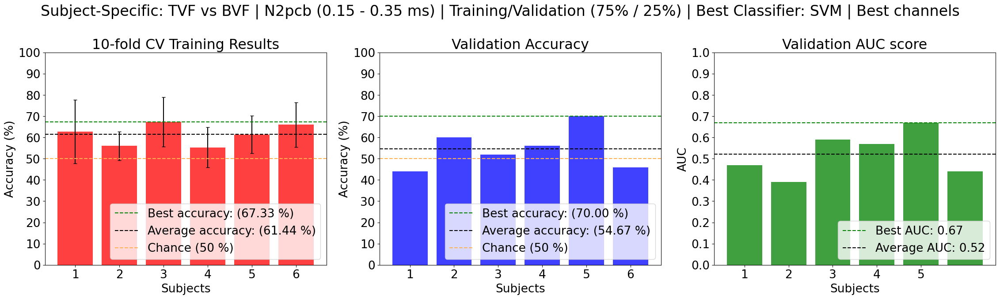

In [ ]:
best_classifier = np.argmax(np.mean(perSubj_accuracy, axis = 0))

fig, ax = plt.subplots(nrows = 1,
                       ncols = 3,
                       figsize=(23, 7))

fig.suptitle(f'Subject-Specific: TVF vs BVF | N2pcb ({ts} - {te} s) | Training/Validation (75% / 25%) | Best Classifier: {class_list[best_classifier]} | Best channels', fontsize=24)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 19})
ax[0].bar(np.arange(1, NUM_SUBJ + 1), 
       perSubj_cross_val_scores[:,best_classifier, 0], 
       color="red", 
       yerr = perSubj_cross_val_scores[:,best_classifier, 1], 
       capsize=3,
       alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(perSubj_cross_val_scores[:,best_classifier, 0]), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(perSubj_cross_val_scores[:,best_classifier, 0]):.2f} %)')

ax[0].axhline(y = np.mean(perSubj_cross_val_scores[:,best_classifier, 0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(perSubj_cross_val_scores[:,best_classifier, 0]):.2f} %)')

ax[0].axhline(y=50, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (50 %)')

ax[0].set(xticks = np.arange(1, NUM_SUBJ + 1), 
         xlabel = 'Subjects', 
         yticks=np.arange(0, 101, step=10), 
         ylabel='Accuracy (%)',
         title=f'{KFOLD}-fold CV Training Results');

ax[0].legend(loc='lower right');


# -------------- Prediction Accuracy --------------

ax[1].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_accuracy[:,best_classifier], 
          color="b",
          alpha = 0.75)

ax[1].set_title('Accuracy (%)')

ax[1].axhline(y = max(perSubj_accuracy[:,best_classifier]), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(perSubj_accuracy[:,best_classifier]):.2f} %)')

ax[1].axhline(y = np.mean(perSubj_accuracy[:,best_classifier]), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy[:,best_classifier]):.2f} %)')

ax[1].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50 %)')

ax[1].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 101, step=10), 
          ylabel='Accuracy (%)',
          title="Validation Accuracy");

ax[1].legend(loc='lower right');


# -------------- Aread Under the Curve (AUC) --------------

ax[2].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_auc_scores[:, best_classifier], 
          color="g",
          alpha = 0.75)

ax[2].set_title('AUC ')

ax[2].axhline(y = max(perSubj_auc_scores[:, best_classifier]), 
              color='green', linestyle='--', 
              label = f'Best AUC: {max(perSubj_auc_scores[:, best_classifier]):.2f}')

ax[2].axhline(y = np.mean(perSubj_auc_scores[:, best_classifier]), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: {np.mean(perSubj_auc_scores[:, best_classifier]):.2f}')

ax[2].set(xticks = np.arange(1, 5 + 1), 
          xlabel = 'Subjects', 
          yticks=np.arange(0, 1.01, step=0.1), ylabel='AUC',
          title="Validation AUC score");

ax[2].legend(loc='lower right');
plt.tight_layout()

#### Saving best models (N2pcb - Most dicriminative channels)

In [ ]:
N2pcb_bestElec_Folder = "C:/Users/MICROMED\Desktop/MiguelRocha/PROJ/Models/SS_TVF_vs_BVF_N2pcb_BestElectrodesIndices/"

# Create the folder (raises an error if it already exists)
try:
  os.mkdir(N2pcb_bestElec_Folder)
  print(f"Folder created successfully at: {N2pcb_bestElec_Folder}")
except FileExistsError:
  print(f"Folder already exists at: {N2pcb_bestElec_Folder}")

N2pcb_bestFeat_models_Folder = "C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_TVF_vs_BVF_N2pcb_BestElectrodes/"

# Create the folder (raises an error if it already exists)
try:
  os.mkdir(N2pcb_bestFeat_models_Folder)
  print(f"Folder created successfully at: {N2pcb_bestFeat_models_Folder}")
except FileExistsError:
  print(f"Folder already exists at: {N2pcb_bestFeat_models_Folder}")

Folder created successfully at: C:/Users/MICROMED\Desktop/MiguelRocha/PROJ/Models/SS_N2pcb_bestElectrodes/
Folder created successfully at: C:/Users/MICROMED\Desktop/MiguelRocha/PROJ/Models/SS_N2pcb_bestElectrodes/SS_N2pcb_bestFeat_TVF_vs_BVF/


In [ ]:
perSubj_optim_params = [{'C': 10, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.001},
                        {'C': 10, 'cache_size': 200, 'gamma': 'scale', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1},
                        {'C': 0.001, 'cache_size': 200, 'degree': 3, 'gamma': 10, 'kernel': 'poly', 'random_state': 42, 'tol': 0.1},
                        {'C': 10, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.01},
                        {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1},
                        {'C': 200, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}]

In [ ]:
bestModel_Subj_cross_val_scores = np.zeros((NUM_SUBJ, 2))

for subj in range(NUM_SUBJ):

    train = np.vstack((all_norm_train_featVect[subj], 
                       all_norm_test_featVect[subj])) # All data stacked

    np.random.seed(42)
    np.random.shuffle(train)

    # -------------------------- RandomForest --------------------------
    best_N2pcb_clf = SVC(probability=True)
    best_N2pcb_clf.set_params(**perSubj_optim_params[subj])

    # --------- Cross Validation Scores ---------
    scores = cross_val_score(best_N2pcb_clf, 
                             train[:, all_best_channel_feat_idx[subj]], 
                             train[:, -1], 
                             cv = KFOLD)
    
    bestModel_Subj_cross_val_scores[subj, 0] = (scores.mean() * 100)
    bestModel_Subj_cross_val_scores[subj, 1] = (scores.std() * 100)

    # --------- Train Model ---------
    best_N2pcb_clf.fit(train[:, all_best_channel_feat_idx[subj]], 
                      train[:, -1])
    
    joblib.dump(all_best_channel_feat_idx[subj], f'{N2pcb_bestElec_Folder}Subj_0{subj + 1}_N2pcb_bestElec.pkl')
    joblib.dump(best_N2pcb_clf, f'{N2pcb_bestFeat_models_Folder}Subj_0{subj + 1}_N2pcb_model.pkl')
    
    del best_N2pcb_clf

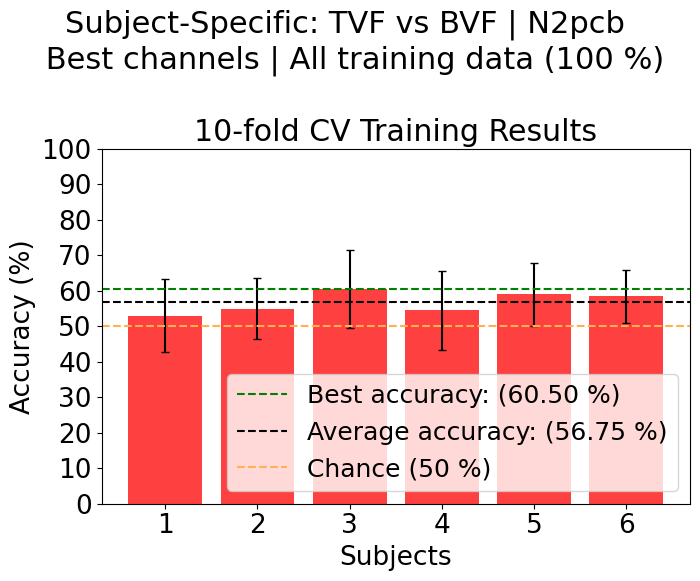

In [ ]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 1,
                       figsize=(7.34, 6))

fig.suptitle(f'Subject-Specific: TVF vs BVF | N2pcb \n Best channels | All training data (100 %)', fontsize=22)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 18})
ax.bar(np.arange(1, NUM_SUBJ + 1), 
       bestModel_Subj_cross_val_scores[:, 0], 
       color="red", 
       yerr = bestModel_Subj_cross_val_scores[:, 1], 
       capsize=3,
       alpha = 0.75)

ax.set_title('Accuracy (%)')

ax.axhline(y = max(bestModel_Subj_cross_val_scores[:, 0]), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(bestModel_Subj_cross_val_scores[:, 0]):.2f} %)')

ax.axhline(y = np.mean(bestModel_Subj_cross_val_scores[:, 0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(bestModel_Subj_cross_val_scores[:, 0]):.2f} %)')

ax.axhline(y=50, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (50 %)')

ax.set(xticks = np.arange(1, NUM_SUBJ + 1), 
         xlabel = 'Subjects', 
         yticks=np.arange(0, 101, step=10), 
         ylabel='Accuracy (%)',
         title=f'{KFOLD}-fold CV Training Results');

ax.legend(loc='lower right');
plt.tight_layout()

### All features

In [ ]:
print("========================== All features (channel differences) ==========================\n")

perSubj_cross_val_scores = np.zeros((NUM_SUBJ, 5, 2))
perSubj_accuracy = np.zeros((NUM_SUBJ, 5)) # 5 Classifiers
perSubj_auc_scores = np.zeros((NUM_SUBJ, 5))
perSubj_fitting_periods = np.zeros((NUM_SUBJ, 5))

for subj in range(NUM_SUBJ):

    print(f"\n------------------ Subject {subj + 1}: Classifying TVF vs BVF ------------------\n")

    for c_count, clf in enumerate(classifiers):

        print(f"\n------------------ Classifier: {clf} ------------------")

        vertical_n2pcb_clf = clf

        # --------- Cross Validation Scores ---------
        cross_val_scores, best_vertical_n2pcb_clf = GridSearch(classifier_params[c_count], 
                                                               vertical_n2pcb_clf, 
                                                               KFOLD, 
                                                               all_norm_train_featVect[subj][:,0:-1],
                                                               all_norm_train_featVect[subj][:,-1])
        
        perSubj_cross_val_scores[subj, c_count, 0] = cross_val_scores[0]
        perSubj_cross_val_scores[subj, c_count, 1] = cross_val_scores[1]
        perSubj_fitting_periods[subj, c_count] = cross_val_scores[2]

        # --------- Predictions ---------
        pred = best_vertical_n2pcb_clf.predict(all_norm_test_featVect[subj][:, 0:-1])
        perSubj_accuracy[subj, c_count] = round(accuracy_score(all_norm_test_featVect[subj][:, -1], pred), 2) * 100

        # Compute AUC for each subject
        perSubj_auc_scores[subj, c_count] = round(roc_auc_score(all_norm_test_featVect[subj][:, -1], best_vertical_n2pcb_clf.predict_proba(all_norm_test_featVect[subj][:, 0:-1])[:,1]), 2)

        del vertical_n2pcb_clf, best_vertical_n2pcb_clf # Ensures no mixing of classifiers within the loop

========================== All features (channel differences) ==========================


------------------ Subject 1: Classifying TVF vs BVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.01, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.5866666666666667

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.5533333333333333

Running Grid Search for method: poly

Best parameters: {'C': 0.001, 'cache_size': 200, 'degree': 3, 'gamma': 1, 'kernel': 'poly', 'random_state': 42, 'tol': 0.01}
Best score: 0.5666666666666667

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.6133333333333334

------------------ Classif

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.5, 'n_estimators': 100, 'random_state': 42}
Best score: 0.5733333333333334

------------------ Subject 2: Classifying TVF vs BVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.01, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.5266666666666667

Running Grid Search for method: rbf

Best parameters: {'C': 10, 'cache_size': 200, 'gamma': 0.1, 'kernel': 'rbf', 'random_state': 42, 'tol': 0.01}
Best score: 0.5666666666666667

Running Grid Search for method: poly

Best parameters: {'C': 0.001, 'cache_size': 200, 'degree': 3, 'gamma': 0.1, 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.5466666666666666

Running Grid Search for method: sigmoid

Best parameters: {'C': 100, 'cache_size': 200, 'gamma': 10, 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.6133333333333334

------

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.5, 'n_estimators': 200, 'random_state': 42}
Best score: 0.5666666666666667

------------------ Subject 3: Classifying TVF vs BVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.01, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.6333333333333333

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.6733333333333332

Running Grid Search for method: poly

Best parameters: {'C': 0.001, 'cache_size': 200, 'degree': 3, 'gamma': 0.1, 'kernel': 'poly', 'random_state': 42, 'tol': 0.01}
Best score: 0.6599999999999999

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.6266666666666667

--

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.5, 'n_estimators': 200, 'random_state': 42}
Best score: 0.6933333333333334

------------------ Subject 4: Classifying TVF vs BVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 1, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.5599999999999999

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.5000000000000001

Running Grid Search for method: poly

Best parameters: {'C': 0.001, 'cache_size': 200, 'degree': 3, 'gamma': 0.1, 'kernel': 'poly', 'random_state': 42, 'tol': 0.01}
Best score: 0.48666666666666664

Running Grid Search for method: sigmoid

Best parameters: {'C': 10, 'cache_size': 200, 'gamma': 10, 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.5866666666666667

-------

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.1, 'n_estimators': 100, 'random_state': 42}
Best score: 0.6066666666666667

------------------ Subject 5: Classifying TVF vs BVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 1, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.6133333333333334

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.5800000000000001

Running Grid Search for method: poly

Best parameters: {'C': 0.001, 'cache_size': 200, 'degree': 3, 'gamma': 0.1, 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.6

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.5533333333333333

------------------ Cl

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.5, 'n_estimators': 100, 'random_state': 42}
Best score: 0.5866666666666667

------------------ Subject 6: Classifying TVF vs BVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.01, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.6

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.01}
Best score: 0.6066666666666667

Running Grid Search for method: poly

Best parameters: {'C': 0.001, 'cache_size': 200, 'degree': 3, 'gamma': 0.1, 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.5866666666666667

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.01}
Best score: 0.5733333333333335

----------------

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


#### Cross-Validation Training Classification differences between different classifiers (N2pcb - All features)

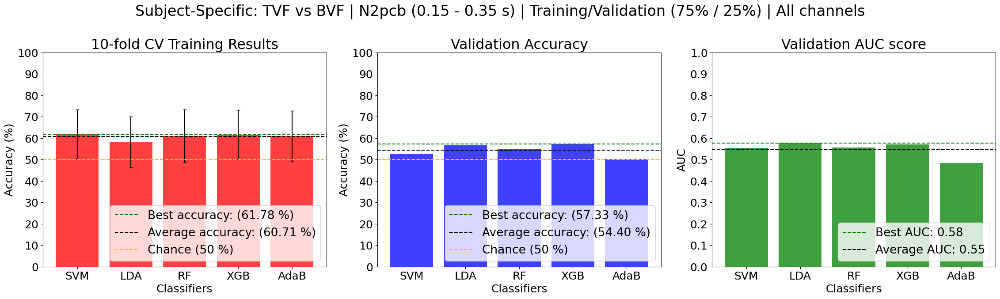

In [ ]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 3,
                       figsize=(23, 7))

fig.suptitle(f'Subject-Specific: TVF vs BVF | N2pcb ({ts} - {te} s) | Training/Validation (75% / 25%) | All channels', fontsize=24)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 19})
ax[0].bar(np.arange(1, 6), 
       np.mean(perSubj_cross_val_scores[:,:,0], axis = 0 ), 
       color="red", 
       yerr = np.mean(perSubj_cross_val_scores[:,:,1], axis = 0), 
       capsize=3,
       alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(np.mean(perSubj_cross_val_scores[:,:,0], axis = 0)), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(np.mean(perSubj_cross_val_scores[:,:,0], axis = 0)):.2f} %)')

ax[0].axhline(y = np.mean(perSubj_cross_val_scores[:,:,0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(perSubj_cross_val_scores[:,:,0]):.2f} %)')

ax[0].axhline(y=50, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (50 %)')

ax[0].set(xticks = np.arange(1, 6), 
       xticklabels = class_list,
       xlabel = 'Classifiers', 
       yticks=np.arange(0, 101, step=10), ylabel='Accuracy (%)',
       title=f'{KFOLD}-fold CV Training Results');

ax[0].legend(loc='lower right');


# -------------- Prediction Accuracy --------------

ax[1].bar(np.arange(1, 6), 
          np.mean(perSubj_accuracy, axis = 0 ), 
          color="b",
          alpha = 0.75)

ax[1].set_title('Accuracy (%)')

ax[1].axhline(y = max(np.mean(perSubj_accuracy, axis = 0)), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(np.mean(perSubj_accuracy, axis = 0)):.2f} %)')

ax[1].axhline(y = np.mean(perSubj_accuracy), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy):.2f} %)')

ax[1].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50 %)')

ax[1].set(xticks = np.arange(1, 5 + 1), 
          xticklabels = class_list,
          xlabel = 'Classifiers', 
          yticks=np.arange(0, 101, step=10), ylabel='Accuracy (%)',
          title="Validation Accuracy");

ax[1].legend(loc='lower right');


# -------------- Aread Under the Curve (AUC) --------------

ax[2].bar(np.arange(1, 6), 
          np.mean(perSubj_auc_scores, axis = 0 ), 
          color="g",
          alpha = 0.75)

ax[2].set_title('AUC ')

ax[2].axhline(y = max(np.mean(perSubj_auc_scores, axis = 0)), 
              color='green', linestyle='--', 
              label = f'Best AUC: {max(np.mean(perSubj_auc_scores, axis = 0)):.2f}')

ax[2].axhline(y = np.mean(perSubj_auc_scores), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: {np.mean(perSubj_auc_scores):.2f}')

ax[2].set(xticks = np.arange(1, 5 + 1), 
          xticklabels = class_list,
          xlabel = 'Classifiers', 
          yticks=np.arange(0, 1.01, step=0.1), ylabel='AUC',
          title="Validation AUC score");

ax[2].legend(loc='lower right');
plt.tight_layout()

#### Best classifier Cross-Validation Training accuracies for all subjects

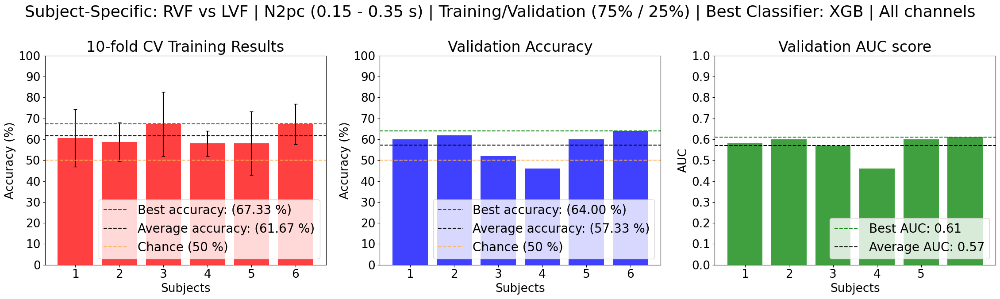

In [ ]:
best_classifier = np.argmax(np.mean(perSubj_accuracy, axis = 0))

fig, ax = plt.subplots(nrows = 1,
                       ncols = 3,
                       figsize=(23, 7))

fig.suptitle(f'Subject-Specific: RVF vs LVF | N2pc ({ts} - {te} s) | Training/Validation (75% / 25%) | Best Classifier: {class_list[best_classifier]} | All channels', fontsize=26)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 20})
ax[0].bar(np.arange(1, NUM_SUBJ + 1), 
       perSubj_cross_val_scores[:,best_classifier, 0], 
       color="red", 
       yerr = perSubj_cross_val_scores[:,best_classifier, 1], 
       capsize=3,
       alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(perSubj_cross_val_scores[:,best_classifier, 0]), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(perSubj_cross_val_scores[:,best_classifier, 0]):.2f} %)')

ax[0].axhline(y = np.mean(perSubj_cross_val_scores[:,best_classifier, 0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(perSubj_cross_val_scores[:,best_classifier, 0]):.2f} %)')

ax[0].axhline(y=50, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (50 %)')

ax[0].set(xticks = np.arange(1, NUM_SUBJ + 1), 
         xlabel = 'Subjects', 
         yticks=np.arange(0, 101, step=10), 
         ylabel='Accuracy (%)',
         title=f'{KFOLD}-fold CV Training Results');

ax[0].legend(loc='lower right');


# -------------- Prediction Accuracy --------------

ax[1].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_accuracy[:,best_classifier], 
          color="b",
          alpha = 0.75)

ax[1].set_title('Accuracy (%)')

ax[1].axhline(y = max(perSubj_accuracy[:,best_classifier]), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(perSubj_accuracy[:,best_classifier]):.2f} %)')

ax[1].axhline(y = np.mean(perSubj_accuracy[:,best_classifier]), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy[:,best_classifier]):.2f} %)')

ax[1].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50 %)')

ax[1].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 101, step=10), 
          ylabel='Accuracy (%)',
          title="Validation Accuracy");

ax[1].legend(loc='lower right');


# -------------- Aread Under the Curve (AUC) --------------

ax[2].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_auc_scores[:, best_classifier], 
          color="g",
          alpha = 0.75)

ax[2].set_title('AUC ')

ax[2].axhline(y = max(perSubj_auc_scores[:, best_classifier]), 
              color='green', linestyle='--', 
              label = f'Best AUC: {max(perSubj_auc_scores[:, best_classifier]):.2f}')

ax[2].axhline(y = np.mean(perSubj_auc_scores[:, best_classifier]), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: {np.mean(perSubj_auc_scores[:, best_classifier]):.2f}')

ax[2].set(xticks = np.arange(1, 5 + 1), 
          xlabel = 'Subjects', 
          yticks=np.arange(0, 1.01, step=0.1), ylabel='AUC',
          title="Validation AUC score");

ax[2].legend(loc='lower right');
plt.tight_layout()

### Training and saving best Model (N2pcb - All features)

In [ ]:
N2pcb_models_Folder = "C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_TVF_vs_BVF_N2pcb_AllElectrodes/"

# Create the folder (raises an error if it already exists)
try:
  os.mkdir(N2pcb_models_Folder)
  print(f"Folder created successfully at: {N2pcb_models_Folder}")
except FileExistsError:
  print(f"Folder already exists at: {N2pcb_models_Folder}")

Folder created successfully at: C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_N2pcb_TVF_vs_BVF/


In [ ]:
perSubj_optim_params = [{'colsample_bytree': 1.0, 'eval_metric': 'logloss', 'learning_rate': 0.1, 'max_depth': 9, 'n_estimators': 50, 'objective': 'binary:logistic', 'random_state': 42, 'subsample': 0.8},
                        {'colsample_bytree': 0.8, 'eval_metric': 'logloss', 'learning_rate': 0.5, 'max_depth': 9, 'n_estimators': 50, 'objective': 'binary:logistic', 'random_state': 42, 'subsample': 1.0},
                        {'colsample_bytree': 1.0, 'eval_metric': 'logloss', 'learning_rate': 0.3, 'max_depth': 9, 'n_estimators': 50, 'objective': 'binary:logistic', 'random_state': 42, 'subsample': 0.8},
                        {'colsample_bytree': 0.8, 'eval_metric': 'logloss', 'learning_rate': 0.1, 'max_depth': 9, 'n_estimators': 50, 'objective': 'reg:squarederror', 'random_state': 42, 'subsample': 1.0},
                        {'colsample_bytree': 0.8, 'eval_metric': 'logloss', 'learning_rate': 0.5, 'max_depth': 6, 'n_estimators': 100, 'objective': 'binary:logistic', 'random_state': 42, 'subsample': 0.8},
                        {'colsample_bytree': 0.8, 'eval_metric': 'logloss', 'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 50, 'objective': 'binary:logistic', 'random_state': 42, 'subsample': 1.0}]

In [ ]:
import joblib

bestModel_Subj_cross_val_scores = np.zeros((NUM_SUBJ, 2))

for subj in range(NUM_SUBJ):

    train = np.vstack((all_norm_train_featVect[subj], all_norm_test_featVect[subj])) # All data stacked

    np.random.seed(42)
    np.random.shuffle(train)

    # -------------------------- XGBoost --------------------------
    best_n2pcb_clf = xgb.XGBClassifier()
    best_n2pcb_clf.set_params(**perSubj_optim_params[subj])

    # --------- Cross Validation Scores ---------
    scores = cross_val_score(best_n2pcb_clf, 
                             train[:, 0:-1], 
                             train[:, -1], 
                             cv = KFOLD)
    
    bestModel_Subj_cross_val_scores[subj, 0] = (scores.mean() * 100)
    bestModel_Subj_cross_val_scores[subj, 1] = (scores.std() * 100)

    # --------- Train Model ---------
    best_n2pcb_clf.fit(train[:, 0:-1], 
                      train[:, -1])
    
    joblib.dump(best_n2pcb_clf, f'{N2pcb_models_Folder}Subj_0{subj + 1}_N2pcb_model.pkl')
    
    del best_n2pcb_clf

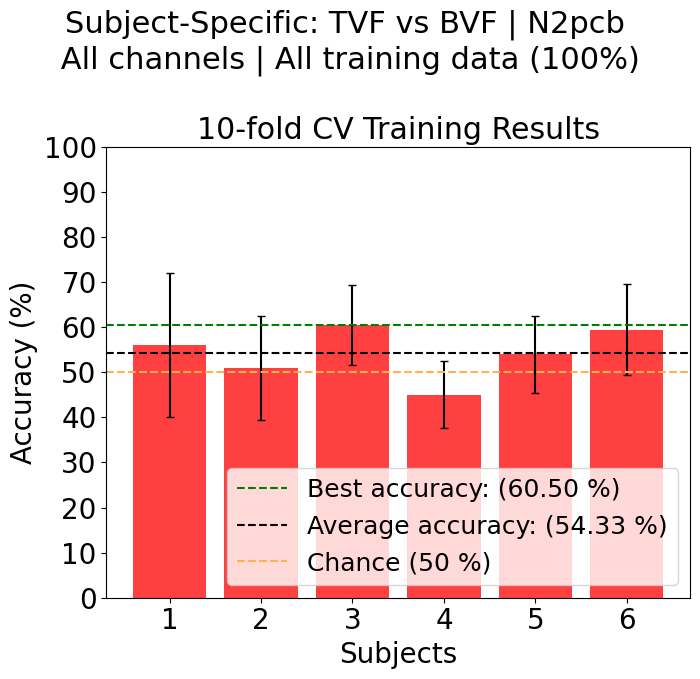

In [ ]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 1,
                       figsize=(7.34, 7))

fig.suptitle(f'Subject-Specific: TVF vs BVF | N2pcb \n All channels | All training data (100%) ', fontsize=22)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size':18})
ax.bar(np.arange(1, NUM_SUBJ + 1), 
       bestModel_Subj_cross_val_scores[:, 0], 
       color="red", 
       yerr = bestModel_Subj_cross_val_scores[:, 1], 
       capsize=3,
       alpha = 0.75)

ax.set_title('Accuracy (%)')

ax.axhline(y = max(bestModel_Subj_cross_val_scores[:, 0]), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(bestModel_Subj_cross_val_scores[:, 0]):.2f} %)')

ax.axhline(y = np.mean(bestModel_Subj_cross_val_scores[:, 0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(bestModel_Subj_cross_val_scores[:, 0]):.2f} %)')

ax.axhline(y=50, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (50 %)')

ax.set(xticks = np.arange(1, NUM_SUBJ + 1), 
         xlabel = 'Subjects', 
         yticks=np.arange(0, 101, step=10), 
         ylabel='Accuracy (%)',
         title=f'{KFOLD}-fold CV Training Results');

ax.legend(loc='lower right');
plt.tight_layout()

## NN model

In [ ]:
torch.manual_seed(42)

class N2pcbModel(nn.Module):
    def __init__(self, input_features, output_features, hidden_units=8):
        """Initializes all required hyperparameters for a multi-class classification model.

        Args:
            input_features (int): Number of input features to the model.
            out_features (int): Number of output features of the model
              (how many classes there are).
            hidden_units (int): Number of hidden units between layers, default 8.
        """
        super().__init__()
        self.linear_layer_stack = nn.Sequential(
            nn.Linear(in_features=input_features, out_features=hidden_units),
            nn.Sigmoid(), 
            nn.Linear(in_features=hidden_units, out_features=hidden_units),
            nn.Sigmoid(), 
            nn.Linear(in_features=hidden_units, out_features=output_features),
        )
    
    def forward(self, x):
        return self.linear_layer_stack(x)

## Training model (All features)

In [ ]:
all_training_losses = []
all_testing_losses = []

all_real_y = []
all_y_preds = []

for subj in range(NUM_SUBJ):

  print(f"\n------------------ Subject {subj + 1}: Training model (N2pcb) ------------------")

  # Number of features

  train_featVect = np.vstack((all_NN_featVectRVF[subj][:n_train], all_NN_featVectLVF[subj][:n_train]))
  test_featVect = np.vstack((all_NN_featVectRVF[subj][n_train:], all_NN_featVectLVF[subj][n_train:]))

  NUM_FEATURES = np.size(train_featVect[:, 0:-1],1) 

  # Fit the model
  torch.manual_seed(42)

  # Set number of epochs
  dl_epochs = 30000
      
  # Initializing model

  y_pos_model1 = N2pcbModel(input_features=NUM_FEATURES, 
                           output_features=1, 
                           hidden_units=32).to(device)

  loss_fn = nn.L1Loss()
  optimizer = torch.optim.SGD(y_pos_model1.parameters(), 
                              lr=0.015,
                              momentum=0.095)

  # Shuffle

  np.random.seed(42)
  np.random.shuffle(train_featVect)
  np.random.seed(42)
  np.random.shuffle(test_featVect)

  # Tensor convertion
  tn_train_feat = torch.tensor(np.array(train_featVect[:, 0:-1])).type(torch.float32)
  tn_train_lbl = torch.tensor(np.array(train_featVect[:,-1])).type(torch.float32)

  tn_test_feat = torch.tensor(np.array(test_featVect[:, 0:-1])).type(torch.float32)
  tn_test_lbl = torch.tensor(np.array(test_featVect[:,-1])).type(torch.float32)

  # Feature wise normalization of feature vector
  n_entries, n_feat = tn_train_feat.size()

  for j in range(n_entries):

      mean = tn_train_feat[j,:].mean(dim=0)
      std = tn_train_feat[j,:].std(dim=0)
      tn_train_feat[j,:] = (tn_train_feat[j,:] - mean) / std

  n_entries, n_feat = tn_test_feat.size()

  for u in range(n_entries):

      mean = tn_test_feat[u,:].mean(dim=0)
      std = tn_test_feat[u,:].std(dim=0)
      tn_test_feat[u,:] = (tn_test_feat[u,:] - mean) / std

  training_losses = []
  testing_losses = []

  for dl_epoch in range(dl_epochs):
      ### Training
      y_pos_model1.train()

      # 1. Forward pass
      y_pos_ = y_pos_model1(tn_train_feat)

      # 2. Calculate loss
      train_loss = loss_fn(torch.squeeze(y_pos_), tn_train_lbl) 
      training_losses.append(train_loss.detach().numpy())
    
      # 3. Optimizer zero grad
      optimizer.zero_grad()

      # 4. Loss backwards
      train_loss.backward()

      # 5. Optimizer step
      optimizer.step()

      ### Testing
      y_pos_model1.eval()
      with torch.inference_mode():
        # 1. Forward pass
        output = y_pos_model1(tn_test_feat)
        # 2. Calculate test loss and accuracy
        test_loss = loss_fn(torch.squeeze(output), tn_test_lbl)
        testing_losses.append(test_loss.detach().numpy())

      # Print out what's happening
      if (dl_epoch + 1) % 2000 == 0:
          print(f"Epoch: {dl_epoch + 1} | Training Loss: {train_loss:.5f}, | Testing Loss: {test_loss:.5f}")  

  # ------------------------------------ Test ------------------------------------

  # 1. Set the model in evaluation mode

  y_pos_model1.eval()

  # 2. Setup the inference mode context manager
  with torch.inference_mode():
    y_preds = y_pos_model1(tn_test_feat)
    
  y_preds = y_preds.numpy()
  real_y = tn_test_lbl.numpy()

  all_training_losses.append(training_losses)
  all_testing_losses.append(testing_losses)

  all_y_preds.append(y_preds)
  all_real_y.append(real_y)

  del y_pos_model1


------------------ Subject 1: Training model (N2pcb) ------------------
Epoch: 2000 | Training Loss: 69.76212, | Testing Loss: 160.94420
Epoch: 4000 | Training Loss: 14.51305, | Testing Loss: 176.72934
Epoch: 6000 | Training Loss: 4.41348, | Testing Loss: 175.88907
Epoch: 8000 | Training Loss: 4.43199, | Testing Loss: 176.64713
Epoch: 10000 | Training Loss: 3.15309, | Testing Loss: 174.41077
Epoch: 12000 | Training Loss: 2.20734, | Testing Loss: 174.20786
Epoch: 14000 | Training Loss: 1.98468, | Testing Loss: 173.72281
Epoch: 16000 | Training Loss: 1.79318, | Testing Loss: 173.88951
Epoch: 18000 | Training Loss: 1.40981, | Testing Loss: 174.05359
Epoch: 20000 | Training Loss: 1.39629, | Testing Loss: 174.76456
Epoch: 22000 | Training Loss: 1.32849, | Testing Loss: 175.83533
Epoch: 24000 | Training Loss: 1.23232, | Testing Loss: 176.22359
Epoch: 26000 | Training Loss: 1.16505, | Testing Loss: 176.64574
Epoch: 28000 | Training Loss: 0.96449, | Testing Loss: 176.95168
Epoch: 30000 | Trai

## Ploting predictions against the real values of the object's position alongisde the y-axis (All features)

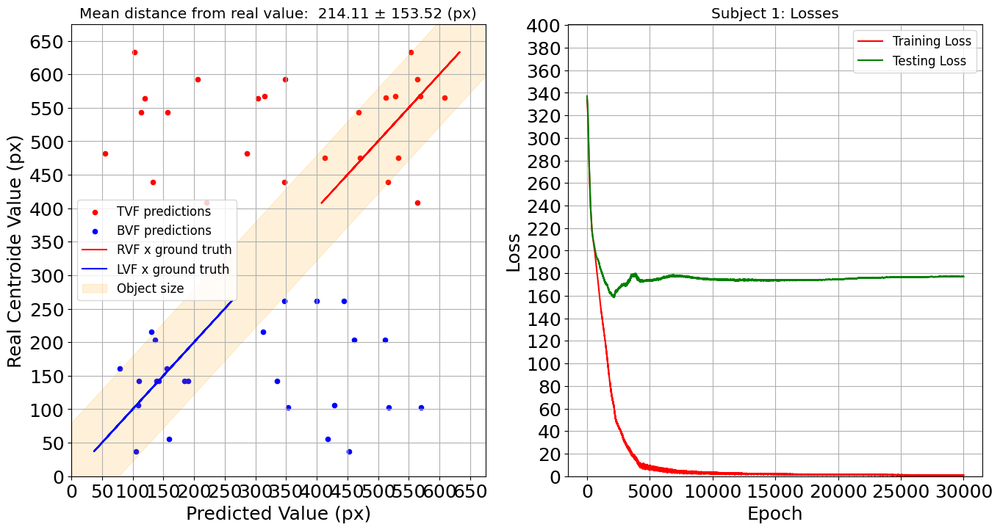

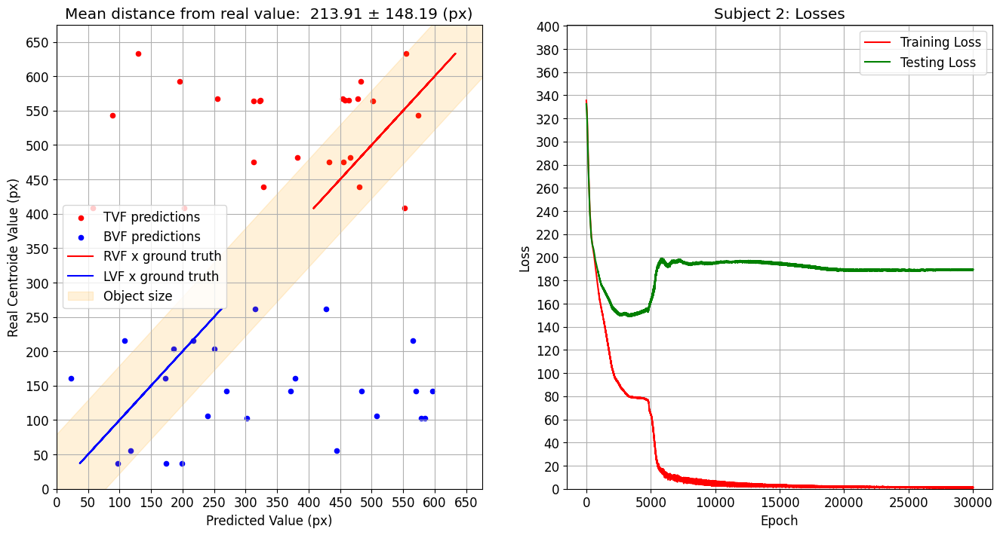

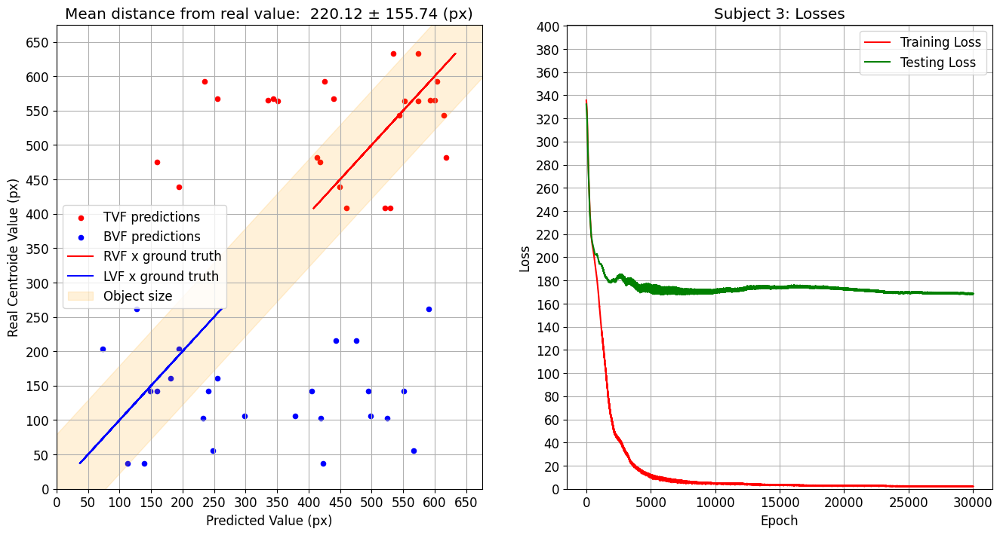

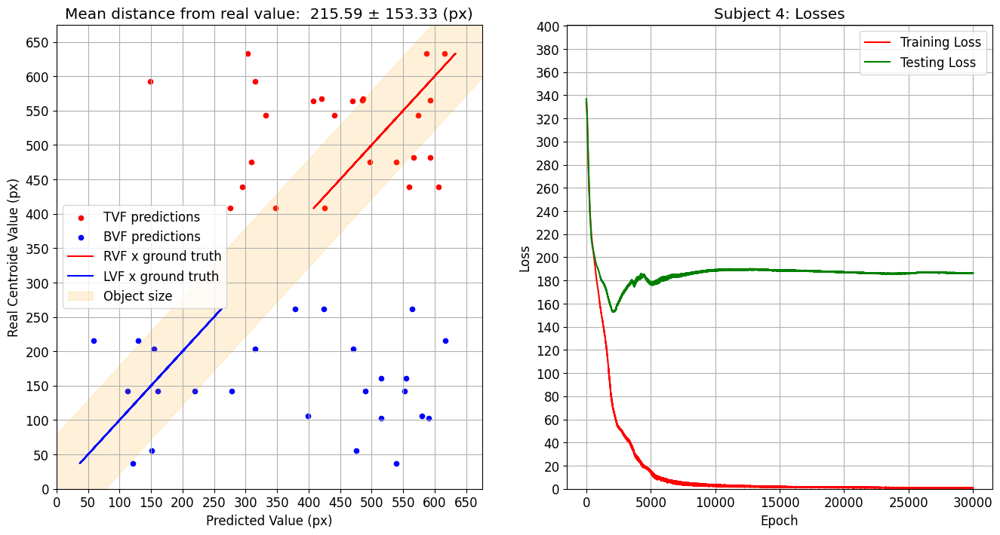

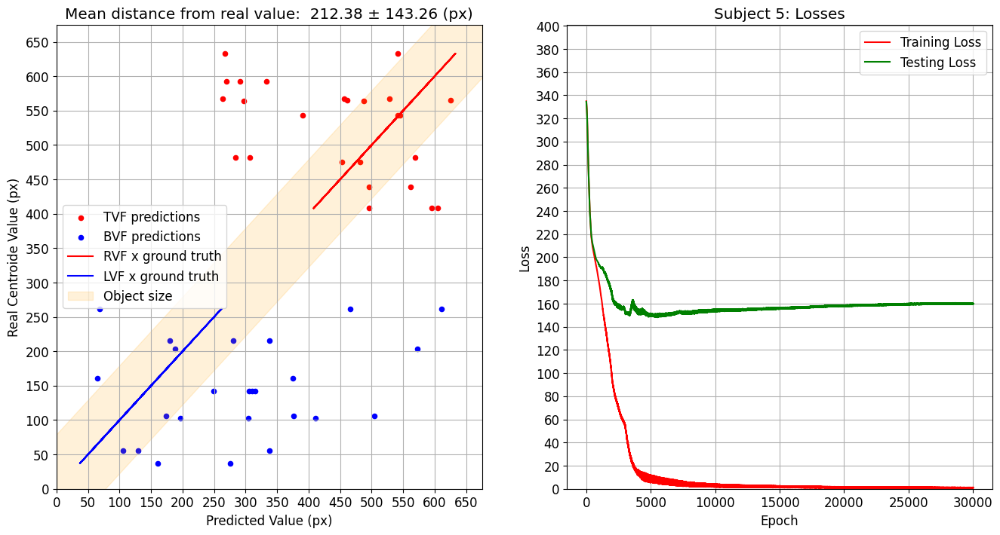

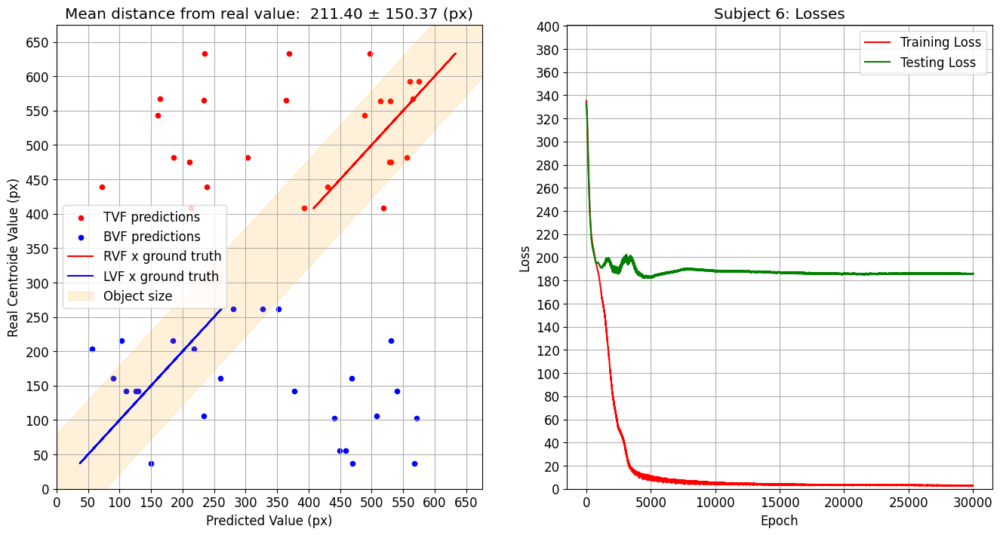

In [ ]:
all_distance = []

for subj in range(NUM_SUBJ):

    fig, axs = plt.subplots(nrows=1, ncols=2, figsize = (16,8))

    y_losses = np.linspace(0, dl_epochs, dl_epochs)

    plt.rcParams.update({'font.size': 12})

    ax = axs[0]

    y_preds = all_y_preds[subj].reshape(len(all_y_preds[subj]),)

    '''
    Absolute error: |True value - Measured Value|
    Relative error: |Absolute error / True value|
    Percent  error: Relative error * 100
    '''
    rel_error = (np.abs(all_real_y[subj] - all_y_preds[subj])/all_real_y[subj])*100
    distance = np.abs(all_real_y[subj] - all_y_preds[subj])

    all_distance.append(distance)

    TVF_real_y = [y for y in range(len(all_real_y[subj])) if all_real_y[subj][y] > IM_HEIGHT/2]
    BVF_real_y = [y for y in range(len(all_real_y[subj])) if all_real_y[subj][y] < IM_HEIGHT/2]

    # Scatter plots on the same axes
    ax.scatter(all_y_preds[subj][TVF_real_y], all_real_y[subj][TVF_real_y], color='r', label='TVF predictions',alpha=1, s=20);
    ax.scatter(all_y_preds[subj][BVF_real_y], all_real_y[subj][BVF_real_y], color='b', label='BVF predictions',alpha=1, s=20);

    plus_minus_symbol = chr(0x00B1)
    ax.set(xlabel='Predicted Value (px)', 
        xticks=np.arange(0, IM_WIDTH + 3, step = 50),
        xlim=(0, IM_WIDTH + 3),
        ylabel='Real Centroide Value (px)',
        yticks=np.arange(0, IM_WIDTH + 3, step = 50),
        ylim=(0, IM_WIDTH + 3),
        title=(f"Mean distance from real value: {np.mean(distance): .2f} {plus_minus_symbol}{np.std(distance): .2f} (px)"));
    ax.grid(True)

    ax.plot(all_real_y[subj][TVF_real_y], all_real_y[subj][TVF_real_y], 'r', alpha=1, label = 'RVF x ground truth') # Line plot
    ax.plot(all_real_y[subj][BVF_real_y], all_real_y[subj][BVF_real_y], 'b', alpha=1, label = 'LVF x ground truth') 

    diag_rect = patches.Rectangle(
        (min(all_real_y[subj]) - 50, (min(real_y))-(obj_region/2)/math.cos(math.radians(45)) - 50), 
                                    max(real_y) + 400, 
                                    obj_region, 
                                    linewidth=1, 
                                    edgecolor='orange', 
                                    facecolor='orange', 
                                    alpha=0.15, 
                                    angle=45, 
                                    label = 'Object size')
    
    ax.add_patch(diag_rect) # Patch plot

    ax.legend()

    ax = axs[1]

    ax.plot(x_losses, all_training_losses[subj], 'r', label = 'Training Loss')
    ax.plot(x_losses, all_testing_losses[subj], 'g', label = 'Testing Loss')
    ax.set(xlabel='Epoch',
            ylabel='Loss',
            yticks=np.arange(0, 401, step = 20),
            ylim=(0,401),
            title=(f"Subject {subj + 1}: Losses"));
    ax.legend(loc='upper right')
    ax.grid(True)
        
    plt.subplots_adjust(hspace=0.15)
    plt.show()

In [ ]:
print(f"Mean distance: {np.mean(all_distance): .02f} +/- {np.std(all_distance)}: .02f")

## Training and saving the best N2pcb model (All features)

In [ ]:
N2pcb_NN_models_Folder = "C:/Users/VascoRocha(1161216)/Desktop/Rocha/Models/N2pcb_NN_y_pos/"

# Create the folder (raises an error if it already exists)
try:
  os.mkdir(N2pcb_NN_models_Folder)
  print(f"Folder created successfully at: {N2pcb_NN_models_Folder}")
except FileExistsError:
  print(f"Folder already exists at: {N2pcb_NN_models_Folder}")

In [ ]:
all_training_losses = []

for subj in range(NUM_SUBJ):

  print(f"\n------------------ Subject {subj + 1}: Training model (N2pcb) ------------------")

  # Number of features

  train_featVect = np.vstack((all_NN_featVectRVF[subj], all_NN_featVectLVF[subj]))

  NUM_FEATURES = np.size(train_featVect[:, 0:-1],1) 

  # Fit the model
  torch.manual_seed(42)

  # Set number of epochs
  dl_epochs = 30000
      
  # Initializing model

  y_pos_model = N2pcbModel(input_features=NUM_FEATURES, 
                            output_features=1, 
                            hidden_units=32).to(device)

  loss_fn = nn.L1Loss()
  optimizer = torch.optim.SGD(y_pos_model.parameters(), 
                              lr=0.015,
                              momentum=0.095)

  # Shuffle

  np.random.seed(42)
  np.random.shuffle(train_featVect)

  # Tensor convertion
  tn_train_feat = torch.tensor(np.array(train_featVect[:, 0:-1])).type(torch.float32)
  tn_train_lbl = torch.tensor(np.array(train_featVect[:,-1])).type(torch.float32)

  # Feature wise normalization of feature vector
  n_entries, n_feat = tn_train_feat.size()

  for j in range(n_entries):

      mean = tn_train_feat[j,:].mean(dim=0)
      std = tn_train_feat[j,:].std(dim=0)
      tn_train_feat[j,:] = (tn_train_feat[j,:] - mean) / std

  training_losses = []

  for dl_epoch in range(dl_epochs):
      ### Training
      y_pos_model.train()

      # 1. Forward pass
      y_pos_ = y_pos_model(tn_train_feat)

      # 2. Calculate loss
      train_loss = loss_fn(torch.squeeze(y_pos_), tn_train_lbl) 
      training_losses.append(train_loss.detach().numpy())
    
      # 3. Optimizer zero grad
      optimizer.zero_grad()

      # 4. Loss backwards
      train_loss.backward()

      # 5. Optimizer step
      optimizer.step()

      # Print out what's happening
      if (dl_epoch + 1) % 2000 == 0:
          print(f"Epoch: {dl_epoch + 1} | Training Loss: {train_loss:.5f}")  
    
  all_training_losses.append(training_losses)

    # Save the entire model (state_dict and optimizer are optional)
  torch.save({f'y_pos_model_Subj{subj + 1}_state_dict': y_pos_model.state_dict(),  # Weights and biases
              f'optimizer_Subj{subj + 1}state_dict': optimizer.state_dict()}, # Optimizer to resume training later
              N2pcb_NN_models_Folder+f"y_pos_model_Subj{subj + 1}.pt") 
  

  del y_pos_model

# Signal analysis and Classification based on 4 quadrants: (RVF and TBF; RVF and TBF; LVF and TBF; LVF and TBF)

## Studying the effects of eccentricity in the P3 peak (Stimuli difficulty measure)

## Calculating the single trial N2pc for each quadrant

In [61]:
all_RVF_TVF_contralateral = []
all_RVF_TVF_ipsilateral = []

all_RVF_BVF_contralateral = []
all_RVF_BVF_ipsilateral = []

all_LVF_TVF_contralateral = []
all_LVF_TVF_ipsilateral = []

all_LVF_BVF_contralateral = []
all_LVF_BVF_ipsilateral = []

all_RVF_TVF_target = []
all_RVF_BVF_target = []
all_LVF_TVF_target = []
all_LVF_BVF_target = []

all_RVF_TVF_xy_pos = []
all_RVF_BVF_xy_pos = []
all_LVF_TVF_xy_pos = []
all_LVF_BVF_xy_pos = []

for subj in range(NUM_SUBJ):

    RVF_TVF_contralateral = []
    RVF_TVF_ipsilateral = []

    RVF_BVF_contralateral = []
    RVF_BVF_ipsilateral = []

    LVF_TVF_contralateral = []
    LVF_TVF_ipsilateral = []

    LVF_BVF_contralateral = []
    LVF_BVF_ipsilateral = []

    RVF_TVF_target = []
    RVF_BVF_target = []
    LVF_TVF_target = []
    LVF_BVF_target = []

    RVF_TVF_xy_pos = []
    RVF_BVF_xy_pos = []
    LVF_TVF_xy_pos = []
    LVF_BVF_xy_pos = []

    for trial in all_labelled_targets[subj]:
        if(trial[HORIZONTAL_CONDITION_COL] == "RVF" and trial[VERTICAL_CONDITION_COL] == "TVF"):

            RVF_TVF_contralateral.append(trial[DATA_COL][left_N2pc_ch_idx,:])
            RVF_TVF_ipsilateral.append(trial[DATA_COL][right_N2pc_ch_idx,:])

            RVF_TVF_target.append(trial[DATA_COL])

            RVF_TVF_xy_pos.append([trial[X_CENTROID_COL], trial[Y_CENTROID_COL]])

        elif(trial[HORIZONTAL_CONDITION_COL] == "RVF" and trial[VERTICAL_CONDITION_COL] == "BVF"):

            RVF_BVF_contralateral.append(trial[DATA_COL][left_N2pc_ch_idx,:])
            RVF_BVF_ipsilateral.append(trial[DATA_COL][right_N2pc_ch_idx,:])

            RVF_BVF_target.append(trial[DATA_COL])

            RVF_BVF_xy_pos.append([trial[X_CENTROID_COL], trial[Y_CENTROID_COL]])

        elif(trial[HORIZONTAL_CONDITION_COL] == "LVF" and trial[VERTICAL_CONDITION_COL] == "TVF"):

            LVF_TVF_contralateral.append(trial[DATA_COL][right_N2pc_ch_idx,:])
            LVF_TVF_ipsilateral.append(trial[DATA_COL][left_N2pc_ch_idx,:])

            LVF_TVF_target.append(trial[DATA_COL])

            LVF_TVF_xy_pos.append([trial[X_CENTROID_COL], trial[Y_CENTROID_COL]])

        elif(trial[HORIZONTAL_CONDITION_COL] == "LVF" and trial[VERTICAL_CONDITION_COL] == "BVF"):
            
            LVF_BVF_contralateral.append(trial[DATA_COL][right_N2pc_ch_idx,:])
            LVF_BVF_ipsilateral.append(trial[DATA_COL][left_N2pc_ch_idx,:])
            
            LVF_BVF_target.append(trial[DATA_COL])

            LVF_BVF_xy_pos.append([trial[X_CENTROID_COL], trial[Y_CENTROID_COL]])


    all_RVF_TVF_contralateral.append(RVF_TVF_contralateral)
    all_RVF_TVF_ipsilateral.append(RVF_TVF_ipsilateral)

    all_RVF_BVF_contralateral.append(RVF_BVF_contralateral)
    all_RVF_BVF_ipsilateral.append(RVF_BVF_ipsilateral)

    all_LVF_TVF_contralateral.append(LVF_TVF_contralateral)
    all_LVF_TVF_ipsilateral.append(LVF_TVF_ipsilateral)

    all_LVF_BVF_contralateral.append(LVF_BVF_contralateral)
    all_LVF_BVF_ipsilateral.append(LVF_BVF_ipsilateral)

    all_RVF_TVF_target.append(RVF_TVF_target)
    all_RVF_BVF_target.append(RVF_BVF_target)
    all_LVF_TVF_target.append(LVF_TVF_target)
    all_LVF_BVF_target.append(LVF_BVF_target)

    all_RVF_TVF_xy_pos.append(RVF_TVF_xy_pos)
    all_RVF_BVF_xy_pos.append(RVF_BVF_xy_pos)
    all_LVF_TVF_xy_pos.append(LVF_TVF_xy_pos)
    all_LVF_BVF_xy_pos.append(LVF_BVF_xy_pos)

print("Nº RVF | TVF: ", np.shape(all_RVF_TVF_target))
print("Nº RVF | BVF: ", np.shape(all_RVF_BVF_target))
print("Nº LVF | TVF: ", np.shape(all_LVF_TVF_target))
print("Nº LVF | BVF: ", np.shape(all_LVF_BVF_target))

Nº RVF | TVF:  (6, 40, 33, 1640)
Nº RVF | BVF:  (6, 40, 33, 1640)
Nº LVF | TVF:  (6, 40, 33, 1640)
Nº LVF | BVF:  (6, 40, 33, 1640)


## Grand-Averages

In [62]:
RVF_TVF_aver = np.mean(np.mean(np.array(all_RVF_TVF_contralateral) - np.array(all_RVF_TVF_ipsilateral), axis = 0), axis = 0)
RVF_BVF_aver = np.mean(np.mean(np.array(all_RVF_BVF_contralateral) - np.array(all_RVF_BVF_ipsilateral), axis = 0), axis = 0)
LVF_TVF_aver = np.mean(np.mean(np.array(all_LVF_TVF_contralateral) - np.array(all_LVF_TVF_ipsilateral), axis = 0), axis = 0)
LVF_BVF_aver = np.mean(np.mean(np.array(all_LVF_BVF_contralateral) - np.array(all_LVF_BVF_ipsilateral), axis = 0), axis = 0)

RVF_TVF_erp = np.mean(np.mean(all_RVF_TVF_target, axis = 0), axis = 0)
RVF_BVF_erp = np.mean(np.mean(all_RVF_BVF_target, axis = 0), axis = 0)
LVF_TVF_erp = np.mean(np.mean(all_LVF_TVF_target, axis = 0), axis = 0)
LVF_BVF_erp = np.mean(np.mean(all_LVF_BVF_target, axis = 0), axis = 0)

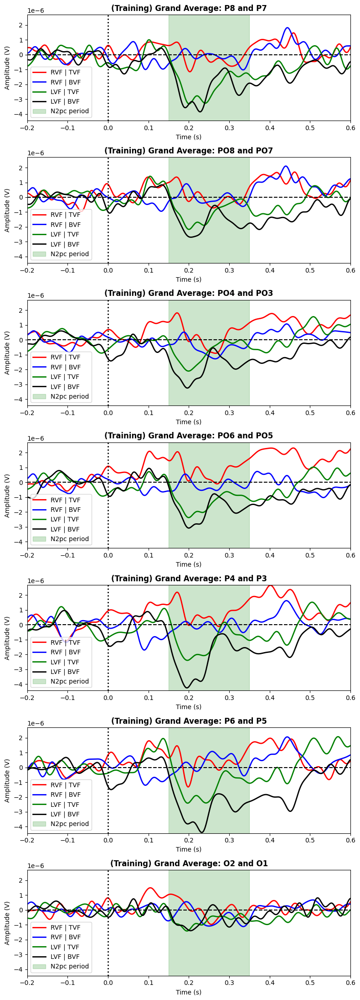

In [63]:
do_vlim = np.min(LVF_BVF_aver) * 1.01
up_vlim = np.max(RVF_TVF_aver) * 1.01

fig, ax = plt.subplots(nrows = len(left_N2pc_ch_idx), 
                                ncols = 1,
                                figsize=(8, 22))

for i in range(len(left_N2pc_ch_idx)):

    ax[i].plot(ERP_times, RVF_TVF_aver[i],'r', label = 'RVF | TVF', linewidth = 2)
    ax[i].plot(ERP_times, RVF_BVF_aver[i],'b', label = 'RVF | BVF', linewidth = 2)
    ax[i].plot(ERP_times, LVF_TVF_aver[i],'g', label = 'LVF | TVF', linewidth = 2)
    ax[i].plot(ERP_times, LVF_BVF_aver[i],'k', label = 'LVF | BVF', linewidth = 2)

    ax[i].set_xlim([np.min(ERP_times),np.max(ERP_times)])
    ax[i].set_ylim([do_vlim, up_vlim])

    N2pc_region = patches.Rectangle((0.15, -0.1), 0.2, 0.2, linewidth=1, edgecolor='g', facecolor='g', alpha=0.2, label = "N2pc period")    

    ax[i].add_patch(N2pc_region)

    ax[i].set_title(f"(Training) Grand Average: {clean_ch[right_N2pc_ch_idx[i]]} and {clean_ch[left_N2pc_ch_idx[i]]}", fontweight = 'bold')
    ax[i].set_xlabel('Time (s)')
    ax[i].set_ylabel('Amplitude (V)')

    ax[i].axvline(x=0, color = 'k', linestyle='dotted', linewidth = 2)
    ax[i].axhline(y=0, color = 'k', linestyle = 'dashed')

    ax[i].legend(loc='lower left')

plt.tight_layout()
plt.rcdefaults()
plt.show()

Max vlim:  1.7285322192941107e-06
Min vlim:  -1.677974525452236e-06


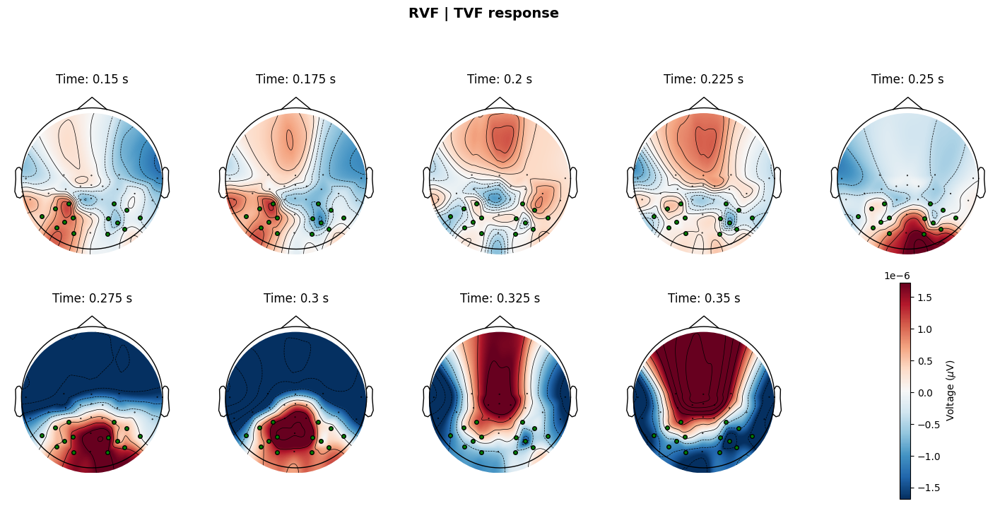

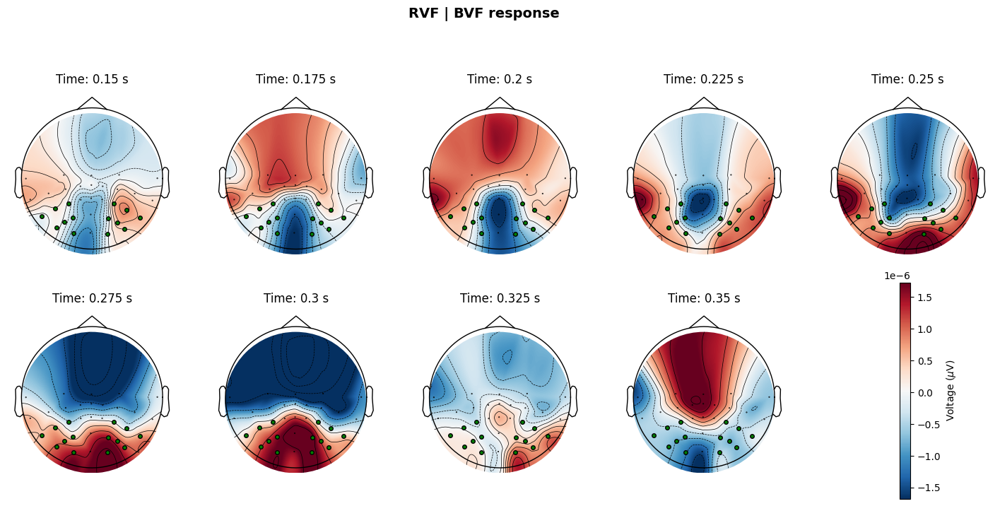

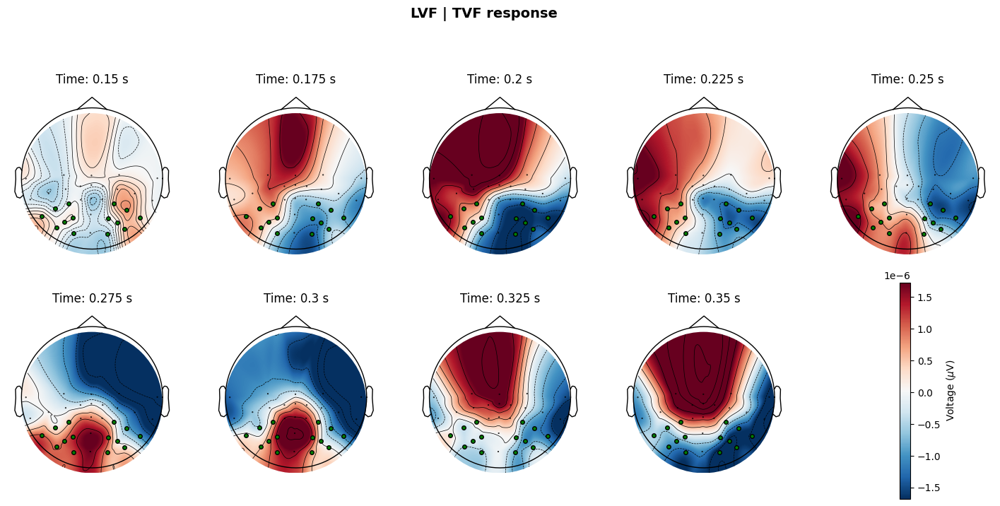

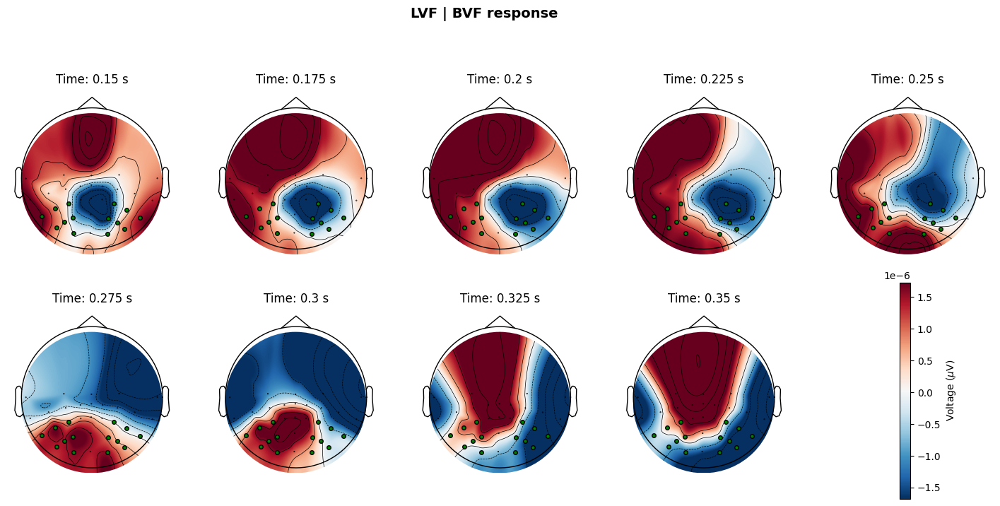

In [ ]:
vmap_max = np.max(LVF_TVF_erp[:,t_sample_start:t_sample_stop])
vmap_min = np.min(LVF_TVF_erp[:,t_sample_start:t_sample_stop])

print("Max vlim: ", vmap_max)
print("Min vlim: ", vmap_min)

t_win = 0.01

t_intervals = [0.15,
               0.175,
               0.2,
               0.225, 
               0.25, 
               0.275, 
               0.3, 
               0.325, 
               0.35, 
               0]  # ms

t_sample_start = np.argmin(np.abs(ERP_times - t_intervals[0]))
t_sample_stop = np.argmin(np.abs(ERP_times - t_intervals[-2]))

# ------------------------------------------------------ RVF | TVF ------------------------------------------------------

fig, axes = plt.subplots(nrows = 2, 
                         ncols = int(len(t_intervals)/2), 
                         figsize=(18, 8))

fig.suptitle("RVF | TVF response", fontweight = 'bold', fontsize=14)

for n, t_ms in enumerate(t_intervals):

    ax = axes.flat[n]

    if(n < len(t_intervals) - 1):

        ax.set_title(f"Time: {t_ms} s", fontsize=12)

        t_sample_start = np.argmin(np.abs(ERP_times - t_ms + t_win))
        t_sample_stop = np.argmin(np.abs(ERP_times - t_ms - t_win))
        
        dt = np.mean(RVF_TVF_erp[:,t_sample_start:t_sample_stop], axis = 1)

        im, cn = mne.viz.plot_topomap(dt,
                            rereferenced_EEGs[0].info,
                            contours = 10,
                            vlim = (vmap_min, vmap_max),
                            mask = np.array(highlight_ch),
                            mask_params = mk,
                            size = 10,
                            sphere = (0.0011, 0.015, 0.12, 0.2),
                            axes = ax,
                            show = False,
                            res = 1024)
        
    else:
        
        # Hide axis line
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)

        # Hide axis labels (optional)
        ax.set_xlabel('')
        ax.set_ylabel('')

        ax.set_xticks(ax.get_xticks())  # Get current xtick positions
        ax.set_xticklabels([])
        ax.set_yticks(ax.get_yticks())  # Get current xtick positions
        ax.set_yticklabels([])

        ax.tick_params(bottom = False, left = False, which='both')

        cax = fig.colorbar(im, ax = ax, fraction = 0.55)
        cax.set_label("Voltage ($\mu$V)")

plt.subplots_adjust(hspace=0.01) 
plt.show()

# ------------------------------------------------------ RVF | BVF ------------------------------------------------------

fig, axes = plt.subplots(nrows = 2, 
                         ncols = int(len(t_intervals)/2), 
                         figsize=(18, 8))

fig.suptitle("RVF | BVF response", fontweight='bold', fontsize=14)

for n, t_ms in enumerate(t_intervals):

    ax = axes.flat[n]

    if(n < len(t_intervals) - 1):

        ax.set_title(f"Time: {t_ms} s", fontsize=12)

        t_sample_start = np.argmin(np.abs(ERP_times - t_ms + t_win))
        t_sample_stop = np.argmin(np.abs(ERP_times - t_ms - t_win))
        
        dt = np.mean(RVF_BVF_erp[:,t_sample_start:t_sample_stop], axis = 1)
        
        im, cn = mne.viz.plot_topomap(dt,
                            rereferenced_EEGs[0].info,
                            contours = 10,
                            vlim = (vmap_min, vmap_max),
                            mask = np.array(highlight_ch),
                            mask_params = mk,
                            size = 10,
                            sphere = (0.0011, 0.015, 0.12, 0.2),
                            axes = ax,
                            show = False,
                            res = 1024)
    
    else:
        
        # Hide axis line
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)

        # Hide axis labels (optional)
        ax.set_xlabel('')
        ax.set_ylabel('')

        ax.set_xticks(ax.get_xticks())  # Get current xtick positions
        ax.set_xticklabels([])
        ax.set_yticks(ax.get_yticks())  # Get current xtick positions
        ax.set_yticklabels([])

        ax.tick_params(bottom = False, left = False, which='both')

        cax = fig.colorbar(im, ax = ax, fraction = 0.55)
        cax.set_label("Voltage ($\mu$V)")

plt.subplots_adjust(hspace=0.01)
plt.show()

# ------------------------------------------------------ LVF | TVF ------------------------------------------------------

fig, axes = plt.subplots(nrows = 2, 
                         ncols = int(len(t_intervals)/2), 
                         figsize=(18, 8))

fig.suptitle("LVF | TVF response", fontweight='bold', fontsize=14)

for n, t_ms in enumerate(t_intervals):

    ax = axes.flat[n]

    if(n < len(t_intervals) - 1):

        ax.set_title(f"Time: {t_ms} s", fontsize=12)

        t_sample_start = np.argmin(np.abs(ERP_times - t_ms + t_win))
        t_sample_stop = np.argmin(np.abs(ERP_times - t_ms - t_win))
        
        dt = np.mean(LVF_TVF_erp[:,t_sample_start:t_sample_stop], axis = 1)
        
        im, cn = mne.viz.plot_topomap(dt,
                            rereferenced_EEGs[0].info,
                            contours = 10,
                            vlim = (vmap_min, vmap_max),
                            mask = np.array(highlight_ch),
                            mask_params = mk,
                            size = 10,
                            sphere = (0.0011, 0.015, 0.12, 0.2),
                            axes = ax,
                            show = False,
                            res = 1024)
    
    else:
        
        # Hide axis line
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)

        # Hide axis labels (optional)
        ax.set_xlabel('')
        ax.set_ylabel('')

        ax.set_xticks(ax.get_xticks())  # Get current xtick positions
        ax.set_xticklabels([])
        ax.set_yticks(ax.get_yticks())  # Get current xtick positions
        ax.set_yticklabels([])

        ax.tick_params(bottom = False, left = False, which='both')

        cax = fig.colorbar(im, ax = ax, fraction = 0.55)
        cax.set_label("Voltage ($\mu$V)")

plt.subplots_adjust(hspace=0.01)
plt.show()

# ------------------------------------------------------ LVF | BVF ------------------------------------------------------

fig, axes = plt.subplots(nrows = 2, 
                         ncols = int(len(t_intervals)/2), 
                         figsize=(18, 8))

fig.suptitle("LVF | BVF response", fontweight='bold', fontsize=14)

for n, t_ms in enumerate(t_intervals):

    ax = axes.flat[n]

    if(n < len(t_intervals) - 1):

        ax.set_title(f"Time: {t_ms} s", fontsize=12)

        t_sample_start = np.argmin(np.abs(ERP_times - t_ms + t_win))
        t_sample_stop = np.argmin(np.abs(ERP_times - t_ms - t_win))
        
        dt = np.mean(LVF_BVF_erp[:,t_sample_start:t_sample_stop], axis = 1)
        
        im, cn = mne.viz.plot_topomap(dt,
                            rereferenced_EEGs[0].info,
                            contours = 10,
                            vlim = (vmap_min, vmap_max),
                            mask = np.array(highlight_ch),
                            mask_params = mk,
                            size = 10,
                            sphere = (0.0011, 0.015, 0.12, 0.2),
                            axes = ax,
                            show = False,
                            res = 1024)
    
    else:
        
        # Hide axis line
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)

        # Hide axis labels (optional)
        ax.set_xlabel('')
        ax.set_ylabel('')

        ax.set_xticks(ax.get_xticks())  # Get current xtick positions
        ax.set_xticklabels([])
        ax.set_yticks(ax.get_yticks())  # Get current xtick positions
        ax.set_yticklabels([])

        ax.tick_params(bottom = False, left = False, which='both')

        cax = fig.colorbar(im, ax = ax, fraction = 0.55)
        cax.set_label("Voltage ($\mu$V)")

plt.subplots_adjust(hspace=0.01)
plt.show()

## Handling the feature vectors

In [67]:
np.shape(RVF_TVF)

(7, 28)

In [69]:
all_featVectRVF_TVF = [] # Class label = 0
all_featVectRVF_BVF = [] # Class label = 1
all_featVectLVF_TVF = [] # Class label = 2
all_featVectLVF_BVF = [] # Class label = 3

all_NN_featVectRVF_TVF = [] 
all_NN_featVectRVF_BVF = [] 
all_NN_featVectLVF_TVF = [] 
all_NN_featVectLVF_BVF = [] 

ts = 0.15
te = 0.35

idx_s = np.argmin(np.abs(ERP_times - ts))
idx_e = np.argmin(np.abs(ERP_times - te))

# Resampling the resulting time window (Prevents overfitting)

RESAMPLE_FREQ = 64 # Hz
N_DATAPOINTS_ORIG_FREQ = len(ERP_times[idx_s:idx_e+1])
N_DATAPOINTS_RESA_FREQ = int(np.ceil((N_DATAPOINTS_ORIG_FREQ * RESAMPLE_FREQ)/fs)) + 1

_, _, n_channels, _ = np.shape(all_RVF_TVF_contralateral)

for subj in range(NUM_SUBJ):

    featVectRVF_TVF = [] 
    featVectRVF_BVF = []
    featVectLVF_TVF = [] 
    featVectLVF_BVF = [] 

    NN_featVectRVF_TVF = [] 
    NN_featVectRVF_BVF = [] 
    NN_featVectLVF_TVF = [] 
    NN_featVectLVF_BVF = [] 

    # ------------------------------------------------------ RVF | TVF ------------------------------------------------------

    for trial in range(np.size(RVF_TVF_contralateral, 0)):

        RVF_TVF1 = resample(all_RVF_TVF_contralateral[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
        RVF_TVF2 = resample(all_RVF_TVF_ipsilateral[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
        
        RVF_TVF = np.hstack((RVF_TVF1, RVF_TVF2))
        
        for c in range(1, n_channels):

            if (c == 1):
                auxRVF_TVF = np.hstack((RVF_TVF[c-1,:],RVF_TVF[c,:]))
            else:
                auxRVF_TVF = np.hstack((auxRVF_TVF,RVF_TVF[c,:]))

        featVectRVF_TVF.append(np.hstack((auxRVF_TVF, 0)))
        NN_featVectRVF_TVF.append(np.hstack((auxRVF_TVF, RVF_TVF_xy_pos[trial])))

    # ------------------------------------------------------ RVF | BVF ------------------------------------------------------

    for trial in range(np.size(RVF_BVF_contralateral, 0)):

        RVF_BVF1 = resample(all_RVF_BVF_contralateral[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
        RVF_BVF2 = resample(all_RVF_BVF_ipsilateral[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)

        RVF_BVF = np.hstack((RVF_BVF1, RVF_BVF2))
        
        for c in range(1, n_channels):

            if (c == 1):
                auxRVF_BVF = np.hstack((RVF_BVF[c-1,:],RVF_BVF[c,:]))
            else:
                auxRVF_BVF = np.hstack((auxRVF_BVF,RVF_BVF[c,:]))

        featVectRVF_BVF.append(np.hstack((auxRVF_BVF, 1)))
        NN_featVectRVF_BVF.append(np.hstack((auxRVF_BVF, RVF_BVF_xy_pos[trial])))

    # ------------------------------------------------------ LVF | TVF ------------------------------------------------------

    for trial in range(np.size(LVF_TVF_contralateral, 0)):

        LVF_TVF1 = resample(all_LVF_TVF_ipsilateral[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
        LVF_TVF2 = resample(all_LVF_TVF_contralateral[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
        
        LVF_TVF = np.hstack((LVF_TVF1, LVF_TVF2))

        for c in range(1, n_channels):

            if (c == 1):
                auxLVF_TVF = np.hstack((LVF_TVF[c-1,:],LVF_TVF[c,:]))
            else:
                auxLVF_TVF = np.hstack((auxLVF_TVF,LVF_TVF[c,:]))

        featVectLVF_TVF.append(np.hstack((auxLVF_TVF, 2)))
        NN_featVectLVF_TVF.append(np.hstack((auxLVF_TVF, LVF_TVF_xy_pos[trial])))

    # ------------------------------------------------------ LVF | BVF ------------------------------------------------------

    for trial in range(np.size(LVF_BVF_contralateral, 0)):

        LVF_BVF1 = resample(all_LVF_BVF_ipsilateral[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
        LVF_BVF2 = resample(all_LVF_BVF_contralateral[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
        
        LVF_BVF = np.hstack((LVF_BVF1, LVF_BVF2))

        for c in range(1, n_channels):

            if (c == 1):
                auxLVF_BVF = np.hstack((LVF_BVF[c-1,:],LVF_BVF[c,:]))
            else:
                auxLVF_BVF = np.hstack((auxLVF_BVF,LVF_BVF[c,:]))

        featVectLVF_BVF.append(np.hstack((auxLVF_BVF, 3)))
        NN_featVectLVF_BVF.append(np.hstack((auxLVF_BVF, LVF_BVF_xy_pos[trial])))

    all_featVectRVF_TVF.append(featVectRVF_TVF)
    all_featVectRVF_BVF.append(featVectRVF_BVF)
    all_featVectLVF_TVF.append(featVectLVF_TVF)
    all_featVectLVF_BVF.append(featVectLVF_BVF)

    all_NN_featVectRVF_TVF.append(NN_featVectRVF_TVF)
    all_NN_featVectRVF_BVF.append(NN_featVectRVF_BVF)
    all_NN_featVectLVF_TVF.append(NN_featVectLVF_TVF)
    all_NN_featVectLVF_BVF.append(NN_featVectLVF_BVF)

print(np.shape(all_featVectRVF_TVF))
print(np.shape(all_featVectRVF_BVF))
print(np.shape(all_featVectLVF_TVF))
print(np.shape(all_featVectLVF_BVF))

    

(6, 40, 197)
(6, 40, 197)
(6, 40, 197)
(6, 40, 197)


## Train/Test split

In [70]:
n_train = int(np.ceil(len(featVectRVF_TVF) * PERCENT_TRAIN))

all_train_featVect = []
all_test_featVect = []

for subj in range(NUM_SUBJ):

    train_featVect = np.vstack( (np.vstack( (np.vstack( (all_featVectRVF_TVF[subj][:n_train], all_featVectRVF_BVF[subj][:n_train]) ), all_featVectLVF_TVF[subj][:n_train]) ), all_featVectLVF_BVF[subj][:n_train]) )
    test_featVect = np.vstack( (np.vstack( (np.vstack( (all_featVectRVF_TVF[subj][n_train:], all_featVectRVF_BVF[subj][n_train:]) ), all_featVectLVF_TVF[subj][n_train:]) ), all_featVectLVF_BVF[subj][n_train:]) )

    np.random.seed(42)
    np.random.shuffle(train_featVect)
    np.random.seed(42)
    np.random.shuffle(test_featVect)

    all_train_featVect.append(train_featVect)
    all_test_featVect.append(test_featVect)


### Row-wise normalization of the feature vector

In [71]:
# Feature wise normalization of feature vector

all_norm_train_featVect = []
all_norm_test_featVect = []

ROW_WISE_NORM = True

for subj in range(NUM_SUBJ):

    if(ROW_WISE_NORM):  

        n_entries = np.size(all_train_featVect, 1)

        norm_train_featVect = []

        for j in range(n_entries):

            mean = np.mean(all_train_featVect[subj][j, 0:-1])
            std = np.std(all_train_featVect[subj][j, 0:-1])
            norm_train_featVect.append(np.hstack(((all_train_featVect[subj][j,0:-1] - mean) / std, all_train_featVect[subj][j, -1])))


        n_entries = np.size(all_test_featVect, 1)

        norm_test_featVect = []

        for u in range(n_entries):

            mean = np.mean(all_test_featVect[subj][u,0:-1])
            std = np.std(all_test_featVect[subj][u,0:-1])
            norm_test_featVect.append(np.hstack(((all_test_featVect[subj][u,0:-1] - mean) / std, all_test_featVect[subj][u, -1])))

        train_featVect = np.array(norm_train_featVect)
        test_featVect = np.array(norm_test_featVect)

    else:

        n_entries = np.size(all_train_featVect, 2) - 1

        norm_train_featVect = []

        for j in range(n_entries):

            mean = np.mean(all_train_featVect[subj][:, j])
            std = np.std(all_train_featVect[subj][:, j])
            norm_train_featVect.append(((all_train_featVect[subj][:, j] - mean)))

        n_entries = np.size(all_test_featVect, 2) - 1

        norm_test_featVect = []

        for u in range(n_entries):

            mean = np.mean(all_test_featVect[subj][:,u])
            std = np.std(all_test_featVect[subj][:,u])
            norm_test_featVect.append((all_test_featVect[subj][: ,u] - mean) / std)

        train_featVect = np.array(np.vstack((norm_train_featVect, all_train_featVect[subj][:, -1]))).T
        test_featVect = np.array(np.vstack((norm_test_featVect, all_test_featVect[subj][:, -1]))).T

    all_norm_train_featVect.append(train_featVect)
    all_norm_test_featVect.append(test_featVect)

print(np.shape(all_norm_train_featVect))
print(np.shape(all_norm_test_featVect))

(6, 120, 197)
(6, 40, 197)


## Mutual Based Information

In [74]:
k_feat = N_DATAPOINTS_RESA_FREQ * 7

all_best_feat_idx = []

for subj in range(NUM_SUBJ):

    best_feat_idx = SelectKBest(mutual_info_classif, k = k_feat).fit(all_norm_train_featVect[subj][:,0:-1], all_norm_train_featVect[subj][:,-1]).get_support()
    best_feat_idx = np.append(best_feat_idx, False) # False is because this field is reserved for the Class label and not a feature

    all_best_feat_idx.append(best_feat_idx)
    
print(np.shape(all_best_feat_idx))

(6, 197)


### Distribution of channel importance for classification

In [75]:
n_ch = len(right_N2pc_ch_idx) + len(left_N2pc_ch_idx)

all_tf = []

for subj in range(NUM_SUBJ):

    tf = np.zeros(n_ch)
    cont = np.ones(N_DATAPOINTS_RESA_FREQ)

    for i in range(n_ch):
        tf[i] = (np.sum(cont[all_best_feat_idx[subj][i*N_DATAPOINTS_RESA_FREQ:i*N_DATAPOINTS_RESA_FREQ+N_DATAPOINTS_RESA_FREQ]]))

    all_tf.append(tf)

print(np.shape(all_tf))

(6, 14)


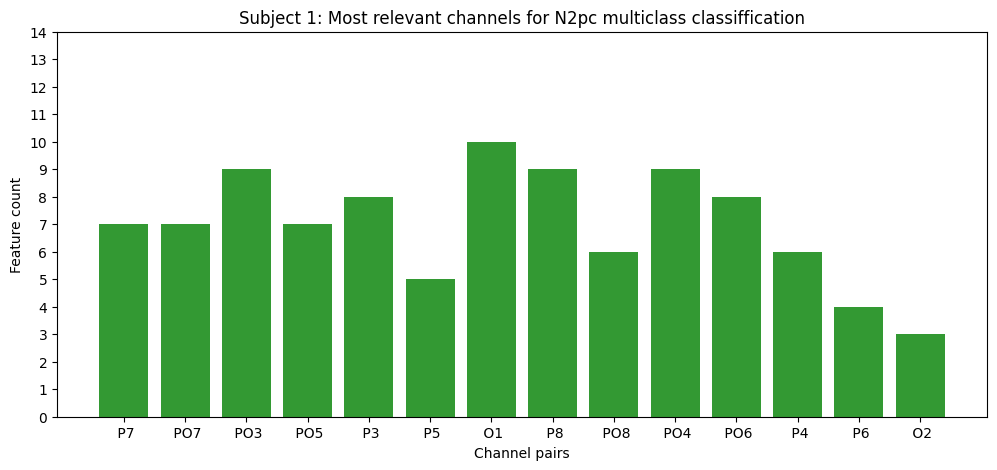

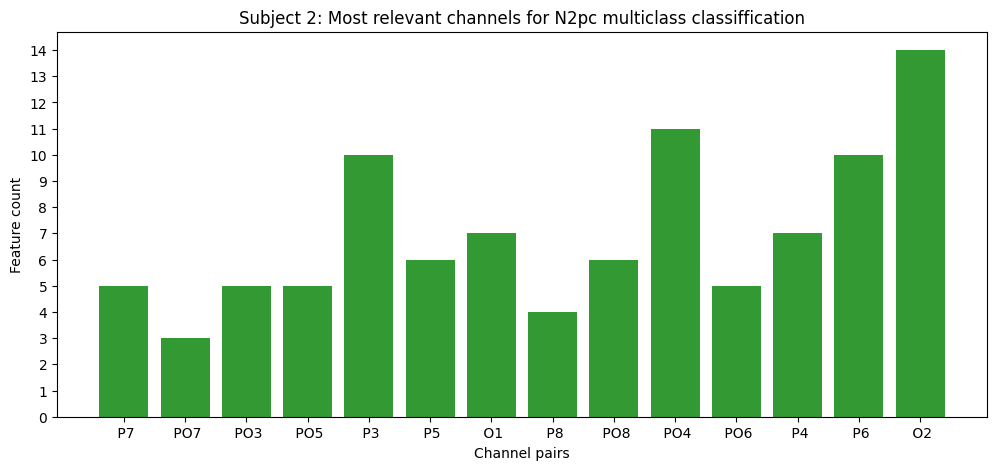

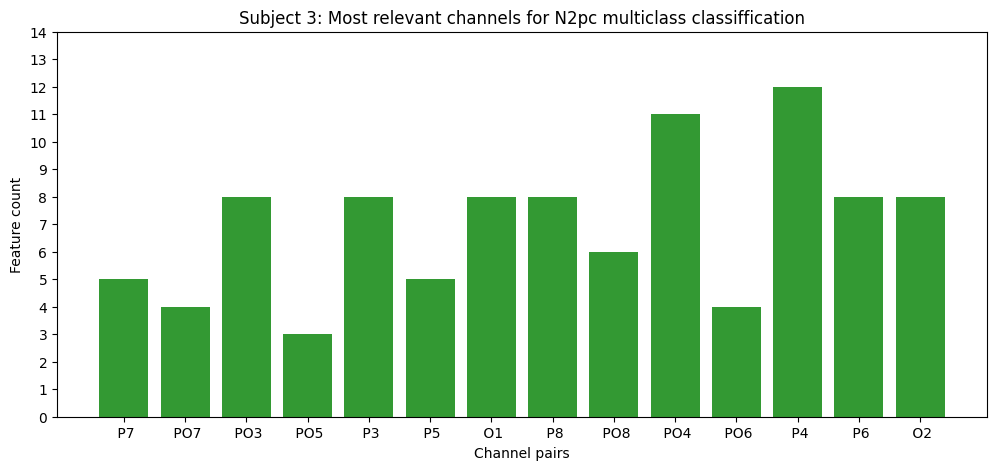

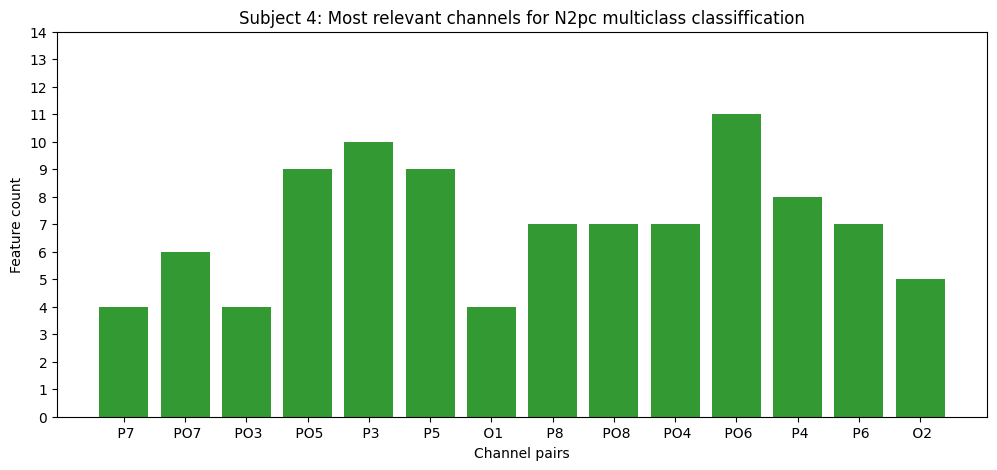

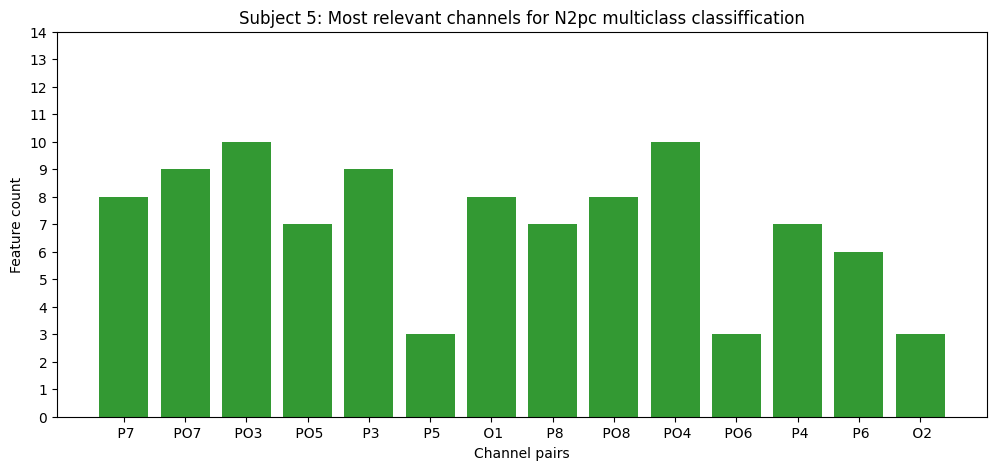

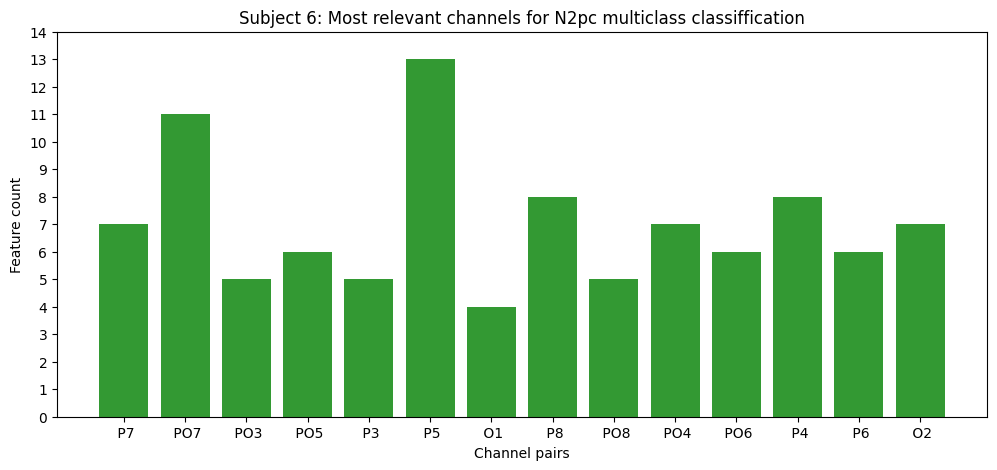

In [76]:
max_y = np.max(all_tf)

for subj in range(NUM_SUBJ):

    customlb = []
    for c, lb in enumerate(left_N2pc_channels):
        customlb.append(str(lb))


    for c, lb in enumerate(right_N2pc_channels):
       customlb.append(str(lb))
        

    fig, ax = plt.subplots(figsize=(12, 5))
    plt.rcParams.update({'font.size': 10})

    ax.set_title(f'Subject {subj +1}: Most relevant channels for N2pc multiclass classiffication')

    ax.bar(np.arange(1, n_ch + 1), 
           all_tf[subj], 
           color="g", 
           capsize=4, 
           alpha = 0.8)
    
    ax.set(xticks=np.arange(1, n_ch + 1), 
           xlabel='Channel pairs', 
           yticks=np.arange(0, max_y + 1, step=1),
           ylabel = "Feature count")
    
    ax.set_xticklabels(customlb);

    plt.show();

### Selecting the most relevant channel for classification

In [77]:
all_best_channel_feat_idx = []

for subj in range(NUM_SUBJ):

    best_channel_feat_idx = np.zeros(len(best_feat_idx))

    for i in range(len(tf)):
        if(all_tf[subj][i] >= sorted(all_tf[subj], reverse = True)[6]):
            best_channel_feat_idx[i * N_DATAPOINTS_RESA_FREQ:i * N_DATAPOINTS_RESA_FREQ + N_DATAPOINTS_RESA_FREQ] = 1
        else:
            best_channel_feat_idx[i * N_DATAPOINTS_RESA_FREQ: i * N_DATAPOINTS_RESA_FREQ + N_DATAPOINTS_RESA_FREQ] = 0

    best_channel_feat_idx = best_channel_feat_idx != 0 # Convert to boolean

    all_best_channel_feat_idx.append(best_channel_feat_idx)

## Classification (One Versus the Rest) with most discriminative channel selection

In [78]:
from sklearn.multiclass import OneVsRestClassifier

print("========================== Most discriminative channels ==========================\n")

perSubj_cross_val_scores = np.zeros((NUM_SUBJ, 5, 2))
perSubj_accuracy = np.zeros((NUM_SUBJ, 5)) # 5 Classifiers
perSubj_auc_scores = np.zeros((NUM_SUBJ, 5))
perSubj_fitting_periods = np.zeros((NUM_SUBJ, 5))

for subj in range(NUM_SUBJ):

    print(f"\n------------------ Subject {subj + 1}: Classifying RVF vs LVF vs TVF vs BVF ------------------\n")

    for c_count, clf in enumerate(classifiers):

        print(f"\n------------------ Classifier: {clf} ------------------")

        bidirect_n2pc_clf = clf

        # --------- Cross Validation Scores ---------
        cross_val_scores, best_bidirect_n2pc_clf = GridSearch(classifier_params[c_count], 
                                                               bidirect_n2pc_clf, 
                                                               KFOLD, 
                                                               all_norm_train_featVect[subj][:,all_best_channel_feat_idx[subj]],
                                                               all_norm_train_featVect[subj][:,-1])
        
        perSubj_cross_val_scores[subj, c_count, 0] = cross_val_scores[0]
        perSubj_cross_val_scores[subj, c_count, 1] = cross_val_scores[1]
        perSubj_fitting_periods[subj, c_count] = cross_val_scores[2]

        # --------- Predictions ---------
        pred = best_bidirect_n2pc_clf.predict(all_norm_test_featVect[subj][:, all_best_channel_feat_idx[subj]])
        perSubj_accuracy[subj, c_count] = round(accuracy_score(all_norm_test_featVect[subj][:, -1], pred), 2) * 100

        # Compute AUC for each subject
        perSubj_auc_scores[subj, c_count] = round(roc_auc_score(all_norm_test_featVect[subj][:, -1], best_bidirect_n2pc_clf.predict_proba(all_norm_test_featVect[subj][:, all_best_channel_feat_idx[subj]]), multi_class= 'ovr'), 2)

        del bidirect_n2pc_clf, best_bidirect_n2pc_clf # Ensures no mixing of classifiers within the loop



========================== Most discriminative channels ==========================


------------------ Subject 1: Classifying RVF vs LVF vs TVF vs BVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'scale', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.41666666666666663

Running Grid Search for method: poly

Best parameters: {'C': 0.001, 'cache_size': 200, 'degree': 3, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.4083333333333333

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.41666666666666663

------------------ Classifier: LinearDiscriminantAnalysis() ------------------

Running Grid Search for method: svd

Best parameters: {'solver': 'svd'}
Best score: 0.37499999999999994


C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 1.0, 'n_estimators': 200, 'random_state': 42}
Best score: 0.3583333333333333

------------------ Subject 2: Classifying RVF vs LVF vs TVF vs BVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: rbf

Best parameters: {'C': 0.001, 'cache_size': 200, 'gamma': 'scale', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.35833333333333334

Running Grid Search for method: poly

Best parameters: {'C': 1, 'cache_size': 200, 'degree': 2, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.35

Running Grid Search for method: sigmoid

Best parameters: {'C': 0.001, 'cache_size': 200, 'gamma': 10, 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.375

------------------ Classifier: LinearDiscriminantAnalysis() ------------------

Running Grid Search for method: svd

Best parameters: {'solver': 'svd'}
Best score: 0.2583333333333333



C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.5, 'n_estimators': 200, 'random_state': 42}
Best score: 0.2833333333333333

------------------ Subject 3: Classifying RVF vs LVF vs TVF vs BVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.4333333333333334

Running Grid Search for method: poly

Best parameters: {'C': 10, 'cache_size': 200, 'degree': 3, 'gamma': 'scale', 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.4583333333333333

Running Grid Search for method: sigmoid

Best parameters: {'C': 10, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.01}
Best score: 0.4916666666666667

------------------ Classifier: LinearDiscriminantAnalysis() ------------------

Running Grid Search for method: svd

Best parameters: {'solver': 'svd'}
Best sc

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 1.0, 'n_estimators': 200, 'random_state': 42}
Best score: 0.4333333333333333

------------------ Subject 4: Classifying RVF vs LVF vs TVF vs BVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: rbf

Best parameters: {'C': 0.001, 'cache_size': 200, 'gamma': 'scale', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.4583333333333333

Running Grid Search for method: poly

Best parameters: {'C': 0.001, 'cache_size': 200, 'degree': 3, 'gamma': 0.1, 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.4416666666666666

Running Grid Search for method: sigmoid

Best parameters: {'C': 0.001, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.4416666666666667

------------------ Classifier: LinearDiscriminantAnalysis() ------------------

Running Grid Search for method: svd

Best parameters: {'solver': 'svd'}
B

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.1, 'n_estimators': 100, 'random_state': 42}
Best score: 0.375

------------------ Subject 5: Classifying RVF vs LVF vs TVF vs BVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: rbf

Best parameters: {'C': 10, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.375

Running Grid Search for method: poly

Best parameters: {'C': 10, 'cache_size': 200, 'degree': 3, 'gamma': 'scale', 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.33333333333333337

Running Grid Search for method: sigmoid

Best parameters: {'C': 10, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.01}
Best score: 0.5166666666666667

------------------ Classifier: LinearDiscriminantAnalysis() ------------------

Running Grid Search for method: svd

Best parameters: {'solver': 'svd'}
Best score: 0.2833333333333333


C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 1.0, 'n_estimators': 100, 'random_state': 42}
Best score: 0.3666666666666667

------------------ Subject 6: Classifying RVF vs LVF vs TVF vs BVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: rbf

Best parameters: {'C': 0.001, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.375

Running Grid Search for method: poly

Best parameters: {'C': 0.001, 'cache_size': 200, 'degree': 3, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.36666666666666664

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.01}
Best score: 0.3833333333333333

------------------ Classifier: LinearDiscriminantAnalysis() ------------------

Running Grid Search for method: svd

Best parameters: {'solver': 'svd'}
Best score: 0.

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 1.0, 'n_estimators': 200, 'random_state': 42}
Best score: 0.325


#### Cross-Validation Training Classification differences between classifiers (N2pc - Most dicriminative channels)

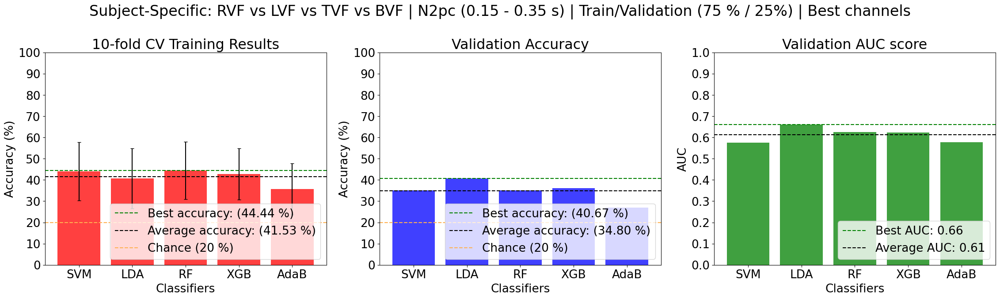

In [80]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 3,
                       figsize=(23, 7))

fig.suptitle(f'Subject-Specific: RVF vs LVF vs TVF vs BVF | N2pc ({ts} - {te} s) | Train/Validation (75 % / 25%) | Best channels', fontsize=24)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 19})
ax[0].bar(np.arange(1, 6), 
       np.mean(perSubj_cross_val_scores[:,:,0], axis = 0 ), 
       color="red", 
       yerr = np.mean(perSubj_cross_val_scores[:,:,1], axis = 0), 
       capsize=3,
       alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(np.mean(perSubj_cross_val_scores[:,:,0], axis = 0)), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(np.mean(perSubj_cross_val_scores[:,:,0], axis = 0)):.2f} %)')

ax[0].axhline(y = np.mean(perSubj_cross_val_scores[:,:,0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(perSubj_cross_val_scores[:,:,0]):.2f} %)')

ax[0].axhline(y=20, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (20 %)')

ax[0].set(xticks = np.arange(1, 5 + 1), 
       xticklabels = class_list,
       xlabel = 'Classifiers', 
       yticks=np.arange(0, 101, step=10), ylabel='Accuracy (%)',
       title=f'{KFOLD}-fold CV Training Results');

ax[0].legend(loc='lower right');


# -------------- Prediction Accuracy --------------

ax[1].bar(np.arange(1, 6), 
          np.mean(perSubj_accuracy, axis = 0 ), 
          color="b",
          alpha = 0.75)

ax[1].set_title('Accuracy (%)')

ax[1].axhline(y = max(np.mean(perSubj_accuracy, axis = 0)), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(np.mean(perSubj_accuracy, axis = 0)):.2f} %)')

ax[1].axhline(y = np.mean(perSubj_accuracy), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy):.2f} %)')

ax[1].axhline(y=20, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (20 %)')

ax[1].set(xticks = np.arange(1, 5 + 1), 
          xticklabels = class_list,
          xlabel = 'Classifiers', 
          yticks=np.arange(0, 101, step=10), ylabel='Accuracy (%)',
          title="Validation Accuracy");

ax[1].legend(loc='lower right');


# -------------- Aread Under the Curve (AUC) --------------

ax[2].bar(np.arange(1, 6), 
          np.mean(perSubj_auc_scores, axis = 0 ), 
          color="g",
          alpha = 0.75)

ax[2].set_title('AUC ')

ax[2].axhline(y = max(np.mean(perSubj_auc_scores, axis = 0)), 
              color='green', linestyle='--', 
              label = f'Best AUC: {max(np.mean(perSubj_auc_scores, axis = 0)):.2f}')

ax[2].axhline(y = np.mean(perSubj_auc_scores), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: {np.mean(perSubj_auc_scores):.2f}')

ax[2].set(xticks = np.arange(1, 5 + 1), 
          xticklabels = class_list,
          xlabel = 'Classifiers', 
          yticks=np.arange(0, 1.01, step=0.1), ylabel='AUC',
          title="Validation AUC score");

ax[2].legend(loc='lower right');
plt.tight_layout()

#### Best classifier Cross-Validation Training accuracies for all subjects (N2pcb - Most dicriminative channels)

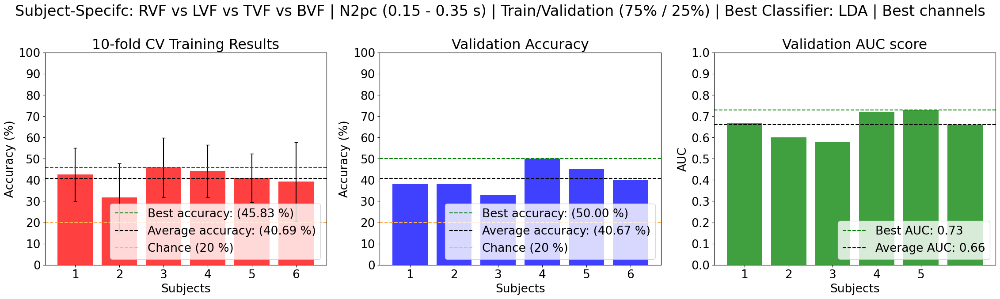

In [81]:
best_classifier = np.argmax(np.mean(perSubj_accuracy, axis = 0))

fig, ax = plt.subplots(nrows = 1,
                       ncols = 3,
                       figsize=(23, 7))

fig.suptitle(f'Subject-Specifc: RVF vs LVF vs TVF vs BVF | N2pc ({ts} - {te} s) | Train/Validation (75% / 25%) | Best Classifier: {class_list[best_classifier]} | Best channels', fontsize=24)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 19})
ax[0].bar(np.arange(1, NUM_SUBJ + 1), 
       perSubj_cross_val_scores[:,best_classifier, 0], 
       color="red", 
       yerr = perSubj_cross_val_scores[:,best_classifier, 1], 
       capsize=3,
       alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(perSubj_cross_val_scores[:,best_classifier, 0]), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(perSubj_cross_val_scores[:,best_classifier, 0]):.2f} %)')

ax[0].axhline(y = np.mean(perSubj_cross_val_scores[:,best_classifier, 0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(perSubj_cross_val_scores[:,best_classifier, 0]):.2f} %)')

ax[0].axhline(y=20, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (20 %)')

ax[0].set(xticks = np.arange(1, NUM_SUBJ + 1), 
         xlabel = 'Subjects', 
         yticks=np.arange(0, 101, step=10), 
         ylabel='Accuracy (%)',
         title=f'{KFOLD}-fold CV Training Results');

ax[0].legend(loc='lower right');


# -------------- Prediction Accuracy --------------

ax[1].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_accuracy[:,best_classifier], 
          color="b",
          alpha = 0.75)

ax[1].set_title('Accuracy (%)')

ax[1].axhline(y = max(perSubj_accuracy[:,best_classifier]), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(perSubj_accuracy[:,best_classifier]):.2f} %)')

ax[1].axhline(y = np.mean(perSubj_accuracy[:,best_classifier]), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy[:,best_classifier]):.2f} %)')

ax[1].axhline(y=20, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (20 %)')

ax[1].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 101, step=10), 
          ylabel='Accuracy (%)',
          title="Validation Accuracy");

ax[1].legend(loc='lower right');


# -------------- Aread Under the Curve (AUC) --------------

ax[2].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_auc_scores[:, best_classifier], 
          color="g",
          alpha = 0.75)

ax[2].set_title('AUC ')

ax[2].axhline(y = max(perSubj_auc_scores[:, best_classifier]), 
              color='green', linestyle='--', 
              label = f'Best AUC: {max(perSubj_auc_scores[:, best_classifier]):.2f}')

ax[2].axhline(y = np.mean(perSubj_auc_scores[:, best_classifier]), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: {np.mean(perSubj_auc_scores[:, best_classifier]):.2f}')

ax[2].set(xticks = np.arange(1, 5 + 1), 
          xlabel = 'Subjects', 
          yticks=np.arange(0, 1.01, step=0.1), ylabel='AUC',
          title="Validation AUC score");

ax[2].legend(loc='lower right');
plt.tight_layout()

#### Saving the best models (N2pc - 4 quadrants - Most discriminative channels)

In [ ]:
N2pc_4quad_bestElec_Folder = "C:/Users/VascoRocha(1161216)/Desktop/Rocha/Models/SS_4Quadrant_N2pc_BestElectrodesIndices/"

# Create the folder (raises an error if it already exists)
try:
  os.mkdir(N2pc_4quad_bestElec_Folder)
  print(f"Folder created successfully at: {N2pc_4quad_bestElec_Folder}")
except FileExistsError:
  print(f"Folder already exists at: {N2pc_4quad_bestElec_Folder}")

N2pc_4quad_bestFeat_models_Folder = "C:/Users/VascoRocha(1161216)/Desktop/Rocha/Models/SS_4Quadrant_N2pc_BestElectrodes/"

# Create the folder (raises an error if it already exists)
try:
  os.mkdir(N2pc_4quad_bestFeat_models_Folder)
  print(f"Folder created successfully at: {N2pc_4quad_bestFeat_models_Folder}")
except FileExistsError:
  print(f"Folder already exists at: {N2pc_4quad_bestFeat_models_Folder}")

In [ ]:
perSubj_optim_params = []

In [ ]:
bestModel_Subj_cross_val_scores = np.zeros((NUM_SUBJ, 2))

for subj in range(NUM_SUBJ):

    train = np.vstack((all_norm_train_featVect[subj], 
                       all_norm_test_featVect[subj])) # All data stacked

    np.random.seed(42)
    np.random.shuffle(train)

    # -------------------------- RandomForest --------------------------
    best_bidirect_n2pc_clf = RandomForestClassifier()
    best_bidirect_n2pc_clf.set_params(**perSubj_optim_params[subj])

    # --------- Cross Validation Scores ---------
    scores = cross_val_score(best_bidirect_n2pc_clf, 
                             train[:, all_best_channel_feat_idx[subj]], 
                             train[:, -1], 
                             cv = KFOLD)
    
    bestModel_Subj_cross_val_scores[subj, 0] = (scores.mean() * 100)
    bestModel_Subj_cross_val_scores[subj, 1] = (scores.std() * 100)

    # --------- Train Model ---------
    best_bidirect_n2pc_clf.fit(train[:, all_best_channel_feat_idx[subj]], 
                               train[:, -1])
    
    #joblib.dump(all_best_channel_feat_idx[subj], f'{N2pc_4quad_bestElec_Folder}Subj_0{subj + 1}_N2pc_4Quad_bestElec.pkl')
    #joblib.dump(best_bidirect_n2pc_clf, f'{N2pc_4quad_bestFeat_models_Folder}Subj_0{subj + 1}_N2pc_4Quad_model.pkl')
    
    del best_bidirect_n2pc_clf

NameError: name 'perSubj_optim_params' is not defined

## All channels 

In [ ]:
print("========================== All features ==========================\n")

perSubj_cross_val_scores = np.zeros((NUM_SUBJ, 5, 2))
perSubj_accuracy = np.zeros((NUM_SUBJ, 5)) # 5 Classifiers
perSubj_auc_scores = np.zeros((NUM_SUBJ, 5))
perSubj_fitting_periods = np.zeros((NUM_SUBJ, 5))

for subj in range(NUM_SUBJ):

    print(f"\n------------------ Subject {subj + 1}: Classifying RVF vs LVF vs TVF vs BVF ------------------\n")

    for c_count, clf in enumerate(classifiers):

        print(f"\n------------------ Classifier: {clf} ------------------")

        bidirect_n2pc_clf = clf

        # --------- Cross Validation Scores ---------
        cross_val_scores, best_bidirect_n2pc_clf = GridSearch(classifier_params[c_count], 
                                                               bidirect_n2pc_clf, 
                                                               KFOLD, 
                                                               all_norm_train_featVect[subj][:,0:-1],
                                                               all_norm_train_featVect[subj][:,-1])
        
        perSubj_cross_val_scores[subj, c_count, 0] = cross_val_scores[0]
        perSubj_cross_val_scores[subj, c_count, 1] = cross_val_scores[1]
        perSubj_fitting_periods[subj, c_count] = cross_val_scores[2]

        # --------- Predictions ---------
        pred = best_bidirect_n2pc_clf.predict(all_norm_test_featVect[subj][:, 0:-1])
        perSubj_accuracy[subj, c_count] = round(accuracy_score(all_norm_test_featVect[subj][:, -1], pred), 2) * 100

        # Compute AUC for each subject
        perSubj_auc_scores[subj, c_count] = round(roc_auc_score(all_norm_test_featVect[subj][:, -1], best_bidirect_n2pc_clf.predict_proba(all_norm_test_featVect[subj][:, 0:-1]), multi_class = 'ovr'), 2)

        del bidirect_n2pc_clf, best_bidirect_n2pc_clf # Ensures no mixing of classifiers within the loop


========================== All features ==========================


------------------ Subject 1: Classifying RVF vs LVF vs TVF vs BVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.1, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.4083333333333333

Running Grid Search for method: rbf

Best parameters: {'C': 0.001, 'cache_size': 200, 'gamma': 1, 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.3916666666666667

Running Grid Search for method: poly

Best parameters: {'C': 0.001, 'cache_size': 200, 'degree': 3, 'gamma': 0.1, 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.4166666666666667

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.38333333333333336

------------------ Classifier: Lin

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.1, 'n_estimators': 100, 'random_state': 42}
Best score: 0.3416666666666667

------------------ Subject 2: Classifying RVF vs LVF vs TVF vs BVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.001, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.33333333333333337

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.35833333333333334

Running Grid Search for method: poly

Best parameters: {'C': 0.001, 'cache_size': 200, 'degree': 2, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.36666666666666664

Running Grid Search for method: sigmoid

Best parameters: {'C': 0.001, 'cache_size': 200, 'gamma': 1, 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.3

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.1, 'n_estimators': 50, 'random_state': 42}
Best score: 0.30000000000000004

------------------ Subject 3: Classifying RVF vs LVF vs TVF vs BVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 1, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.001}
Best score: 0.5

Running Grid Search for method: rbf

Best parameters: {'C': 10, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.01}
Best score: 0.45

Running Grid Search for method: poly

Best parameters: {'C': 0.001, 'cache_size': 200, 'degree': 3, 'gamma': 0.1, 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.45

Running Grid Search for method: sigmoid

Best parameters: {'C': 10, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.01}
Best score: 0.4833333333333333

------------------ Classifier:

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.5, 'n_estimators': 50, 'random_state': 42}
Best score: 0.4666666666666667

------------------ Subject 4: Classifying RVF vs LVF vs TVF vs BVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.001, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.4

Running Grid Search for method: rbf

Best parameters: {'C': 0.001, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.425

Running Grid Search for method: poly

Best parameters: {'C': 1, 'cache_size': 200, 'degree': 3, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.425

Running Grid Search for method: sigmoid

Best parameters: {'C': 0.001, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.4

------------------ Classifier: LinearD

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 1.0, 'n_estimators': 200, 'random_state': 42}
Best score: 0.3666666666666666

------------------ Subject 5: Classifying RVF vs LVF vs TVF vs BVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.001, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.45

Running Grid Search for method: rbf

Best parameters: {'C': 10, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.425

Running Grid Search for method: poly

Best parameters: {'C': 0.001, 'cache_size': 200, 'degree': 3, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.36666666666666664

Running Grid Search for method: sigmoid

Best parameters: {'C': 0.001, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.45

------------------ C

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 1.0, 'n_estimators': 100, 'random_state': 42}
Best score: 0.4

------------------ Subject 6: Classifying RVF vs LVF vs TVF vs BVF ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.01, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.001}
Best score: 0.375

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.3833333333333333

Running Grid Search for method: poly

Best parameters: {'C': 0.001, 'cache_size': 200, 'degree': 2, 'gamma': 1, 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.2916666666666667

Running Grid Search for method: sigmoid

Best parameters: {'C': 10, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.37500000000000006

----------------

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.1, 'n_estimators': 100, 'random_state': 42}
Best score: 0.38333333333333336


#### Cross-Validation Training Classification differences between classifiers (N2pc - All channels)

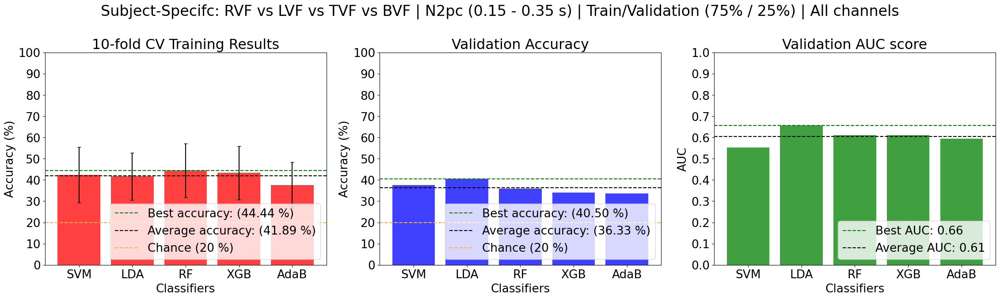

In [ ]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 3,
                       figsize=(23, 7))

fig.suptitle(f'Subject-Specifc: RVF vs LVF vs TVF vs BVF | N2pc ({ts} - {te} s) | Train/Validation (75% / 25%) | All channels', fontsize=24)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 19})
ax[0].bar(np.arange(1, 6), 
       np.mean(perSubj_cross_val_scores[:,:,0], axis = 0 ), 
       color="red", 
       yerr = np.mean(perSubj_cross_val_scores[:,:,1], axis = 0), 
       capsize=3,
       alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(np.mean(perSubj_cross_val_scores[:,:,0], axis = 0)), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(np.mean(perSubj_cross_val_scores[:,:,0], axis = 0)):.2f} %)')

ax[0].axhline(y = np.mean(perSubj_cross_val_scores[:,:,0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(perSubj_cross_val_scores[:,:,0]):.2f} %)')

ax[0].axhline(y=20, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (20 %)')

ax[0].set(xticks = np.arange(1, 5 + 1), 
       xticklabels = class_list,
       xlabel = 'Classifiers', 
       yticks=np.arange(0, 101, step=10), ylabel='Accuracy (%)',
       title=f'{KFOLD}-fold CV Training Results');

ax[0].legend(loc='lower right');


# -------------- Prediction Accuracy --------------

ax[1].bar(np.arange(1, 6), 
          np.mean(perSubj_accuracy, axis = 0 ), 
          color="b",
          alpha = 0.75)

ax[1].set_title('Accuracy (%)')

ax[1].axhline(y = max(np.mean(perSubj_accuracy, axis = 0)), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(np.mean(perSubj_accuracy, axis = 0)):.2f} %)')

ax[1].axhline(y = np.mean(perSubj_accuracy), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy):.2f} %)')

ax[1].axhline(y=20, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (20 %)')

ax[1].set(xticks = np.arange(1, 5 + 1), 
          xticklabels = class_list,
          xlabel = 'Classifiers', 
          yticks=np.arange(0, 101, step=10), ylabel='Accuracy (%)',
          title="Validation Accuracy");

ax[1].legend(loc='lower right');


# -------------- Aread Under the Curve (AUC) --------------

ax[2].bar(np.arange(1, 6), 
          np.mean(perSubj_auc_scores, axis = 0 ), 
          color="g",
          alpha = 0.75)

ax[2].set_title('AUC ')

ax[2].axhline(y = max(np.mean(perSubj_auc_scores, axis = 0)), 
              color='green', linestyle='--', 
              label = f'Best AUC: {max(np.mean(perSubj_auc_scores, axis = 0)):.2f}')

ax[2].axhline(y = np.mean(perSubj_auc_scores), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: {np.mean(perSubj_auc_scores):.2f}')

ax[2].set(xticks = np.arange(1, 5 + 1), 
          xticklabels = class_list,
          xlabel = 'Classifiers', 
          yticks=np.arange(0, 1.01, step=0.1), ylabel='AUC',
          title="Validation AUC score");

ax[2].legend(loc='lower right');
plt.tight_layout()

#### Best classifier Cross-Validation Training accuracies for all subjects (N2pc - All channels)

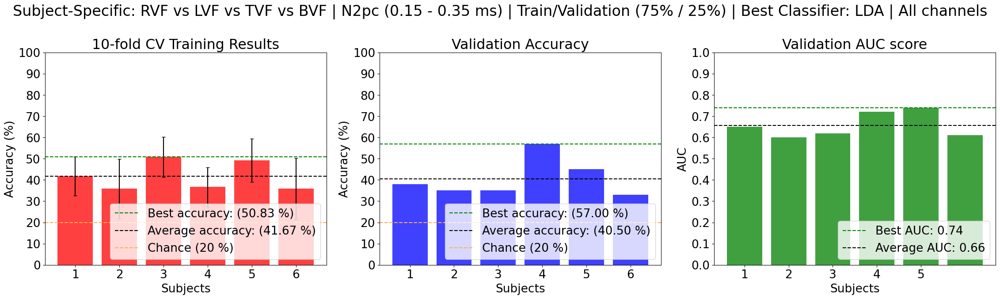

In [ ]:
best_classifier = np.argmax(np.mean(perSubj_accuracy, axis = 0))

fig, ax = plt.subplots(nrows = 1,
                       ncols = 3,
                       figsize=(23, 7))

fig.suptitle(f'Subject-Specific: RVF vs LVF vs TVF vs BVF | N2pc ({ts} - {te} ms) | Train/Validation (75% / 25%) | Best Classifier: {class_list[best_classifier]} | All channels', fontsize=24)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 19})
ax[0].bar(np.arange(1, NUM_SUBJ + 1), 
       perSubj_cross_val_scores[:,best_classifier, 0], 
       color="red", 
       yerr = perSubj_cross_val_scores[:,best_classifier, 1], 
       capsize=3,
       alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(perSubj_cross_val_scores[:,best_classifier, 0]), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(perSubj_cross_val_scores[:,best_classifier, 0]):.2f} %)')

ax[0].axhline(y = np.mean(perSubj_cross_val_scores[:,best_classifier, 0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(perSubj_cross_val_scores[:,best_classifier, 0]):.2f} %)')

ax[0].axhline(y=20, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (20 %)')

ax[0].set(xticks = np.arange(1, NUM_SUBJ + 1), 
         xlabel = 'Subjects', 
         yticks=np.arange(0, 101, step=10), 
         ylabel='Accuracy (%)',
         title=f'{KFOLD}-fold CV Training Results');

ax[0].legend(loc='lower right');


# -------------- Prediction Accuracy --------------

ax[1].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_accuracy[:,best_classifier], 
          color="b",
          alpha = 0.75)

ax[1].set_title('Accuracy (%)')

ax[1].axhline(y = max(perSubj_accuracy[:,best_classifier]), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(perSubj_accuracy[:,best_classifier]):.2f} %)')

ax[1].axhline(y = np.mean(perSubj_accuracy[:,best_classifier]), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy[:,best_classifier]):.2f} %)')

ax[1].axhline(y=20, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (20 %)')

ax[1].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 101, step=10), 
          ylabel='Accuracy (%)',
          title="Validation Accuracy");

ax[1].legend(loc='lower right');


# -------------- Aread Under the Curve (AUC) --------------

ax[2].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_auc_scores[:, best_classifier], 
          color="g",
          alpha = 0.75)

ax[2].set_title('AUC ')

ax[2].axhline(y = max(perSubj_auc_scores[:, best_classifier]), 
              color='green', linestyle='--', 
              label = f'Best AUC: {max(perSubj_auc_scores[:, best_classifier]):.2f}')

ax[2].axhline(y = np.mean(perSubj_auc_scores[:, best_classifier]), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: {np.mean(perSubj_auc_scores[:, best_classifier]):.2f}')

ax[2].set(xticks = np.arange(1, 5 + 1), 
          xlabel = 'Subjects', 
          yticks=np.arange(0, 1.01, step=0.1), ylabel='AUC',
          title="Validation AUC score");

ax[2].legend(loc='lower right');
plt.tight_layout()

# **NN xy model**

In [ ]:
torch.manual_seed(42)

class N2pcModelXY(nn.Module):
    def __init__(self, input_features, output_features, hidden_units=8):
        """Initializes all required hyperparameters for a multi-class classification model.

        Args:
            input_features (int): Number of input features to the model.
            out_features (int): Number of output features of the model
              (how many classes there are).
            hidden_units (int): Number of hidden units between layers, default 8.
        """
        super().__init__()
        self.linear_layer_stack = nn.Sequential(
            nn.Linear(in_features=input_features, out_features=hidden_units),
            nn.Sigmoid(), 
            nn.Linear(in_features=hidden_units, out_features=hidden_units),
            nn.Sigmoid(), 
            nn.Linear(in_features=hidden_units, out_features=hidden_units),
            nn.Sigmoid(), 
            nn.Linear(in_features=hidden_units, out_features=output_features),
        )
    
    def forward(self, x):
        return self.linear_layer_stack(x)

In [ ]:
all_training_losses = []
all_testing_losses = []

all_real_pos = []
all_pos_preds = []

for subj in range(NUM_SUBJ):

  print(f"\n------------------ Subject {subj + 1}: Training model (N2pc) ------------------")

  # Number of features

  train_featVect = np.vstack( (np.vstack( (np.vstack( (all_NN_featVectRVF_TVF[subj][:n_train], 
                                                       all_NN_featVectRVF_BVF[subj][:n_train]) ), 
                                                       all_NN_featVectLVF_TVF[subj][:n_train]) ),  
                                                       all_NN_featVectLVF_BVF[subj][:n_train]) )
  
  test_featVect = np.vstack( (np.vstack( (np.vstack( (all_NN_featVectRVF_TVF[subj][n_train:], 
                                                      all_NN_featVectRVF_BVF[subj][n_train:]) ), 
                                                      all_NN_featVectLVF_TVF[subj][n_train:]) ),  
                                                      all_NN_featVectLVF_BVF[subj][n_train:]) )

  NUM_FEATURES = np.size(train_featVect[:, 0:-2],1) 

  # Fit the model
  torch.manual_seed(42)

  # Set number of epochs
  dl_epochs = 30000
      
  # Initializing model

  xy_pos_model = N2pcModelXY(input_features=NUM_FEATURES, 
                            output_features=2, 
                            hidden_units=64).to(device)

  loss_fn = nn.L1Loss()
  optimizer = torch.optim.SGD(xy_pos_model.parameters(), 
                              lr=0.015,
                              momentum=0.095)

  # Shuffle

  np.random.seed(42)
  np.random.shuffle(train_featVect)
  np.random.seed(42)
  np.random.shuffle(test_featVect)

  # Tensor convertion
  tn_train_feat = torch.tensor(np.array(train_featVect[:, 0:-2])).type(torch.float32)
  tn_train_lbl = torch.tensor(np.array(train_featVect[:,-2::])).type(torch.float32)

  tn_test_feat = torch.tensor(np.array(test_featVect[:, 0:-2])).type(torch.float32)
  tn_test_lbl = torch.tensor(np.array(test_featVect[:,-2::])).type(torch.float32)

  # Feature wise normalization of feature vector
  n_entries, n_feat = tn_train_feat.size()

  for j in range(n_entries):

      mean = tn_train_feat[j,:].mean(dim=0)
      std = tn_train_feat[j,:].std(dim=0)
      tn_train_feat[j,:] = (tn_train_feat[j,:] - mean) / std

  n_entries, n_feat = tn_test_feat.size()

  for u in range(n_entries):

      mean = tn_test_feat[u,:].mean(dim=0)
      std = tn_test_feat[u,:].std(dim=0)
      tn_test_feat[u,:] = (tn_test_feat[u,:] - mean) / std

  training_losses = []
  testing_losses = []

  for dl_epoch in range(dl_epochs):
      ### Training
      xy_pos_model.train()

      # 1. Forward pass
      pos = xy_pos_model(tn_train_feat)

      # 2. Calculate loss
      train_loss = loss_fn(torch.squeeze(pos), tn_train_lbl) 
      training_losses.append(train_loss.detach().numpy())
    
      # 3. Optimizer zero grad
      optimizer.zero_grad()

      # 4. Loss backwards
      train_loss.backward()

      # 5. Optimizer step
      optimizer.step()

      ### Testing
      xy_pos_model.eval()
      with torch.inference_mode():
        # 1. Forward pass
        output = xy_pos_model(tn_test_feat)
        # 2. Calculate test loss and accuracy
        test_loss = loss_fn(torch.squeeze(output), tn_test_lbl)
        testing_losses.append(test_loss.detach().numpy())

      # Print out what's happening
      if (dl_epoch + 1) % 2000 == 0:
          print(f"Epoch: {dl_epoch + 1} | Training Loss: {train_loss:.5f}, | Testing Loss: {test_loss:.5f}")  

  # ------------------------------------ Test ------------------------------------

  # 1. Set the model in evaluation mode

  xy_pos_model.eval()

  # 2. Setup the inference mode context manager
  with torch.inference_mode():
    pos_preds = xy_pos_model(tn_test_feat)
    
  pos_preds = pos_preds.numpy()
  real_pos = tn_test_lbl.numpy()

  all_training_losses.append(training_losses)
  all_testing_losses.append(testing_losses)

  all_pos_preds.append(pos_preds)
  all_real_pos.append(real_pos)

  del xy_pos_model


------------------ Subject 1: Training model (N2pc) ------------------
Epoch: 2000 | Training Loss: 166.89644, | Testing Loss: 159.27525
Epoch: 4000 | Training Loss: 166.60834, | Testing Loss: 159.18533
Epoch: 6000 | Training Loss: 108.69447, | Testing Loss: 160.99228
Epoch: 8000 | Training Loss: 78.74426, | Testing Loss: 171.18755
Epoch: 10000 | Training Loss: 72.77984, | Testing Loss: 177.64050
Epoch: 12000 | Training Loss: 72.80067, | Testing Loss: 178.42960
Epoch: 14000 | Training Loss: 48.42008, | Testing Loss: 170.05592
Epoch: 16000 | Training Loss: 13.08888, | Testing Loss: 168.65182
Epoch: 18000 | Training Loss: 7.37971, | Testing Loss: 166.06267
Epoch: 20000 | Training Loss: 4.80200, | Testing Loss: 166.79752
Epoch: 22000 | Training Loss: 3.02380, | Testing Loss: 167.99509
Epoch: 24000 | Training Loss: 1.31420, | Testing Loss: 169.46935
Epoch: 26000 | Training Loss: 0.72892, | Testing Loss: 170.37360
Epoch: 28000 | Training Loss: 0.74711, | Testing Loss: 170.35593
Epoch: 3000

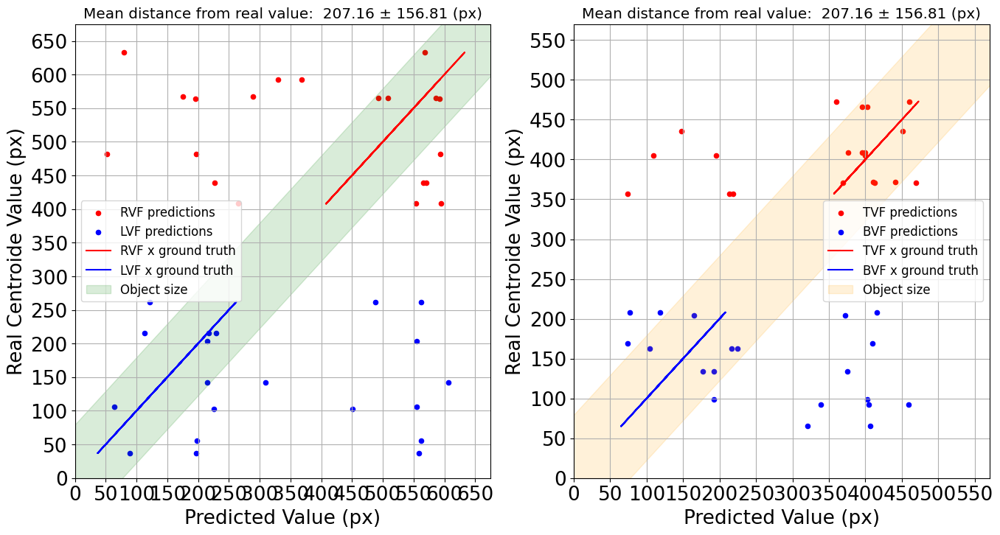

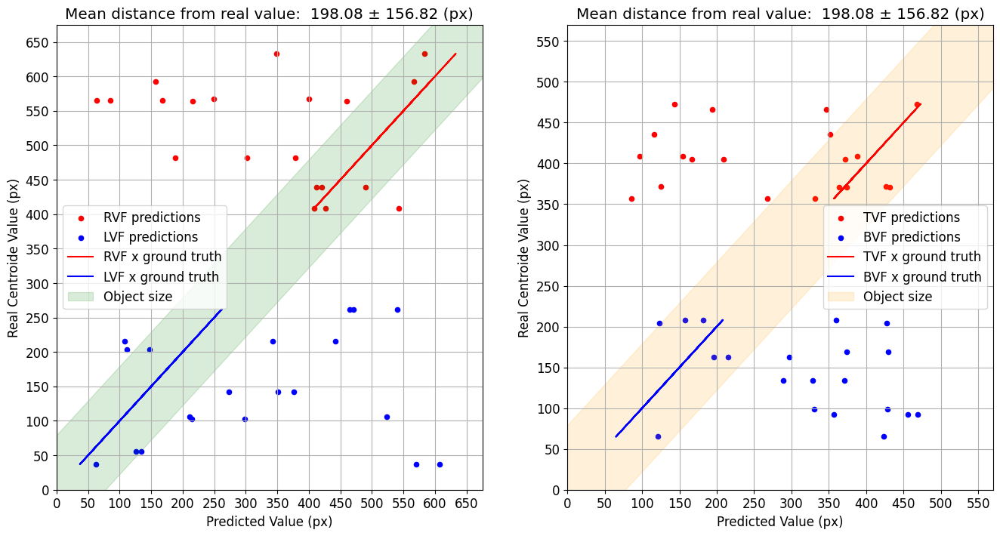

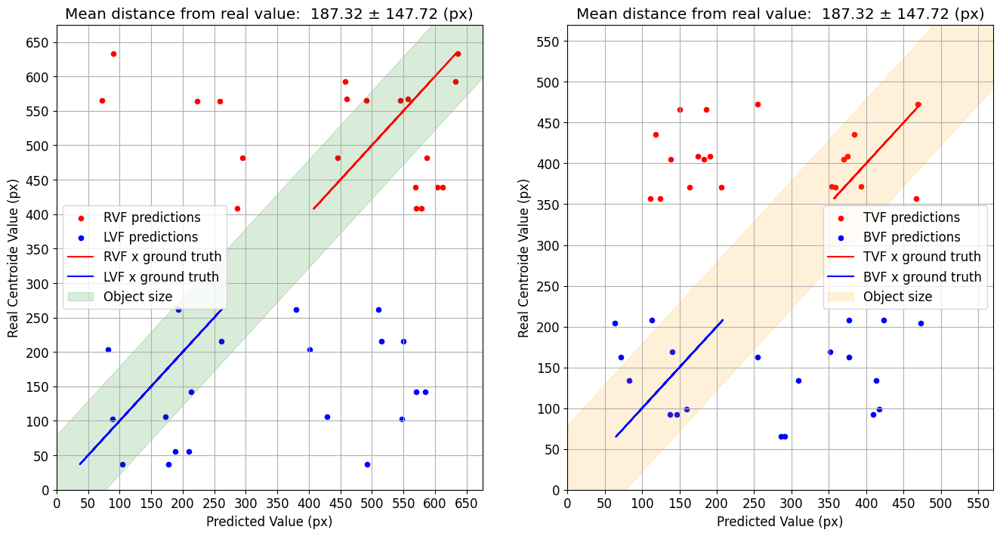

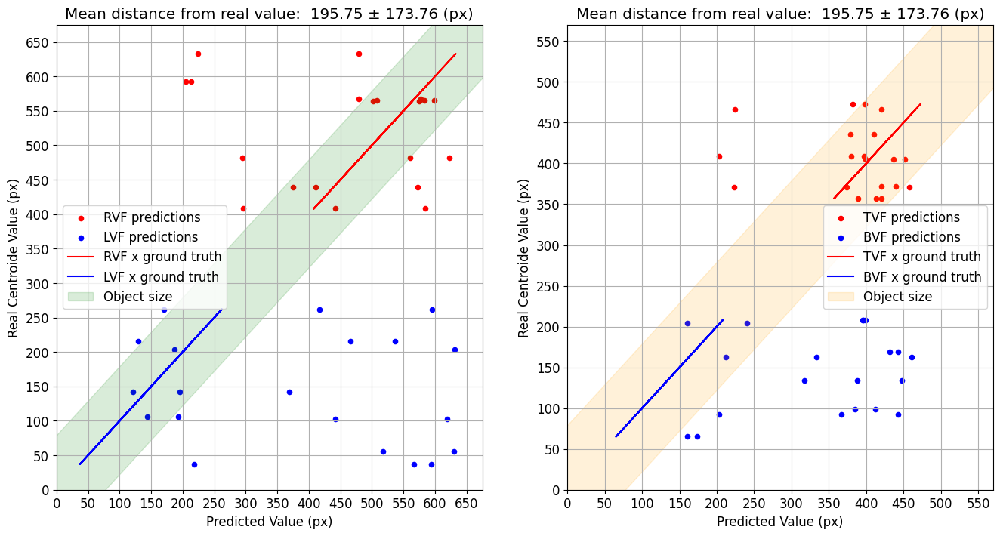

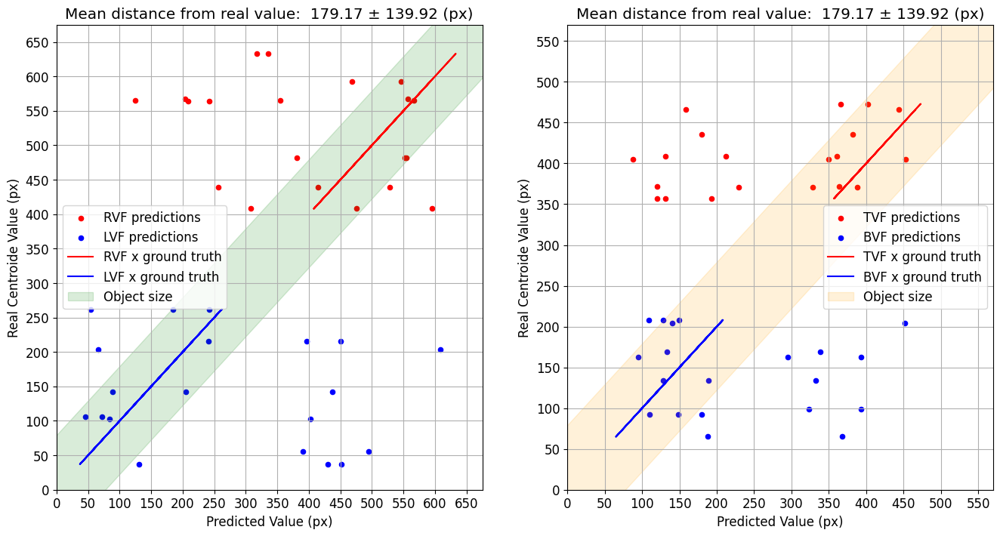

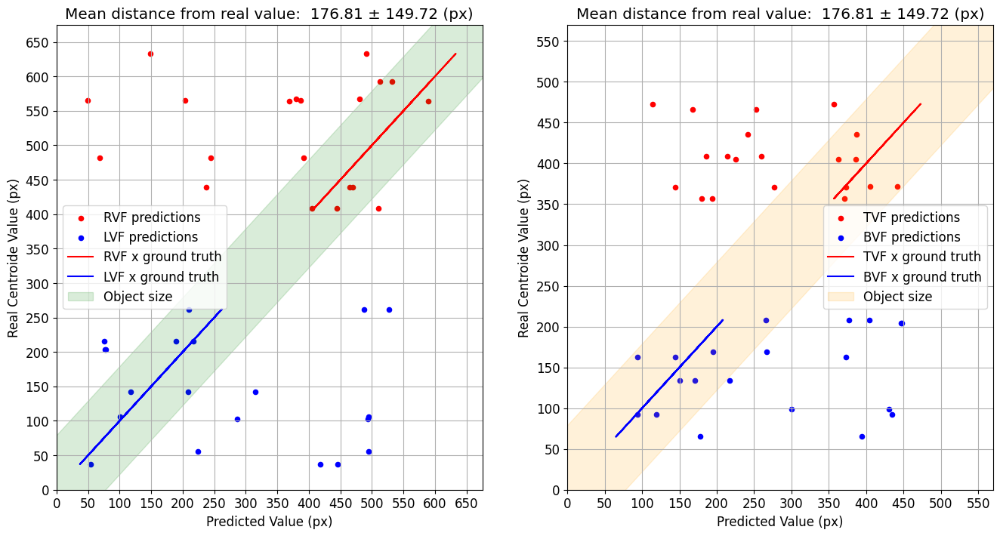

In [ ]:
all_distance_x = []
all_distance_y = []

for subj in range(NUM_SUBJ):

    fig, axs = plt.subplots(nrows=1, ncols=2, figsize = (16,8))

    plt.rcParams.update({'font.size': 12})

    ax = axs[0]

    x_preds = all_pos_preds[subj][:,0].reshape(len(all_pos_preds[subj][:,0]))
    y_preds = all_pos_preds[subj][:,1].reshape(len(all_pos_preds[subj][:,1]))

    '''
    Absolute error: |True value - Measured Value|
    Relative error: |Absolute error / True value|
    Percent  error: Relative error * 100
    '''
    rel_error_x = (np.abs(all_real_pos[subj][:,0] - all_pos_preds[subj][:,0])/all_real_pos[subj][:,0])*100
    distance_x = np.abs(all_real_pos[subj][:,0] - all_pos_preds[subj][:,0])

    all_distance_x.append(distance_x)

    rel_error_y = (np.abs(all_real_pos[subj][:,1] - all_pos_preds[subj][:,1])/all_real_pos[subj][:,1])*100
    distance_y = np.abs(all_real_pos[subj][:,1] - all_pos_preds[subj][:,1])

    all_distance_y.append(distance_y)

    TVF_real_y = [y for y in range(len(all_real_pos[subj][:,1])) if all_real_pos[subj][y,1] > IM_HEIGHT/2]
    BVF_real_y = [y for y in range(len(all_real_pos[subj][:,1])) if all_real_pos[subj][y,1] < IM_HEIGHT/2]

    RVF_real_x = [x for x in range(len(all_real_pos[subj][:,0])) if all_real_pos[subj][x,0] > IM_WIDTH/2]
    LVF_real_x = [x for x in range(len(all_real_pos[subj][:,0])) if all_real_pos[subj][x,0] < IM_WIDTH/2]

    # Scatter plots on the same axes
    ax.scatter(all_pos_preds[subj][RVF_real_x,0], all_real_pos[subj][RVF_real_x,0], color='r', label='RVF predictions',alpha=1, s=20);
    ax.scatter(all_pos_preds[subj][LVF_real_x,0], all_real_pos[subj][LVF_real_x,0], color='b', label='LVF predictions',alpha=1, s=20);

    plus_minus_symbol = chr(0x00B1)
    ax.set(xlabel='Predicted Value (px)', 
        xticks=np.arange(0, IM_WIDTH + 3, step = 50),
        xlim=(0, IM_WIDTH + 3),
        ylabel='Real Centroide Value (px)',
        yticks=np.arange(0, IM_WIDTH + 3, step = 50),
        ylim=(0, IM_WIDTH + 3),
        title=(f"Mean distance from real value: {np.mean(distance_x): .2f} {plus_minus_symbol}{np.std(distance_x): .2f} (px)"));
    ax.grid(True)

    ax.plot(all_real_pos[subj][RVF_real_x,0], all_real_pos[subj][RVF_real_x,0], 'r', alpha=1, label = 'RVF x ground truth') # Line plot
    ax.plot(all_real_pos[subj][LVF_real_x,0], all_real_pos[subj][LVF_real_x,0], 'b', alpha=1, label = 'LVF x ground truth') 

    diag_rect = patches.Rectangle(
        (min(all_real_pos[subj][LVF_real_x,0]) - 50, (min(all_real_pos[subj][:,0]))-(obj_region/2)/math.cos(math.radians(45)) - 50), 
                                    max(all_real_pos[subj][:,0]) + 400, 
                                    obj_region, 
                                    linewidth=1, 
                                    edgecolor='g', 
                                    facecolor='g', 
                                    alpha=0.15, 
                                    angle=45, 
                                    label = 'Object size')
    
    ax.add_patch(diag_rect) # Patch plot

    ax.legend()

    ax = axs[1]

    # Scatter plots on the same axes
    ax.scatter(all_pos_preds[subj][TVF_real_y,1], all_real_pos[subj][TVF_real_y,1], color='r', label='TVF predictions',alpha=1, s=20);
    ax.scatter(all_pos_preds[subj][BVF_real_y,1], all_real_pos[subj][BVF_real_y,1], color='b', label='BVF predictions',alpha=1, s=20);

    plus_minus_symbol = chr(0x00B1)
    ax.set(xlabel='Predicted Value (px)', 
        xticks=np.arange(0, IM_HEIGHT + 3, step = 50),
        xlim=(0, IM_HEIGHT + 3),
        ylabel='Real Centroide Value (px)',
        yticks=np.arange(0, IM_HEIGHT + 3, step = 50),
        ylim=(0, IM_HEIGHT + 3),
        title=(f"Mean distance from real value: {np.mean(distance_x): .2f} {plus_minus_symbol}{np.std(distance_x): .2f} (px)"));
    ax.grid(True)

    ax.plot(all_real_pos[subj][TVF_real_y,1], all_real_pos[subj][TVF_real_y,1], 'r', alpha=1, label = 'TVF x ground truth') # Line plot
    ax.plot(all_real_pos[subj][BVF_real_y,1], all_real_pos[subj][BVF_real_y,1], 'b', alpha=1, label = 'BVF x ground truth') 

    diag_rect = patches.Rectangle(
        (min(all_real_pos[subj][BVF_real_y,1]) - 50, (min(all_real_pos[subj][:,1]))-(obj_region/2)/math.cos(math.radians(45)) - 50), 
                                    max(all_real_pos[subj][:,1]) + 400, 
                                    obj_region, 
                                    linewidth=1, 
                                    edgecolor='orange', 
                                    facecolor='orange', 
                                    alpha=0.15, 
                                    angle=45, 
                                    label = 'Object size')
    
    ax.add_patch(diag_rect) # Patch plot

    ax.legend()
        
    plt.subplots_adjust(hspace=0.15)
    plt.show()

# **Target vs Non - Target (N2pc and P3)**

## Feature vectors

In [62]:
all_RVF_contralateral = []
all_RVF_ipsilateral = []
all_LVF_contralateral = []
all_LVF_ipsilateral = []
all_CVF_contralateral = []
all_CVF_ipsilateral = []

all_RVF_P3 = []
all_LVF_P3 = []
all_CVF_P3 = []

for subj in range(NUM_SUBJ):

    RVF_contralateral = []
    RVF_ipsilateral = []
    LVF_contralateral = []
    LVF_ipsilateral = []
    CVF_contralateral = []
    CVF_ipsilateral = []

    RVF_P3 = []
    LVF_P3 = []
    CVF_P3 = []

    for trial in all_labelled_targets[subj]:
        
        if(trial[HORIZONTAL_CONDITION_COL] == "RVF"):

            RVF_contralateral.append(trial[DATA_COL][left_N2pc_ch_idx,:])
            RVF_ipsilateral.append(trial[DATA_COL][right_N2pc_ch_idx,:])

            RVF_P3.append(trial[DATA_COL][P3_ch_idx,:])

        elif(trial[HORIZONTAL_CONDITION_COL] == "LVF"):

            LVF_contralateral.append(trial[DATA_COL][left_N2pc_ch_idx,:])
            LVF_ipsilateral.append(trial[DATA_COL][right_N2pc_ch_idx,:])

            LVF_P3.append(trial[DATA_COL][P3_ch_idx,:])

        elif(trial[HORIZONTAL_CONDITION_COL] == "CVF"):

            CVF_contralateral.append(trial[DATA_COL][left_N2pc_ch_idx,:])
            CVF_ipsilateral.append(trial[DATA_COL][right_N2pc_ch_idx,:])

            CVF_P3.append(trial[DATA_COL][P3_ch_idx,:])

    all_RVF_contralateral.append(RVF_contralateral)
    all_RVF_ipsilateral.append(RVF_ipsilateral)

    all_LVF_contralateral.append(LVF_contralateral)
    all_LVF_ipsilateral.append(LVF_ipsilateral)
    
    all_CVF_contralateral.append(CVF_contralateral)
    all_CVF_ipsilateral.append(CVF_ipsilateral)

    all_RVF_P3.append(RVF_P3)
    all_LVF_P3.append(LVF_P3)
    all_CVF_P3.append(CVF_P3)

In [64]:
from scipy.signal import resample

In [65]:
# Isolating the datapoints related to the N2pc time window 

n_trials_lateral, n_channels_N2pc, _ = np.shape(RVF_contralateral)
n_trials_central = np.size(CVF_contralateral, 0)

ts_N2pc = 0.15
te_N2pc = 0.35

idx_s_N2pc = np.argmin(np.abs(ERP_times - ts_N2pc))
idx_e_N2pc = np.argmin(np.abs(ERP_times - te_N2pc))

ts_P3 = 0.28
te_P3 = 0.48

idx_s_P3 = np.argmin(np.abs(ERP_times - ts_P3))
idx_e_P3 = np.argmin(np.abs(ERP_times - te_P3))

# Resampling the resulting time window (Prevents overfitting)

RESAMPLE_FREQ = 64 # Hz
N_DATAPOINTS_ORIG_FREQ_N2PC = len(ERP_times[idx_s_N2pc:idx_e_N2pc+1])
N_DATAPOINTS_RESA_FREQ_N2PC = int(np.ceil((N_DATAPOINTS_ORIG_FREQ_N2PC * RESAMPLE_FREQ)/fs)) + 1

N_DATAPOINTS_ORIG_FREQ_P3 = len(ERP_times[idx_s_P3:idx_e_P3+1])
N_DATAPOINTS_RESA_FREQ_P3 = int(np.ceil((N_DATAPOINTS_ORIG_FREQ_P3 * RESAMPLE_FREQ)/fs)) + 1

all_n2pc_featTarget = []
all_n2pc_featNonTarget = []

all_featTarget = []
all_featNonTarget = []

for subj in range(NUM_SUBJ):

    n2pc_featVectLVF = []
    n2pc_featVectRVF = []
    n2pc_featVectCVF = []
    n2pc_featVectNT = []

    featVectLVF = []
    featVectRVF = []
    featVectCVF = []
    featVectNT = []

    for trial in range(n_trials_lateral):

        '''

        LVF = resample(all_LVF_contralateral[subj][trial][:,idx_s_N2pc:idx_e_N2pc+1] - all_LVF_ipsilateral[subj][trial][:,idx_s_N2pc:idx_e_N2pc+1], 
                       N_DATAPOINTS_RESA_FREQ_N2PC, 
                       axis = -1)
        RVF = resample(all_RVF_contralateral[subj][trial][:,idx_s_N2pc:idx_e_N2pc+1] - all_RVF_ipsilateral[subj][trial][:,idx_s_N2pc:idx_e_N2pc+1], 
                       N_DATAPOINTS_RESA_FREQ_N2PC, 
                       axis = -1)
        
        '''

        LVF1 = resample(all_LVF_contralateral[subj][trial][:,idx_s_N2pc:idx_e_N2pc+1], N_DATAPOINTS_RESA_FREQ_N2PC, axis = -1)
        LVF2 = resample(all_LVF_ipsilateral[subj][trial][:,idx_s_N2pc:idx_e_N2pc+1], N_DATAPOINTS_RESA_FREQ_N2PC, axis = -1)
        
        RVF1 = resample(all_RVF_contralateral[subj][trial][:,idx_s_N2pc:idx_e_N2pc+1], N_DATAPOINTS_RESA_FREQ_N2PC, axis = -1)
        RVF2 = resample(all_RVF_ipsilateral[subj][trial][:,idx_s_N2pc:idx_e_N2pc+1], N_DATAPOINTS_RESA_FREQ_N2PC, axis = -1)
        
        
        LVF = np.hstack((LVF1, LVF2))
        RVF = np.hstack((RVF1, RVF2))
        
        p3_LVF = resample(all_LVF_P3[subj][trial][:,idx_s_P3:idx_e_P3+1], 
                          N_DATAPOINTS_RESA_FREQ_P3, 
                          axis = -1)
        
        p3_RVF = resample(all_RVF_P3[subj][trial][:,idx_s_P3:idx_e_P3+1], 
                          N_DATAPOINTS_RESA_FREQ_P3, 
                          axis = -1)
        
        for c in range(1, n_channels_N2pc):

            if (c == 1):
                auxLVF = np.hstack((LVF[c-1,:],LVF[c,:]))
                auxRVF = np.hstack((RVF[c-1,:],RVF[c,:]))
            else:
                auxLVF = np.hstack((auxLVF,LVF[c,:]))
                auxRVF = np.hstack((auxRVF,RVF[c,:]))

        n2pc_featVectLVF.append(np.hstack((auxLVF, 1)))
        n2pc_featVectRVF.append(np.hstack((auxRVF, 1)))

        featVect_n2pc_Target = np.vstack((n2pc_featVectLVF, n2pc_featVectRVF))

        for c in range(len(P3_ch_idx)):
            
            auxRVF = np.hstack((auxRVF,p3_RVF[c,:]))
            auxLVF = np.hstack((auxLVF,p3_LVF[c,:]))

        featVectLVF.append(np.hstack((auxLVF, 1)))
        featVectRVF.append(np.hstack((auxRVF, 1)))

        featVect_Target = np.vstack((featVectLVF,featVectRVF))


    ''' ================================================================================================================ '''


    for trial in range(n_trials_central):

        CVF1 = resample(all_CVF_contralateral[subj][trial][:,idx_s_N2pc:idx_e_N2pc+1], 
                        N_DATAPOINTS_RESA_FREQ_N2PC, 
                        axis = -1)
        
        CVF2 = resample(all_CVF_ipsilateral[subj][trial][:,idx_s_N2pc:idx_e_N2pc+1], 
                        N_DATAPOINTS_RESA_FREQ_N2PC, 
                        axis = -1)
        
        CVF = np.hstack((CVF1, CVF2))

        p3_CVF = resample(all_CVF_P3[subj][trial][:,idx_s_P3:idx_e_P3+1], 
                            N_DATAPOINTS_RESA_FREQ_P3, 
                            axis = -1)
        
        for c in range(1, n_channels_N2pc):

            if (c == 1):
                auxCVF = np.hstack((CVF[c-1,:],CVF[c,:]))
            else:
                auxCVF = np.hstack((auxCVF,CVF[c,:]))
        
        n2pc_featVectCVF.append(np.hstack((auxCVF, 1)))


        for c in range(len(P3_ch_idx)):
            
            auxCVF = np.hstack((auxCVF,p3_CVF[c,:]))

        featVectCVF.append(np.hstack((auxCVF, 1)))

    ''' ================================================================================================================ '''


    for trial in range(n_trials_lateral * 2 + n_trials_central):

        nontargets_N2pc_1 = resample(all_baseline_corr_nontargets[subj][trial*2][left_N2pc_ch_idx,idx_s_N2pc:idx_e_N2pc+1], 
                                     N_DATAPOINTS_RESA_FREQ_N2PC, 
                                    axis = -1)
        
        nontargets_N2pc_2 = resample(all_baseline_corr_nontargets[subj][trial*2][right_N2pc_ch_idx,idx_s_N2pc:idx_e_N2pc+1],
                                     N_DATAPOINTS_RESA_FREQ_N2PC, 
                                    axis = -1)

        nontargets_N2pc = np.hstack((nontargets_N2pc_1,  nontargets_N2pc_2))

        nontargets_P3 = resample(all_baseline_corr_nontargets[subj][trial*4][P3_ch_idx,idx_s_P3:idx_e_P3+1] , 
                                 N_DATAPOINTS_RESA_FREQ_P3, 
                                 axis = -1)
        
        for c in range(1, n_channels_N2pc):

            if (c == 1):
                auxNT = np.hstack((nontargets_N2pc[c-1,:],nontargets_N2pc[c,:]))
            else:
                auxNT = np.hstack((auxNT, nontargets_N2pc[c,:]))
            
        n2pc_featVectNT.append(np.hstack((auxNT, 0)))

        for c in range(len(P3_ch_idx)):
            
            auxNT = np.hstack((auxNT,nontargets_P3[c,:]))

        featVectNT.append(np.hstack((auxNT, 0)))

    featVect_n2pc_Target = np.vstack((featVect_n2pc_Target, n2pc_featVectCVF))
    featVect_Target = np.vstack((featVect_Target, featVectCVF))

    all_n2pc_featTarget.append(featVect_n2pc_Target)
    all_featTarget.append(featVect_Target)

    all_n2pc_featNonTarget.append(n2pc_featVectNT)
    all_featNonTarget.append(featVectNT)

print(np.shape(all_featTarget))
print(np.shape(all_featNonTarget))


(6, 240, 267)
(6, 240, 267)


In [67]:
print(np.shape(all_n2pc_featTarget))
print(np.shape(all_n2pc_featNonTarget))

(6, 240, 197)
(6, 240, 197)


## Train/Validation Split (N2pc)

In [68]:
n_train = int(np.ceil((n_trials_lateral * 2 + n_trials_central) * PERCENT_TRAIN))

all_train_featVect = []
all_test_featVect = []

for subj in range(NUM_SUBJ):

    train_featVect = np.vstack((all_n2pc_featTarget[subj][:n_train], all_n2pc_featNonTarget[subj][:n_train]))
    test_featVect = np.vstack((all_n2pc_featTarget[subj][n_train:], all_n2pc_featNonTarget[subj][n_train:]))

    np.random.seed(42)
    np.random.shuffle(train_featVect)
    np.random.seed(42)
    np.random.shuffle(test_featVect)

    all_train_featVect.append(train_featVect)
    all_test_featVect.append(test_featVect)

print(np.shape(all_train_featVect))
print(np.shape(all_test_featVect))

(6, 360, 197)
(6, 120, 197)


## Row-wise normalization of the feature vector (N2pc)

In [69]:
# Feature wise normalization of feature vector

all_norm_train_featVect = []
all_norm_test_featVect = []

ROW_WISE_NORM = True

for subj in range(NUM_SUBJ):

    if(ROW_WISE_NORM):  

        n_entries = np.size(all_train_featVect, 1)

        norm_train_featVect = []

        for j in range(n_entries):

            mean = np.mean(all_train_featVect[subj][j, 0:-1])
            std = np.std(all_train_featVect[subj][j, 0:-1])
            norm_train_featVect.append(np.hstack(((all_train_featVect[subj][j,0:-1] - mean) / std, all_train_featVect[subj][j, -1])))


        n_entries = np.size(all_test_featVect, 1)

        norm_test_featVect = []

        for u in range(n_entries):

            mean = np.mean(all_test_featVect[subj][u,0:-1])
            std = np.std(all_test_featVect[subj][u,0:-1])
            norm_test_featVect.append(np.hstack(((all_test_featVect[subj][u,0:-1] - mean) / std, all_test_featVect[subj][u, -1])))
            

        train_featVect = np.array(norm_train_featVect)
        test_featVect = np.array(norm_test_featVect)

    all_norm_train_featVect.append(train_featVect)
    all_norm_test_featVect.append(test_featVect)


print(np.shape(all_norm_train_featVect))
print(np.shape(all_norm_test_featVect))

(6, 360, 197)
(6, 120, 197)


## MBI (N2pc)

In [98]:
k_feat = N_DATAPOINTS_RESA_FREQ_N2PC * 7

all_best_feat_idx = []

for subj in range(NUM_SUBJ):

    best_feat_idx = SelectKBest(mutual_info_classif, k = k_feat).fit(all_norm_train_featVect[subj][:,0:-1], all_norm_train_featVect[subj][:,-1]).get_support()
    best_feat_idx = np.append(best_feat_idx, False) # False is because this field is reserved for the Class label and not a feature

    all_best_feat_idx.append(best_feat_idx)
    
print(np.shape(all_best_feat_idx))

(6, 197)


In [99]:
n_ch = len(right_N2pc_ch_idx)*2

all_tf = []

for subj in range(NUM_SUBJ):

    tf = np.zeros(n_ch)
    cont = np.ones(N_DATAPOINTS_RESA_FREQ_N2PC)

    for i in range(n_ch):
        tf[i] = (np.sum(cont[all_best_feat_idx[subj][i*N_DATAPOINTS_RESA_FREQ_N2PC:i*N_DATAPOINTS_RESA_FREQ_N2PC+N_DATAPOINTS_RESA_FREQ_N2PC]]))

    all_tf.append(tf)

print(np.shape(all_tf))

(6, 14)


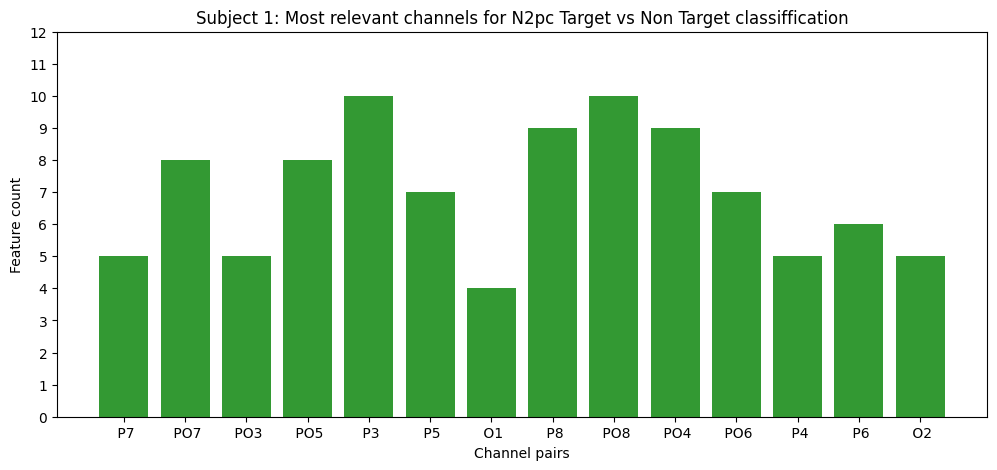

<Figure size 640x480 with 0 Axes>

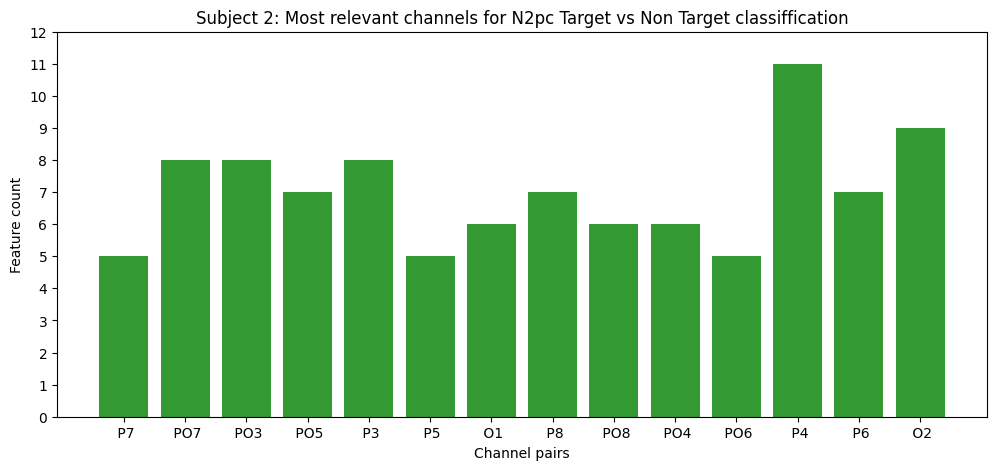

<Figure size 640x480 with 0 Axes>

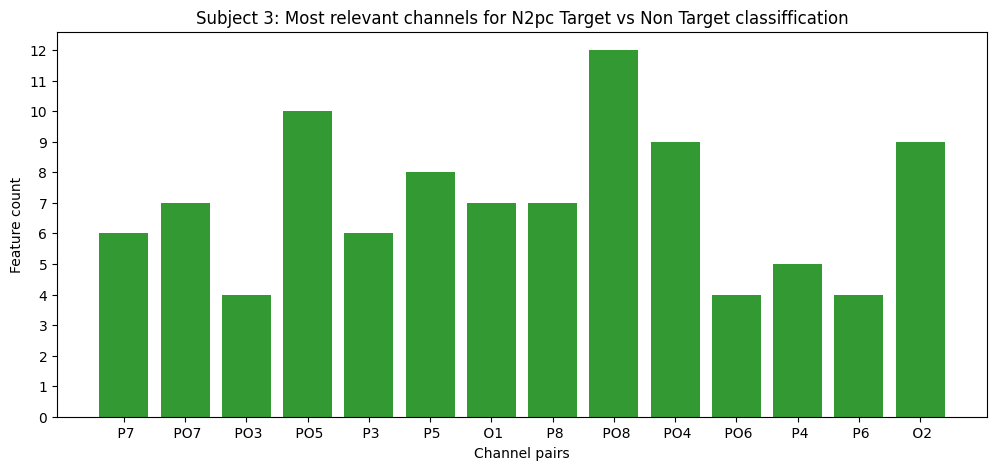

<Figure size 640x480 with 0 Axes>

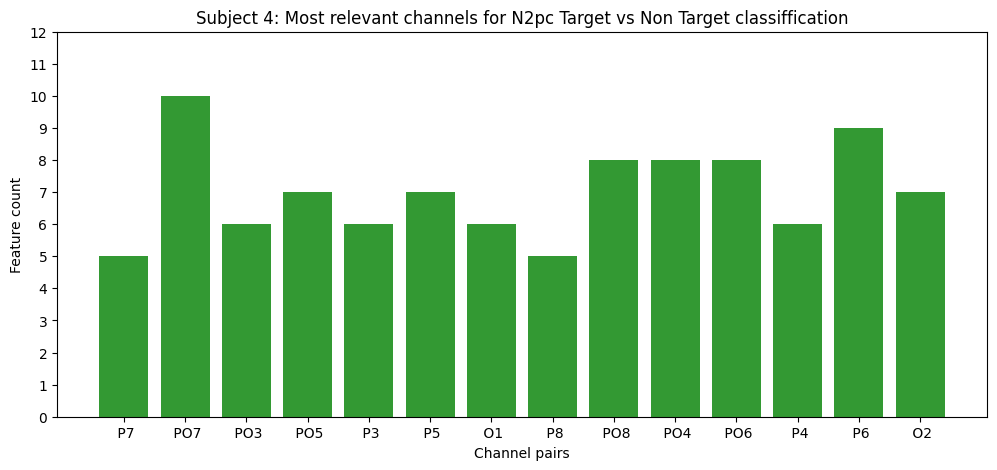

<Figure size 640x480 with 0 Axes>

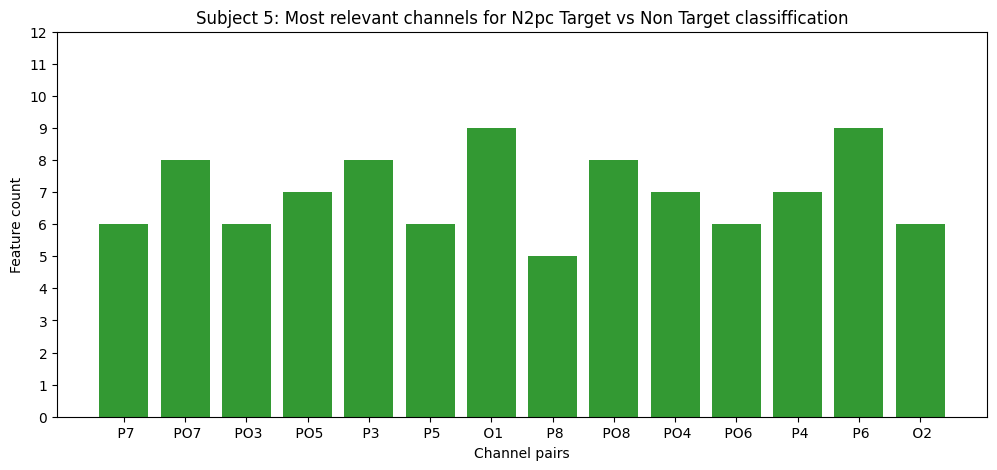

<Figure size 640x480 with 0 Axes>

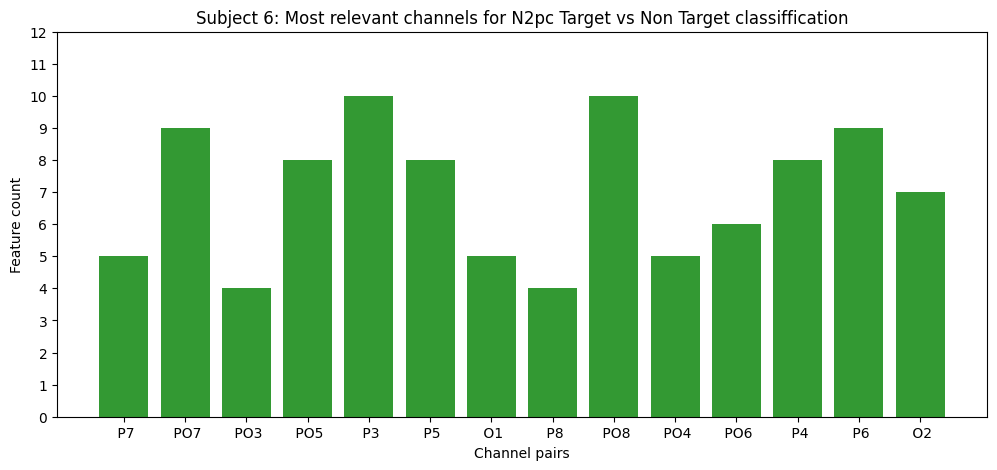

<Figure size 640x480 with 0 Axes>

In [101]:
max_y = np.max(all_tf)

for subj in range(NUM_SUBJ):

    customlb = []
    
    for c, lb in enumerate(left_N2pc_channels):
        customlb.append(str(lb))
    for c, lb in enumerate(right_N2pc_channels):
        customlb.append(str(lb))
    
    fig, ax = plt.subplots(figsize=(12, 5))

    ax.set_title(f'Subject {subj +1}: Most relevant channels for N2pc Target vs Non Target classiffication')

    ax.bar(np.arange(1, n_ch + 1), 
           all_tf[subj], 
           color="g", 
           capsize=4, 
           alpha = 0.8)
    
    ax.set(xticks=np.arange(1, n_ch + 1), 
           xlabel='Channel pairs', 
           yticks=np.arange(0, max_y + 1, step=1),
           ylabel = "Feature count")
    
    ax.set_xticklabels(customlb);

    plt.rcdefaults()
    plt.show();
    plt.tight_layout()

In [70]:
all_best_channel_feat_idx = []

for subj in range(NUM_SUBJ):

    best_channel_feat_idx = np.zeros(len(best_feat_idx))

    for i in range(len(tf)):
        if(all_tf[subj][i] >= sorted(all_tf[subj], reverse = True)[6]):
            best_channel_feat_idx[i * N_DATAPOINTS_RESA_FREQ_N2PC:i * N_DATAPOINTS_RESA_FREQ_N2PC + N_DATAPOINTS_RESA_FREQ_N2PC] = 1
        else:
            best_channel_feat_idx[i * N_DATAPOINTS_RESA_FREQ_N2PC: i * N_DATAPOINTS_RESA_FREQ_N2PC + N_DATAPOINTS_RESA_FREQ_N2PC] = 0

    best_channel_feat_idx = best_channel_feat_idx != 0 # Convert to boolean

    all_best_channel_feat_idx.append(best_channel_feat_idx)

## Classification (Best Features N2pc)

In [71]:
print("========================== Most discriminative channels ==========================\n")

perSubj_cross_val_scores = np.zeros((NUM_SUBJ, 5, 2))
perSubj_accuracy = np.zeros((NUM_SUBJ, 5)) # 5 Classifiers
perSubj_auc_scores = np.zeros((NUM_SUBJ, 5))
perSubj_fitting_periods = np.zeros((NUM_SUBJ, 5))

for subj in range(NUM_SUBJ):

    print(f"\n------------------ Subject {subj + 1}: Classifying Target vs Non-Target ------------------\n")

    for c_count, clf in enumerate(classifiers):

        print(f"\n------------------ Classifier: {clf} ------------------")

        n2pc_clf = clf

        # --------- Cross Validation Scores ---------
        cross_val_scores, best_n2pc_clf = GridSearch(classifier_params[c_count], 
                                                     n2pc_clf, 
                                                     KFOLD, 
                                                     all_norm_train_featVect[subj][:,all_best_channel_feat_idx[subj]],
                                                     all_norm_train_featVect[subj][:,-1])
        
        perSubj_cross_val_scores[subj, c_count, 0] = cross_val_scores[0]
        perSubj_cross_val_scores[subj, c_count, 1] = cross_val_scores[1]
        perSubj_fitting_periods[subj, c_count] = cross_val_scores[2]

        # --------- Predictions ---------
        pred = best_n2pc_clf.predict(all_norm_test_featVect[subj][:, all_best_channel_feat_idx[subj]])
        perSubj_accuracy[subj, c_count] = round(accuracy_score(all_norm_test_featVect[subj][:, -1], pred), 2) * 100
        print("\nAccuracy: ", round(accuracy_score(all_norm_test_featVect[subj][:, -1], pred), 2) * 100)
        print(best_n2pc_clf)


        # Compute AUC for each subject
        perSubj_auc_scores[subj, c_count] = round(roc_auc_score(all_norm_test_featVect[subj][:, -1], best_n2pc_clf.predict_proba(all_norm_test_featVect[subj][:, all_best_channel_feat_idx[subj]])[:,1]), 2)

        del n2pc_clf, best_n2pc_clf # Ensures no mixing of classifiers within the loop

========================== Most discriminative channels ==========================


------------------ Subject 1: Classifying Target vs Non-Target ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.01, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.7666666666666667

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.01}
Best score: 0.75

Running Grid Search for method: poly

Best parameters: {'C': 0.001, 'cache_size': 200, 'degree': 3, 'gamma': 1, 'kernel': 'poly', 'random_state': 42, 'tol': 0.01}
Best score: 0.7222222222222222

Running Grid Search for method: sigmoid

Best parameters: {'C': 10, 'cache_size': 200, 'gamma': 'scale', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.001}
Best score: 0.7722222222222223

Accuracy:  76.0
SVC(C=10, kerne

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 1.0, 'n_estimators': 100, 'random_state': 42}
Best score: 0.7749999999999999

Accuracy:  72.0
AdaBoostClassifier(n_estimators=100, random_state=42)

------------------ Subject 2: Classifying Target vs Non-Target ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 1, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.7555555555555555

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.6805555555555556

Running Grid Search for method: poly

Best parameters: {'C': 1, 'cache_size': 200, 'degree': 3, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.01}
Best score: 0.7194444444444444

Running Grid Search for method: sigmoid

Best parameters: {'C': 0.1, 'cache_size': 200, 'gamma': 'auto', 'kernel'

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.1, 'n_estimators': 100, 'random_state': 42}
Best score: 0.6694444444444445

Accuracy:  62.0
AdaBoostClassifier(learning_rate=0.1, n_estimators=100, random_state=42)

------------------ Subject 3: Classifying Target vs Non-Target ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.01, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.6638888888888889

Running Grid Search for method: rbf

Best parameters: {'C': 10, 'cache_size': 200, 'gamma': 'scale', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.6749999999999999

Running Grid Search for method: poly

Best parameters: {'C': 10, 'cache_size': 200, 'degree': 2, 'gamma': 'scale', 'kernel': 'poly', 'random_state': 42, 'tol': 0.01}
Best score: 0.6361111111111111

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, '

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.5, 'n_estimators': 200, 'random_state': 42}
Best score: 0.6666666666666666

Accuracy:  57.99999999999999
AdaBoostClassifier(learning_rate=0.5, n_estimators=200, random_state=42)

------------------ Subject 4: Classifying Target vs Non-Target ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.01, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.711111111111111

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'scale', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.01}
Best score: 0.6222222222222222

Running Grid Search for method: poly

Best parameters: {'C': 0.1, 'cache_size': 200, 'degree': 3, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.01}
Best score: 0.6194444444444444

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_s

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 1.0, 'n_estimators': 200, 'random_state': 42}
Best score: 0.6361111111111111

Accuracy:  56.00000000000001
AdaBoostClassifier(n_estimators=200, random_state=42)

------------------ Subject 5: Classifying Target vs Non-Target ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.1, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.6722222222222223

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'scale', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.001}
Best score: 0.6722222222222223

Running Grid Search for method: poly

Best parameters: {'C': 100, 'cache_size': 200, 'degree': 3, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.6416666666666667

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma':

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 1.0, 'n_estimators': 200, 'random_state': 42}
Best score: 0.6

Accuracy:  63.0
AdaBoostClassifier(n_estimators=200, random_state=42)

------------------ Subject 6: Classifying Target vs Non-Target ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 100, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.6888888888888889

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.6916666666666667

Running Grid Search for method: poly

Best parameters: {'C': 1, 'cache_size': 200, 'degree': 3, 'gamma': 'scale', 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.7055555555555555

Running Grid Search for method: sigmoid

Best parameters: {'C': 0.1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


In [72]:
ts = 0.15
te = 0.35

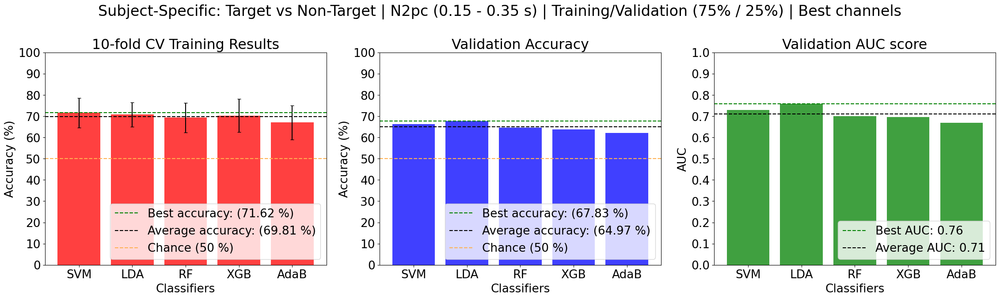

In [74]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 3,
                       figsize=(23, 7))

fig.suptitle(f'Subject-Specific: Target vs Non-Target | N2pc ({ts} - {te} s) | Training/Validation (75% / 25%) | Best channels', fontsize=24)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 19})
ax[0].bar(np.arange(1, 6), 
       np.mean(perSubj_cross_val_scores[:,:,0], axis = 0 ), 
       color="red", 
       yerr = np.mean(perSubj_cross_val_scores[:,:,1], axis = 0), 
       capsize=3,
       alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(np.mean(perSubj_cross_val_scores[:,:,0], axis = 0)), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(np.mean(perSubj_cross_val_scores[:,:,0], axis = 0)):.2f} %)')

ax[0].axhline(y = np.mean(perSubj_cross_val_scores[:,:,0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(perSubj_cross_val_scores[:,:,0]):.2f} %)')

ax[0].axhline(y=50, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (50 %)')

ax[0].set(xticks = np.arange(1, 5 + 1), 
       xticklabels = class_list,
       xlabel = 'Classifiers', 
       yticks=np.arange(0, 101, step=10), ylabel='Accuracy (%)',
       title=f'{KFOLD}-fold CV Training Results');

ax[0].legend(loc='lower right');


# -------------- Prediction Accuracy --------------

ax[1].bar(np.arange(1, 6), 
          np.mean(perSubj_accuracy, axis = 0 ), 
          color="b",
          alpha = 0.75)

ax[1].set_title('Accuracy (%)')

ax[1].axhline(y = max(np.mean(perSubj_accuracy, axis = 0)), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(np.mean(perSubj_accuracy, axis = 0)):.2f} %)')

ax[1].axhline(y = np.mean(perSubj_accuracy), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy):.2f} %)')

ax[1].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50 %)')

ax[1].set(xticks = np.arange(1, 5 + 1), 
          xticklabels = class_list,
          xlabel = 'Classifiers', 
          yticks=np.arange(0, 101, step=10), ylabel='Accuracy (%)',
          title="Validation Accuracy");

ax[1].legend(loc='lower right');


# -------------- Aread Under the Curve (AUC) --------------

ax[2].bar(np.arange(1, 6), 
          np.mean(perSubj_auc_scores, axis = 0 ), 
          color="g",
          alpha = 0.75)

ax[2].set_title('AUC ')

ax[2].axhline(y = max(np.mean(perSubj_auc_scores, axis = 0)), 
              color='green', linestyle='--', 
              label = f'Best AUC: {max(np.mean(perSubj_auc_scores, axis = 0)):.2f}')

ax[2].axhline(y = np.mean(perSubj_auc_scores), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: {np.mean(perSubj_auc_scores):.2f}')

ax[2].set(xticks = np.arange(1, 5 + 1), 
          xticklabels = class_list,
          xlabel = 'Classifiers', 
          yticks=np.arange(0, 1.01, step=0.1), ylabel='AUC',
          title="Validation AUC score");

ax[2].legend(loc='lower right');
plt.tight_layout()

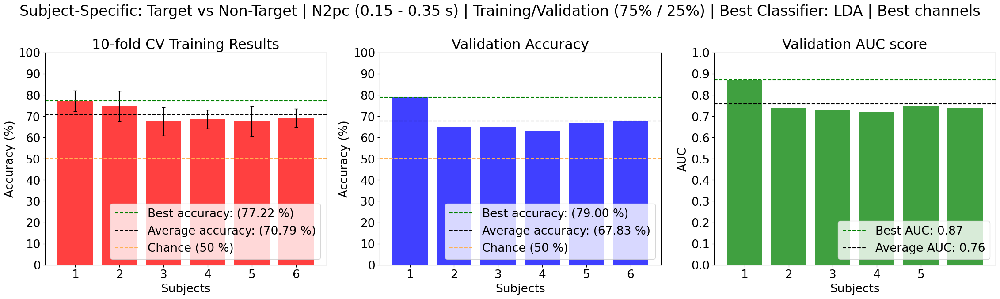

In [75]:
best_classifier = np.argmax(np.mean(perSubj_accuracy, axis = 0))

fig, ax = plt.subplots(nrows = 1,
                       ncols = 3,
                       figsize=(23, 7))

fig.suptitle(f'Subject-Specific: Target vs Non-Target | N2pc ({ts} - {te} s) | Training/Validation (75% / 25%) | Best Classifier: {class_list[best_classifier]} | Best channels', fontsize=24)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 19})
ax[0].bar(np.arange(1, NUM_SUBJ + 1), 
       perSubj_cross_val_scores[:,best_classifier, 0], 
       color="red", 
       yerr = perSubj_cross_val_scores[:,best_classifier, 1], 
       capsize=3,
       alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(perSubj_cross_val_scores[:,best_classifier, 0]), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(perSubj_cross_val_scores[:,best_classifier, 0]):.2f} %)')

ax[0].axhline(y = np.mean(perSubj_cross_val_scores[:,best_classifier, 0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(perSubj_cross_val_scores[:,best_classifier, 0]):.2f} %)')

ax[0].axhline(y=50, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (50 %)')

ax[0].set(xticks = np.arange(1, NUM_SUBJ + 1), 
         xlabel = 'Subjects', 
         yticks=np.arange(0, 101, step=10), 
         ylabel='Accuracy (%)',
         title=f'{KFOLD}-fold CV Training Results');

ax[0].legend(loc='lower right');


# -------------- Prediction Accuracy --------------

ax[1].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_accuracy[:,best_classifier], 
          color="b",
          alpha = 0.75)

ax[1].set_title('Accuracy (%)')

ax[1].axhline(y = max(perSubj_accuracy[:,best_classifier]), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(perSubj_accuracy[:,best_classifier]):.2f} %)')

ax[1].axhline(y = np.mean(perSubj_accuracy[:,best_classifier]), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy[:,best_classifier]):.2f} %)')

ax[1].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50 %)')

ax[1].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 101, step=10), 
          ylabel='Accuracy (%)',
          title="Validation Accuracy");

ax[1].legend(loc='lower right');


# -------------- Aread Under the Curve (AUC) --------------

ax[2].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_auc_scores[:, best_classifier], 
          color="g",
          alpha = 0.75)

ax[2].set_title('AUC ')

ax[2].axhline(y = max(perSubj_auc_scores[:, best_classifier]), 
              color='green', linestyle='--', 
              label = f'Best AUC: {max(perSubj_auc_scores[:, best_classifier]):.2f}')

ax[2].axhline(y = np.mean(perSubj_auc_scores[:, best_classifier]), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: {np.mean(perSubj_auc_scores[:, best_classifier]):.2f}')

ax[2].set(xticks = np.arange(1, 5 + 1), 
          xlabel = 'Subjects', 
          yticks=np.arange(0, 1.01, step=0.1), ylabel='AUC',
          title="Validation AUC score");

ax[2].legend(loc='lower right');
plt.tight_layout()

In [76]:
N2pc_TargetvsNonTarget_bestElec_Folder = "C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_Target_vs_NonTarget_N2pc_BestElectrodesIndices/"

# Create the folder (raises an error if it already exists)
try:
  os.mkdir(N2pc_TargetvsNonTarget_bestElec_Folder)
  print(f"Folder created successfully at: {N2pc_TargetvsNonTarget_bestElec_Folder}")
except FileExistsError:
  print(f"Folder already exists at: {N2pc_TargetvsNonTarget_bestElec_Folder}")

N2pc_TargetvsNonTarget_bestFeat_models_Folder = "C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_Target_vs_NonTarget_N2pc_BestElectrodes/"

# Create the folder (raises an error if it already exists)
try:
  os.mkdir(N2pc_TargetvsNonTarget_bestFeat_models_Folder)
  print(f"Folder created successfully at: {N2pc_TargetvsNonTarget_bestFeat_models_Folder}")
except FileExistsError:
  print(f"Folder already exists at: {N2pc_TargetvsNonTarget_bestFeat_models_Folder}")

Folder already exists at: C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_N2pc_Target_vs_NonTarget_bestElectrodes/
Folder already exists at: C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_N2pc_bestFeat_Target_vs_NonTarget/


In [77]:
perSubj_optim_params = [{'shrinkage': 'auto', 'solver': 'eigen', 'tol': 0.1},
                        {'shrinkage': 0.001, 'solver': 'eigen', 'tol': 0.1},
                        {'shrinkage': 0.01, 'solver': 'eigen', 'tol': 0.1},
                        {'shrinkage': 'auto', 'solver': 'eigen', 'tol': 0.1},
                        {'shrinkage': 'auto', 'solver': 'eigen', 'tol': 0.1},
                        {'shrinkage': None, 'solver': 'lsqr', 'tol': 0.1}]

In [79]:
import joblib

In [80]:
bestModel_Subj_cross_val_scores = np.zeros((NUM_SUBJ, 2))

for subj in range(NUM_SUBJ):

    train = np.vstack((all_norm_train_featVect[subj], 
                       all_norm_test_featVect[subj])) # All data stacked

    np.random.seed(42)
    np.random.shuffle(train)

    # -------------------------- SVM --------------------------

    best_N2pc_clf = LDA()
    best_N2pc_clf.set_params(**perSubj_optim_params[subj])

    # --------- Cross Validation Scores ---------
    scores = cross_val_score(best_N2pc_clf, 
                             train[:, all_best_channel_feat_idx[subj]], 
                             train[:, -1], 
                             cv = KFOLD)
    
    bestModel_Subj_cross_val_scores[subj, 0] = (scores.mean() * 100)
    bestModel_Subj_cross_val_scores[subj, 1] = (scores.std() * 100)

    # --------- Train Model ---------
    best_N2pc_clf.fit(train[:, all_best_channel_feat_idx[subj]], 
                         train[:, -1])
    
    joblib.dump(all_best_channel_feat_idx[subj], f'{N2pc_TargetvsNonTarget_bestElec_Folder}Subj_0{subj + 1}_N2pc_bestElec.pkl')
    joblib.dump(best_N2pc_clf, f'{N2pc_TargetvsNonTarget_bestFeat_models_Folder}Subj_0{subj + 1}_N2pc_model.pkl')
    
    del best_N2pc_clf

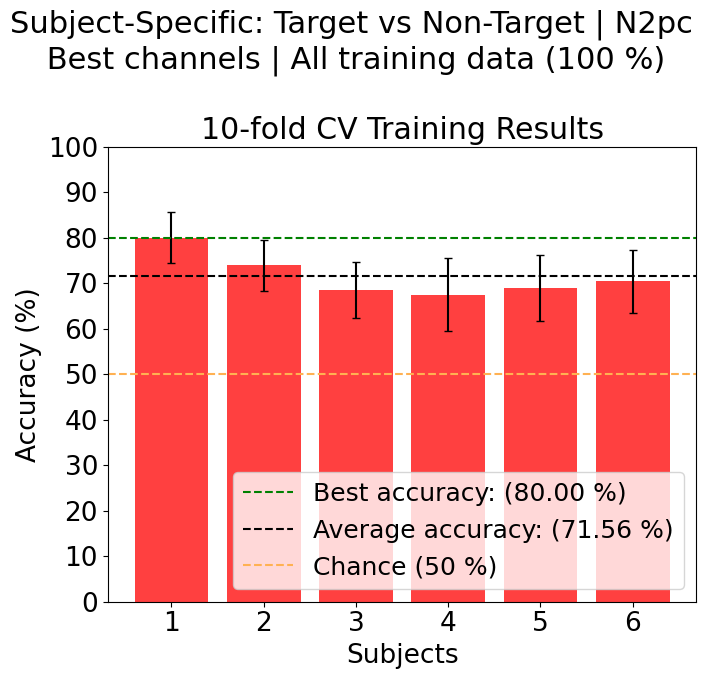

In [81]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 1,
                       figsize=(7.34, 7))

fig.suptitle(f'Subject-Specific: Target vs Non-Target | N2pc \n Best channels | All training data (100 %) ', fontsize=22)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 18})
ax.bar(np.arange(1, NUM_SUBJ + 1), 
       bestModel_Subj_cross_val_scores[:, 0], 
       color="red", 
       yerr = bestModel_Subj_cross_val_scores[:, 1], 
       capsize=3,
       alpha = 0.75)

ax.set_title('Accuracy (%)')

ax.axhline(y = max(bestModel_Subj_cross_val_scores[:, 0]), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(bestModel_Subj_cross_val_scores[:, 0]):.2f} %)')

ax.axhline(y = np.mean(bestModel_Subj_cross_val_scores[:, 0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(bestModel_Subj_cross_val_scores[:, 0]):.2f} %)')

ax.axhline(y=50, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (50 %)')

ax.set(xticks = np.arange(1, NUM_SUBJ + 1), 
         xlabel = 'Subjects', 
         yticks=np.arange(0, 101, step=10), 
         ylabel='Accuracy (%)',
         title=f'{KFOLD}-fold CV Training Results');

ax.legend(loc='lower right');
plt.tight_layout()

## Classification (All Features N2pc)

In [82]:
print("========================== All channels ==========================\n")

perSubj_cross_val_scores = np.zeros((NUM_SUBJ, 5, 2))
perSubj_accuracy = np.zeros((NUM_SUBJ, 5)) # 5 Classifiers
perSubj_auc_scores = np.zeros((NUM_SUBJ, 5))
perSubj_fitting_periods = np.zeros((NUM_SUBJ, 5))

for subj in range(NUM_SUBJ):

    print(f"\n------------------ Subject {subj + 1}: Classifying Target vs Non-Target ------------------\n")

    for c_count, clf in enumerate(classifiers):

        print(f"\n------------------ Classifier: {clf} ------------------")

        n2pc_clf = clf

        # --------- Cross Validation Scores ---------
        cross_val_scores, best_n2pc_clf = GridSearch(classifier_params[c_count], 
                                                     n2pc_clf, 
                                                     KFOLD, 
                                                     all_norm_train_featVect[subj][:,0:-1],
                                                     all_norm_train_featVect[subj][:,-1])
        
        perSubj_cross_val_scores[subj, c_count, 0] = cross_val_scores[0]
        perSubj_cross_val_scores[subj, c_count, 1] = cross_val_scores[1]
        perSubj_fitting_periods[subj, c_count] = cross_val_scores[2]

        # --------- Predictions ---------
        pred = best_n2pc_clf.predict(all_norm_test_featVect[subj][:,0:-1])
        perSubj_accuracy[subj, c_count] = round(accuracy_score(all_norm_test_featVect[subj][:, -1], pred), 2) * 100
        print(round(accuracy_score(all_norm_test_featVect[subj][:, -1], pred), 2) * 100)


        # Compute AUC for each subject
        perSubj_auc_scores[subj, c_count] = round(roc_auc_score(all_norm_test_featVect[subj][:, -1], best_n2pc_clf.predict_proba(all_norm_test_featVect[subj][:,0:-1])[:,1]), 2)

        del n2pc_clf, best_n2pc_clf # Ensures no mixing of classifiers within the loop

========================== All channels ==========================


------------------ Subject 1: Classifying Target vs Non-Target ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.01, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.7472222222222222

Running Grid Search for method: rbf

Best parameters: {'C': 10, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.01}
Best score: 0.7527777777777777

Running Grid Search for method: poly

Best parameters: {'C': 0.001, 'cache_size': 200, 'degree': 3, 'gamma': 0.1, 'kernel': 'poly', 'random_state': 42, 'tol': 0.01}
Best score: 0.7166666666666667

Running Grid Search for method: sigmoid

Best parameters: {'C': 200, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.7527777777777778
82.0

------------------ Classifi

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.5, 'n_estimators': 50, 'random_state': 42}
Best score: 0.7472222222222222
76.0

------------------ Subject 2: Classifying Target vs Non-Target ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.1, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.7388888888888889

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.6861111111111111

Running Grid Search for method: poly

Best parameters: {'C': 1, 'cache_size': 200, 'degree': 3, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.01}
Best score: 0.7222222222222221

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.01}
Best score: 0.6777777

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 1.0, 'n_estimators': 200, 'random_state': 42}
Best score: 0.6694444444444445
56.99999999999999

------------------ Subject 3: Classifying Target vs Non-Target ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.1, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.6888888888888889

Running Grid Search for method: rbf

Best parameters: {'C': 10, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.01}
Best score: 0.6805555555555556

Running Grid Search for method: poly

Best parameters: {'C': 1, 'cache_size': 200, 'degree': 3, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.6472222222222223

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.01}
Best s

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.1, 'n_estimators': 100, 'random_state': 42}
Best score: 0.6305555555555556
62.0

------------------ Subject 4: Classifying Target vs Non-Target ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.01, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.001}
Best score: 0.6916666666666667

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.6361111111111112

Running Grid Search for method: poly

Best parameters: {'C': 1, 'cache_size': 200, 'degree': 3, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.01}
Best score: 0.5944444444444443

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.69444

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.5, 'n_estimators': 50, 'random_state': 42}
Best score: 0.6222222222222222
61.0

------------------ Subject 5: Classifying Target vs Non-Target ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.1, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.6333333333333334

Running Grid Search for method: rbf

Best parameters: {'C': 10, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.01}
Best score: 0.663888888888889

Running Grid Search for method: poly

Best parameters: {'C': 0.001, 'cache_size': 200, 'degree': 3, 'gamma': 0.1, 'kernel': 'poly', 'random_state': 42, 'tol': 0.001}
Best score: 0.6222222222222221

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.01}
Best score: 0.6472

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 1.0, 'n_estimators': 100, 'random_state': 42}
Best score: 0.6138888888888889
56.00000000000001

------------------ Subject 6: Classifying Target vs Non-Target ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: linear

Best parameters: {'C': 0.001, 'cache_size': 200, 'kernel': 'linear', 'random_state': 42, 'tol': 0.01}
Best score: 0.6972222222222222

Running Grid Search for method: rbf

Best parameters: {'C': 0.1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.6833333333333333

Running Grid Search for method: poly

Best parameters: {'C': 1, 'cache_size': 200, 'degree': 3, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.001}
Best score: 0.6777777777777778

Running Grid Search for method: sigmoid

Best parameters: {'C': 0.1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.001}

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.1, 'n_estimators': 100, 'random_state': 42}
Best score: 0.6722222222222223
63.0


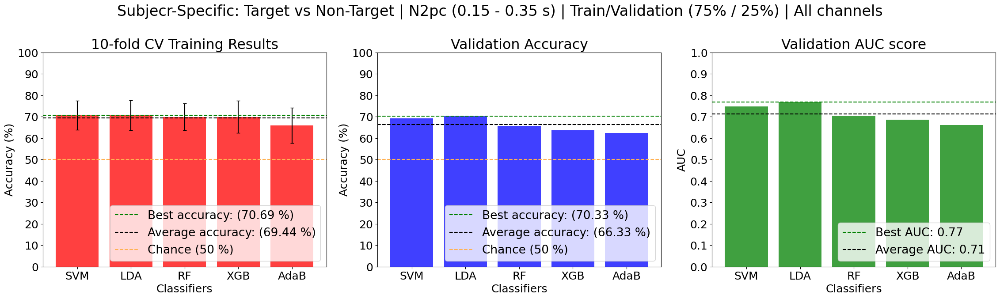

In [83]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 3,
                       figsize=(23, 7))

fig.suptitle(f'Subjecr-Specific: Target vs Non-Target | N2pc ({ts} - {te} s) | Train/Validation (75% / 25%) | All channels', fontsize=24)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 19})
ax[0].bar(np.arange(1, 6), 
       np.mean(perSubj_cross_val_scores[:,:,0], axis = 0 ), 
       color="red", 
       yerr = np.mean(perSubj_cross_val_scores[:,:,1], axis = 0), 
       capsize=3,
       alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(np.mean(perSubj_cross_val_scores[:,:,0], axis = 0)), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(np.mean(perSubj_cross_val_scores[:,:,0], axis = 0)):.2f} %)')

ax[0].axhline(y = np.mean(perSubj_cross_val_scores[:,:,0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(perSubj_cross_val_scores[:,:,0]):.2f} %)')

ax[0].axhline(y=50, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (50 %)')

ax[0].set(xticks = np.arange(1, 5 + 1), 
       xticklabels = class_list,
       xlabel = 'Classifiers', 
       yticks=np.arange(0, 101, step=10), ylabel='Accuracy (%)',
       title=f'{KFOLD}-fold CV Training Results');

ax[0].legend(loc='lower right');


# -------------- Prediction Accuracy --------------

ax[1].bar(np.arange(1, 6), 
          np.mean(perSubj_accuracy, axis = 0 ), 
          color="b",
          alpha = 0.75)

ax[1].set_title('Accuracy (%)')

ax[1].axhline(y = max(np.mean(perSubj_accuracy, axis = 0)), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(np.mean(perSubj_accuracy, axis = 0)):.2f} %)')

ax[1].axhline(y = np.mean(perSubj_accuracy), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy):.2f} %)')

ax[1].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50 %)')

ax[1].set(xticks = np.arange(1, 5 + 1), 
          xticklabels = class_list,
          xlabel = 'Classifiers', 
          yticks=np.arange(0, 101, step=10), ylabel='Accuracy (%)',
          title="Validation Accuracy");

ax[1].legend(loc='lower right');


# -------------- Aread Under the Curve (AUC) --------------

ax[2].bar(np.arange(1, 6), 
          np.mean(perSubj_auc_scores, axis = 0 ), 
          color="g",
          alpha = 0.75)

ax[2].set_title('AUC ')

ax[2].axhline(y = max(np.mean(perSubj_auc_scores, axis = 0)), 
              color='green', linestyle='--', 
              label = f'Best AUC: {max(np.mean(perSubj_auc_scores, axis = 0)):.2f}')

ax[2].axhline(y = np.mean(perSubj_auc_scores), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: {np.mean(perSubj_auc_scores):.2f}')

ax[2].set(xticks = np.arange(1, 5 + 1), 
          xticklabels = class_list,
          xlabel = 'Classifiers', 
          yticks=np.arange(0, 1.01, step=0.1), ylabel='AUC',
          title="Validation AUC score");

ax[2].legend(loc='lower right');
plt.tight_layout()

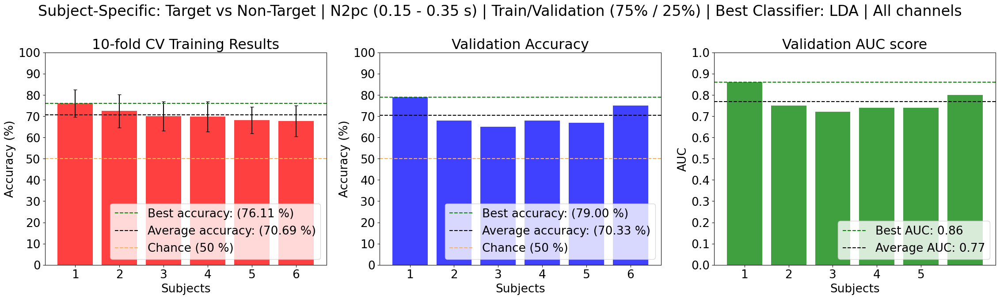

In [84]:
best_classifier = np.argmax(np.mean(perSubj_accuracy, axis = 0))

fig, ax = plt.subplots(nrows = 1,
                       ncols = 3,
                       figsize=(23, 7))

fig.suptitle(f'Subject-Specific: Target vs Non-Target | N2pc ({ts} - {te} s) | Train/Validation (75% / 25%) | Best Classifier: {class_list[best_classifier]} | All channels', fontsize=24)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 19})
ax[0].bar(np.arange(1, NUM_SUBJ + 1), 
       perSubj_cross_val_scores[:,best_classifier, 0], 
       color="red", 
       yerr = perSubj_cross_val_scores[:,best_classifier, 1], 
       capsize=3,
       alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(perSubj_cross_val_scores[:,best_classifier, 0]), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(perSubj_cross_val_scores[:,best_classifier, 0]):.2f} %)')

ax[0].axhline(y = np.mean(perSubj_cross_val_scores[:,best_classifier, 0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(perSubj_cross_val_scores[:,best_classifier, 0]):.2f} %)')

ax[0].axhline(y=50, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (50 %)')

ax[0].set(xticks = np.arange(1, NUM_SUBJ + 1), 
         xlabel = 'Subjects', 
         yticks=np.arange(0, 101, step=10), 
         ylabel='Accuracy (%)',
         title=f'{KFOLD}-fold CV Training Results');

ax[0].legend(loc='lower right');


# -------------- Prediction Accuracy --------------

ax[1].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_accuracy[:,best_classifier], 
          color="b",
          alpha = 0.75)

ax[1].set_title('Accuracy (%)')

ax[1].axhline(y = max(perSubj_accuracy[:,best_classifier]), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(perSubj_accuracy[:,best_classifier]):.2f} %)')

ax[1].axhline(y = np.mean(perSubj_accuracy[:,best_classifier]), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy[:,best_classifier]):.2f} %)')

ax[1].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50 %)')

ax[1].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 101, step=10), 
          ylabel='Accuracy (%)',
          title="Validation Accuracy");

ax[1].legend(loc='lower right');


# -------------- Aread Under the Curve (AUC) --------------

ax[2].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_auc_scores[:, best_classifier], 
          color="g",
          alpha = 0.75)

ax[2].set_title('AUC ')

ax[2].axhline(y = max(perSubj_auc_scores[:, best_classifier]), 
              color='green', linestyle='--', 
              label = f'Best AUC: {max(perSubj_auc_scores[:, best_classifier]):.2f}')

ax[2].axhline(y = np.mean(perSubj_auc_scores[:, best_classifier]), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: {np.mean(perSubj_auc_scores[:, best_classifier]):.2f}')

ax[2].set(xticks = np.arange(1, 5 + 1), 
          xlabel = 'Subjects', 
          yticks=np.arange(0, 1.01, step=0.1), ylabel='AUC',
          title="Validation AUC score");

ax[2].legend(loc='lower right');
plt.tight_layout()

In [86]:
N2pc_models_Folder = "C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_Target_vs_NonTarget_N2pc_AllElectrodes/"

# Create the folder (raises an error if it already exists)
try:
  os.mkdir(N2pc_models_Folder)
  print(f"Folder created successfully at: {N2pc_models_Folder}")
except FileExistsError:
  print(f"Folder already exists at: {N2pc_models_Folder}")

Folder already exists at: C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_N2pc_Target_vs_NonTarget_allFeat/


In [87]:
perSubj_optim_params = [{'shrinkage': 'auto', 'solver': 'eigen', 'tol': 0.1},
                        {'shrinkage': 'auto', 'solver': 'eigen', 'tol': 0.1},
                        {'shrinkage': 'auto', 'solver': 'eigen', 'tol': 0.1},
                        {'shrinkage': 'auto', 'solver': 'eigen', 'tol': 0.1},
                        {'shrinkage': 'auto', 'solver': 'eigen', 'tol': 0.1},
                        {'shrinkage': 'auto', 'solver': 'eigen', 'tol': 0.1}]

In [88]:
bestModel_Subj_cross_val_scores = np.zeros((NUM_SUBJ, 2))

for subj in range(NUM_SUBJ):

    train = np.vstack((all_norm_train_featVect[subj], all_norm_test_featVect[subj])) # All data stacked

    np.random.seed(42)
    np.random.shuffle(train)

    # -------------------------- SVM --------------------------
    
    n2pc_target = LDA()
    n2pc_target.set_params(**perSubj_optim_params[subj])

    # --------- Cross Validation Scores ---------
    scores = cross_val_score(n2pc_target, 
                             train[:, 0:-1], 
                             train[:, -1], 
                             cv = KFOLD)
    
    bestModel_Subj_cross_val_scores[subj, 0] = (scores.mean() * 100)
    bestModel_Subj_cross_val_scores[subj, 1] = (scores.std() * 100)

    # --------- Train Model ---------
    n2pc_target.fit(train[:, 0:-1], 
                      train[:, -1])
    
    joblib.dump(n2pc_target, f'{N2pc_models_Folder}Subj_0{subj + 1}_N2pc_model.pkl')
    
    del n2pc_target

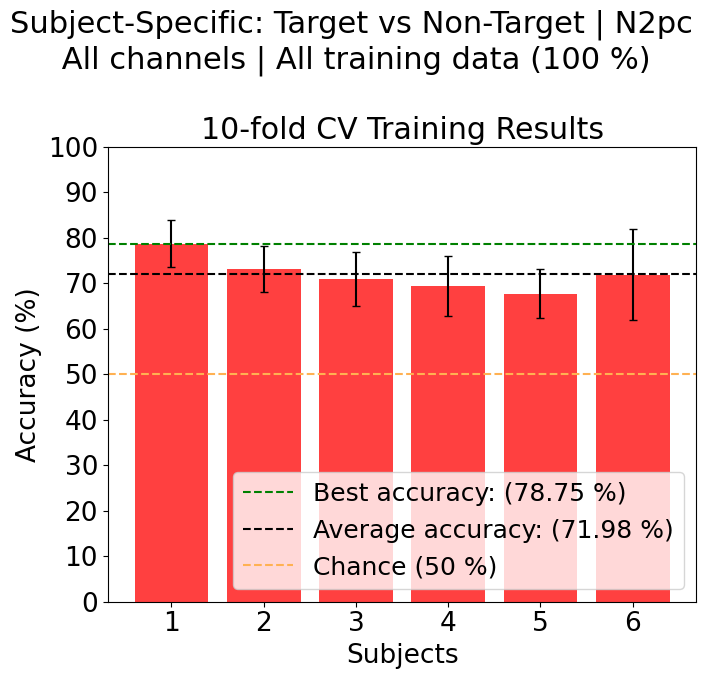

In [89]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 1,
                       figsize=(7.34, 7))

fig.suptitle(f'Subject-Specific: Target vs Non-Target | N2pc \n All channels | All training data (100 %) ', fontsize=22)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 18})
ax.bar(np.arange(1, NUM_SUBJ + 1), 
       bestModel_Subj_cross_val_scores[:, 0], 
       color="red", 
       yerr = bestModel_Subj_cross_val_scores[:, 1], 
       capsize=3,
       alpha = 0.75)

ax.set_title('Accuracy (%)')

ax.axhline(y = max(bestModel_Subj_cross_val_scores[:, 0]), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(bestModel_Subj_cross_val_scores[:, 0]):.2f} %)')

ax.axhline(y = np.mean(bestModel_Subj_cross_val_scores[:, 0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(bestModel_Subj_cross_val_scores[:, 0]):.2f} %)')

ax.axhline(y=50, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (50 %)')

ax.set(xticks = np.arange(1, NUM_SUBJ + 1), 
         xlabel = 'Subjects', 
         yticks=np.arange(0, 101, step=10), 
         ylabel='Accuracy (%)',
         title=f'{KFOLD}-fold CV Training Results');

ax.legend(loc='lower right');
plt.tight_layout()

### Generalized N2pc - Target vs Non-Target model

In [70]:
for subj in range(1, NUM_SUBJ):

    if (subj == 1):
        stacked_norm_train_featVectors = np.vstack((all_norm_train_featVect[subj - 1], all_norm_train_featVect[subj]))
        stacked_norm_test_featVectors = np.vstack((all_norm_test_featVect[subj - 1], all_norm_test_featVect[subj]))
    else:
        stacked_norm_train_featVectors = np.vstack((stacked_norm_train_featVectors, all_norm_train_featVect[subj]))
        stacked_norm_test_featVectors = np.vstack((stacked_norm_test_featVectors, all_norm_test_featVect[subj]))

np.random.seed(42)
np.random.shuffle(stacked_norm_train_featVectors)
np.random.seed(42)
np.random.shuffle(stacked_norm_test_featVectors)

In [103]:
stackedSubj_cross_val_scores = np.zeros((len(classifiers), 2))
stackedSubj_accuracy = []
stackedSubj_auc_scores = []

for c_count, clf in enumerate(classifiers):

    print(f"\n------------------ Classifier: {clf} ------------------")

    gen_n2pc_clf = clf

    # --------- Cross Validation Scores ---------
    cross_val_scores, best_gen_n2pc_clf = GridSearch(classifier_params[c_count], 
                                                        gen_n2pc_clf, 
                                                        KFOLD, 
                                                        stacked_norm_train_featVectors[:,0:-1],
                                                        stacked_norm_train_featVectors[:,-1])
    
    stackedSubj_cross_val_scores[c_count, 0] = cross_val_scores[0]
    stackedSubj_cross_val_scores[c_count, 1] = cross_val_scores[1]

    # --------- Predictions ---------
    pred = best_gen_n2pc_clf.predict(stacked_norm_test_featVectors[:, 0:-1])
    stackedSubj_accuracy.append( round(accuracy_score(stacked_norm_test_featVectors[:, -1], pred), 2) * 100 )

    # Compute AUC for each subject
    stackedSubj_auc_scores.append( round(roc_auc_score(stacked_norm_test_featVectors[:, -1], best_gen_n2pc_clf.predict_proba(stacked_norm_test_featVectors[:, 0:-1])[:,1]), 2))

    del gen_n2pc_clf, best_gen_n2pc_clf # Ensures no mixing of classifiers within the loop


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.01}
Best score: 0.6476851851851851

Running Grid Search for method: poly

Best parameters: {'C': 1, 'cache_size': 200, 'degree': 3, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.01}
Best score: 0.6587962962962963

Running Grid Search for method: sigmoid

Best parameters: {'C': 0.1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.6287037037037037

------------------ Classifier: LinearDiscriminantAnalysis() ------------------

Running Grid Search for method: svd

Best parameters: {'solver': 'svd'}
Best score: 0.6328703703703704

Running Grid Search for method: lsqr

Best parameters: {'shrinkage': 'auto', 'solver': 'lsqr', 'tol': 0.1}
Best score: 0.6449074074074073

Running Grid Search for method: eige

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.5, 'n_estimators': 100, 'random_state': 42}
Best score: 0.6305555555555556


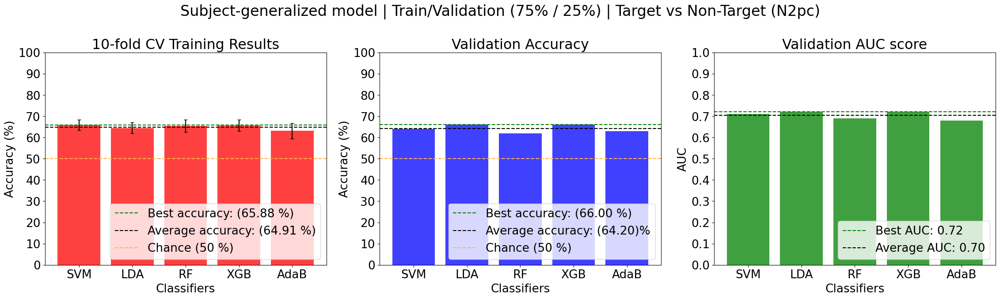

In [105]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 3,
                       figsize=(23, 7))

fig.suptitle(f'Subject-generalized model | Train/Validation (75% / 25%) | Target vs Non-Target (N2pc)', fontsize=24)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 19})
ax[0].bar(np.arange(1, 6), 
          stackedSubj_cross_val_scores[:,0], 
          color="red", 
          yerr = stackedSubj_cross_val_scores[:,1], 
          capsize=3,
          alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(stackedSubj_cross_val_scores[:,0]), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(stackedSubj_cross_val_scores[:,0]):.2f} %)')

ax[0].axhline(y = np.mean(stackedSubj_cross_val_scores[:,0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(stackedSubj_cross_val_scores[:,0]):.2f} %)')

ax[0].axhline(y=50, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (50 %)')

ax[0].set(xticks = np.arange(1, 5 + 1), 
          xticklabels = class_list,
          xlabel = 'Classifiers', 
          yticks=np.arange(0, 101, step=10), ylabel='Accuracy (%)',
          title=f'{KFOLD}-fold CV Training Results');

ax[0].legend(loc='lower right');


# -------------- Prediction Accuracy --------------

ax[1].bar(np.arange(1, 6), 
          stackedSubj_accuracy, 
          color="b",
          alpha = 0.75)

ax[1].set_title('Accuracy (%)')

ax[1].axhline(y = max(stackedSubj_accuracy), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(stackedSubj_accuracy):.2f} %)')

ax[1].axhline(y = np.mean(stackedSubj_accuracy), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(stackedSubj_accuracy):.2f})%')

ax[1].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50 %)')

ax[1].set(xticks = np.arange(1, 5 + 1), 
          xticklabels = class_list,
          xlabel = 'Classifiers', 
          yticks=np.arange(0, 101, step=10), ylabel='Accuracy (%)',
          title="Validation Accuracy");

ax[1].legend(loc='lower right');


# -------------- Aread Under the Curve (AUC) --------------

ax[2].bar(np.arange(1, 6), 
          stackedSubj_auc_scores, 
          color="g",
          alpha = 0.75)

ax[2].set_title('AUC ')

ax[2].axhline(y = max(stackedSubj_auc_scores), 
              color='green', linestyle='--', 
              label = f'Best AUC: {max(stackedSubj_auc_scores):.2f}')

ax[2].axhline(y = np.mean(stackedSubj_auc_scores), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: {np.mean(stackedSubj_auc_scores):.2f}')

ax[2].set(xticks = np.arange(1, 6), 
          xticklabels = class_list,
          xlabel = 'Classifiers', 
          yticks=np.arange(0, 1.01, step=0.1), ylabel='AUC',
          title="Validation AUC score");

ax[2].legend(loc='lower right');
plt.tight_layout()

In [71]:
N2pc_AGI_models_Folder = "C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SG_Target_vs_NonTarget_N2pc/"

# Create the folder (raises an error if it already exists)
try:
  os.mkdir(N2pc_AGI_models_Folder)
  print(f"Folder created successfully at: {N2pc_AGI_models_Folder}")
except FileExistsError:
  print(f"Folder already exists at: {N2pc_AGI_models_Folder}")

Folder already exists at: C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/Generalized_N2pc_Target_vs_NonTarget/


In [73]:
import joblib

In [75]:
all_train = np.vstack((stacked_norm_train_featVectors, stacked_norm_test_featVectors))

# -------------------------- Random Forest --------------------------
gen_n2pc_clf3 = LDA(shrinkage = 'auto', solver = 'eigen', tol= 0.1)

# --------- Cross Validation Scores ---------
scores = cross_val_score(gen_n2pc_clf3, 
                         all_train[:, 0:-1], 
                         all_train[:, -1], 
                         cv = KFOLD)

print("10 fold mean Accuracy: ", scores.mean() * 100)
print("10 fold std Accuracy: ", scores.std() * 100)


# --------- Train Model ---------
gen_n2pc_clf3.fit(all_train[:, 0:-1], 
                     all_train[:, -1])

joblib.dump(gen_n2pc_clf3, f'{N2pc_AGI_models_Folder}Gen_N2pc_P3_model.pkl')

10 fold mean Accuracy:  65.83333333333334
10 fold std Accuracy:  2.2135246459040583


['C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/Generalized_N2pc_Target_vs_NonTarget/Gen_N2pc_P3_model.pkl']

## Train/Validation Split (N2pc and P3)

In [111]:
all_train_featVect = []
all_test_featVect = []

for subj in range(NUM_SUBJ):

    train_featVect = np.vstack((all_featTarget[subj][:n_train], all_featNonTarget[subj][:n_train]))
    test_featVect = np.vstack((all_featTarget[subj][n_train:], all_featNonTarget[subj][n_train:]))

    np.random.seed(42)
    np.random.shuffle(train_featVect)
    np.random.seed(42)
    np.random.shuffle(test_featVect)

    all_train_featVect.append(train_featVect)
    all_test_featVect.append(test_featVect)

## Row-wise normalization of the feature vector (N2pc and P3)


In [112]:
# Feature wise normalization of feature vector

all_norm_train_featVect = []
all_norm_test_featVect = []

ROW_WISE_NORM = True

for subj in range(NUM_SUBJ):

    if(ROW_WISE_NORM):  

        n_entries = np.size(all_train_featVect, 1)

        norm_train_featVect = []

        for j in range(n_entries):

            mean = np.mean(all_train_featVect[subj][j, 0:-1])
            std = np.std(all_train_featVect[subj][j, 0:-1])
            norm_train_featVect.append(np.hstack(((all_train_featVect[subj][j,0:-1] - mean) / std, all_train_featVect[subj][j, -1])))


        n_entries = np.size(all_test_featVect, 1)

        norm_test_featVect = []

        for u in range(n_entries):

            mean = np.mean(all_test_featVect[subj][u,0:-1])
            std = np.std(all_test_featVect[subj][u,0:-1])
            norm_test_featVect.append(np.hstack(((all_test_featVect[subj][u,0:-1] - mean) / std, all_test_featVect[subj][u, -1])))

        train_featVect = np.array(norm_train_featVect)
        test_featVect = np.array(norm_test_featVect)

    all_norm_train_featVect.append(train_featVect)
    all_norm_test_featVect.append(test_featVect)

print(np.shape(all_norm_train_featVect))
print(np.shape(all_norm_test_featVect))

(6, 360, 267)
(6, 120, 267)


## MBI (N2pc and P3)

In [114]:
k_feat = N_DATAPOINTS_RESA_FREQ_N2PC * 9

all_best_feat_idx = []

for subj in range(NUM_SUBJ):

    best_feat_idx = SelectKBest(mutual_info_classif, k = k_feat).fit(all_norm_train_featVect[subj][:,0:-1], all_norm_train_featVect[subj][:,-1]).get_support()
    best_feat_idx = np.append(best_feat_idx, False) # False is because this field is reserved for the Class label and not a feature

    all_best_feat_idx.append(best_feat_idx)
    
print(np.shape(all_best_feat_idx))

(6, 267)


In [116]:
n_ch = len(right_N2pc_ch_idx)*2 + len(P3_ch_idx)

all_tf = []

for subj in range(NUM_SUBJ):

    tf = np.zeros(n_ch)
    cont = np.ones(N_DATAPOINTS_RESA_FREQ_N2PC)

    for i in range(n_ch):
        tf[i] = (np.sum(cont[all_best_feat_idx[subj][i*N_DATAPOINTS_RESA_FREQ_N2PC:i*N_DATAPOINTS_RESA_FREQ_N2PC+N_DATAPOINTS_RESA_FREQ_N2PC]]))

    all_tf.append(tf)

print(np.shape(all_tf))

(6, 19)


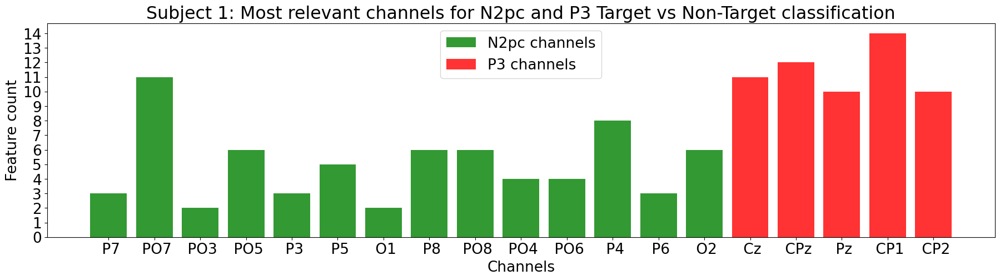

<Figure size 640x480 with 0 Axes>

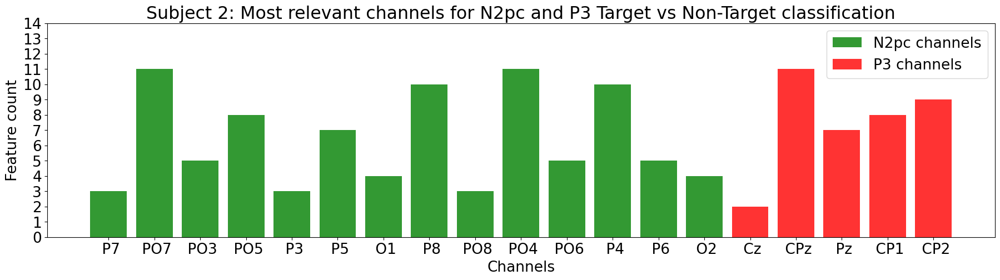

<Figure size 640x480 with 0 Axes>

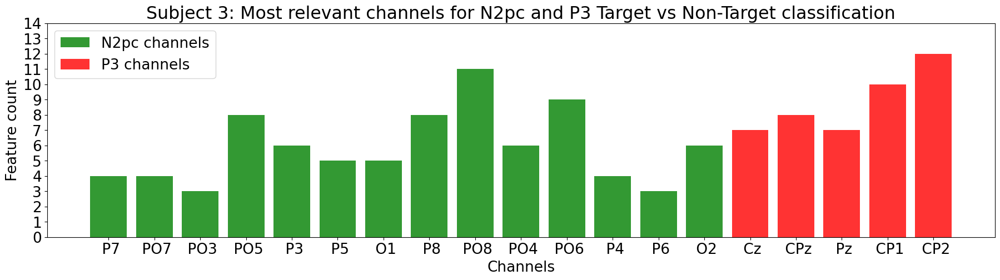

<Figure size 640x480 with 0 Axes>

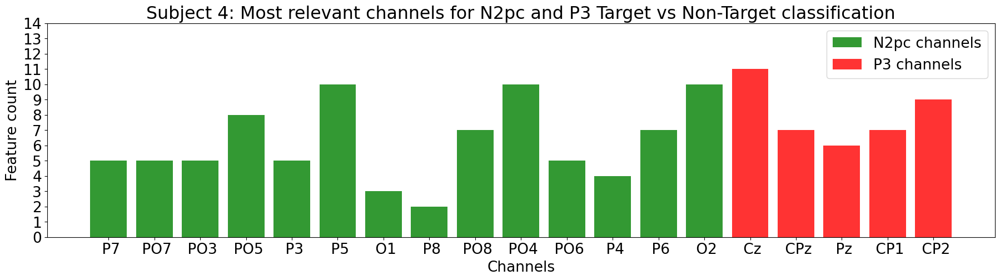

<Figure size 640x480 with 0 Axes>

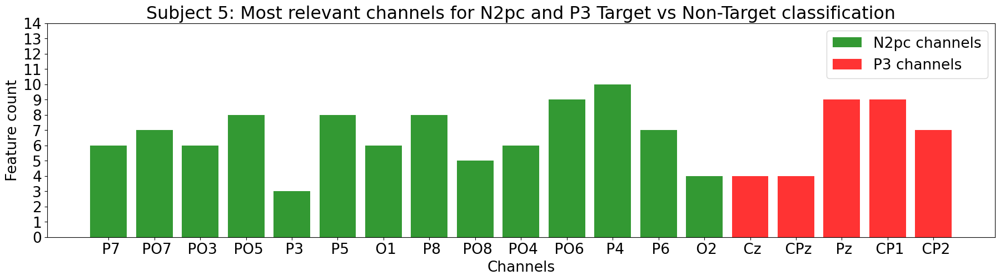

<Figure size 640x480 with 0 Axes>

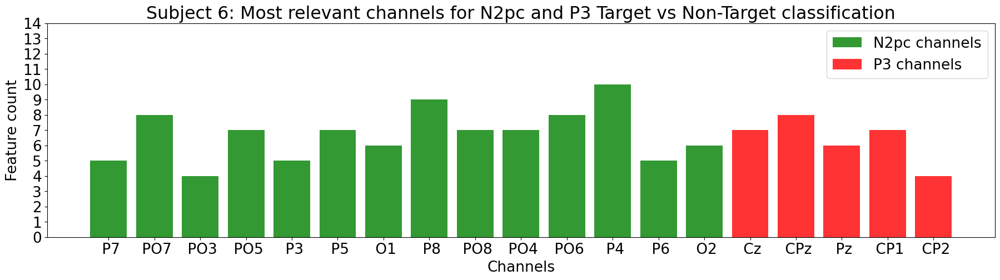

<Figure size 640x480 with 0 Axes>

In [118]:
max_y = np.max(all_tf)

for subj in range(NUM_SUBJ):

    customlb = []
    for c, lb in enumerate(left_N2pc_channels):
        customlb.append(str(lb))

    for c, lb in enumerate(right_N2pc_channels):
        customlb.append(str(lb))

    customlb_P3 = []
    for c, lb in enumerate(P3_ch_idx):
        customlb.append( str(P3_channels[c]))

    x_data_N2pc = np.arange(1, 15)  # Positions for the first 7 bars (N2pc)
    x_data_P3 = np.arange(15, 20)    # Positions for the last 5 bars (P3)

    bar_colors = ['g'] * 14 + ['r'] * 5  # Blue for N2pc, red for P3

    fig, ax = plt.subplots(figsize=(22, 5))

    ax.set_title(f'Subject {subj +1}: Most relevant channels for N2pc and P3 Target vs Non-Target classification')

    ax.bar(x_data_N2pc, 
           all_tf[subj][:14], 
           color=bar_colors[:14], 
           capsize=4, 
           alpha=0.8,
           label = "N2pc channels")
    
    ax.bar(x_data_P3, 
           all_tf[subj][14:], 
           color=bar_colors[14:], 
           capsize=4, 
           alpha=0.8,
           label = "P3 channels")
    
    ax.set(xticks=np.arange(1, n_ch + 1), 
           xlabel='Channels', 
           yticks=np.arange(0, max_y + 1, step=1),
           ylabel = "Feature count")
    
    ax.set_xticklabels(customlb);

    plt.legend()

    plt.show();
    plt.tight_layout()

In [119]:
all_best_channel_feat_idx = []

for subj in range(NUM_SUBJ):

    best_channel_feat_idx = np.zeros(len(best_feat_idx))

    for i in range(len(tf)):
        if(all_tf[subj][i] >= sorted(all_tf[subj], reverse = True)[8]):
            best_channel_feat_idx[i * N_DATAPOINTS_RESA_FREQ_N2PC:i * N_DATAPOINTS_RESA_FREQ_N2PC + N_DATAPOINTS_RESA_FREQ_N2PC] = 1
        else:
            best_channel_feat_idx[i * N_DATAPOINTS_RESA_FREQ_N2PC: i * N_DATAPOINTS_RESA_FREQ_N2PC + N_DATAPOINTS_RESA_FREQ_N2PC] = 0

    best_channel_feat_idx = best_channel_feat_idx != 0 # Convert to boolean

    all_best_channel_feat_idx.append(best_channel_feat_idx)

## Classification (Best Features N2pc and P3)

In [120]:
print("========================== Most discriminative channels ==========================\n")

perSubj_cross_val_scores = np.zeros((NUM_SUBJ, 5, 2))
perSubj_accuracy = np.zeros((NUM_SUBJ, 5)) # 5 Classifiers
perSubj_auc_scores = np.zeros((NUM_SUBJ, 5))
perSubj_fitting_periods = np.zeros((NUM_SUBJ, 5))

for subj in range(NUM_SUBJ):

    print(f"\n------------------ Subject {subj + 1}: Classifying Target vs Non-Target ------------------\n")

    for c_count, clf in enumerate(classifiers):

        print(f"\n------------------ Classifier: {clf} ------------------")

        n2pc_p3_clf = clf

        # --------- Cross Validation Scores ---------
        cross_val_scores, best_n2pc_p3_clf = GridSearch(classifier_params[c_count], 
                                                               n2pc_p3_clf, 
                                                               KFOLD, 
                                                               all_norm_train_featVect[subj][:,all_best_channel_feat_idx[subj]],
                                                               all_norm_train_featVect[subj][:,-1])
        
        perSubj_cross_val_scores[subj, c_count, 0] = cross_val_scores[0]
        perSubj_cross_val_scores[subj, c_count, 1] = cross_val_scores[1]
        perSubj_fitting_periods[subj, c_count] = cross_val_scores[2]

        # --------- Predictions ---------
        pred = best_n2pc_p3_clf.predict(all_norm_test_featVect[subj][:, all_best_channel_feat_idx[subj]])
        perSubj_accuracy[subj, c_count] = round(accuracy_score(all_norm_test_featVect[subj][:, -1], pred), 2) * 100

        # Compute AUC for each subject
        perSubj_auc_scores[subj, c_count] = round(roc_auc_score(all_norm_test_featVect[subj][:, -1], best_n2pc_p3_clf.predict_proba(all_norm_test_featVect[subj][:, all_best_channel_feat_idx[subj]])[:,1]), 2)

        del n2pc_p3_clf, best_n2pc_p3_clf # Ensures no mixing of classifiers within the loop




========================== Most discriminative channels ==========================


------------------ Subject 1: Classifying Target vs Non-Target ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.825

Running Grid Search for method: poly

Best parameters: {'C': 1, 'cache_size': 200, 'degree': 2, 'gamma': 'scale', 'kernel': 'poly', 'random_state': 42, 'tol': 0.01}
Best score: 0.8111111111111112

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.7944444444444445

------------------ Classifier: LinearDiscriminantAnalysis() ------------------

Running Grid Search for method: svd

Best parameters: {'solver': 'svd'}
Best score: 0.8

Running Grid Search for method: lsqr


C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.5, 'n_estimators': 100, 'random_state': 42}
Best score: 0.7722222222222223

------------------ Subject 2: Classifying Target vs Non-Target ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: rbf

Best parameters: {'C': 100, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.7416666666666667

Running Grid Search for method: poly

Best parameters: {'C': 1, 'cache_size': 200, 'degree': 3, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.7555555555555555

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.01}
Best score: 0.7194444444444444

------------------ Classifier: LinearDiscriminantAnalysis() ------------------

Running Grid Search for method: svd

Best parameters: {'solver': 'svd'}
Best score: 

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.5, 'n_estimators': 200, 'random_state': 42}
Best score: 0.7305555555555556

------------------ Subject 3: Classifying Target vs Non-Target ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.8027777777777778

Running Grid Search for method: poly

Best parameters: {'C': 0.001, 'cache_size': 200, 'degree': 2, 'gamma': 0.1, 'kernel': 'poly', 'random_state': 42, 'tol': 0.01}
Best score: 0.7583333333333333

Running Grid Search for method: sigmoid

Best parameters: {'C': 0.1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.001}
Best score: 0.7138888888888888

------------------ Classifier: LinearDiscriminantAnalysis() ------------------

Running Grid Search for method: svd

Best parameters: {'solver': 'svd'}
Best scor

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.5, 'n_estimators': 50, 'random_state': 42}
Best score: 0.7444444444444445

------------------ Subject 4: Classifying Target vs Non-Target ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: rbf

Best parameters: {'C': 10, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.01}
Best score: 0.7555555555555555

Running Grid Search for method: poly

Best parameters: {'C': 1, 'cache_size': 200, 'degree': 2, 'gamma': 'scale', 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.7111111111111111

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'scale', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.6611111111111111

------------------ Classifier: LinearDiscriminantAnalysis() ------------------

Running Grid Search for method: svd

Best parameters: {'solver': 'svd'}
Best score: 

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 1.0, 'n_estimators': 100, 'random_state': 42}
Best score: 0.65

------------------ Subject 5: Classifying Target vs Non-Target ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'scale', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.711111111111111

Running Grid Search for method: poly

Best parameters: {'C': 1, 'cache_size': 200, 'degree': 2, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.6972222222222222

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.001}
Best score: 0.6861111111111111

------------------ Classifier: LinearDiscriminantAnalysis() ------------------

Running Grid Search for method: svd

Best parameters: {'solver': 'svd'}
Best score: 0.6861111111111

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 1.0, 'n_estimators': 200, 'random_state': 42}
Best score: 0.6638888888888889

------------------ Subject 6: Classifying Target vs Non-Target ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: rbf

Best parameters: {'C': 10, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.7444444444444445

Running Grid Search for method: poly

Best parameters: {'C': 0.01, 'cache_size': 200, 'degree': 2, 'gamma': 0.1, 'kernel': 'poly', 'random_state': 42, 'tol': 0.001}
Best score: 0.725

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.01}
Best score: 0.7555555555555555

------------------ Classifier: LinearDiscriminantAnalysis() ------------------

Running Grid Search for method: svd

Best parameters: {'solver': 'svd'}
Best score: 0.6722222222

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.1, 'n_estimators': 100, 'random_state': 42}
Best score: 0.6861111111111111


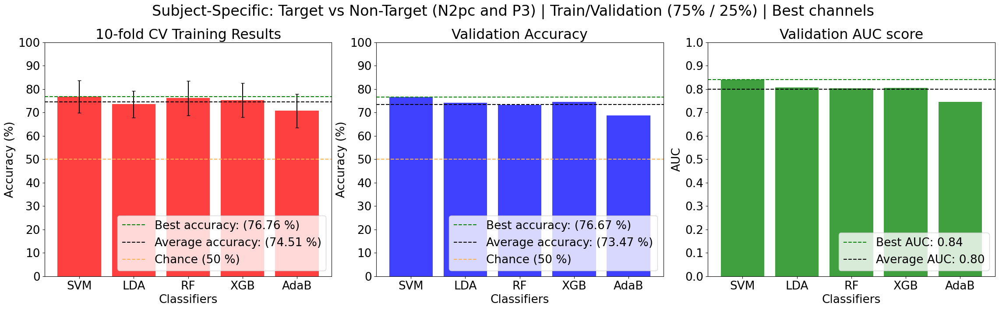

In [122]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 3,
                       figsize=(23, 7))

fig.suptitle(f'Subject-Specific: Target vs Non-Target (N2pc and P3) | Train/Validation (75% / 25%) | Best channels', fontsize=24)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 19})
plt.tight_layout()

ax[0].bar(np.arange(1, 6), 
       np.mean(perSubj_cross_val_scores[:,:,0], axis = 0 ), 
       color="red", 
       yerr = np.mean(perSubj_cross_val_scores[:,:,1], axis = 0), 
       capsize=3,
       alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(np.mean(perSubj_cross_val_scores[:,:,0], axis = 0)), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(np.mean(perSubj_cross_val_scores[:,:,0], axis = 0)):.2f} %)')

ax[0].axhline(y = np.mean(perSubj_cross_val_scores[:,:,0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(perSubj_cross_val_scores[:,:,0]):.2f} %)')

ax[0].axhline(y=50, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (50 %)')

ax[0].set(xticks = np.arange(1, 5 + 1), 
       xticklabels = class_list,
       xlabel = 'Classifiers', 
       yticks=np.arange(0, 101, step=10), ylabel='Accuracy (%)',
       title=f'{KFOLD}-fold CV Training Results');

ax[0].legend(loc='lower right');


# -------------- Prediction Accuracy --------------

ax[1].bar(np.arange(1, 6), 
          np.mean(perSubj_accuracy, axis = 0 ), 
          color="b",
          alpha = 0.75)

ax[1].set_title('Accuracy (%)')

ax[1].axhline(y = max(np.mean(perSubj_accuracy, axis = 0)), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(np.mean(perSubj_accuracy, axis = 0)):.2f} %)')

ax[1].axhline(y = np.mean(perSubj_accuracy), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy):.2f} %)')

ax[1].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50 %)')

ax[1].set(xticks = np.arange(1, 5 + 1), 
          xticklabels = class_list,
          xlabel = 'Classifiers', 
          yticks=np.arange(0, 101, step=10), ylabel='Accuracy (%)',
          title="Validation Accuracy");

ax[1].legend(loc='lower right');


# -------------- Aread Under the Curve (AUC) --------------

ax[2].bar(np.arange(1, 6), 
          np.mean(perSubj_auc_scores, axis = 0 ), 
          color="g",
          alpha = 0.75)

ax[2].set_title('AUC ')

ax[2].axhline(y = max(np.mean(perSubj_auc_scores, axis = 0)), 
              color='green', linestyle='--', 
              label = f'Best AUC: {max(np.mean(perSubj_auc_scores, axis = 0)):.2f}')

ax[2].axhline(y = np.mean(perSubj_auc_scores), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: {np.mean(perSubj_auc_scores):.2f}')

ax[2].set(xticks = np.arange(1, 5 + 1), 
          xticklabels = class_list,
          xlabel = 'Classifiers', 
          yticks=np.arange(0, 1.01, step=0.1), ylabel='AUC',
          title="Validation AUC score");

ax[2].legend(loc='lower right');

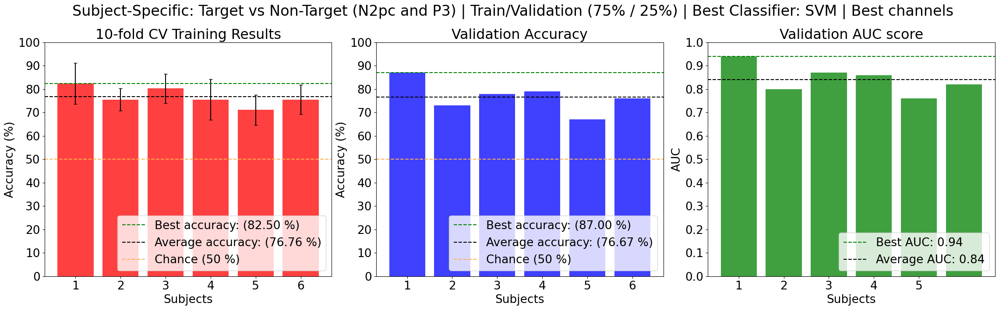

In [123]:
best_classifier = np.argmax(np.mean(perSubj_accuracy, axis = 0))

fig, ax = plt.subplots(nrows = 1,
                       ncols = 3,
                       figsize=(23, 7))

fig.suptitle(f'Subject-Specific: Target vs Non-Target (N2pc and P3) | Train/Validation (75% / 25%) | Best Classifier: {class_list[best_classifier]} | Best channels', fontsize=24)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 19})
plt.tight_layout()

ax[0].bar(np.arange(1, NUM_SUBJ + 1), 
       perSubj_cross_val_scores[:,best_classifier, 0], 
       color="red", 
       yerr = perSubj_cross_val_scores[:,best_classifier, 1], 
       capsize=3,
       alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(perSubj_cross_val_scores[:,best_classifier, 0]), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(perSubj_cross_val_scores[:,best_classifier, 0]):.2f} %)')

ax[0].axhline(y = np.mean(perSubj_cross_val_scores[:,best_classifier, 0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(perSubj_cross_val_scores[:,best_classifier, 0]):.2f} %)')

ax[0].axhline(y=50, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (50 %)')

ax[0].set(xticks = np.arange(1, NUM_SUBJ + 1), 
         xlabel = 'Subjects', 
         yticks=np.arange(0, 101, step=10), 
         ylabel='Accuracy (%)',
         title=f'{KFOLD}-fold CV Training Results');

ax[0].legend(loc='lower right');


# -------------- Prediction Accuracy --------------

ax[1].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_accuracy[:,best_classifier], 
          color="b",
          alpha = 0.75)

ax[1].set_title('Accuracy (%)')

ax[1].axhline(y = max(perSubj_accuracy[:,best_classifier]), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(perSubj_accuracy[:,best_classifier]):.2f} %)')

ax[1].axhline(y = np.mean(perSubj_accuracy[:,best_classifier]), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy[:,best_classifier]):.2f} %)')

ax[1].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50 %)')

ax[1].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 101, step=10), 
          ylabel='Accuracy (%)',
          title="Validation Accuracy");

ax[1].legend(loc='lower right');


# -------------- Aread Under the Curve (AUC) --------------

ax[2].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_auc_scores[:, best_classifier], 
          color="g",
          alpha = 0.75)

ax[2].set_title('AUC ')

ax[2].axhline(y = max(perSubj_auc_scores[:, best_classifier]), 
              color='green', linestyle='--', 
              label = f'Best AUC: {max(perSubj_auc_scores[:, best_classifier]):.2f}')

ax[2].axhline(y = np.mean(perSubj_auc_scores[:, best_classifier]), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: {np.mean(perSubj_auc_scores[:, best_classifier]):.2f}')

ax[2].set(xticks = np.arange(1, 5 + 1), 
          xlabel = 'Subjects', 
          yticks=np.arange(0, 1.01, step=0.1), ylabel='AUC',
          title="Validation AUC score");

ax[2].legend(loc='lower right');

## Training and saving best Model (N2pc and P3 - Best channels)

In [124]:
N2pc_P3_bestElec_Folder = "C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_Target_vs_NonTarget_N2pc_P3_BestElectrodesIndices/"

# Create the folder (raises an error if it already exists)
try:
  os.mkdir(N2pc_P3_bestElec_Folder)
  print(f"Folder created successfully at: {N2pc_P3_bestElec_Folder}")
except FileExistsError:
  print(f"Folder already exists at: {N2pc_P3_bestElec_Folder}")

N2pc_P3_bestFeat_models_Folder = "C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_Target_vs_NonTarget_N2pc_P3_BestElectrodes/"

# Create the folder (raises an error if it already exists)
try:
  os.mkdir(N2pc_P3_bestFeat_models_Folder)
  print(f"Folder created successfully at: {N2pc_P3_bestFeat_models_Folder}")
except FileExistsError:
  print(f"Folder already exists at: {N2pc_P3_bestFeat_models_Folder}")

Folder already exists at: C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_N2pc_P3_bestElectrodes/
Folder already exists at: C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_N2pc_P3_bestFeat_Target_vs_NonTarget/


In [125]:
perSubj_optim_params = [{'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1},
                        {'C': 1, 'cache_size': 200, 'degree': 3, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.1},
                        {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1},
                        {'C': 10, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.01},
                        {'C': 1, 'cache_size': 200, 'gamma': 'scale', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1},
                        {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.01}]

In [126]:
bestModel_Subj_cross_val_scores = np.zeros((NUM_SUBJ, 2))

for subj in range(NUM_SUBJ):

    train = np.vstack((all_norm_train_featVect[subj], 
                       all_norm_test_featVect[subj])) # All data stacked

    np.random.seed(42)
    np.random.shuffle(train)

    # -------------------------- SVM --------------------------

    best_N2pc_P3_clf = SVC(probability = True)
    best_N2pc_P3_clf.set_params(**perSubj_optim_params[subj])

    # --------- Cross Validation Scores ---------
    scores = cross_val_score(best_N2pc_P3_clf, 
                             train[:, all_best_channel_feat_idx[subj]], 
                             train[:, -1], 
                             cv = KFOLD)
    
    bestModel_Subj_cross_val_scores[subj, 0] = (scores.mean() * 100)
    bestModel_Subj_cross_val_scores[subj, 1] = (scores.std() * 100)

    # --------- Train Model ---------
    best_N2pc_P3_clf.fit(train[:, all_best_channel_feat_idx[subj]], 
                         train[:, -1])
    
    joblib.dump(all_best_channel_feat_idx[subj], f'{N2pc_P3_bestElec_Folder}Subj_0{subj + 1}_N2pc_P3_bestElec.pkl')
    joblib.dump(best_N2pc_P3_clf, f'{N2pc_P3_bestFeat_models_Folder}Subj_0{subj + 1}_N2pc_P3_model.pkl')
    
    del best_N2pc_P3_clf

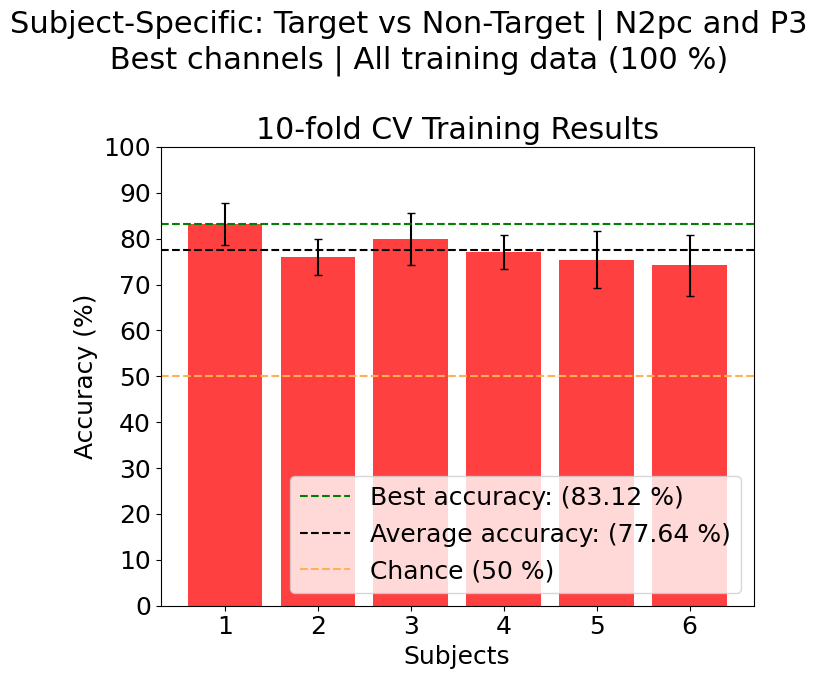

In [128]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 1,
                       figsize=(7.34, 7))

fig.suptitle(f'Subject-Specific: Target vs Non-Target | N2pc and P3 \n Best channels | All training data (100 %)', fontsize=22)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 18})
ax.bar(np.arange(1, NUM_SUBJ + 1), 
       bestModel_Subj_cross_val_scores[:, 0], 
       color="red", 
       yerr = bestModel_Subj_cross_val_scores[:, 1], 
       capsize=3,
       alpha = 0.75)

ax.set_title('Accuracy (%)')

ax.axhline(y = max(bestModel_Subj_cross_val_scores[:, 0]), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(bestModel_Subj_cross_val_scores[:, 0]):.2f} %)')

ax.axhline(y = np.mean(bestModel_Subj_cross_val_scores[:, 0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(bestModel_Subj_cross_val_scores[:, 0]):.2f} %)')

ax.axhline(y=50, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (50 %)')

ax.set(xticks = np.arange(1, NUM_SUBJ + 1), 
         xlabel = 'Subjects', 
         yticks=np.arange(0, 101, step=10), 
         ylabel='Accuracy (%)',
         title=f'{KFOLD}-fold CV Training Results');

ax.legend(loc='lower right');
plt.tight_layout()

## Classification (All channels N2pc and P3)

In [129]:
print("========================== All channels ==========================\n")

perSubj_cross_val_scores = np.zeros((NUM_SUBJ, 5, 2))
perSubj_accuracy = np.zeros((NUM_SUBJ, 5)) # 5 Classifiers
perSubj_auc_scores = np.zeros((NUM_SUBJ, 5))
perSubj_fitting_periods = np.zeros((NUM_SUBJ, 5))

for subj in range(NUM_SUBJ):

    print(f"\n------------------ Subject {subj + 1}: Classifying Target vs Non-Target ------------------\n")

    for c_count, clf in enumerate(classifiers):

        print(f"\n------------------ Classifier: {clf} ------------------")

        n2pc_p3_clf = clf

        # --------- Cross Validation Scores ---------
        cross_val_scores, best_n2pc_p3_clf = GridSearch(classifier_params[c_count], 
                                                               n2pc_p3_clf, 
                                                               KFOLD, 
                                                               all_norm_train_featVect[subj][:,0:-1],
                                                               all_norm_train_featVect[subj][:,-1])
        
        perSubj_cross_val_scores[subj, c_count, 0] = cross_val_scores[0]
        perSubj_cross_val_scores[subj, c_count, 1] = cross_val_scores[1]
        perSubj_fitting_periods[subj, c_count] = cross_val_scores[2]

        # --------- Predictions ---------
        pred = best_n2pc_p3_clf.predict(all_norm_test_featVect[subj][:, 0:-1])
        perSubj_accuracy[subj, c_count] = round(accuracy_score(all_norm_test_featVect[subj][:, -1], pred), 2) * 100

        # Compute AUC for each subject
        perSubj_auc_scores[subj, c_count] = round(roc_auc_score(all_norm_test_featVect[subj][:, -1], best_n2pc_p3_clf.predict_proba(all_norm_test_featVect[subj][:, 0:-1])[:,1]), 2)

        del n2pc_p3_clf, best_n2pc_p3_clf # Ensures no mixing of classifiers within the loop

========================== All channels ==========================


------------------ Subject 1: Classifying Target vs Non-Target ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: rbf

Best parameters: {'C': 0.1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.8027777777777778

Running Grid Search for method: poly

Best parameters: {'C': 1, 'cache_size': 200, 'degree': 2, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.8055555555555557

Running Grid Search for method: sigmoid

Best parameters: {'C': 100, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.01}
Best score: 0.7944444444444445

------------------ Classifier: LinearDiscriminantAnalysis() ------------------

Running Grid Search for method: svd

Best parameters: {'solver': 'svd'}
Best score: 0.7083333333333334

Running Grid Search fo

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.5, 'n_estimators': 50, 'random_state': 42}
Best score: 0.775

------------------ Subject 2: Classifying Target vs Non-Target ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: rbf

Best parameters: {'C': 10, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.75

Running Grid Search for method: poly

Best parameters: {'C': 1, 'cache_size': 200, 'degree': 3, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.7444444444444445

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.1}
Best score: 0.7472222222222222

------------------ Classifier: LinearDiscriminantAnalysis() ------------------

Running Grid Search for method: svd

Best parameters: {'solver': 'svd'}
Best score: 0.6166666666666667

Running Gr

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.1, 'n_estimators': 100, 'random_state': 42}
Best score: 0.7305555555555556

------------------ Subject 3: Classifying Target vs Non-Target ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: rbf

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.01}
Best score: 0.7944444444444444

Running Grid Search for method: poly

Best parameters: {'C': 10, 'cache_size': 200, 'degree': 2, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.7666666666666668

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.001}
Best score: 0.7055555555555556

------------------ Classifier: LinearDiscriminantAnalysis() ------------------

Running Grid Search for method: svd

Best parameters: {'solver': 'svd'}
Best score:

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.5, 'n_estimators': 50, 'random_state': 42}
Best score: 0.7305555555555556

------------------ Subject 4: Classifying Target vs Non-Target ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: rbf

Best parameters: {'C': 10, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.763888888888889

Running Grid Search for method: poly

Best parameters: {'C': 1, 'cache_size': 200, 'degree': 3, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.7138888888888888

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.01}
Best score: 0.6916666666666667

------------------ Classifier: LinearDiscriminantAnalysis() ------------------

Running Grid Search for method: svd

Best parameters: {'solver': 'svd'}
Best score: 0.5

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 1.0, 'n_estimators': 200, 'random_state': 42}
Best score: 0.7

------------------ Subject 5: Classifying Target vs Non-Target ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: rbf

Best parameters: {'C': 10, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.01}
Best score: 0.7583333333333334

Running Grid Search for method: poly

Best parameters: {'C': 1, 'cache_size': 200, 'degree': 2, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.6833333333333333

Running Grid Search for method: sigmoid

Best parameters: {'C': 10, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.001}
Best score: 0.6722222222222223

------------------ Classifier: LinearDiscriminantAnalysis() ------------------

Running Grid Search for method: svd

Best parameters: {'solver': 'svd'}
Best score: 0.56111111111

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.5, 'n_estimators': 100, 'random_state': 42}
Best score: 0.6805555555555556

------------------ Subject 6: Classifying Target vs Non-Target ------------------


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: rbf

Best parameters: {'C': 100, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.01}
Best score: 0.7583333333333334

Running Grid Search for method: poly

Best parameters: {'C': 0.001, 'cache_size': 200, 'degree': 2, 'gamma': 0.1, 'kernel': 'poly', 'random_state': 42, 'tol': 0.1}
Best score: 0.7416666666666667

Running Grid Search for method: sigmoid

Best parameters: {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.01}
Best score: 0.711111111111111

------------------ Classifier: LinearDiscriminantAnalysis() ------------------

Running Grid Search for method: svd

Best parameters: {'solver': 'svd'}
Best score:

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.1, 'n_estimators': 50, 'random_state': 42}
Best score: 0.6972222222222222


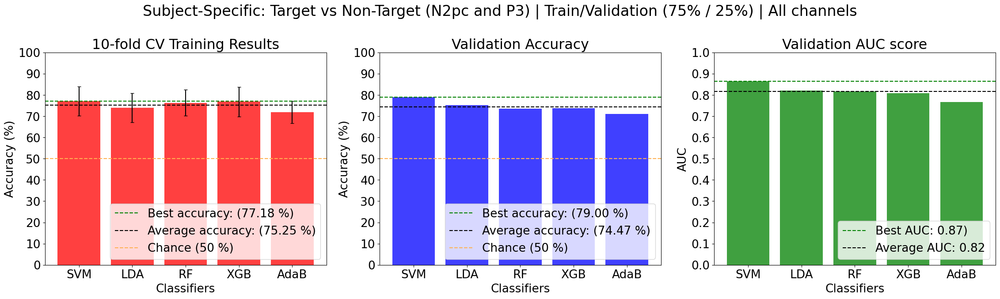

In [131]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 3,
                       figsize=(23, 7))

fig.suptitle(f'Subject-Specific: Target vs Non-Target (N2pc and P3) | Train/Validation (75% / 25%) | All channels', fontsize=24)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 19})
ax[0].bar(np.arange(1, 6), 
       np.mean(perSubj_cross_val_scores[:,:,0], axis = 0 ), 
       color="red", 
       yerr = np.mean(perSubj_cross_val_scores[:,:,1], axis = 0), 
       capsize=3,
       alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(np.mean(perSubj_cross_val_scores[:,:,0], axis = 0)), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(np.mean(perSubj_cross_val_scores[:,:,0], axis = 0)):.2f} %)')

ax[0].axhline(y = np.mean(perSubj_cross_val_scores[:,:,0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(perSubj_cross_val_scores[:,:,0]):.2f} %)')

ax[0].axhline(y=50, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (50 %)')

ax[0].set(xticks = np.arange(1, 5 + 1), 
       xticklabels = class_list,
       xlabel = 'Classifiers', 
       yticks=np.arange(0, 101, step=10), ylabel='Accuracy (%)',
       title=f'{KFOLD}-fold CV Training Results');

ax[0].legend(loc='lower right');


# -------------- Prediction Accuracy --------------

ax[1].bar(np.arange(1, 6), 
          np.mean(perSubj_accuracy, axis = 0 ), 
          color="b",
          alpha = 0.75)

ax[1].set_title('Accuracy (%)')

ax[1].axhline(y = max(np.mean(perSubj_accuracy, axis = 0)), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(np.mean(perSubj_accuracy, axis = 0)):.2f} %)')

ax[1].axhline(y = np.mean(perSubj_accuracy), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy):.2f} %)')

ax[1].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50 %)')

ax[1].set(xticks = np.arange(1, 5 + 1), 
          xticklabels = class_list,
          xlabel = 'Classifiers', 
          yticks=np.arange(0, 101, step=10), ylabel='Accuracy (%)',
          title="Validation Accuracy");

ax[1].legend(loc='lower right');


# -------------- Aread Under the Curve (AUC) --------------

ax[2].bar(np.arange(1, 6), 
          np.mean(perSubj_auc_scores, axis = 0 ), 
          color="g",
          alpha = 0.75)

ax[2].set_title('AUC ')

ax[2].axhline(y = max(np.mean(perSubj_auc_scores, axis = 0)), 
              color='green', linestyle='--', 
              label = f'Best AUC: {max(np.mean(perSubj_auc_scores, axis = 0)):.2f})')

ax[2].axhline(y = np.mean(perSubj_auc_scores), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: {np.mean(perSubj_auc_scores):.2f}')

ax[2].set(xticks = np.arange(1, 5 + 1), 
          xticklabels = class_list,
          xlabel = 'Classifiers', 
          yticks=np.arange(0, 1.01, step=0.1), ylabel='AUC',
          title="Validation AUC score");

ax[2].legend(loc='lower right');
plt.tight_layout()

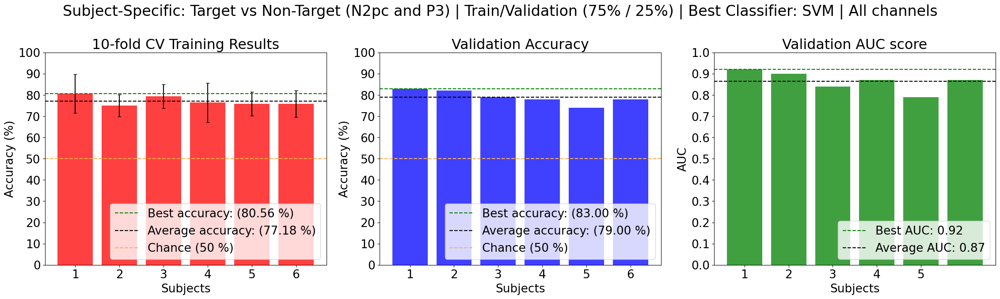

In [132]:
best_classifier = np.argmax(np.mean(perSubj_accuracy, axis = 0))

fig, ax = plt.subplots(nrows = 1,
                       ncols = 3,
                       figsize=(23, 7))

fig.suptitle(f'Subject-Specific: Target vs Non-Target (N2pc and P3) | Train/Validation (75% / 25%) | Best Classifier: {class_list[best_classifier]} | All channels', fontsize=24)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 19})
ax[0].bar(np.arange(1, NUM_SUBJ + 1), 
       perSubj_cross_val_scores[:,best_classifier, 0], 
       color="red", 
       yerr = perSubj_cross_val_scores[:,best_classifier, 1], 
       capsize=3,
       alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(perSubj_cross_val_scores[:,best_classifier, 0]), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(perSubj_cross_val_scores[:,best_classifier, 0]):.2f} %)')

ax[0].axhline(y = np.mean(perSubj_cross_val_scores[:,best_classifier, 0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(perSubj_cross_val_scores[:,best_classifier, 0]):.2f} %)')

ax[0].axhline(y=50, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (50 %)')

ax[0].set(xticks = np.arange(1, NUM_SUBJ + 1), 
         xlabel = 'Subjects', 
         yticks=np.arange(0, 101, step=10), 
         ylabel='Accuracy (%)',
         title=f'{KFOLD}-fold CV Training Results');

ax[0].legend(loc='lower right');


# -------------- Prediction Accuracy --------------

ax[1].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_accuracy[:,best_classifier], 
          color="b",
          alpha = 0.75)

ax[1].set_title('Accuracy (%)')

ax[1].axhline(y = max(perSubj_accuracy[:,best_classifier]), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(perSubj_accuracy[:,best_classifier]):.2f} %)')

ax[1].axhline(y = np.mean(perSubj_accuracy[:,best_classifier]), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(perSubj_accuracy[:,best_classifier]):.2f} %)')

ax[1].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50 %)')

ax[1].set(xticks = np.arange(1, NUM_SUBJ + 1), 
          xlabel = 'Subjects',  
          yticks=np.arange(0, 101, step=10), 
          ylabel='Accuracy (%)',
          title="Validation Accuracy");

ax[1].legend(loc='lower right');


# -------------- Aread Under the Curve (AUC) --------------

ax[2].bar(np.arange(1, NUM_SUBJ + 1), 
          perSubj_auc_scores[:, best_classifier], 
          color="g",
          alpha = 0.75)

ax[2].set_title('AUC ')

ax[2].axhline(y = max(perSubj_auc_scores[:, best_classifier]), 
              color='green', linestyle='--', 
              label = f'Best AUC: {max(perSubj_auc_scores[:, best_classifier]):.2f}')

ax[2].axhline(y = np.mean(perSubj_auc_scores[:, best_classifier]), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: {np.mean(perSubj_auc_scores[:, best_classifier]):.2f}')

ax[2].set(xticks = np.arange(1, 5 + 1), 
          xlabel = 'Subjects', 
          yticks=np.arange(0, 1.01, step=0.1), ylabel='AUC',
          title="Validation AUC score");

ax[2].legend(loc='lower right');
plt.tight_layout()

## Training and saving best models

In [133]:
N2pc_P3_models_Folder = "C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_Target_vs_NonTarget_N2pc_P3_AllElectrodes/"

# Create the folder (raises an error if it already exists)
try:
  os.mkdir(N2pc_P3_models_Folder)
  print(f"Folder created successfully at: {N2pc_P3_models_Folder}")
except FileExistsError:
  print(f"Folder already exists at: {N2pc_P3_models_Folder}")

Folder already exists at: C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SS_N2pc_P3_Target_vs_NonTarget/


In [134]:
perSubj_optim_params = [{'C': 1, 'cache_size': 200, 'degree': 2, 'gamma': 'auto', 'kernel': 'poly', 'random_state': 42, 'tol': 0.1},
                        {'C': 10, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1},
                        {'C': 1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.01},
                        {'C': 10, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1},
                        {'C': 10, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.01},
                        {'C': 100, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.01}]


In [135]:
bestModel_Subj_cross_val_scores = np.zeros((NUM_SUBJ, 2))

for subj in range(NUM_SUBJ):

    train = np.vstack((all_norm_train_featVect[subj], all_norm_test_featVect[subj])) # All data stacked

    np.random.seed(42)
    np.random.shuffle(train)

    # -------------------------- SVM --------------------------
    
    n2pc_p3_target = SVC(probability=True)
    n2pc_p3_target.set_params(**perSubj_optim_params[subj])

    # --------- Cross Validation Scores ---------
    scores = cross_val_score(n2pc_p3_target, 
                             train[:, 0:-1], 
                             train[:, -1], 
                             cv = KFOLD)
    
    bestModel_Subj_cross_val_scores[subj, 0] = (scores.mean() * 100)
    bestModel_Subj_cross_val_scores[subj, 1] = (scores.std() * 100)

    # --------- Train Model ---------
    n2pc_p3_target.fit(train[:, 0:-1], 
                      train[:, -1])
    
    joblib.dump(n2pc_p3_target, f'{N2pc_P3_models_Folder}Subj_0{subj + 1}_N2pc_P3_model.pkl')
    
    del n2pc_p3_target

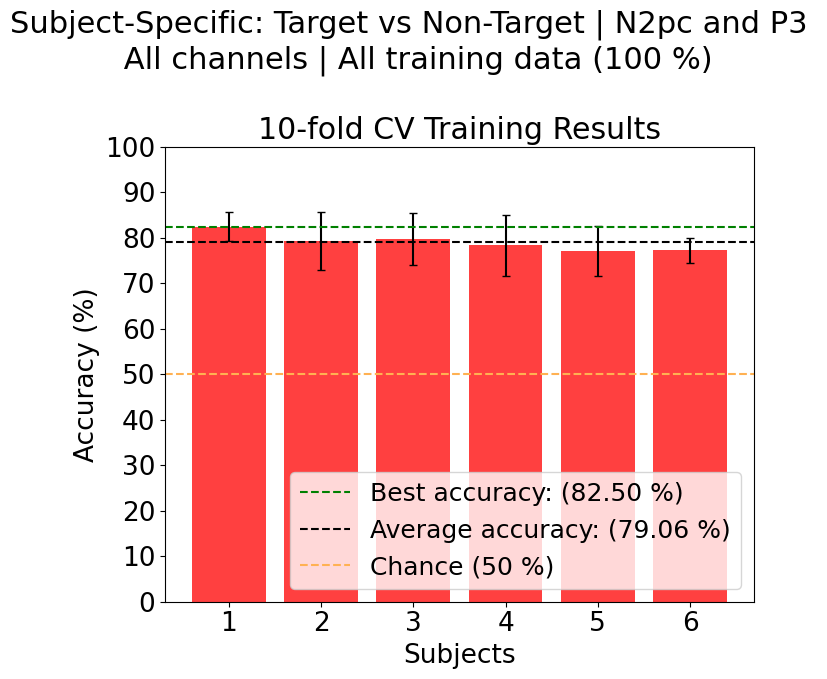

In [136]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 1,
                       figsize=(7.34, 7))

fig.suptitle(f'Subject-Specific: Target vs Non-Target | N2pc and P3 \n All channels | All training data (100 %)', fontsize=22)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 18})
ax.bar(np.arange(1, NUM_SUBJ + 1), 
       bestModel_Subj_cross_val_scores[:, 0], 
       color="red", 
       yerr = bestModel_Subj_cross_val_scores[:, 1], 
       capsize=3,
       alpha = 0.75)

ax.set_title('Accuracy (%)')

ax.axhline(y = max(bestModel_Subj_cross_val_scores[:, 0]), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(bestModel_Subj_cross_val_scores[:, 0]):.2f} %)')

ax.axhline(y = np.mean(bestModel_Subj_cross_val_scores[:, 0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(bestModel_Subj_cross_val_scores[:, 0]):.2f} %)')

ax.axhline(y=50, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (50 %)')

ax.set(xticks = np.arange(1, NUM_SUBJ + 1), 
         xlabel = 'Subjects', 
         yticks=np.arange(0, 101, step=10), 
         ylabel='Accuracy (%)',
         title=f'{KFOLD}-fold CV Training Results');

ax.legend(loc='lower right');
plt.tight_layout()

## Generalization (Target vs Non-Target N2pc and P3)

In [137]:
for subj in range(1, NUM_SUBJ):

    if (subj == 1):
        stacked_norm_train_featVectors = np.vstack((all_norm_train_featVect[subj - 1], all_norm_train_featVect[subj]))
        stacked_norm_test_featVectors = np.vstack((all_norm_test_featVect[subj - 1], all_norm_test_featVect[subj]))
    else:
        stacked_norm_train_featVectors = np.vstack((stacked_norm_train_featVectors, all_norm_train_featVect[subj]))
        stacked_norm_test_featVectors = np.vstack((stacked_norm_test_featVectors, all_norm_test_featVect[subj]))

np.random.seed(42)
np.random.shuffle(stacked_norm_train_featVectors)
np.random.seed(42)
np.random.shuffle(stacked_norm_test_featVectors)

In [138]:
print(np.shape(stacked_norm_train_featVectors))
print(np.shape(stacked_norm_test_featVectors))

(2160, 267)
(720, 267)


In [139]:
stackedSubj_cross_val_scores = np.zeros((len(classifiers), 2))
stackedSubj_accuracy = []
stackedSubj_auc_scores = []

for c_count, clf in enumerate(classifiers):

    print(f"\n------------------ Classifier: {clf} ------------------")

    gen_n2pc_p3_clf = clf

    # --------- Cross Validation Scores ---------
    cross_val_scores, best_gen_n2pc_p3_clf = GridSearch(classifier_params[c_count], 
                                                        gen_n2pc_p3_clf, 
                                                        KFOLD, 
                                                        stacked_norm_train_featVectors[:,0:-1],
                                                        stacked_norm_train_featVectors[:,-1])
    
    stackedSubj_cross_val_scores[c_count, 0] = cross_val_scores[0]
    stackedSubj_cross_val_scores[c_count, 1] = cross_val_scores[1]

    # --------- Predictions ---------
    pred = best_gen_n2pc_p3_clf.predict(stacked_norm_test_featVectors[:, 0:-1])
    stackedSubj_accuracy.append( round(accuracy_score(stacked_norm_test_featVectors[:, -1], pred), 2) * 100 )

    # Compute AUC for each subject
    stackedSubj_auc_scores.append( round(roc_auc_score(stacked_norm_test_featVectors[:, -1], best_gen_n2pc_p3_clf.predict_proba(stacked_norm_test_featVectors[:, 0:-1])[:,1]), 2))

    del gen_n2pc_p3_clf, best_gen_n2pc_p3_clf # Ensures no mixing of classifiers within the loop


------------------ Classifier: SVC(probability=True) ------------------

Running Grid Search for method: rbf



C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\joblib\externals\loky\process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Best parameters: {'C': 100, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'rbf', 'random_state': 42, 'tol': 0.1}
Best score: 0.7907407407407407

Running Grid Search for method: poly

Best parameters: {'C': 0.01, 'cache_size': 200, 'degree': 2, 'gamma': 0.1, 'kernel': 'poly', 'random_state': 42, 'tol': 0.01}
Best score: 0.7745370370370371

Running Grid Search for method: sigmoid

Best parameters: {'C': 0.1, 'cache_size': 200, 'gamma': 'auto', 'kernel': 'sigmoid', 'random_state': 42, 'tol': 0.001}
Best score: 0.6703703703703704

------------------ Classifier: LinearDiscriminantAnalysis() ------------------

Running Grid Search for method: svd

Best parameters: {'solver': 'svd'}
Best score: 0.6675925925925925

Running Grid Search for method: lsqr

Best parameters: {'shrinkage': 'auto', 'solver': 'lsqr', 'tol': 0.1}
Best score: 0.6884259259259259

Running Grid Search for method: eigen

Best parameters: {'shrinkage': 'auto', 'solver': 'eigen', 'tol': 0.1}
Best score: 0.6884259259259259

---

C:\Users\MICROMED\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\sklearn\ensemble\_weight_boosting.py:527: FutureWarning: The SAMME.R algorithm (the default) is deprecated and will be removed in 1.6. Use the SAMME algorithm to circumvent this warning.
  warnings.warn(


Best parameters: {'learning_rate': 0.5, 'n_estimators': 200, 'random_state': 42}
Best score: 0.6805555555555556


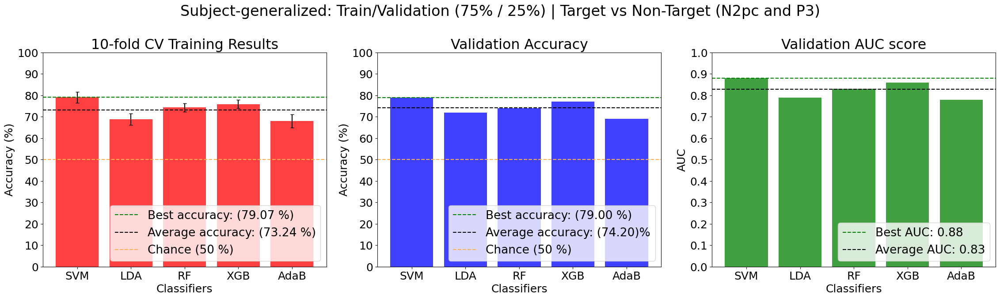

In [140]:
fig, ax = plt.subplots(nrows = 1,
                       ncols = 3,
                       figsize=(23, 7))

fig.suptitle(f'Subject-generalized: Train/Validation (75% / 25%) | Target vs Non-Target (N2pc and P3)', fontsize=24)

# -------------- Cross-Validation scores --------------

plt.rcParams.update({'font.size': 19})
ax[0].bar(np.arange(1, 6), 
          stackedSubj_cross_val_scores[:,0], 
          color="red", 
          yerr = stackedSubj_cross_val_scores[:,1], 
          capsize=3,
          alpha = 0.75)

ax[0].set_title('Accuracy (%)')

ax[0].axhline(y = max(stackedSubj_cross_val_scores[:,0]), 
           color='green', linestyle='--', 
           label = f'Best accuracy: ({max(stackedSubj_cross_val_scores[:,0]):.2f} %)')

ax[0].axhline(y = np.mean(stackedSubj_cross_val_scores[:,0]), 
           color='k', 
           linestyle='--', 
           label = f'Average accuracy: ({np.mean(stackedSubj_cross_val_scores[:,0]):.2f} %)')

ax[0].axhline(y=50, color='#ffb152', 
           linestyle='--', 
           label = 'Chance (50 %)')

ax[0].set(xticks = np.arange(1, 5 + 1), 
          xticklabels = class_list,
          xlabel = 'Classifiers', 
          yticks=np.arange(0, 101, step=10), ylabel='Accuracy (%)',
          title=f'{KFOLD}-fold CV Training Results');

ax[0].legend(loc='lower right');


# -------------- Prediction Accuracy --------------

ax[1].bar(np.arange(1, 6), 
          stackedSubj_accuracy, 
          color="b",
          alpha = 0.75)

ax[1].set_title('Accuracy (%)')

ax[1].axhline(y = max(stackedSubj_accuracy), 
              color='green', linestyle='--', 
              label = f'Best accuracy: ({max(stackedSubj_accuracy):.2f} %)')

ax[1].axhline(y = np.mean(stackedSubj_accuracy), 
              color='k', 
              linestyle='--', 
              label = f'Average accuracy: ({np.mean(stackedSubj_accuracy):.2f})%')

ax[1].axhline(y=50, 
              color='#ffb152', 
              linestyle='--', 
              label = 'Chance (50 %)')

ax[1].set(xticks = np.arange(1, 5 + 1), 
          xticklabels = class_list,
          xlabel = 'Classifiers', 
          yticks=np.arange(0, 101, step=10), ylabel='Accuracy (%)',
          title="Validation Accuracy");

ax[1].legend(loc='lower right');


# -------------- Aread Under the Curve (AUC) --------------

ax[2].bar(np.arange(1, 6), 
          stackedSubj_auc_scores, 
          color="g",
          alpha = 0.75)

ax[2].set_title('AUC ')

ax[2].axhline(y = max(stackedSubj_auc_scores), 
              color='green', linestyle='--', 
              label = f'Best AUC: {max(stackedSubj_auc_scores):.2f}')

ax[2].axhline(y = np.mean(stackedSubj_auc_scores), 
              color='k', 
              linestyle='--', 
              label = f'Average AUC: {np.mean(stackedSubj_auc_scores):.2f}')

ax[2].set(xticks = np.arange(1, 6), 
          xticklabels = class_list,
          xlabel = 'Classifiers', 
          yticks=np.arange(0, 1.01, step=0.1), ylabel='AUC',
          title="Validation AUC score");

ax[2].legend(loc='lower right');
plt.tight_layout()

In [141]:
N2pc_P3_AGI_models_Folder = "C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/SG_Target_vs_NonTarget_N2pc_P3/"

# Create the folder (raises an error if it already exists)
try:
  os.mkdir(N2pc_P3_AGI_models_Folder)
  print(f"Folder created successfully at: {N2pc_P3_AGI_models_Folder}")
except FileExistsError:
  print(f"Folder already exists at: {N2pc_P3_AGI_models_Folder}")

Folder created successfully at: C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/Generalized_N2pc_P3_Target_vs_NonTarget/


In [142]:
all_train = np.vstack((stacked_norm_train_featVectors, stacked_norm_test_featVectors))

# -------------------------- Random Forest --------------------------
gen_p3_n2pc_clf3 = SVC(probability=True, C = 100, cache_size = 200, gamma = 'auto', kernel = 'rbf', random_state = 42, tol = 0.1)

# --------- Cross Validation Scores ---------
scores = cross_val_score(gen_p3_n2pc_clf3, 
                         all_train[:, 0:-1], 
                         all_train[:, -1], 
                         cv = KFOLD)

print("10 fold mean Accuracy: ", scores.mean() * 100)
print("10 fold std Accuracy: ", scores.std() * 100)

# --------- Train Model ---------
gen_p3_n2pc_clf3.fit(all_train[:, 0:-1], 
                     all_train[:, -1])

joblib.dump(gen_p3_n2pc_clf3, f'{N2pc_P3_AGI_models_Folder}Gen_N2pc_P3_model.pkl')

10 fold mean Accuracy:  80.41666666666669
10 fold std Accuracy:  2.2779471481745452


['C:/Users/MICROMED/Desktop/MiguelRocha/PROJ/Models/Generalized_N2pc_P3_Target_vs_NonTarget/Gen_N2pc_P3_model.pkl']

# Differences between left and right targets on the P3 (Lower amplitude P3 equates more cognitive load which can be correlated with the dominant eye)

In [ ]:
up_vlim = np.max(grandAver_targetERP[P3_ch_idx,:]) + np.max(std_targetERP[P3_ch_idx,:]*1.1)
do_vlim = np.min(grandAver_targetERP[P3_ch_idx,:]) - np.max(std_targetERP[P3_ch_idx,:])

for subj in (range(NUM_SUBJ)):

    fig, ax1 = plt.subplots(nrows = 1, 
                        ncols = len(P3_ch_idx),
                        figsize=(30, 5))

    for c in range(len(P3_ch_idx)):


        ax1[c].plot(ERP_times, 
                 np.mean(all_LVF_P3[subj], axis = 0)[c,:], 
                 color = 'red', 
                 label = 'LVF Targets',  
                 linewidth = 2);
        
        ax1[c].plot(ERP_times, 
                 np.mean(all_RVF_P3[subj], axis = 0)[c,:], 
                 'b', 
                 label = 'RVF Targets',
                 linewidth = 2);
        
        ax1[c].set_title(f"Subject {subj + 1} - {P3_channels[c]}", weight = 'bold')
        ax1[c].set_xlabel("Time (ms)")
        ax1[c].set_ylabel("Voltage (V)")
        ax1[c].axvline(x = 0, linewidth = 2, linestyle = ':', color = 'black')
        ax1[c].axhline(y = 0, linestyle = '--', color = 'black')
        ax1[c].set_xlim([preStim_offset,posStim_offset])
        ax1[c].set_ylim([do_vlim, up_vlim])


        '''
        ----- Patches info: -----
        (200, -1) is the bottom-left corner of the rectangle (x, y coordinates). Note the y values in the graph are in microVolts
        0.1 is the width of the rectangle.
        0.2 is the height of the rectangle.
        '''
        P3a_region = patches.Rectangle((0.28, -0.1), 0.1, 0.2, linewidth=1, edgecolor='orange', facecolor='orange', alpha=0.15, label = 'P3a')
        ax1[c].add_patch(P3a_region)
        P3b_region = patches.Rectangle((0.38, -0.1), 0.1, 0.2, linewidth=1, edgecolor='red', facecolor='red', alpha=0.15, label = 'P3b')
        ax1[c].add_patch(P3b_region)
            
        ax1[c].legend(loc='upper left')


# **Differences between the distance between the vertical midline and the targets on the P3 (Lower amplitude P3 equates more cognitive load which can be correlated with the dominant eye)**

In [ ]:
neg_hor_VA = 278
pos_hor_VA = 394

neg_ver_VA = 226
pos_ver_VA = 341

x,y=visual_angle(neg_hor_VA, neg_ver_VA, IM_WIDTH, IM_HEIGHT, SCREEN_WIDTH_PX, SCREEN_HEIGHT_PX)
print(x,y)

x,y=visual_angle(pos_hor_VA, pos_ver_VA, IM_WIDTH, IM_HEIGHT, SCREEN_WIDTH_PX, SCREEN_HEIGHT_PX)
print(x,y)

range_sep = neg_hor_VA/4

In [ ]:
figure(figsize = (10, 8.4375))

plt.title("Distribution of target centroids within the images")
plt.scatter(x_centroid, y_centroid, color = 'b', s = 15, alpha = 0.8);

plt.xlabel("Horizontal postion (px)")
plt.ylabel("Vertical position (px)")
plt.legend(loc = "best");

plt.axvline(x = neg_hor_VA, color = 'g', linestyle = ':', linewidth = 2, label = f"Horizontal VA: [{-H_th}°; {H_th}°] = [278 px; 394 px]")
plt.axvline(x = pos_hor_VA, color = 'g', linestyle = ':', linewidth = 2)

plt.axhline(y = neg_ver_VA, color = 'r', linestyle = ':', linewidth = 2, label = f"Vertical VA:     [{-V_th}°; {V_th}°] = [226 px; 341 px]")
plt.axhline(y = pos_ver_VA, color = 'r', linestyle = ':', linewidth = 2)

plt.axvline(x = neg_hor_VA - range_sep, color = 'k', linestyle = ':', linewidth = 2)
plt.axvline(x = pos_hor_VA + range_sep, color = 'k', linestyle = ':', linewidth = 2)
plt.axvline(x = neg_hor_VA - range_sep*2, color = 'k', linestyle = ':', linewidth = 2)
plt.axvline(x = pos_hor_VA + range_sep*2, color = 'k', linestyle = ':', linewidth = 2)
plt.axvline(x = neg_hor_VA - range_sep*3, color = 'k', linestyle = ':', linewidth = 2)
plt.axvline(x = pos_hor_VA + range_sep*3, color = 'k', linestyle = ':', linewidth = 2)

plt.xlim([0, width]);
plt.ylim([height, 0])

plt.xticks(np.arange(0, width, 50))
plt.yticks(np.arange(0, height, 50))

plt.legend()
plt.show()

In [ ]:
all_RVF_P3_1r = []
all_LVF_P3_1r = []

all_RVF_P3_2r = []
all_LVF_P3_2r = []

all_RVF_P3_3r = []
all_LVF_P3_3r = []

for subj in range(NUM_SUBJ):

    RVF_P3_1r = []
    LVF_P3_1r = []

    RVF_P3_2r = []
    LVF_P3_2r = []

    RVF_P3_3r = []
    LVF_P3_3r = []

    for trial in all_labelled_targets[subj]:
        
        if(trial[HORIZONTAL_CONDITION_COL] == "RVF" and trial[X_CENTROID_COL] > pos_hor_VA and trial[X_CENTROID_COL] < pos_hor_VA + range_sep):

            RVF_P3_1r.append(trial[DATA_COL][P3_ch_idx,:])

        elif(trial[HORIZONTAL_CONDITION_COL] == "LVF" and trial[X_CENTROID_COL] < neg_hor_VA and trial[X_CENTROID_COL] > neg_hor_VA - range_sep):

            LVF_P3_1r.append(trial[DATA_COL][P3_ch_idx,:])

        elif(trial[HORIZONTAL_CONDITION_COL] == "RVF" and trial[X_CENTROID_COL] > pos_hor_VA + range_sep and trial[X_CENTROID_COL] < pos_hor_VA + range_sep * 2):

            RVF_P3_2r.append(trial[DATA_COL][P3_ch_idx,:])

        elif(trial[HORIZONTAL_CONDITION_COL] == "LVF" and trial[X_CENTROID_COL] < neg_hor_VA - range_sep and trial[X_CENTROID_COL] > neg_hor_VA - range_sep * 2):

            LVF_P3_2r.append(trial[DATA_COL][P3_ch_idx,:])

        elif(trial[HORIZONTAL_CONDITION_COL] == "RVF" and trial[X_CENTROID_COL] > pos_hor_VA + range_sep * 2):

            RVF_P3_3r.append(trial[DATA_COL][P3_ch_idx,:])

        elif(trial[HORIZONTAL_CONDITION_COL] == "LVF" and trial[X_CENTROID_COL] < neg_hor_VA - range_sep * 2):

            LVF_P3_3r.append(trial[DATA_COL][P3_ch_idx,:])

    all_RVF_P3_1r.append(RVF_P3_1r)
    all_LVF_P3_1r.append(LVF_P3_1r)

    all_RVF_P3_2r.append(RVF_P3_2r)
    all_LVF_P3_2r.append(LVF_P3_2r)

    all_RVF_P3_3r.append(RVF_P3_3r)
    all_LVF_P3_3r.append(LVF_P3_3r)

In [ ]:
up_vlim = np.max(grandAver_targetERP[P3_ch_idx,:]) + np.max(std_targetERP[P3_ch_idx,:]*2.5)
do_vlim = np.min(grandAver_targetERP[P3_ch_idx,:]) - np.max(std_targetERP[P3_ch_idx,:]*2.5)

for subj in (range(NUM_SUBJ)):

    fig, ax1 = plt.subplots(nrows = 1, 
                        ncols = len(P3_ch_idx) - 2,
                        figsize=(30, 5))

    for c in range(len(P3_ch_idx) - 2):


        ax1[c].plot(ERP_times, 
                    np.mean(all_RVF_P3_1r[subj], axis = 0)[c,:], 
                    color = 'red', 
                    label = f' {pos_hor_VA} - {pos_hor_VA + range_sep: .1f} px',
                    linewidth = 2);
        
        ax1[c].plot(ERP_times, 
                    np.mean(all_RVF_P3_2r[subj], axis = 0)[c,:], 
                    'b', 
                    label = f'{pos_hor_VA + range_sep: .1f} - {pos_hor_VA + range_sep*2: .1f} px',
                    linewidth = 2);
        
        ax1[c].plot(ERP_times, 
                    np.mean(all_RVF_P3_3r[subj], axis = 0)[c,:], 
                    'g', 
                    label = f"{pos_hor_VA + range_sep*2: .1f} - {pos_hor_VA + range_sep*3: .1f} px",
                    linewidth = 2);
        
        ax1[c].set_title(f"Subject {subj + 1} - {P3_channels[c]} - RVF", weight = 'bold')
        ax1[c].set_xlabel("Time (ms)")
        ax1[c].set_ylabel("Voltage (V)")
        ax1[c].axvline(x = 0, linewidth = 2, linestyle = ':', color = 'black')
        ax1[c].axhline(y = 0, linestyle = '--', color = 'black')
        ax1[c].set_xlim([preStim_offset,posStim_offset])
        ax1[c].set_ylim([do_vlim, up_vlim])


        '''
        ----- Patches info: -----
        (200, -1) is the bottom-left corner of the rectangle (x, y coordinates). Note the y values in the graph are in microVolts
        0.1 is the width of the rectangle.
        0.2 is the height of the rectangle.
        '''
        P3a_region = patches.Rectangle((0.28, -0.1), 0.1, 0.2, linewidth=1, edgecolor='orange', facecolor='orange', alpha=0.15, label = 'P3a')
        ax1[c].add_patch(P3a_region)
        P3b_region = patches.Rectangle((0.38, -0.1), 0.1, 0.2, linewidth=1, edgecolor='red', facecolor='red', alpha=0.15, label = 'P3b')
        ax1[c].add_patch(P3b_region)
            
        ax1[c].legend(loc='upper left')

In [ ]:
for subj in (range(NUM_SUBJ)):

    fig, ax1 = plt.subplots(nrows = 1, 
                        ncols = len(P3_ch_idx) - 2,
                        figsize=(30, 5))

    for c in range(len(P3_ch_idx) - 2):


        ax1[c].plot(ERP_times, 
                    np.mean(all_LVF_P3_1r[subj], axis = 0)[c,:], 
                    color = 'red', 
                    label = f'{neg_hor_VA - range_sep: .1f} - {neg_hor_VA} px',  
                    linewidth = 2);
        
        ax1[c].plot(ERP_times, 
                    np.mean(all_LVF_P3_2r[subj], axis = 0)[c,:], 
                    'b', 
                    label = f'{neg_hor_VA - range_sep * 2: .1f} - {neg_hor_VA - range_sep: .1f} px',
                    linewidth = 2); 
        
        ax1[c].plot(ERP_times, 
                    np.mean(all_LVF_P3_3r[subj], axis = 0)[c,:], 
                    'g', 
                    label = f" {0} - {neg_hor_VA - range_sep * 2: .1f} px",
                    linewidth = 2);
        
        ax1[c].set_title(f"Subject {subj + 1} - {P3_channels[c]} - LVF", weight = 'bold')
        ax1[c].set_xlabel("Time (ms)")
        ax1[c].set_ylabel("Voltage (V)")
        ax1[c].axvline(x = 0, linewidth = 2, linestyle = ':', color = 'black')
        ax1[c].axhline(y = 0, linestyle = '--', color = 'black')
        ax1[c].set_xlim([preStim_offset,posStim_offset])
        ax1[c].set_ylim([do_vlim, up_vlim])


        '''
        ----- Patches info: -----
        (200, -1) is the bottom-left corner of the rectangle (x, y coordinates). Note the y values in the graph are in microVolts
        0.1 is the width of the rectangle.
        0.2 is the height of the rectangle.
        '''
        P3a_region = patches.Rectangle((0.28, -0.1), 0.1, 0.2, linewidth=1, edgecolor='orange', facecolor='orange', alpha=0.15, label = 'P3a')
        ax1[c].add_patch(P3a_region)
        P3b_region = patches.Rectangle((0.38, -0.1), 0.1, 0.2, linewidth=1, edgecolor='red', facecolor='red', alpha=0.15, label = 'P3b')
        ax1[c].add_patch(P3b_region)
            
        ax1[c].legend(loc='upper left')

# **Attempting to improve center of mass estimation by reducing the number of possible estimation points on the NN regressor instead of all possbible points (px) allong the image dimensions**

In [ ]:
RVF_r1_cm = np.mean([pos_hor_VA, pos_hor_VA + range_sep])
RVF_r2_cm = np.mean([pos_hor_VA + range_sep, pos_hor_VA + range_sep * 2])
RVF_r3_cm = np.mean([pos_hor_VA + range_sep * 2, IM_WIDTH])

LVF_r1_cm = np.mean([neg_hor_VA, neg_hor_VA - range_sep])
LVF_r2_cm = np.mean([neg_hor_VA - range_sep, neg_hor_VA - range_sep * 2])
LVF_r3_cm = np.mean([neg_hor_VA - range_sep * 2, 0])

In [ ]:
all_RVF_contralateral_r1 = []
all_RVF_ipsilateral_r1 = []
all_LVF_contralateral_r1 = []
all_LVF_ipsilateral_r1 = []
all_RVF_contralateral_r2 = []
all_RVF_ipsilateral_r2 = []
all_LVF_contralateral_r2 = []
all_LVF_ipsilateral_r2 = []
all_RVF_contralateral_r3 = []
all_RVF_ipsilateral_r3 = []
all_LVF_contralateral_r3 = []
all_LVF_ipsilateral_r3 = []

all_RVF_x_pos_r1 = []
all_LVF_x_pos_r1 = []
all_RVF_x_pos_r2 = []
all_LVF_x_pos_r2 = []
all_RVF_x_pos_r3 = []
all_LVF_x_pos_r3 = []

for subj in range(NUM_SUBJ):

    RVF_contralateral_r1 = []
    RVF_ipsilateral_r1 = []
    LVF_contralateral_r1 = []
    LVF_ipsilateral_r1 = []
    RVF_contralateral_r2 = []
    RVF_ipsilateral_r2 = []
    LVF_contralateral_r2 = []
    LVF_ipsilateral_r2 = []
    RVF_contralateral_r3 = []
    RVF_ipsilateral_r3 = []
    LVF_contralateral_r3 = []
    LVF_ipsilateral_r3 = []

    RVF_x_pos_r1 = []
    LVF_x_pos_r1 = []
    RVF_x_pos_r2 = []
    LVF_x_pos_r2 = []
    RVF_x_pos_r3 = []
    LVF_x_pos_r3 = []

    for trial in all_labelled_targets[subj]:
        
        if(trial[HORIZONTAL_CONDITION_COL] == "RVF" and trial[X_CENTROID_COL] > pos_hor_VA and trial[X_CENTROID_COL] < pos_hor_VA + range_sep):

            RVF_contralateral_r1.append(trial[DATA_COL][left_N2pc_ch_idx,:])
            RVF_ipsilateral_r1.append(trial[DATA_COL][right_N2pc_ch_idx,:])

            RVF_x_pos_r1.append(RVF_r1_cm)

        elif(trial[HORIZONTAL_CONDITION_COL] == "LVF" and trial[X_CENTROID_COL] < neg_hor_VA and trial[X_CENTROID_COL] > neg_hor_VA - range_sep):

            LVF_contralateral_r1.append(trial[DATA_COL][right_N2pc_ch_idx,:])
            LVF_ipsilateral_r1.append(trial[DATA_COL][left_N2pc_ch_idx,:])

            LVF_x_pos_r1.append(LVF_r1_cm)

        elif(trial[HORIZONTAL_CONDITION_COL] == "RVF" and trial[X_CENTROID_COL] > pos_hor_VA + range_sep and trial[X_CENTROID_COL] < pos_hor_VA + range_sep * 2):

            RVF_contralateral_r2.append(trial[DATA_COL][left_N2pc_ch_idx,:])
            RVF_ipsilateral_r2.append(trial[DATA_COL][right_N2pc_ch_idx,:])

            RVF_x_pos_r2.append(RVF_r2_cm)

        elif(trial[HORIZONTAL_CONDITION_COL] == "LVF" and trial[X_CENTROID_COL] < neg_hor_VA - range_sep and trial[X_CENTROID_COL] > neg_hor_VA - range_sep * 2):

            LVF_contralateral_r2.append(trial[DATA_COL][right_N2pc_ch_idx,:])
            LVF_ipsilateral_r2.append(trial[DATA_COL][left_N2pc_ch_idx,:])

            LVF_x_pos_r2.append(LVF_r2_cm)

        elif(trial[HORIZONTAL_CONDITION_COL] == "RVF" and trial[X_CENTROID_COL] > pos_hor_VA + range_sep * 2):

            RVF_contralateral_r3.append(trial[DATA_COL][left_N2pc_ch_idx,:])
            RVF_ipsilateral_r3.append(trial[DATA_COL][right_N2pc_ch_idx,:])

            RVF_x_pos_r3.append(RVF_r3_cm)

        elif(trial[HORIZONTAL_CONDITION_COL] == "LVF" and trial[X_CENTROID_COL] < neg_hor_VA - range_sep * 2):

            LVF_contralateral_r3.append(trial[DATA_COL][right_N2pc_ch_idx,:])
            LVF_ipsilateral_r3.append(trial[DATA_COL][left_N2pc_ch_idx,:])

            LVF_x_pos_r3.append(LVF_r3_cm)


    all_RVF_contralateral_r1.append(RVF_contralateral_r1)
    all_RVF_ipsilateral_r1.append(RVF_ipsilateral_r1)

    all_RVF_contralateral_r2.append(RVF_contralateral_r2)
    all_RVF_ipsilateral_r2.append(RVF_ipsilateral_r2)

    all_RVF_contralateral_r3.append(RVF_contralateral_r3)
    all_RVF_ipsilateral_r3.append(RVF_ipsilateral_r3)

    all_LVF_contralateral_r1.append(LVF_contralateral_r1)
    all_LVF_ipsilateral_r1.append(LVF_ipsilateral_r1)

    all_LVF_contralateral_r2.append(LVF_contralateral_r2)
    all_LVF_ipsilateral_r2.append(LVF_ipsilateral_r2)

    all_LVF_contralateral_r3.append(LVF_contralateral_r3)
    all_LVF_ipsilateral_r3.append(LVF_ipsilateral_r3)

    all_RVF_x_pos_r1.append(RVF_x_pos_r1)
    all_RVF_x_pos_r2.append(RVF_x_pos_r2)
    all_RVF_x_pos_r3.append(RVF_x_pos_r3)

    all_LVF_x_pos_r1.append(LVF_x_pos_r1)
    all_LVF_x_pos_r2.append(LVF_x_pos_r2)
    all_LVF_x_pos_r3.append(LVF_x_pos_r3)



In [ ]:
print(np.shape(RVF_contralateral_r1))
print(np.shape(RVF_contralateral_r2))
print(np.shape(RVF_contralateral_r3))

print(np.shape(LVF_contralateral_r1))
print(np.shape(LVF_contralateral_r2))
print(np.shape(LVF_contralateral_r3))

In [ ]:
ts = 0.15
te = 0.35

idx_s = np.argmin(np.abs(ERP_times - ts))
idx_e = np.argmin(np.abs(ERP_times - te))

# Resampling the resulting time window (Prevents overfitting)

RESAMPLE_FREQ = 64 # Hz
N_DATAPOINTS_ORIG_FREQ = len(ERP_times[idx_s:idx_e+1])
N_DATAPOINTS_RESA_FREQ = int(np.ceil((N_DATAPOINTS_ORIG_FREQ * RESAMPLE_FREQ)/fs)) + 1

all_NN_featVectLVF_r1 = []
all_NN_featVectRVF_r1 = []
all_NN_featVectLVF_r2 = []
all_NN_featVectRVF_r2 = []
all_NN_featVectLVF_r3 = []
all_NN_featVectRVF_r3 = []

# =====================================================================================

n_trials_RVF_r1, _, _ = np.shape(RVF_contralateral_r1)

for subj in range(NUM_SUBJ):

    NN_featVectRVF = []

    for trial in range(n_trials_RVF_r1):

        RVF = resample(all_RVF_contralateral_r1[subj][trial][:,idx_s:idx_e+1] - all_RVF_ipsilateral_r1[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
        
        for c in range(1, n_channels):

            if (c == 1):
                auxRVF = np.hstack((RVF[c-1,:],RVF[c,:]))
            else:
                auxRVF = np.hstack((auxRVF,RVF[c,:]))

        NN_featVectRVF.append(np.hstack((auxRVF, all_RVF_x_pos_r1[subj][trial])))

    all_NN_featVectRVF_r1.append(NN_featVectRVF)

# =====================================================================================

n_trials_RVF_r2, _, _ = np.shape(RVF_contralateral_r2)

for subj in range(NUM_SUBJ):

    NN_featVectRVF = []

    for trial in range(n_trials_RVF_r2):

        RVF = resample(all_RVF_contralateral_r2[subj][trial][:,idx_s:idx_e+1] - all_RVF_ipsilateral_r2[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
        
        for c in range(1, n_channels):

            if (c == 1):
                auxRVF = np.hstack((RVF[c-1,:],RVF[c,:]))
            else:
                auxRVF = np.hstack((auxRVF,RVF[c,:]))

        NN_featVectRVF.append(np.hstack((auxRVF, all_RVF_x_pos_r2[subj][trial])))

    all_NN_featVectRVF_r2.append(NN_featVectRVF)

# =====================================================================================

n_trials_RVF_r3, _, _ = np.shape(RVF_contralateral_r3)

for subj in range(NUM_SUBJ):

    NN_featVectRVF = []

    for trial in range(n_trials_RVF_r3):

        RVF = resample(all_RVF_contralateral_r3[subj][trial][:,idx_s:idx_e+1] - all_RVF_ipsilateral_r3[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
        
        for c in range(1, n_channels):

            if (c == 1):
                auxRVF = np.hstack((RVF[c-1,:],RVF[c,:]))
            else:
                auxRVF = np.hstack((auxRVF,RVF[c,:]))

        NN_featVectRVF.append(np.hstack((auxRVF, all_RVF_x_pos_r3[subj][trial])))

    all_NN_featVectRVF_r3.append(NN_featVectRVF)


# =====================================================================================

n_trials_LVF_r1, _, _ = np.shape(LVF_contralateral_r1)

for subj in range(NUM_SUBJ):

    NN_featVectLVF = []

    for trial in range(n_trials_LVF_r1):

        LVF = resample(all_LVF_contralateral_r1[subj][trial][:,idx_s:idx_e+1] - all_LVF_ipsilateral_r1[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
        
        for c in range(1, n_channels):

            if (c == 1):
                auxLVF = np.hstack((LVF[c-1,:],LVF[c,:]))
            else:
                auxLVF = np.hstack((auxLVF,LVF[c,:]))

        NN_featVectLVF.append(np.hstack((auxLVF, all_LVF_x_pos_r1[subj][trial])))

    all_NN_featVectLVF_r1.append(NN_featVectLVF)

# =====================================================================================

n_trials_LVF_r2, _, _ = np.shape(LVF_contralateral_r2)

for subj in range(NUM_SUBJ):

    NN_featVectLVF = []

    for trial in range(n_trials_LVF_r2):

        LVF = resample(all_LVF_contralateral_r2[subj][trial][:,idx_s:idx_e+1] - all_LVF_ipsilateral_r2[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
        
        for c in range(1, n_channels):

            if (c == 1):
                auxLVF = np.hstack((LVF[c-1,:],LVF[c,:]))
            else:
                auxLVF = np.hstack((auxLVF,LVF[c,:]))

        NN_featVectLVF.append(np.hstack((auxLVF, all_LVF_x_pos_r2[subj][trial])))

    all_NN_featVectLVF_r2.append(NN_featVectLVF)

# =====================================================================================

n_trials_LVF_r3, _, _ = np.shape(LVF_contralateral_r3)

for subj in range(NUM_SUBJ):

    NN_featVectLVF = []

    for trial in range(n_trials_LVF_r3):

        LVF = resample(all_LVF_contralateral_r3[subj][trial][:,idx_s:idx_e+1] - all_LVF_ipsilateral_r3[subj][trial][:,idx_s:idx_e+1], N_DATAPOINTS_RESA_FREQ, axis = -1)
        
        for c in range(1, n_channels):

            if (c == 1):
                auxLVF = np.hstack((LVF[c-1,:],LVF[c,:]))
            else:
                auxLVF = np.hstack((auxLVF,LVF[c,:]))

        NN_featVectLVF.append(np.hstack((auxLVF, all_LVF_x_pos_r3[subj][trial])))

    all_NN_featVectLVF_r3.append(NN_featVectLVF)

print(np.shape(all_NN_featVectRVF_r1))
print(np.shape(all_NN_featVectLVF_r1))
print(np.shape(all_NN_featVectRVF_r2))
print(np.shape(all_NN_featVectLVF_r2))
print(np.shape(all_NN_featVectRVF_r3))
print(np.shape(all_NN_featVectLVF_r3))


In [ ]:

PERCENT_TRAIN = 0.75
n_train_RVF_r1 = int(np.ceil(n_trials_RVF_r1) * PERCENT_TRAIN)
n_train_RVF_r2 = int(np.ceil(n_trials_RVF_r2) * PERCENT_TRAIN)
n_train_RVF_r3 = int(np.ceil(n_trials_RVF_r3) * PERCENT_TRAIN)

n_train_LVF_r1 = int(np.ceil(n_trials_LVF_r1) * PERCENT_TRAIN)
n_train_LVF_r2 = int(np.ceil(n_trials_LVF_r2) * PERCENT_TRAIN)
n_train_LVF_r3 = int(np.ceil(n_trials_LVF_r3) * PERCENT_TRAIN)

all_train = []
all_test = []

for subj in range(NUM_SUBJ):

    train = np.vstack(( np.vstack(( np.vstack(( np.vstack(( np.vstack((all_NN_featVectRVF_r1[subj][:n_train_RVF_r1], 
                                                                       all_NN_featVectRVF_r2[subj][:n_train_RVF_r2])),
                                                                          all_NN_featVectRVF_r3[subj][:n_train_RVF_r3] )),
                                                                          all_NN_featVectLVF_r1[subj][:n_train_LVF_r1] )),
                                                                            all_NN_featVectLVF_r2[subj][:n_train_LVF_r2] )),
                                                                            all_NN_featVectLVF_r3[subj][:n_train_LVF_r3] ))
    
    test = np.vstack(( np.vstack(( np.vstack(( np.vstack(( np.vstack((all_NN_featVectRVF_r1[subj][n_train_RVF_r1:], 
                                                                      all_NN_featVectRVF_r2[subj][n_train_RVF_r2:])),
                                                                          all_NN_featVectRVF_r3[subj][n_train_RVF_r3:] )),
                                                                          all_NN_featVectLVF_r1[subj][n_train_LVF_r1:] )),
                                                                            all_NN_featVectLVF_r2[subj][n_train_LVF_r2:] )),
                                                                            all_NN_featVectLVF_r3[subj][n_train_LVF_r3:] ))
    
    np.random.seed(42)
    np.random.shuffle(train)

    np.random.seed(42)
    np.random.shuffle(test)

    all_train.append(train)
    all_test.append(test)
    


In [ ]:
torch.manual_seed(42)

class N2pcModel(nn.Module):
    def __init__(self, input_features, output_features, hidden_units=8):
        """Initializes all required hyperparameters for a multi-class classification model.

        Args:
            input_features (int): Number of input features to the model.
            out_features (int): Number of output features of the model
              (how many classes there are).
            hidden_units (int): Number of hidden units between layers, default 8.
        """
        super().__init__()
        self.linear_layer_stack = nn.Sequential(
            nn.Linear(in_features=input_features, out_features=hidden_units),
            nn.Sigmoid(), 
            nn.Linear(in_features=hidden_units, out_features=hidden_units),
            nn.Sigmoid(),
            nn.Linear(in_features=hidden_units, out_features=hidden_units),
            nn.Sigmoid(),
            nn.Linear(in_features=hidden_units, out_features=output_features),
        )
    
    def forward(self, x):
        return self.linear_layer_stack(x)

In [ ]:
from torch.utils.data import DataLoader, TensorDataset

BATCH_SIZE = 16  # Define your batch size here
dl_epochs = 30000
learning_rate = 0.015
momentum = 0.095

all_training_losses = []
all_testing_losses = []
all_real_x = []
all_x_preds = []

for subj in range(NUM_SUBJ):

    print(f"\n------------------ Subject {subj + 1}: Training model ------------------")

    # Number of features
    train_featVect = all_train[subj]
    test_featVect = all_test[subj]
    NUM_FEATURES = np.size(train_featVect[:,0:-1], 1)

    # Fit the model
    torch.manual_seed(42)

    # Initializing model
    x_pos_model1 = N2pcModel(input_features=NUM_FEATURES, output_features=1, hidden_units=4).to(device)

    loss_fn = nn.L1Loss()
    optimizer = torch.optim.SGD(x_pos_model1.parameters(), lr=learning_rate, momentum=momentum) 

    # Shuffle
    np.random.seed(42)
    np.random.shuffle(train_featVect)
    np.random.seed(42)
    np.random.shuffle(test_featVect)

    # Tensor conversion
    tn_train_feat = torch.tensor(train_featVect[:,0:-1]).type(torch.float32)
    tn_train_lbl = torch.tensor(train_featVect[:,-1]).type(torch.float32).unsqueeze(1)

    tn_test_feat = torch.tensor(test_featVect[:,0:-1]).type(torch.float32)
    tn_test_lbl = torch.tensor(test_featVect[:,-1]).type(torch.float32).unsqueeze(1)

    # Feature wise normalization of feature vector
    n_entries, n_feat = tn_train_feat.size()

    for j in range(n_entries):

        mean = tn_train_feat[j,:].mean(dim=0)
        std = tn_train_feat[j,:].std(dim=0)
        tn_train_feat[j,:] = (tn_train_feat[j,:] - mean) / std

    n_entries, n_feat = tn_test_feat.size()

    for u in range(n_entries):

        mean = tn_test_feat[u,:].mean(dim=0)
        std = tn_test_feat[u,:].std(dim=0)
        tn_test_feat[u,:] = (tn_test_feat[u,:] - mean) / std

    # Create DataLoader
    train_dataset = TensorDataset(tn_train_feat, tn_train_lbl)
    test_dataset = TensorDataset(tn_test_feat, tn_test_lbl)

    train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
    test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=False)

    training_losses = []
    testing_losses = []

    for dl_epoch in range(dl_epochs):
        ### Training
        x_pos_model1.train()
        batch_train_losses = []
        
        for batch_feat, batch_lbl in train_loader:
            batch_feat, batch_lbl = batch_feat.to(device), batch_lbl.to(device)

            # 1. Forward pass
            x_pos_ = x_pos_model1(batch_feat)

            # 2. Calculate loss
            train_loss = loss_fn(x_pos_, batch_lbl)
            batch_train_losses.append(train_loss.detach().cpu().numpy())

            # 3. Optimizer zero grad
            optimizer.zero_grad()

            # 4. Loss backwards
            train_loss.backward()

            # 5. Optimizer step
            optimizer.step()

        training_losses.append(np.mean(batch_train_losses))

        ### Testing
        x_pos_model1.eval()
        batch_test_losses = []
        
        with torch.inference_mode():
            for batch_feat, batch_lbl in test_loader:
                batch_feat, batch_lbl = batch_feat.to(device), batch_lbl.to(device)
                
                # 1. Forward pass
                output = x_pos_model1(batch_feat)
                
                # 2. Calculate test loss
                test_loss = loss_fn(output, batch_lbl)
                batch_test_losses.append(test_loss.detach().cpu().numpy())

        testing_losses.append(np.mean(batch_test_losses))

        # Print out what's happening
        if (dl_epoch + 1) % 2000 == 0:
            print(f"Epoch: {dl_epoch + 1} | Training Loss: {np.mean(batch_train_losses):.5f}, | Testing Loss: {np.mean(batch_test_losses):.5f}")  

    # ------------------------------------ Test ------------------------------------

    # 1. Set the model in evaluation mode
    x_pos_model1.eval()

    # 2. Setup the inference mode context manager
    with torch.inference_mode():
        x_preds = []
        for batch_feat, _ in test_loader:
            batch_feat = batch_feat.to(device)
            batch_preds = x_pos_model1(batch_feat)
            x_preds.append(batch_preds.cpu().numpy())
        
        x_preds = np.concatenate(x_preds, axis=0)
    
    real_x = tn_test_lbl.numpy()

    all_training_losses.append(training_losses)
    all_testing_losses.append(testing_losses)
    all_x_preds.append(x_preds)
    all_real_x.append(real_x)

    del x_pos_model1

In [ ]:
all_distance = []

for subj in range(NUM_SUBJ):

    fig, axs = plt.subplots(nrows=1, ncols=2, figsize = (16,8))

    x_losses = np.linspace(0, dl_epochs, dl_epochs)

    plt.rcParams.update({'font.size': 12})

    ax = axs[0]

    x_preds = all_x_preds[subj].reshape(len(all_x_preds[subj]))

    '''
    Absolute error: |True value - Measured Value|
    Relative error: |Absolute error / True value|
    Percent  error: Relative error * 100
    '''
    rel_error = (np.abs(all_real_x[subj] - all_x_preds[subj])/all_real_x[subj])*100
    distance = np.abs(all_real_x[subj] - all_x_preds[subj])

    all_distance.append(distance)

    RVF_real_x = [x for x in range(len(all_real_x[subj])) if all_real_x[subj][x] > IM_WIDTH/2]
    LVF_real_x = [x for x in range(len(all_real_x[subj])) if all_real_x[subj][x] < IM_WIDTH/2]

    # Scatter plots on the same axes
    ax.scatter(all_x_preds[subj][RVF_real_x], all_real_x[subj][RVF_real_x], color='r', label='RVF predictions',alpha=1, s=20);
    ax.scatter(all_x_preds[subj][LVF_real_x], all_real_x[subj][LVF_real_x], color='b', label='LVF predictions',alpha=1, s=20);

    plus_minus_symbol = chr(0x00B1)
    ax.set(xlabel='Predicted Value (px)', 
        xticks=np.arange(0, IM_WIDTH + 3, step = 50),
        xlim=(0, IM_WIDTH + 3),
        ylabel='Real Centroide Value (px)',
        yticks=np.arange(0, IM_WIDTH + 3, step = 50),
        ylim=(0, IM_WIDTH + 3),
        title=(f"Mean distance from real value: {np.mean(distance): .2f} {plus_minus_symbol}{np.std(distance): .2f} (px)"));
    ax.grid(True)

    ax.plot(all_real_x[subj][RVF_real_x], all_real_x[subj][RVF_real_x], 'r', alpha=1, label = 'RVF x ground truth') # Line plot
    ax.plot(all_real_x[subj][LVF_real_x], all_real_x[subj][LVF_real_x], 'b', alpha=1, label = 'LVF x ground truth') 
    #ax.scatter(real_x[RVF_real_x], real_x[RVF_real_x], color = (0.9, 0.7, 0), marker = 'X', alpha=0.25, s=60, label = 'RVF x ground truth') # Ground truth plot
    #ax.scatter(real_x[LVF_real_x], real_x[LVF_real_x], color = (0, 0.7, 0.9), marker = 'X', alpha=0.25, s=60, label = 'LVF x ground truth') 

    diag_rect = patches.Rectangle(
        (min(all_real_x[subj]) - 50, (min(all_real_x[subj]))-(obj_region/2)/math.cos(math.radians(45)) - 50), 
                                    max(all_real_x[subj]) + 400, obj_region, 
                                    linewidth=1, edgecolor='g', facecolor='g', alpha=0.15, angle=45, label = 'Object size')
    ax.add_patch(diag_rect) # Patch plot

    ax.legend()

    ax = axs[1]

    ax.plot(x_losses, all_training_losses[subj], 'r', label = 'Training Loss')
    ax.plot(x_losses, all_testing_losses[subj], 'g', label = 'Validation Loss')
    ax.set(xlabel='Epoch',
            ylabel='Loss',
            yticks=np.arange(0, 401, step = 20),
            ylim=(0,401),
            title=(f"Subject {subj + 1}: Losses"));
    ax.legend(loc='upper right')
    ax.grid(True)
        
    plt.subplots_adjust(hspace=0.15)
    plt.show()